<center> <b><h1> The AICrowd Food Recognition Challenge </h1></b></center>


# The Problem Statement 

The goal of this challenge is to train models which can look at images of food items and detect the individual food items present in them. 


In [ ]:
#check gpu
!nvidia-smi

Tue Sep 21 11:27:58 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.63.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   71C    P0    86W / 149W |      0MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Step 1: Download the data

In [ ]:
from google.colab import drive
drive.mount('./drive')

Drive already mounted at ./drive; to attempt to forcibly remount, call drive.mount("./drive", force_remount=True).


##Step 2: Install MaskRCNN 

In [ ]:
!git clone https://github.com/shraddhaamohan/MaskRCNN_wandb.git

fatal: destination path 'MaskRCNN_wandb' already exists and is not an empty directory.


In [ ]:
%cd /content/MaskRCNN_wandb
!pip install -r requirements.txt
!python setup.py install
%cd /content/

/content/MaskRCNN_wandb
  Cloning https://github.com/waleedka/coco.git to /tmp/pip-req-build-bbywgvm_
  Running command git clone -q https://github.com/waleedka/coco.git /tmp/pip-req-build-bbywgvm_
  Using cached numpy-1.17.0-cp37-cp37m-manylinux1_x86_64.whl (20.3 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.17.4
    Uninstalling numpy-1.17.4:
      Successfully uninstalled numpy-1.17.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-probability 0.13.0 requires gast>=0.3.2, but you have gast 0.2.2 which is incompatible.
kapre 0.3.5 requires numpy>=1.18.5, but you have numpy 1.17.0 which is incompatible.
kapre 0.3.5 requires tensorflow>=2.0.0, but you have tensorflow 1.15.0 which is incompatible.
jaxlib 0.1.70+cuda111 requires numpy>=1.18, but you have numpy 1.17.0 which is incompatible.
jax 0.2.19 requires numpy>=1.18, b

/usr/local/lib/python3.7/dist-packages/setuptools/dist.py:700: UserWarning: Usage of dash-separated 'description-file' will not be supported in future versions. Please use the underscore name 'description_file' instead
  % (opt, underscore_opt))
/usr/local/lib/python3.7/dist-packages/setuptools/dist.py:700: UserWarning: Usage of dash-separated 'license-file' will not be supported in future versions. Please use the underscore name 'license_file' instead
  % (opt, underscore_opt))
/usr/local/lib/python3.7/dist-packages/setuptools/dist.py:700: UserWarning: Usage of dash-separated 'requirements-file' will not be supported in future versions. Please use the underscore name 'requirements_file' instead
  % (opt, underscore_opt))
running install
running bdist_egg
running egg_info
writing mask_rcnn.egg-info/PKG-INFO
writing dependency_links to mask_rcnn.egg-info/dependency_links.txt
writing top-level names to mask_rcnn.egg-info/top_level.txt
reading manifest template 'MANIFEST.in'
adding licens

In [ ]:
#Change Directory
%cd /content/MaskRCNN_wandb/

/content/MaskRCNN_wandb


**Restart runtime**

In [ ]:
# Checking tensorflow version
import tensorflow as tf
tf.__version__

'1.15.0'

##Step 3: Create smaller annotation file 
Due to compute limits on colab we shall be creating a subset of the annotations provided to us. Depending on the number of classes we choose, we can edit the `FoodConfig` we make post this step. For now we pick 16 most annotated classes

In [ ]:
import json
def create_data_subset(data_dir, cats):
  with open("/content/drive/MyDrive/datasets/training/annotation.json") as f:
    data = json.load(f)
  data_subset_cats=[]
  for x in data["categories"]:
    if x["name"] in cats:
      data_subset_cats.append(x)

#def create_data_subsetv(data_dir, cats):
 # with open("/content/drive/MyDrive/datasets/validation/annotation.json") as f:
  #  data = json.load(f)
  #data_subset_cats=[]
  #for x in data["categories"]:
   # if x["name"] in cats:
    #  data_subset_cats.append(x)

  reqd_cats = [x["id"] for x in data_subset_cats]
  print("INFO: Cats are: ",[x["name"] for x in data_subset_cats])
  print("INFO: CatIDs are: ",reqd_cats)
  print("INFO: len of cats:",len(reqd_cats))
  data_subset_anns = []
  reqd_imgs = set()
  for x in data["annotations"]:
    if x["category_id"] in reqd_cats:
      data_subset_anns.append(x)
      reqd_imgs.add(x["image_id"])
  data_subset_imgs = []
  for x in data["images"]:
    if x["id"] in reqd_imgs:
      data_subset_imgs.append(x)
  reqd_dict = {}
  reqd_dict["info"] = {}
  reqd_dict["images"]=data_subset_imgs
  reqd_dict["categories"]=data_subset_cats
  reqd_dict["annotations"]=data_subset_anns

  with open("/content/drive/MyDrive/datasets/training/annotations-small.json","w") as f:
    json.dump(reqd_dict, f)
create_data_subset("/content/drive/MyDrive/datasets/training/", cats= ['water', 'bread-white', 'salad-leaf-salad-green', 'tomato', 'butter', 'bread-wholemeal', 'carrot', 'coffee-with-caffeine', 'rice', 'egg', 'mixed-vegetables', 'wine-red', 'apple', 'jam', 'potatoes-steamed', 'banana'])
  #with open("/content/drive/MyDrive/datasets/validation/annotations-small.json","w") as f:
   # json.dump(reqd_dict, f)
    #create_data_subsetv("/content/drive/MyDrive/datasets/validation/", cats=['water', 'bread-white', 'salad-leaf-salad-green', 'tomato', 'butter', 'bread-wholemeal', 'carrot', 'coffee-with-caffeine', 'rice', 'egg', 'mixed-vegetables', 'wine-red', 'apple', 'jam', 'potatoes-steamed', 'banana'])

INFO: Cats are:  ['water', 'egg', 'butter', 'bread-white', 'jam', 'apple', 'carrot', 'salad-leaf-salad-green', 'banana', 'mixed-vegetables', 'bread-wholemeal', 'tomato', 'wine-red', 'rice', 'coffee-with-caffeine', 'potatoes-steamed']
INFO: CatIDs are:  [2578, 2022, 2053, 1566, 2099, 1151, 1078, 1040, 1154, 1022, 1565, 1069, 2618, 1468, 2512, 1010]
INFO: len of cats: 16


In [ ]:
%pwd
%cd /content/MaskRCNN_wandb

/content/MaskRCNN_wandb


If you end up using different classes replace lines 76,77 in [eval.py](https://gitlab.aicrowd.com/shraddhaa_mohan/foodr3-community/blob/master/eval.py#L76) in the [submission repo](https://gitlab.aicrowd.com/shraddhaa_mohan/foodr3-community) with the corresponding classes and class ids.

##Step 4: Data Inspect 

To train MaskRCNN, the two things we have to define are the `FoodDataset` class that implements the `Dataset` class of MaskRCNN and `FoodConfig` class that implements the `Config` class.




In [ ]:
from mrcnn.config import Config
import os
class FoodConfig(Config):
    """Configuration for training on MS COCO.
    Derives from the base Config class and overrides values specific
    to the COCO dataset.
    """
    NAME = "food-challenge"

    # We use a GPU with 12GB memory, which can fit two images.
    # Adjust down if you use a smaller GPU.
    IMAGES_PER_GPU = 2

    # Uncomment to train on 8 GPUs (default is 1)
    GPU_COUNT = 1

    # Number of classes (including background)
    NUM_CLASSES = 1 + 16  # annotations-small.json has 16 classes + Background BG

    # Halve STEPS_PER_EPOCH to speed up training time for the sake of demonstration
    STEPS_PER_EPOCH = 70
    VALIDATION_STEPS=50

    IMAGE_MAX_DIM=256
    IMAGE_MIN_DIM=256
    BACKBONE="resnet50"
    # MODEL TUNING
    if os.environ.get('BACKBONE'):
        BACKBONE = os.environ.get('BACKBONE')
    if os.environ.get('GRADIENT_CLIP_NORM'):
        GRADIENT_CLIP_NORM = float(os.environ.get('GRADIENT_CLIP_NORM'))
    if os.environ.get('LEARNING_RATE'):
        LEARNING_RATE = float(os.environ.get('LEARNING_RATE'))
    if os.environ.get('WEIGHT_DECAY'):
        WEIGHT_DECAY = float(os.environ.get('WEIGHT_DECAY'))
    
    def get_config_dict(self):
        """Return Configuration values as a dictionary for the sake of syncing with wandb"""
        d = {}
        for a in dir(self):
            if not a.startswith("__") and not callable(getattr(self, a)):
                d[a] = getattr(self, a)
        return d

In [ ]:
%cd /content
%pwd

/content


'/content'

In [ ]:
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval
from pycocotools import mask as maskUtils
from mrcnn import visualize
from mrcnn.model import load_image_gt
from mrcnn import model as modellib, utils
class FoodDataset(utils.Dataset):
    def load_dataset(self, dataset_dir, load_small=False, return_coco=True):
        """ Loads dataset released for the AICrowd Food Challenge
            Params:
                - dataset_dir : root directory of the dataset (can point to the train/val folder)
                - load_small : Boolean value which signals if the annotations for all the images need to be loaded into the memory,
                               or if only a small subset of the same should be loaded into memory
        """
        self.load_small = load_small
        if self.load_small:
            annotation_path = os.path.join(dataset_dir, "annotations-small.json")
        else:
            annotation_path = os.path.join(dataset_dir, "annotations.json")

        image_dir = os.path.join(dataset_dir, "images")
        print("Annotation Path ", annotation_path)
        print("Image Dir ", image_dir)
        assert os.path.exists(annotation_path) and os.path.exists(image_dir)

        self.coco = COCO(annotation_path)
        self.image_dir = image_dir

        # Load all classes (Only Building in this version)
        classIds = self.coco.getCatIds()

        # Load all images
        image_ids = list(self.coco.imgs.keys())

        # register classes
        for _class_id in classIds:
            self.add_class(
                "food-challenge",
                _class_id,
                self.coco.loadCats(_class_id)[0]["name"],
            )

        # Register Images
        for _img_id in image_ids:
            assert os.path.exists(
                os.path.join(image_dir, self.coco.imgs[_img_id]["file_name"])
            )
            self.add_image(
                "food-challenge",
                image_id=_img_id,
                path=os.path.join(image_dir, self.coco.imgs[_img_id]["file_name"]),
                width=self.coco.imgs[_img_id]["width"],
                height=self.coco.imgs[_img_id]["height"],
                annotations=self.coco.loadAnns(
                    self.coco.getAnnIds(imgIds=[_img_id], catIds=classIds, iscrowd=None)
                ),
            )

        if return_coco:
            return self.coco

    def load_mask(self, image_id):
        """Load instance masks for the given image.

        Different datasets use different ways to store masks. This
        function converts the different mask format to one format
        in the form of a bitmap [height, width, instances].

        Returns:
        masks: A bool array of shape [height, width, instance count] with
            one mask per instance.
        class_ids: a 1D array of class IDs of the instance masks.
        """
        # If not a COCO image, delegate to parent class.
        
        image_info = self.image_info[image_id]
        assert image_info["source"] == "food-challenge"

        instance_masks = []
        class_ids = []
        annotations = self.image_info[image_id]["annotations"]
        # Build mask of shape [height, width, instance_count] and list
        # of class IDs that correspond to each channel of the mask.
        for annotation in annotations:
            class_id = self.map_source_class_id(
                "food-challenge.{}".format(annotation["category_id"])
            )
            if class_id:
                m = self.annToMask(
                    annotation, image_info["height"], image_info["width"]
                )
                # Some objects are so small that they're less than 1 pixel area
                # and end up rounded out. Skip those objects.
                if m.max() < 1:
                    continue

                # Ignore the notion of "is_crowd" as specified in the coco format
                # as we donot have the said annotation in the current version of the dataset

                instance_masks.append(m)
                class_ids.append(class_id)
        # Pack instance masks into an array
        if class_ids:
            mask = np.stack(instance_masks, axis=2)
            class_ids = np.array(class_ids, dtype=np.int32)
            return mask, class_ids
        else:
            # Call super class to return an empty mask
            return super(FoodDataset, self).load_mask(image_id)

    def image_reference(self, image_id):
        """Return a reference for a particular image

            Ideally you this function is supposed to return a URL
            but in this case, we will simply return the image_id
        """
        return "food-challenge::{}".format(image_id)

    # The following two functions are from pycocotools with a few changes.

    def annToRLE(self, ann, height, width):
        """
        Convert annotation which can be polygons, uncompressed RLE to RLE.
        :return: binary mask (numpy 2D array)
        """
        segm = ann['segmentation']
        if isinstance(segm, list):
            # polygon -- a single object might consist of multiple parts
            # we merge all parts into one mask rle code
            rles = maskUtils.frPyObjects(segm, height, width)
            rle = maskUtils.merge(rles)
        elif isinstance(segm['counts'], list):
            # uncompressed RLE
            rle = maskUtils.frPyObjects(segm, height, width)
        else:
            # rle
            rle = ann['segmentation']
        return rle

    def annToMask(self, ann, height, width):
        """
        Convert annotation which can be polygons, uncompressed RLE, or RLE to binary mask.
        :return: binary mask (numpy 2D array)
        """
        rle = self.annToRLE(ann, height, width)
        m = maskUtils.decode(rle)
        return m


In [ ]:
config = FoodConfig()
# Lets have a look at the full config
config.display()


Configurations:
BACKBONE                       resnet50
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     2
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 2
IMAGE_MAX_DIM                  256
IMAGE_META_SIZE                29
IMAGE_MIN_DIM                  256
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [256 256   3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
MASK_POOL_SIZE                 14
MASK_SHAPE                     [28, 28]
MAX_GT_INSTANCES               100
MEAN_PIXEL                     [123.7 116.8 103.9]
MINI_MASK_SHAPE                (56, 56)
NAME                           food-challenge
NUM_CLASSES                    17
POOL_SIZE                      7
POST_NMS_ROIS_INFERENCE        10

In [ ]:
1## Define some global constants

# Root directory of the project
ROOT_DIR = ("/content/drive/MyDrive")
# Path to trained weights file
COCO_MODEL_PATH = ("/content/drive/MyDrive/PretrainedModel/mask_rcnn_coco.h5")

# Directory to save logs and model checkpoints, if not provided
# through the command line argument --logs
DEFAULT_LOGS_DIR = ("/content/drive/MyDrive/datasets/logs")
if os.path.exists(DEFAULT_LOGS_DIR)==False:
    os.mkdir(DEFAULT_LOGS_DIR)

In [ ]:
## Download pretrained COCO Model!
if not os.path.exists(COCO_MODEL_PATH):
    utils.download_trained_weights(COCO_MODEL_PATH)

In [ ]:
## Prepare train and val sets
dataset_train = FoodDataset()
dataset_train.load_dataset("/content/drive/MyDrive/datasets/training", load_small=True)
dataset_train.prepare()

Annotation Path  /content/drive/MyDrive/datasets/training/annotations-small.json
Image Dir  /content/drive/MyDrive/datasets/training/images
loading annotations into memory...
Done (t=0.56s)
creating index...
index created!


In [ ]:
dataset_val = FoodDataset()
dataset_val.load_dataset("/content/drive/MyDrive/datasets/validation", load_small=True)
dataset_val.prepare()

Annotation Path  /content/drive/MyDrive/datasets/validation/annotations-small.json
Image Dir  /content/drive/MyDrive/datasets/validation/images
loading annotations into memory...
Done (t=0.04s)
creating index...
index created!


In [ ]:
print("[INFO] Image Count: {}".format(len(dataset_train.image_ids)))
print("[INFO] Class Count: {}".format(dataset_train.num_classes))
for i, info in enumerate(dataset_train.class_info):
    print("{:3}. {:50}".format(i, info['name']))

[INFO] Image Count: 11019
[INFO] Class Count: 17
  0. BG                                                
  1. water                                             
  2. egg                                               
  3. butter                                            
  4. bread-white                                       
  5. jam                                               
  6. apple                                             
  7. carrot                                            
  8. salad-leaf-salad-green                            
  9. banana                                            
 10. mixed-vegetables                                  
 11. bread-wholemeal                                   
 12. tomato                                            
 13. wine-red                                          
 14. rice                                              
 15. coffee-with-caffeine                              
 16. potatoes-steamed                                  


###Step 4.1: View some samples

Load and display some sample images and masks.

[INFO] Image ID: 2500


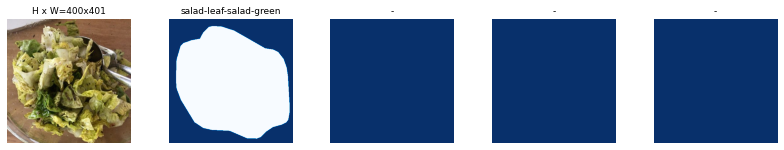

[INFO] Image ID: 4941


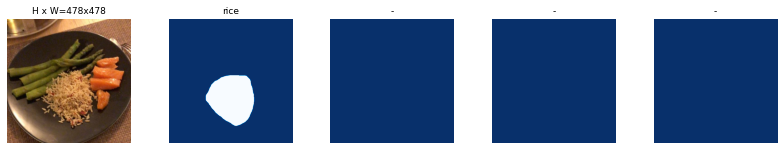

[INFO] Image ID: 9855


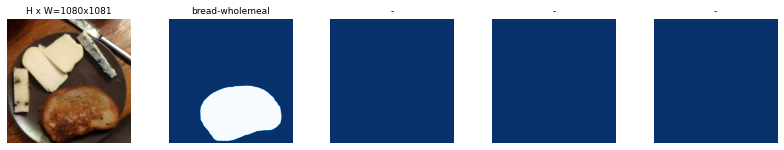

[INFO] Image ID: 8832


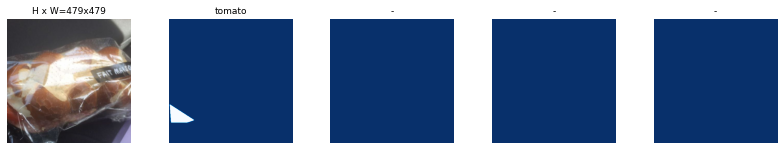

In [ ]:
import numpy as np
image_ids = np.random.choice(dataset_train.image_ids, 4)
for image_id in image_ids:
    print("[INFO] Image ID: {}".format(image_id))
    image = dataset_train.load_image(image_id)
    mask, class_ids = dataset_train.load_mask(image_id)
    visualize.display_top_masks(image, mask, class_ids, dataset_train.class_names)


###Step 4.2: Resize Images

To support multiple images per batch, images are resized to one size (256x256). However aspect ratio is preserved. If an image is not square, then zero padding is added at the top/bottom or right/left.


[INFO] Image ID: 267 	Dataset Reference: food-challenge::267
[INFO] Original Shape:  (464, 464, 3)
[INFO] Image             shape: (256, 256, 3)         min:    0.00000  max:  252.00000  uint8
[INFO] Mask              shape: (256, 256, 1)         min:    0.00000  max:    1.00000  uint8
[INFO] Class IDs         shape: (1,)                  min:    7.00000  max:    7.00000  int32
[INFO] BBOX              shape: (1, 4)                min:   23.00000  max:  234.00000  int32


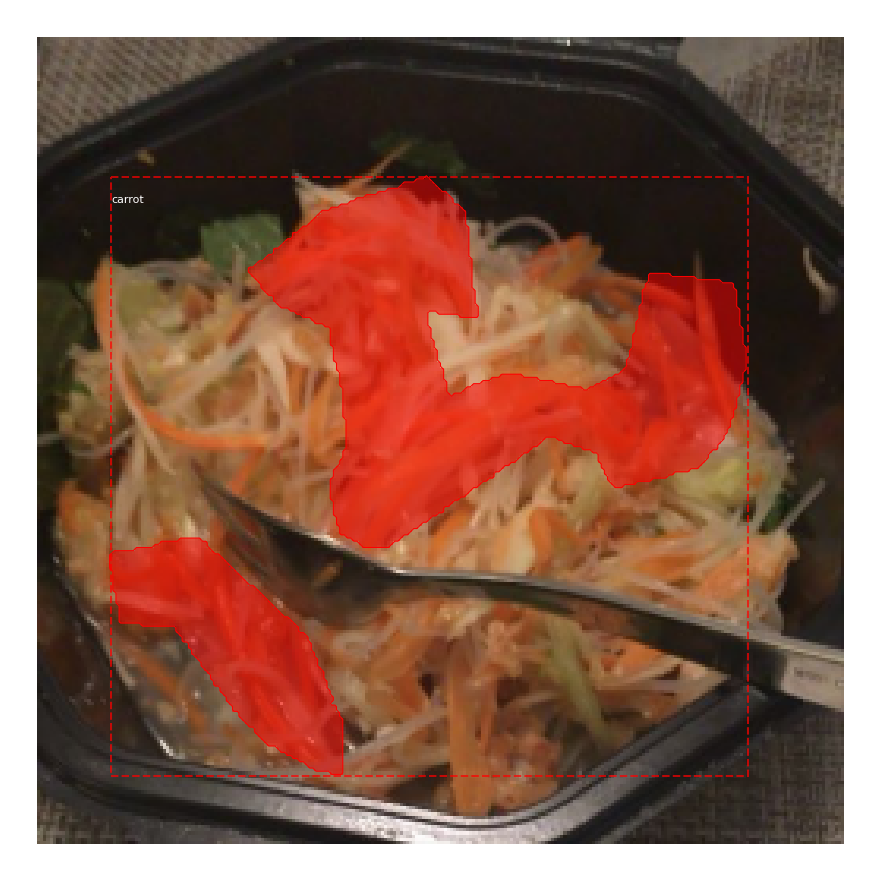

In [ ]:
from mrcnn.model import log
# Load random image and mask.
image_id = np.random.choice(dataset_train.image_ids, 1)[0]
image = dataset_train.load_image(image_id)
mask, class_ids = dataset_train.load_mask(image_id)
original_shape = image.shape

# Resize
image, window, scale, padding = utils.resize_image(
    image, 
    min_dim=config.IMAGE_MIN_DIM, 
    max_dim=config.IMAGE_MAX_DIM,
    mode=config.IMAGE_RESIZE_MODE)
mask = utils.resize_mask(mask, scale, padding)

# Compute Bounding box
bbox = utils.extract_bboxes(mask)

# Display image and additional stats
print("[INFO] Image ID: {} \tDataset Reference: {}".format(image_id, dataset_train.image_reference(image_id)))
print("[INFO] Original Shape: ", original_shape)
log("[INFO] Image", image)
log("[INFO] Mask", mask)
log("[INFO] Class IDs", class_ids)
log("[INFO] BBOX", bbox)
# Display image and instances
visualize.display_instances(image, bbox, mask, class_ids, dataset_train.class_names)


### Step 4.3: Visualizing Mini Masks




[INFO] Image ID:  539
[INFO] Image             shape: (256, 256, 3)         min:    0.00000  max:  252.00000  uint8
[INFO] Class IDs         shape: (2,)                  min:   12.00000  max:   16.00000  int32
[INFO] BBOX              shape: (2, 4)                min:   31.00000  max:  221.00000  int32
[INFO] Mask              shape: (256, 256, 2)         min:    0.00000  max:    1.00000  uint8
[INFO] Image Metas       shape: (29,)                 min:    0.00000  max:  539.00000  float64


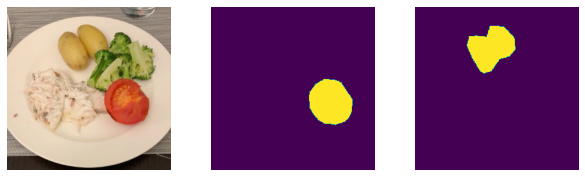

In [ ]:
from mrcnn.visualize import display_images

image_id = np.random.choice(dataset_train.image_ids, 1)[0]
print("[INFO] Image ID: ", image_id)
image, image_meta, class_ids, bbox, mask = modellib.load_image_gt(
    dataset_train, config, image_id, use_mini_mask=False)

log("[INFO] Image", image)
log("[INFO] Class IDs", class_ids)
log("[INFO] BBOX", bbox)
log("[INFO] Mask", mask)
log("[INFO] Image Metas", image_meta)
display_images([image]+[mask[:,:,i] for i in range(min(mask.shape[-1], 7))])

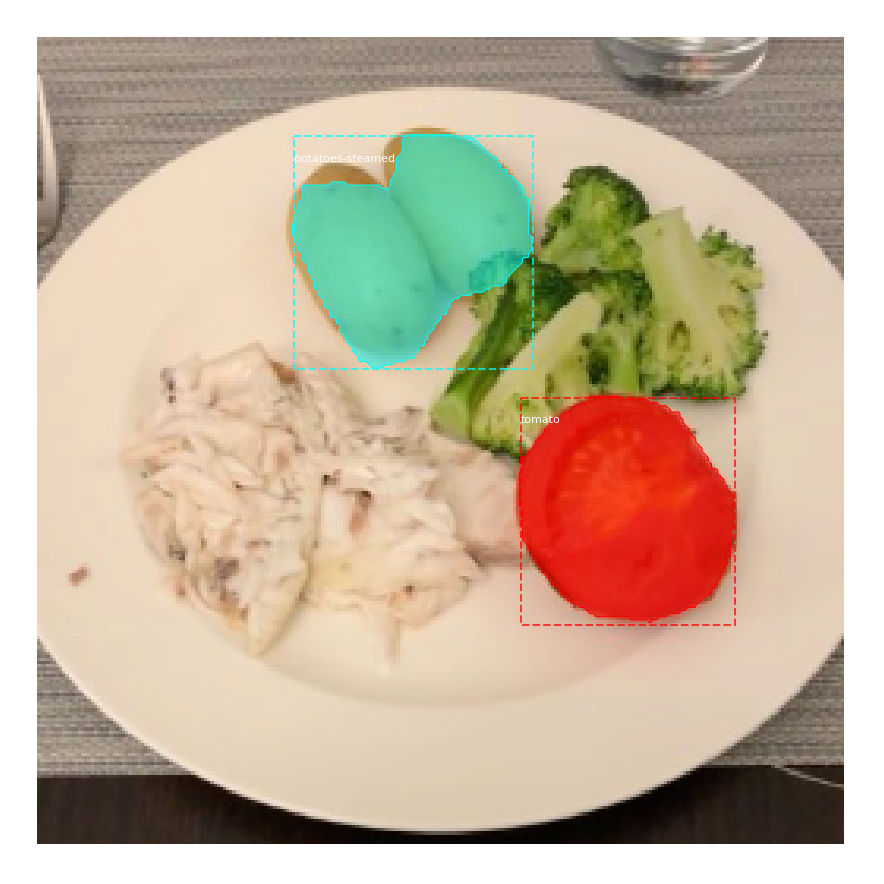

In [ ]:
visualize.display_instances(image, bbox, mask, class_ids, dataset_train.class_names)

###Step 4.4: Adding Augmentations



[INFO] Mask              shape: (56, 56, 2)           min:    0.00000  max:    1.00000  bool


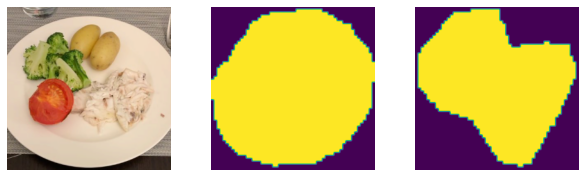

In [ ]:
# Add augmentation and mask resizing.
import imgaug.augmenters as iaa

image, image_meta, class_ids, bbox, mask = modellib.load_image_gt(
    dataset_train,
    config,
    image_id,
    augmentation=iaa.flip.Fliplr(1.0),
    use_mini_mask=True
  )

log("[INFO] Mask", mask)
display_images([image]+[mask[:,:,i] for i in range(min(mask.shape[-1], 7))])

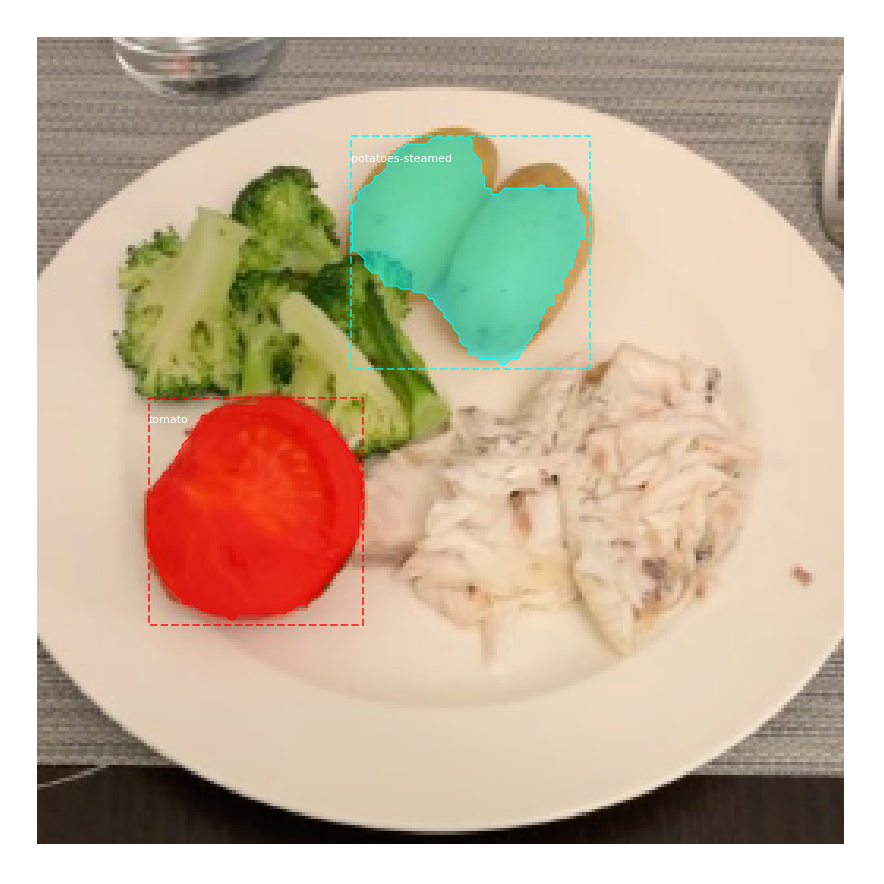

In [ ]:
mask = utils.expand_mask(bbox, mask, image.shape)
visualize.display_instances(image, bbox, mask, class_ids, dataset_train.class_names)

###Step 4.5: Viewing Anchors


![](https://github.com/RohitMidha23/Explained/blob/master/images/FPN.png?raw=True)


In [ ]:
# Generate Anchors
backbone_shapes = modellib.compute_backbone_shapes(config, config.IMAGE_SHAPE)
anchors = utils.generate_pyramid_anchors(
    config.RPN_ANCHOR_SCALES, 
    config.RPN_ANCHOR_RATIOS,
    backbone_shapes,
    config.BACKBONE_STRIDES, 
    config.RPN_ANCHOR_STRIDE
  )

# Print summary of anchors
num_levels = len(backbone_shapes)
anchors_per_cell = len(config.RPN_ANCHOR_RATIOS)
print("[INFO] Anchors Count: ", anchors.shape[0])
print("[INFO] Scales: ", config.RPN_ANCHOR_SCALES)
print("[INFO] Ratios: ", config.RPN_ANCHOR_RATIOS)
print("[INFO] Anchors per Cell: ", anchors_per_cell)
print("[INFO] Levels: ", num_levels)

anchors_per_level = []
for l in range(num_levels):
    num_cells = backbone_shapes[l][0] * backbone_shapes[l][1]
    anchors_per_level.append(anchors_per_cell * num_cells // config.RPN_ANCHOR_STRIDE**2)
    print("Anchors at Level {}: {}".format(l, anchors_per_level[l]))

[INFO] Anchors Count:  16368
[INFO] Scales:  (32, 64, 128, 256, 512)
[INFO] Ratios:  [0.5, 1, 2]
[INFO] Anchors per Cell:  3
[INFO] Levels:  5
Anchors at Level 0: 12288
Anchors at Level 1: 3072
Anchors at Level 2: 768
Anchors at Level 3: 192
Anchors at Level 4: 48


Level 0. Anchors:  12288  Feature map Shape: [64 64]
Level 1. Anchors:   3072  Feature map Shape: [32 32]
Level 2. Anchors:    768  Feature map Shape: [16 16]
Level 3. Anchors:    192  Feature map Shape: [8 8]
Level 4. Anchors:     48  Feature map Shape: [4 4]


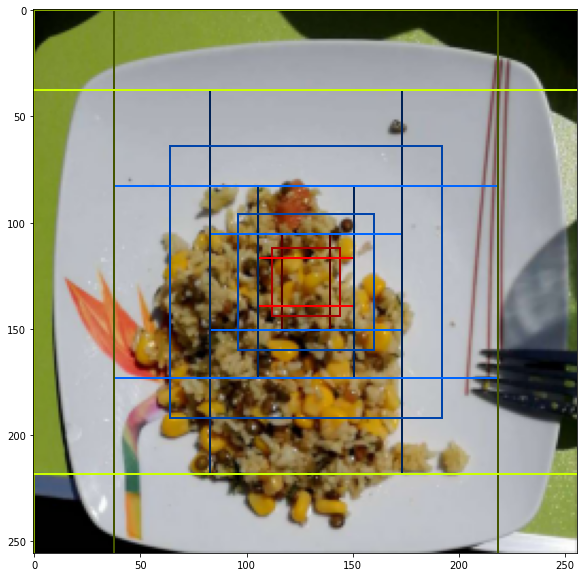

In [ ]:
# Load and draw random image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.lines as lines
image_id = np.random.choice(dataset_train.image_ids, 1)[0]
image, image_meta, _, _, _ = modellib.load_image_gt(dataset_train, config, image_id)
fig, ax = plt.subplots(1, figsize=(10, 10))
ax.imshow(image)
levels = len(backbone_shapes)

for level in range(levels):
    colors = visualize.random_colors(levels)
    # Compute the index of the anchors at the center of the image
    level_start = sum(anchors_per_level[:level]) # sum of anchors of previous levels
    level_anchors = anchors[level_start:level_start+anchors_per_level[level]]
    print("Level {}. Anchors: {:6}  Feature map Shape: {}".format(level, level_anchors.shape[0], 
                                                                  backbone_shapes[level]))
    center_cell = backbone_shapes[level] // 2
    center_cell_index = (center_cell[0] * backbone_shapes[level][1] + center_cell[1])
    level_center = center_cell_index * anchors_per_cell 
    center_anchor = anchors_per_cell * (
        (center_cell[0] * backbone_shapes[level][1] / config.RPN_ANCHOR_STRIDE**2) \
        + center_cell[1] / config.RPN_ANCHOR_STRIDE)
    level_center = int(center_anchor)

    # Draw anchors. Brightness show the order in the array, dark to bright.
    for i, rect in enumerate(level_anchors[level_center:level_center+anchors_per_cell]):
        y1, x1, y2, x2 = rect
        p = patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=2, facecolor='none',
                              edgecolor=(i+1)*np.array(colors[level]) / anchors_per_cell)
        ax.add_patch(p)

###Step 4.6: Data Generator Check

In [ ]:
# Create data generator
random_rois = 2000
g = modellib.data_generator(
    dataset_train, config, shuffle=True, random_rois=random_rois, 
    batch_size=4,
    detection_targets=True)

In [ ]:
# Uncomment to run the generator through a lot of images
# to catch rare errors

# from tqdm.notebook import tqdm
# count = 0
# for i in tqdm(range(1000)):
#     count+=1
#     _, _ = next(g)

# print(count)

In [ ]:
# Get Next Image
if random_rois:
    [normalized_images, image_meta, rpn_match, rpn_bbox, gt_class_ids, gt_boxes, gt_masks, rpn_rois, rois], \
    [mrcnn_class_ids, mrcnn_bbox, mrcnn_mask] = next(g)
    
    log("[INFO] rois", rois)
    log("[INFO] mrcnn_class_ids", mrcnn_class_ids)
    log("[INFO] mrcnn_bbox", mrcnn_bbox)
    log("[INFO] mrcnn_mask", mrcnn_mask)
else:
    [normalized_images, image_meta, rpn_match, rpn_bbox, gt_boxes, gt_masks], _ = next(g)
    
log("[INFO] gt_class_ids", gt_class_ids)
log("[INFO] gt_boxes", gt_boxes)
log("[INFO] gt_masks", gt_masks)
log("[INFO] rpn_match", rpn_match, )
log("[INFO] rpn_bbox", rpn_bbox)
image_id = modellib.parse_image_meta(image_meta)["image_id"][0]
print("[INFO] Image ID: {} \tDataset Reference: {}".format(image_id, dataset_train.image_reference(image_id)))

# Remove the last dim in mrcnn_class_ids. It's only added
# to satisfy Keras restriction on target shape.
mrcnn_class_ids = mrcnn_class_ids[:,:,0]

[INFO] rois              shape: (4, 200, 4)           min:    0.00000  max:  255.00000  int32
[INFO] mrcnn_class_ids   shape: (4, 200, 1)           min:    0.00000  max:   15.00000  int32
[INFO] mrcnn_bbox        shape: (4, 200, 17, 4)       min:   -3.95833  max:    3.62500  float32
[INFO] mrcnn_mask        shape: (4, 200, 28, 28, 17)  min:    0.00000  max:    1.00000  float32
[INFO] gt_class_ids      shape: (4, 100)              min:    0.00000  max:   15.00000  int32
[INFO] gt_boxes          shape: (4, 100, 4)           min:    0.00000  max:  255.00000  int32
[INFO] gt_masks          shape: (4, 56, 56, 100)      min:    0.00000  max:    1.00000  bool
[INFO] rpn_match         shape: (4, 16368, 1)         min:   -1.00000  max:    1.00000  int32
[INFO] rpn_bbox          shape: (4, 256, 4)           min:   -2.46794  max:    1.05469  float64
[INFO] Image ID: 4328 	Dataset Reference: food-challenge::4328


anchors                  shape: (16368, 4)            min: -362.03867  max:  554.03867  float64
refined_anchors          shape: (3, 4)                min:   69.99999  max:  220.00000  float32
Positive anchors: 3
Negative anchors: 253
Neutral anchors: 16112
BG                     : 148
coffee-with-caffeine   : 52


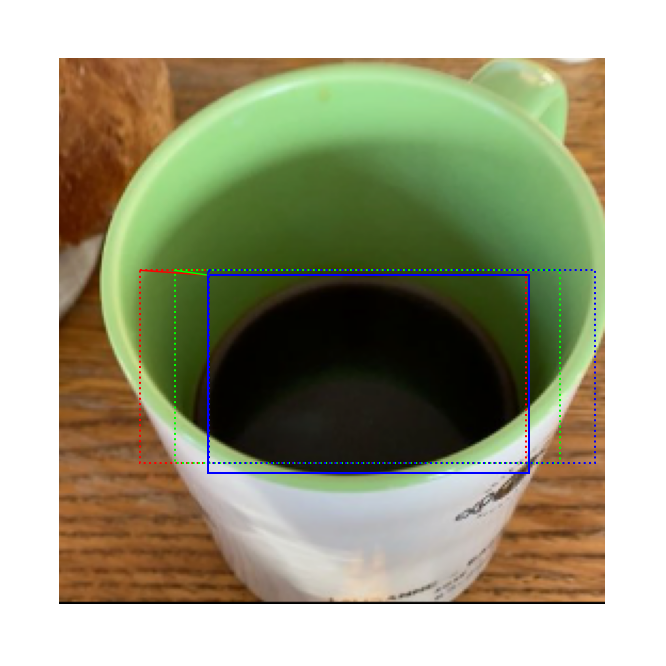

In [ ]:
b = 0

# Restore original image (reverse normalization)
sample_image = modellib.unmold_image(normalized_images[b], config)

# Compute anchor shifts.
indices = np.where(rpn_match[b] == 1)[0]
refined_anchors = utils.apply_box_deltas(anchors[indices], rpn_bbox[b, :len(indices)] * config.RPN_BBOX_STD_DEV)
log("anchors", anchors)
log("refined_anchors", refined_anchors)

# Get list of positive anchors
positive_anchor_ids = np.where(rpn_match[b] == 1)[0]
print("Positive anchors: {}".format(len(positive_anchor_ids)))
negative_anchor_ids = np.where(rpn_match[b] == -1)[0]
print("Negative anchors: {}".format(len(negative_anchor_ids)))
neutral_anchor_ids = np.where(rpn_match[b] == 0)[0]
print("Neutral anchors: {}".format(len(neutral_anchor_ids)))

# ROI breakdown by class
for c, n in zip(dataset_train.class_names, np.bincount(mrcnn_class_ids[b].flatten())):
    if n:
        print("{:23}: {}".format(c[:20], n))

# Show positive anchors
visualize.draw_boxes(sample_image, boxes=anchors[positive_anchor_ids], 
                     refined_boxes=refined_anchors)

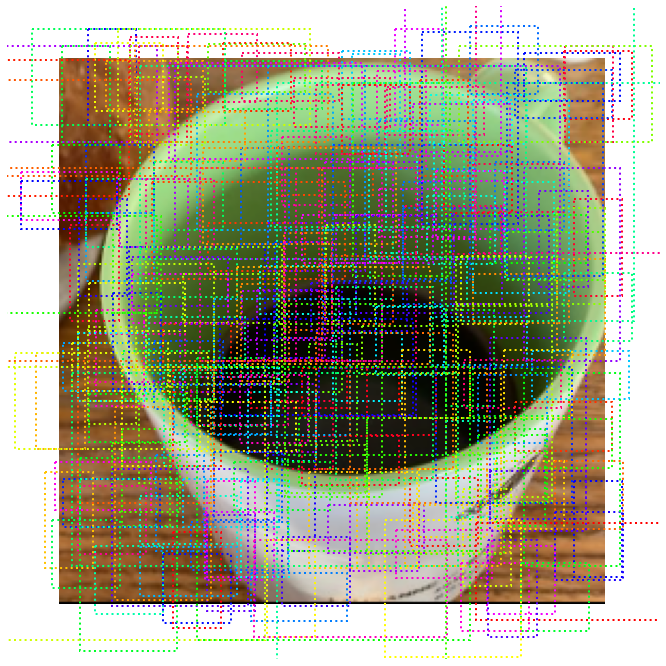

In [ ]:
# Show negative anchors
visualize.draw_boxes(sample_image, boxes=anchors[negative_anchor_ids])

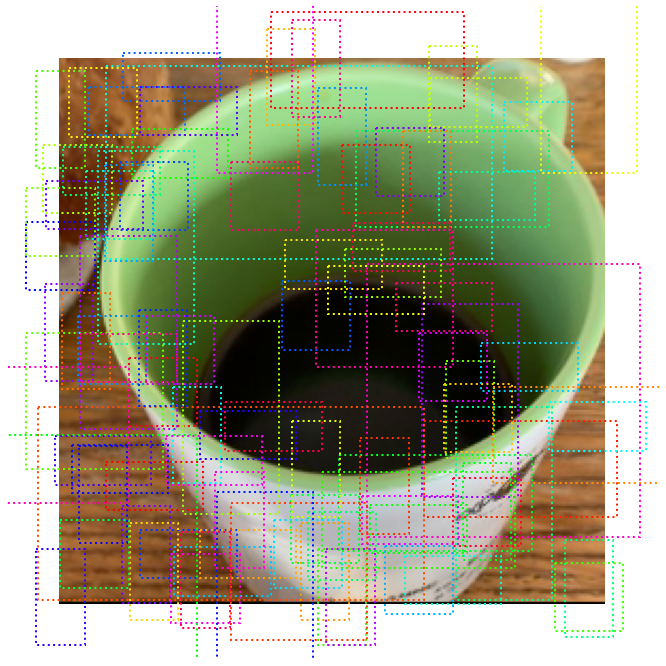

In [ ]:
# Show neutral anchors. They don't contribute to training.
visualize.draw_boxes(sample_image, boxes=anchors[np.random.choice(neutral_anchor_ids, 100)])

###Step 4.7: View ROIs
ROI stands for Region Of Interest

Positive ROIs:  52
Negative ROIs:  148
Positive Ratio: 0.26
Unique ROIs: 200 out of 200


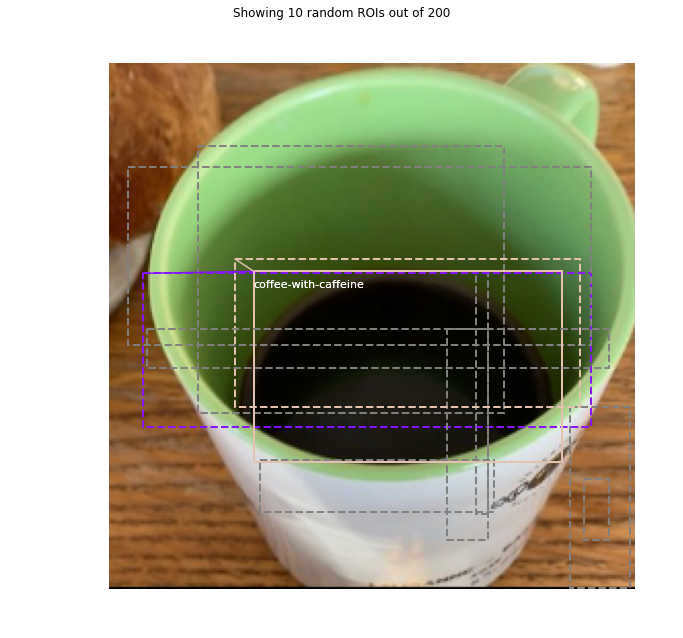

In [ ]:
if random_rois:
    # Class aware bboxes
    bbox_specific = mrcnn_bbox[b, np.arange(mrcnn_bbox.shape[1]), mrcnn_class_ids[b], :]

    # Refined ROIs
    refined_rois = utils.apply_box_deltas(rois[b].astype(np.float32), bbox_specific[:,:4] * config.BBOX_STD_DEV)

    # Class aware masks
    mask_specific = mrcnn_mask[b, np.arange(mrcnn_mask.shape[1]), :, :, mrcnn_class_ids[b]]

    visualize.draw_rois(sample_image, rois[b], refined_rois, mask_specific, mrcnn_class_ids[b], dataset_train.class_names)
    
    # Any repeated ROIs?
    rows = np.ascontiguousarray(rois[b]).view(np.dtype((np.void, rois.dtype.itemsize * rois.shape[-1])))
    _, idx = np.unique(rows, return_index=True)
    print("Unique ROIs: {} out of {}".format(len(idx), rois.shape[1]))

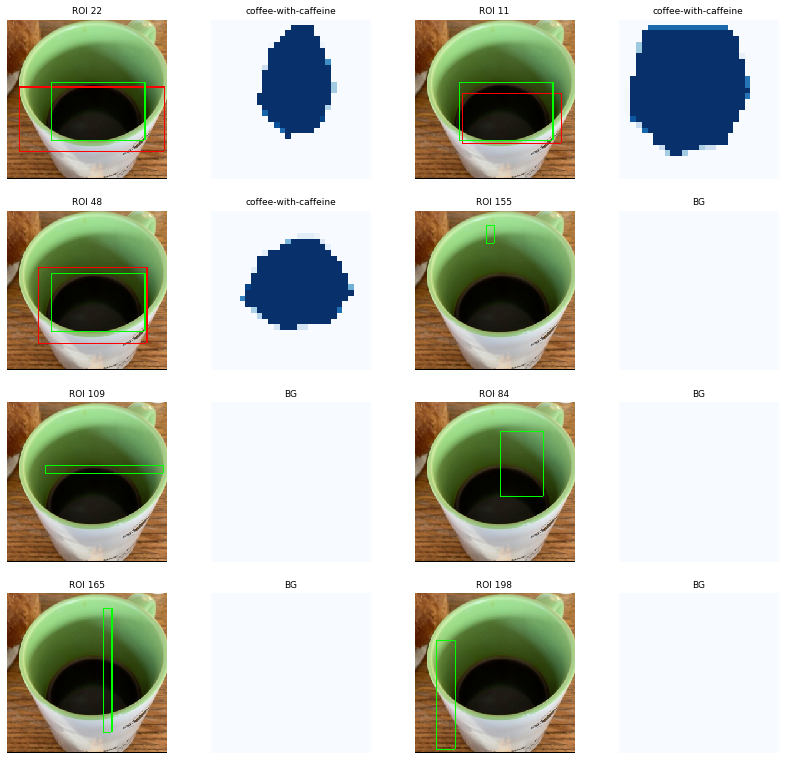

In [ ]:
import random
if random_rois:
    # Dispalay ROIs and corresponding masks and bounding boxes
    ids = random.sample(range(rois.shape[1]), 8)

    images = []
    titles = []
    for i in ids:
        image = visualize.draw_box(sample_image.copy(), rois[b,i,:4].astype(np.int32), [255, 0, 0])
        image = visualize.draw_box(image, refined_rois[i].astype(np.int64), [0, 255, 0])
        images.append(image)
        titles.append("ROI {}".format(i))
        images.append(mask_specific[i] * 255)
        titles.append(dataset_train.class_names[mrcnn_class_ids[b,i]][:20])

    display_images(images, titles, cols=4, cmap="Blues", interpolation="none")

In [ ]:
# Check ratio of positive ROIs in a set of images.
if random_rois:
    limit = 10
    temp_g = modellib.data_generator(
        dataset_train, config, shuffle=True, random_rois=10000, 
        batch_size=1, detection_targets=True)
    total = 0
    for i in range(limit):
        _, [ids, _, _] = next(temp_g)
        positive_rois = np.sum(ids[0] > 0)
        total += positive_rois
        print("{:5} {:5.2f}".format(positive_rois, positive_rois/ids.shape[1]))
    print("Average percent: {:.2f}".format(total/(limit*ids.shape[1])))

   66  0.33
   66  0.33
   66  0.33
   66  0.33
   66  0.33
   66  0.33
   66  0.33
   66  0.33
   66  0.33
   66  0.33
Average percent: 0.33


##Step 5: Integration with Wandb!

Wandb provides a central dashboard to keep track of your hyperparameters, system metrics, and predictions so you can compare models live, and share your findings. We will use wandb to keep track of the model metrics and we also implement an image callback, which allows people to view realtime how the model is improving as it trains.

You can see the results of our runs [here](https://wandb.ai/jellycrusher/foodr3-community).

<img src="https://github.com/shraddhaamohan/MaskRCNN_wandb/blob/master/assets/wandb_example.gif?raw=true"/>

In [ ]:
!wandb init

This directory has been configured previously, should we re-configure it? [y/N]: y
wandb: Which project should we use?
wandb: (1) foodrecognition1
wandb: (2) foodrecognition
wandb: (3) Create New
wandb: Enter your choice: 3
wandb: You chose 'Create New'
Enter a name for your new project: foodrecognition2
This directory is configured!  Next, track a run:
* In your training script:
    import wandb
    wandb.init(project="foodrecognition2")
* then `python <train.py>`.



In [ ]:
import wandb
import matplotlib.pyplot as plt
import keras
import scipy
run = wandb.init(project="foodrecognition1")
_config = FoodConfig()

config_dict = _config.get_config_dict()
configs_of_interest = ['BACKBONE', 'GRADIENT_CLIP_NORM', 'LEARNING_MOMENTUM', 'LEARNING_RATE',
                        'WEIGHT_DECAY', 'STEPS_PER_EPOCH']

wandb.log({k: config_dict[k] for k in configs_of_interest})


def fig_to_array(fig):
    fig.canvas.draw()
    w, h = fig.canvas.get_width_height()
    buf = np.fromstring(fig.canvas.tostring_argb(), dtype=np.uint8)
    buf.shape = (w, h, 4)
    buf = np.roll(buf, 3, axis=2)
    return buf

class ImageCallback(keras.callbacks.Callback):
    def __init__(self, run, dataset_val, dataset_train,infer_config,log_dir):
        super(ImageCallback, self).__init__()
        self.run = run
        self.dataset_val = dataset_val
        self.dataset_train = dataset_train
        self.image_ids = [103,47,8,48] #or dataset_val.image_ids[:3]
        self.infer_config = infer_config
        self.log_dir=log_dir
        self.inf_model = modellib.MaskRCNN(mode="inference", config=self.infer_config ,
                                  model_dir=log_dir,callbacks=[])
        
    def load_curr_model(self):
        model_path = self.inf_model.find_last()[1]
        self.inf_model.load_weights(model_path, by_name=True)

    def predict_image(self, image_id):
        original_image, image_meta, gt_class_id, gt_bbox, gt_mask = load_image_gt(
            self.dataset_val, _config, image_id, use_mini_mask=False)
        _, ax = plt.subplots(figsize=(16, 16)) 
        
        # Run detection
        results = self.inf_model.detect([original_image])

        # Visualize results
        r = results[0]
        visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                                self.dataset_val.class_names, r['scores'],figsize=(16,16), 
            ax=ax)
        return fig_to_array(ax.figure)

    def on_epoch_end(self, epoch, logs):
        print("Uploading images to wandb...")
        self.load_curr_model();
        predicted_images = [self.predict_image(i) for i in self.image_ids]
        wandb.log({"img_segmentations":[
            wandb.Image(
                scipy.misc.imresize(img, 50),
                caption="SampleImage",
                mode='RGBA') for img in predicted_images]})

class PerformanceCallback(keras.callbacks.Callback):
    def __init__(self, run):
        self.run = run
    def on_epoch_end(self, epoch, logs):
        print("Uploading metrics to wandb...")
        #self.run.history.row.update(logs)
        wandb.log(logs)
        #self.run.history.add()

In [ ]:
############################################################
### COCO Evaluation ###
############################################################

def build_coco_results(dataset, image_ids, rois, class_ids, scores, masks):
    """Arrange resutls to match COCO specs in http://cocodataset.org/#format
    """
    # If no results, return an empty list
    if rois is None:
        return []

    results = []
    for image_id in image_ids:
        # Loop through detections
        for i in range(rois.shape[0]):
            class_id = class_ids[i]
            score = scores[i]
            bbox = np.around(rois[i], 1)
            mask = masks[:, :, i]

            result = {
                "image_id": image_id,
                "category_id": dataset.get_source_class_id(class_id, "food-challenge"),
                "bbox": [bbox[1], bbox[0], bbox[3] - bbox[1], bbox[2] - bbox[0]],
                "score": score,
                "segmentation": maskUtils.encode(np.asfortranarray(mask))
            }
            results.append(result)
    return results


def evaluate_coco(model, dataset, coco, eval_type="segm", limit=0, image_ids=None):
    """Runs official COCO evaluation.
    dataset: A Dataset object with valiadtion data
    eval_type: "bbox" or "segm" for bounding box or segmentation evaluation
    limit: if not 0, it's the number of images to use for evaluation
    """
    # Pick COCO images from the dataset
    image_ids = image_ids or dataset.image_ids

    # Limit to a subset
    if limit:
        image_ids = image_ids[:limit]

    # Get corresponding COCO image IDs.
    coco_image_ids = [dataset.image_info[id]["id"] for id in image_ids]

    t_prediction = 0
    t_start = time.time()

    results = []
    for i, image_id in enumerate(image_ids):
        # Load image
        image = dataset.load_image(image_id)

        # Run detection
        t = time.time()
        r = model.detect([image], verbose=0)[0]
        t_prediction += (time.time() - t)

        # Convert results to COCO format
        # Cast masks to uint8 because COCO tools errors out on bool
        image_results = build_coco_results(dataset, coco_image_ids[i:i + 1],
                                           r["rois"], r["class_ids"],
                                           r["scores"],
                                           r["masks"].astype(np.uint8))
        results.extend(image_results)

    # Load results. This modifies results with additional attributes.
    coco_results = coco.loadRes(results)

    # Evaluate
    cocoEval = COCOeval(coco, coco_results, eval_type)
    cocoEval.params.imgIds = coco_image_ids
    cocoEval.evaluate()
    cocoEval.accumulate()
    cocoEval.summarize()

    print("Prediction time: {}. Average {}/image".format(
        t_prediction, t_prediction / len(image_ids)))
    print("Total time: ", time.time() - t_start)



##Step 6: Training
We train the model for 65 epochs here, due to compute constraints. You can make changes to the `FoodConfig` or use a different learning schedule for your application. 

The best part about wandb is that it allows you to compare the different models that you train.

We trained a model on 16 most annoteted classes.

In [ ]:
config = FoodConfig()
config.display()


Configurations:
BACKBONE                       resnet50
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     2
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 2
IMAGE_MAX_DIM                  256
IMAGE_META_SIZE                29
IMAGE_MIN_DIM                  256
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [256 256   3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
MASK_POOL_SIZE                 14
MASK_SHAPE                     [28, 28]
MAX_GT_INSTANCES               100
MEAN_PIXEL                     [123.7 116.8 103.9]
MINI_MASK_SHAPE                (56, 56)
NAME                           food-challenge
NUM_CLASSES                    17
POOL_SIZE                      7
POST_NMS_ROIS_INFERENCE        10

In [ ]:
dataset_train = FoodDataset()
dataset_val = FoodDataset()
dataset_val.load_dataset("/content/drive/MyDrive/datasets/validation", load_small=True,return_coco=False)
dataset_val.prepare()

Annotation Path  /content/drive/MyDrive/datasets/validation/annotations-small.json
Image Dir  /content/drive/MyDrive/datasets/validation/images
loading annotations into memory...
Done (t=0.03s)
creating index...
index created!


At every epoch we visualize the performance of the model on a few validation set images. To implement this we need to define an `InferenceConfig` which inherits from the `FoodConfig` class as shown below.

In [ ]:
class InferenceConfig(FoodConfig):
            # Set batch size to 1 since we'll be running inference on
            # one image at a time. Batch size = GPU_COUNT * IMAGES_PER_GPU
            GPU_COUNT = 1
            IMAGES_PER_GPU = 1
            DETECTION_MIN_CONFIDENCE = 0
inf_config = InferenceConfig()
callbacks = [
        ImageCallback(
            run,
            dataset_val,
            dataset_train,inf_config,DEFAULT_LOGS_DIR),
        PerformanceCallback(run)
]

In [ ]:
model = modellib.MaskRCNN(mode="training", config=config,
                                  model_dir=DEFAULT_LOGS_DIR, callbacks=callbacks)

In [ ]:
model_path = COCO_MODEL_PATH

In [ ]:
# Load weights
print("Loading weights ", model_path)
model.load_weights(model_path, by_name=True, exclude=[ "mrcnn_class_logits", "mrcnn_bbox_fc", "mrcnn_bbox", "mrcnn_mask"])

Loading weights  /content/drive/MyDrive/PretrainedModel/mask_rcnn_coco.h5


In [ ]:
dataset_train.load_dataset("/content/drive/MyDrive/datasets/training", True,False)
dataset_train.prepare()

Annotation Path  /content/drive/MyDrive/datasets/training/annotations-small.json
Image Dir  /content/drive/MyDrive/datasets/training/images
loading annotations into memory...
Done (t=0.97s)
creating index...
index created!


Training network heads

Starting at epoch 0. LR=0.001

Checkpoint Path: /content/drive/MyDrive/datasets/logs/food-challenge20210921T1150/mask_rcnn_food-challenge_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mr

/usr/local/lib/python3.7/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.7/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.7/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2087: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


Epoch 1/20
149/150 [============================>.] - ETA: 0s - loss: 2.3251 - rpn_class_loss: 0.0224 - rpn_bbox_loss: 0.5219 - mrcnn_class_loss: 0.3866 - mrcnn_bbox_loss: 0.6668 - mrcnn_mask_loss: 0.7275

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 169s 1s/step - loss: 2.3204 - rpn_class_loss: 0.0223 - rpn_bbox_loss: 0.5190 - mrcnn_class_loss: 0.3856 - mrcnn_bbox_loss: 0.6661 - mrcnn_mask_loss: 0.7274 - val_loss: 1.9627 - val_rpn_class_loss: 0.0179 - val_rpn_bbox_loss: 0.4762 - val_mrcnn_class_loss: 0.2287 - val_mrcnn_bbox_loss: 0.5513 - val_mrcnn_mask_loss: 0.6886
Uploading images to wandb...


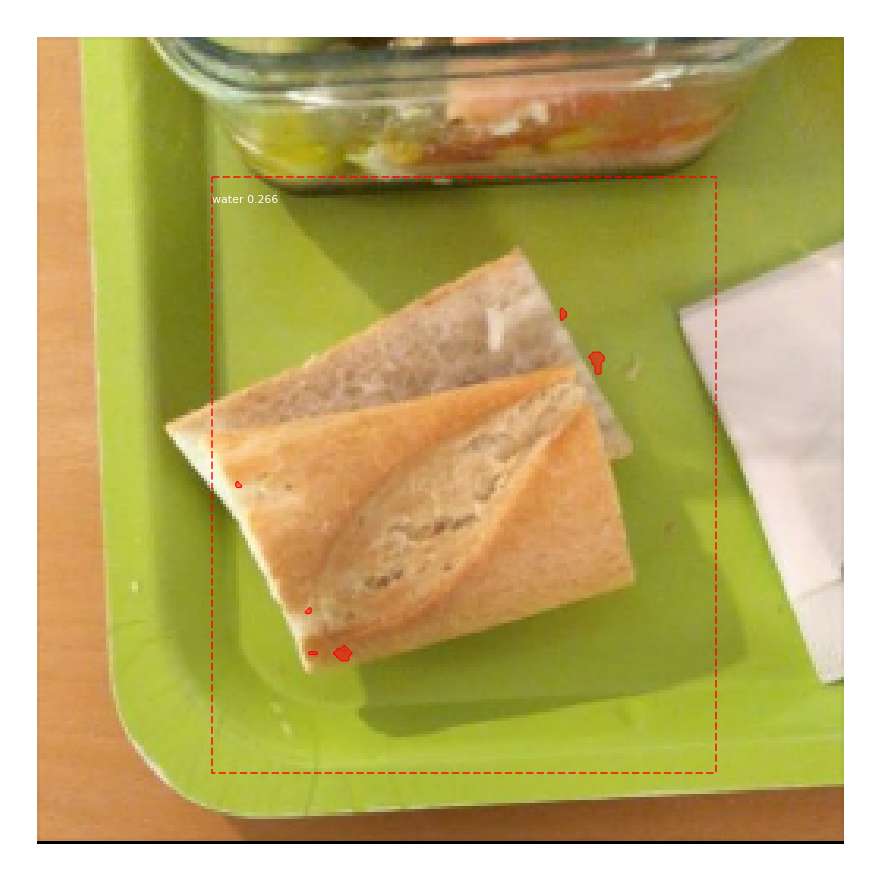

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


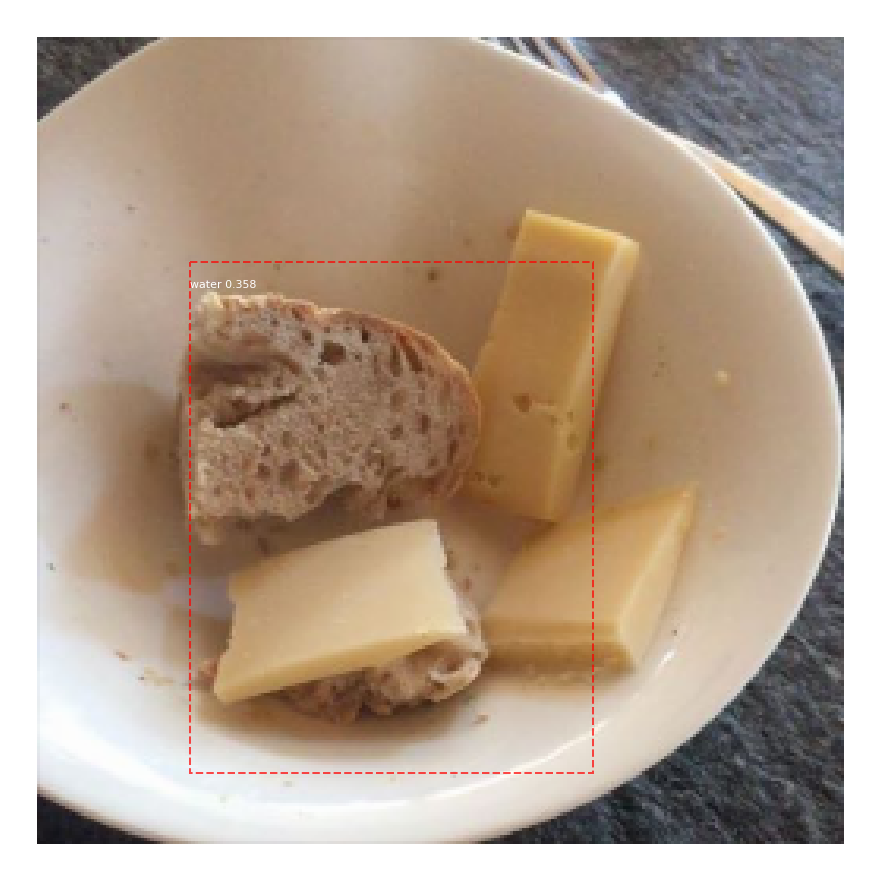

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


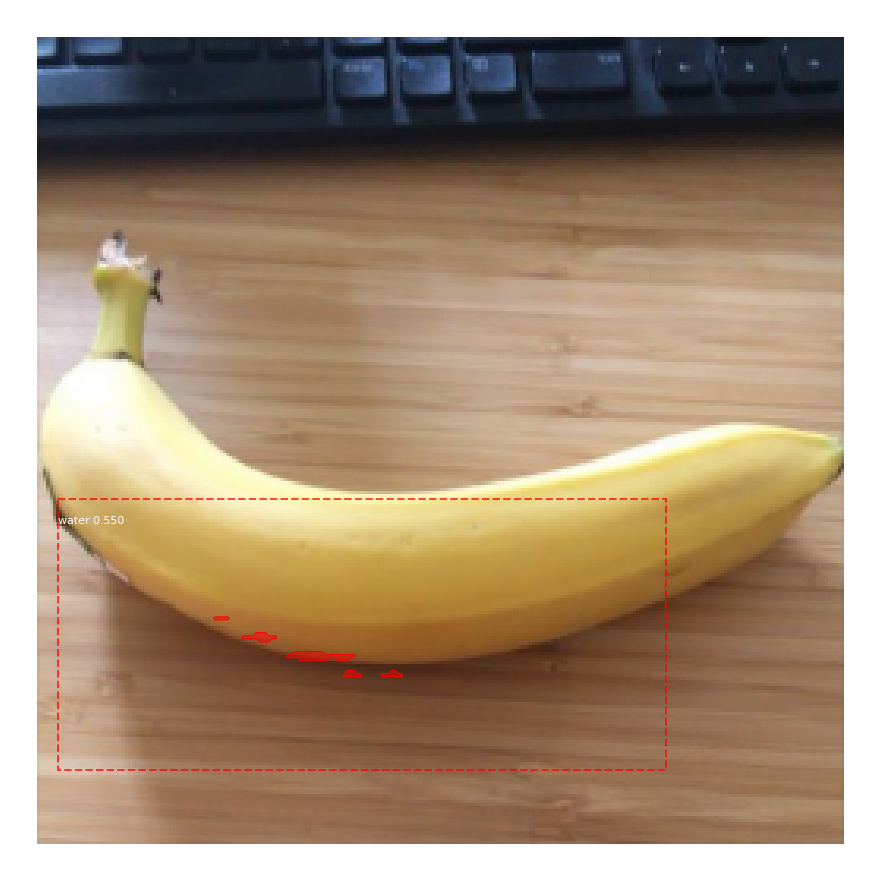

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


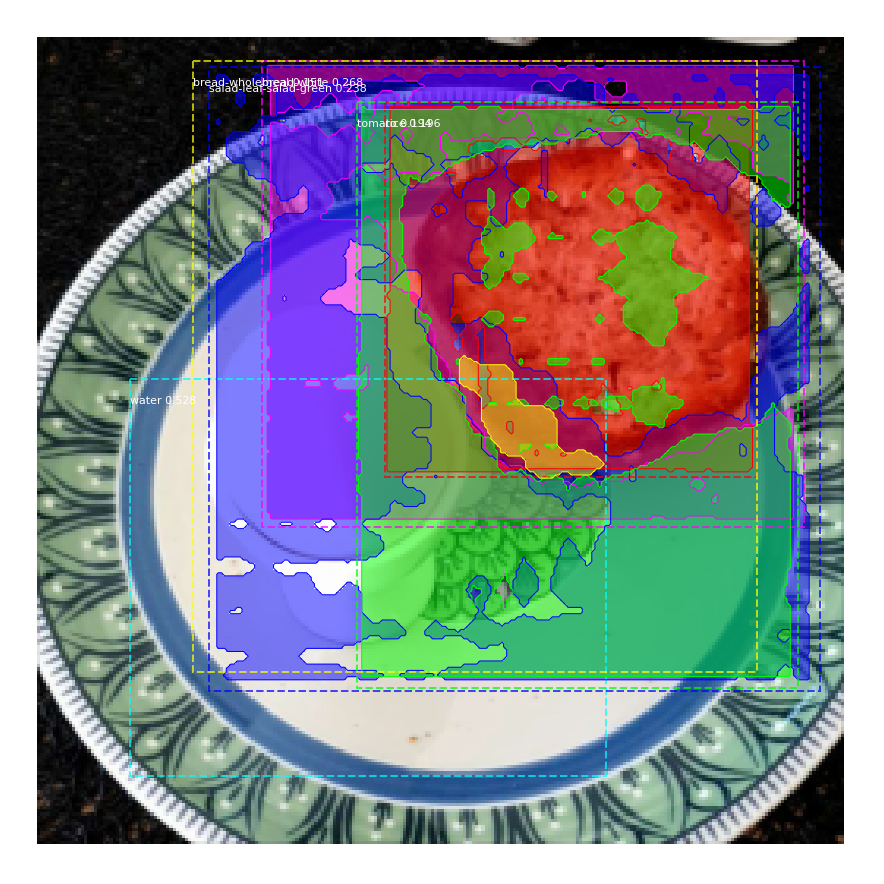

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 2/20
149/150 [============================>.] - ETA: 0s - loss: 1.8249 - rpn_class_loss: 0.0180 - rpn_bbox_loss: 0.4242 - mrcnn_class_loss: 0.2293 - mrcnn_bbox_loss: 0.4919 - mrcnn_mask_loss: 0.6615

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 139s 928ms/step - loss: 1.8217 - rpn_class_loss: 0.0180 - rpn_bbox_loss: 0.4219 - mrcnn_class_loss: 0.2293 - mrcnn_bbox_loss: 0.4919 - mrcnn_mask_loss: 0.6606 - val_loss: 1.8550 - val_rpn_class_loss: 0.0172 - val_rpn_bbox_loss: 0.5139 - val_mrcnn_class_loss: 0.1898 - val_mrcnn_bbox_loss: 0.4892 - val_mrcnn_mask_loss: 0.6449
Uploading images to wandb...


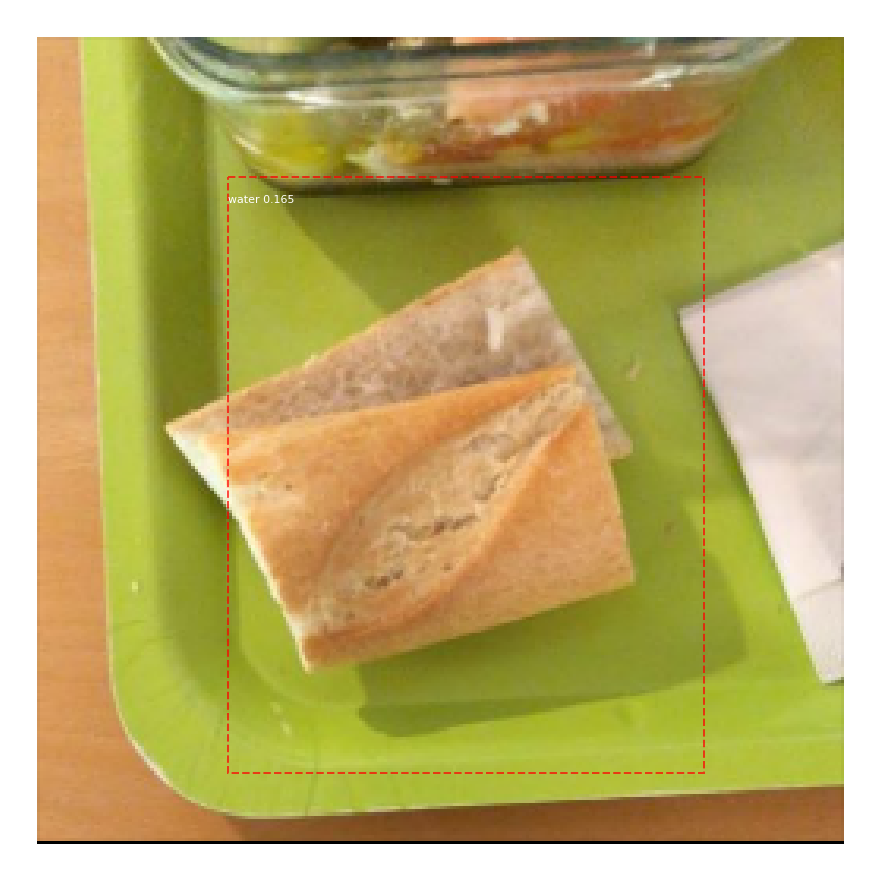

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead



*** No instances to display *** 



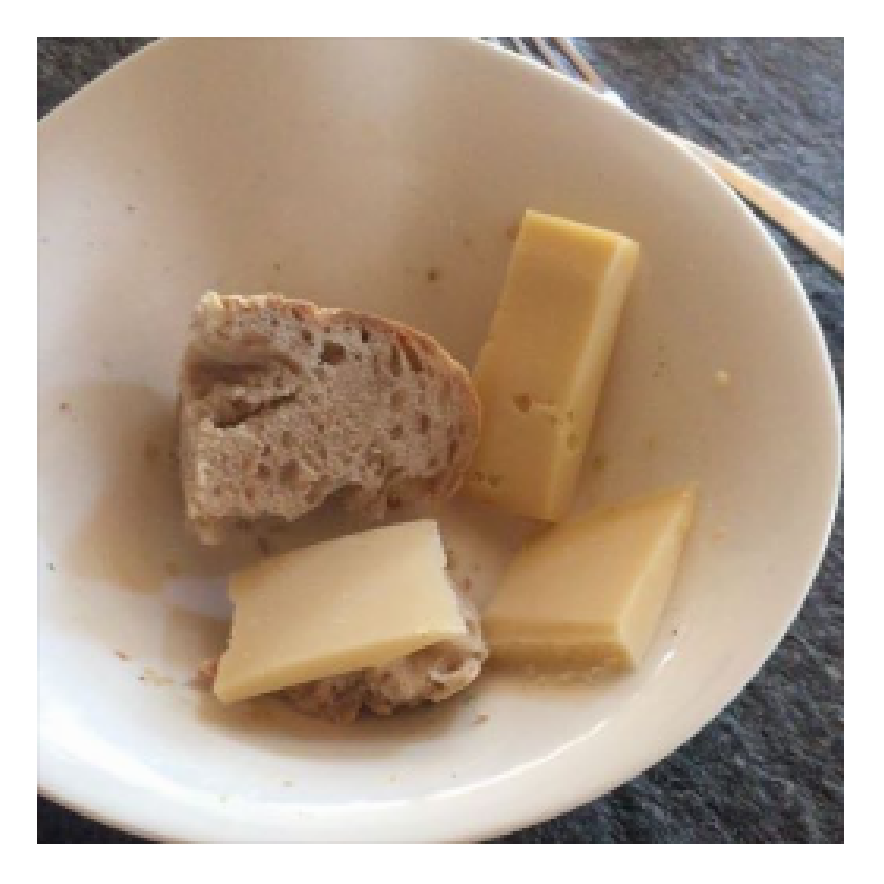

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


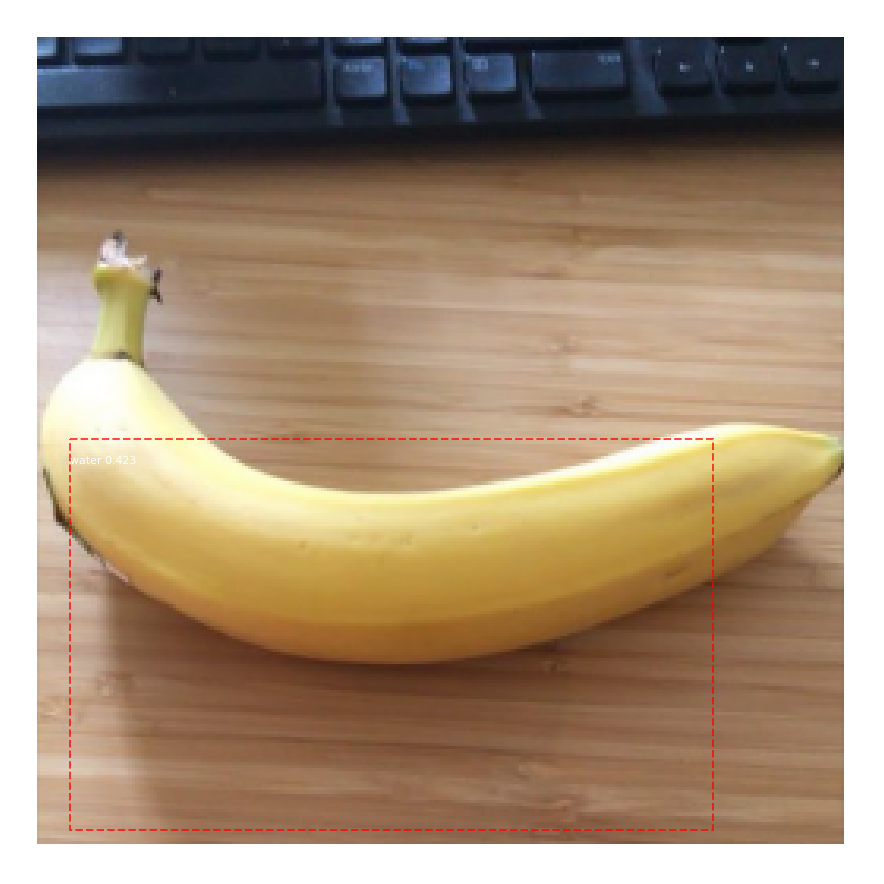

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


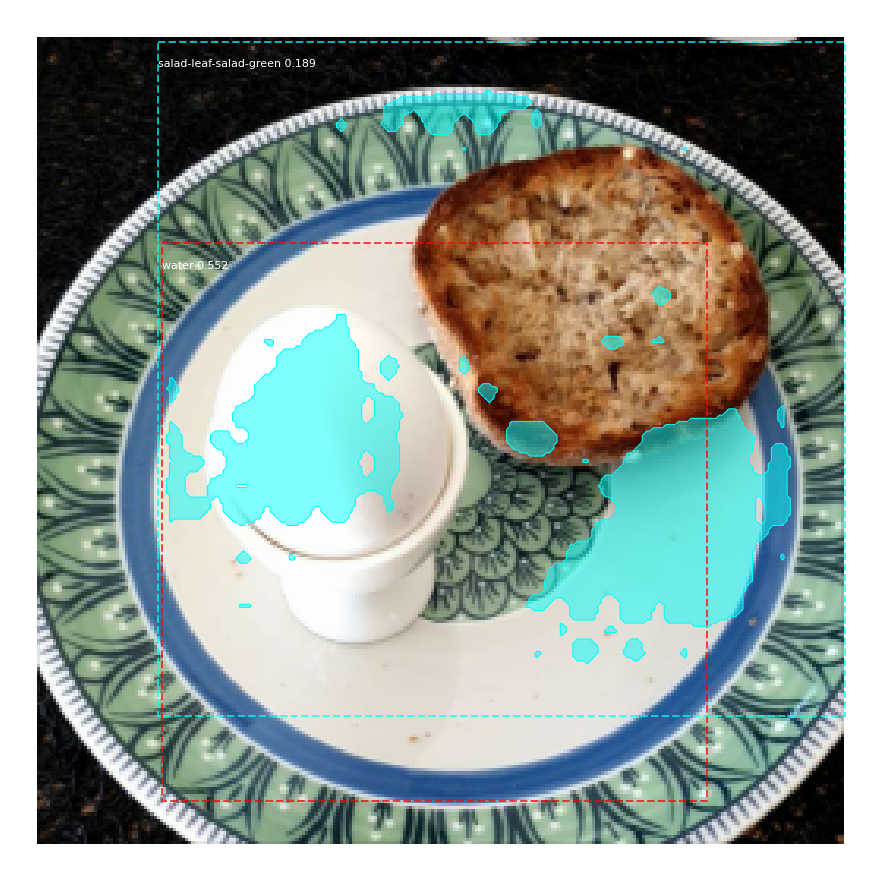

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 3/20
149/150 [============================>.] - ETA: 0s - loss: 1.7405 - rpn_class_loss: 0.0155 - rpn_bbox_loss: 0.4156 - mrcnn_class_loss: 0.2281 - mrcnn_bbox_loss: 0.4716 - mrcnn_mask_loss: 0.6098

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 139s 929ms/step - loss: 1.7346 - rpn_class_loss: 0.0154 - rpn_bbox_loss: 0.4143 - mrcnn_class_loss: 0.2270 - mrcnn_bbox_loss: 0.4698 - mrcnn_mask_loss: 0.6080 - val_loss: 2.0691 - val_rpn_class_loss: 0.0215 - val_rpn_bbox_loss: 0.9267 - val_mrcnn_class_loss: 0.1499 - val_mrcnn_bbox_loss: 0.4450 - val_mrcnn_mask_loss: 0.5261
Uploading images to wandb...


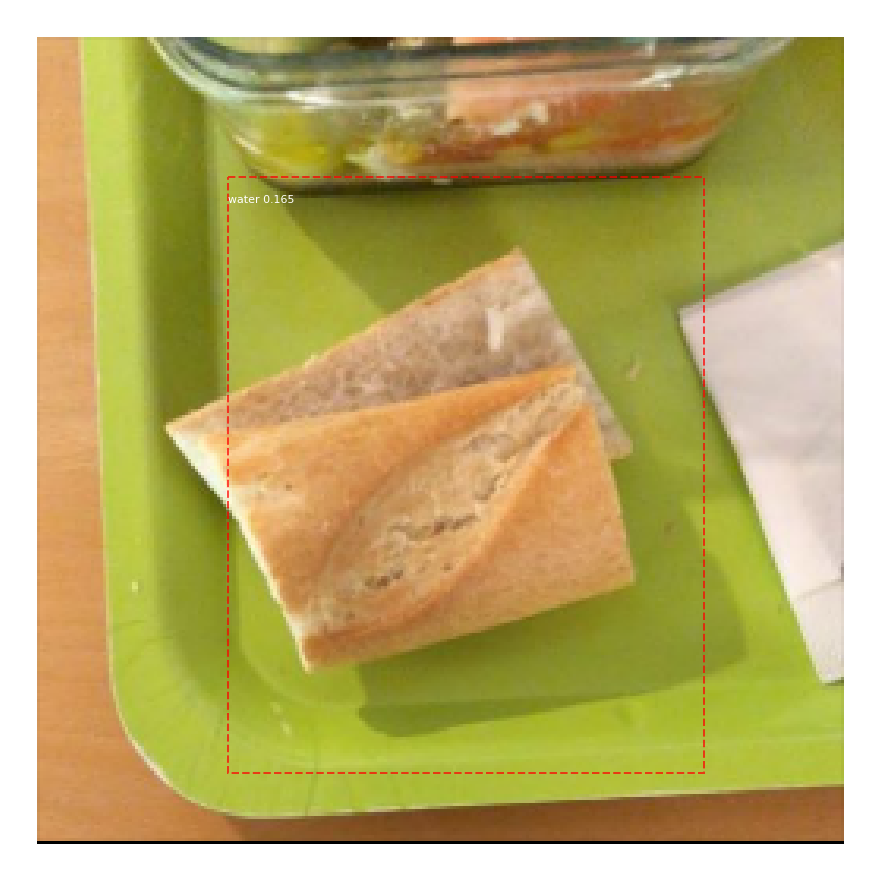

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead



*** No instances to display *** 



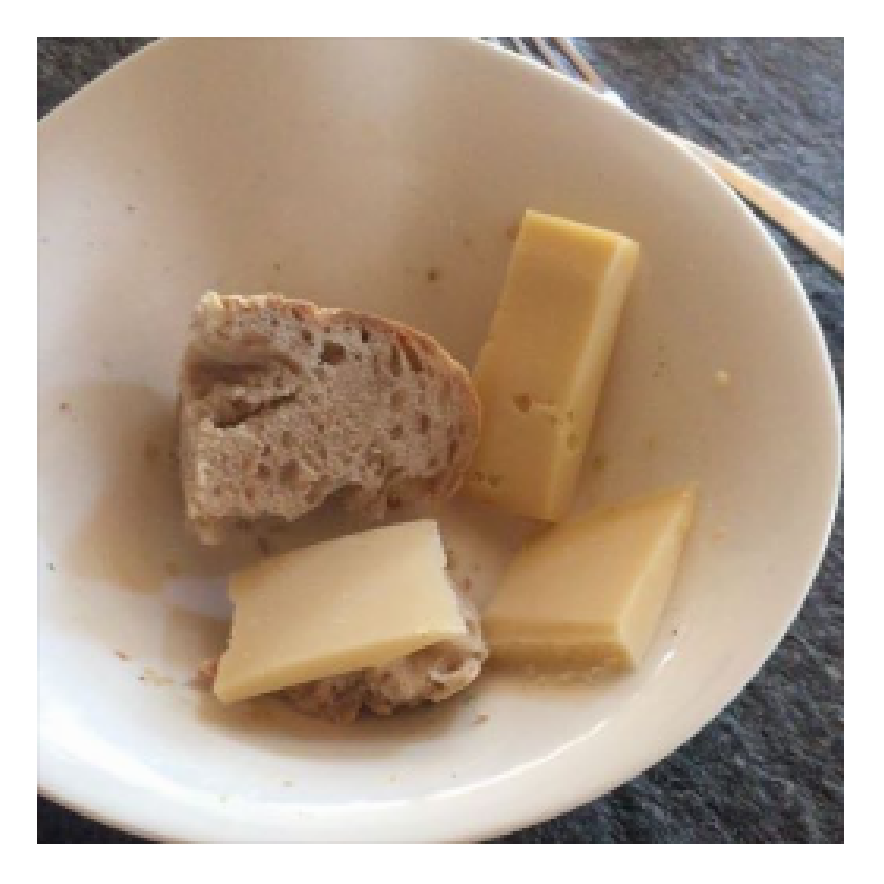

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


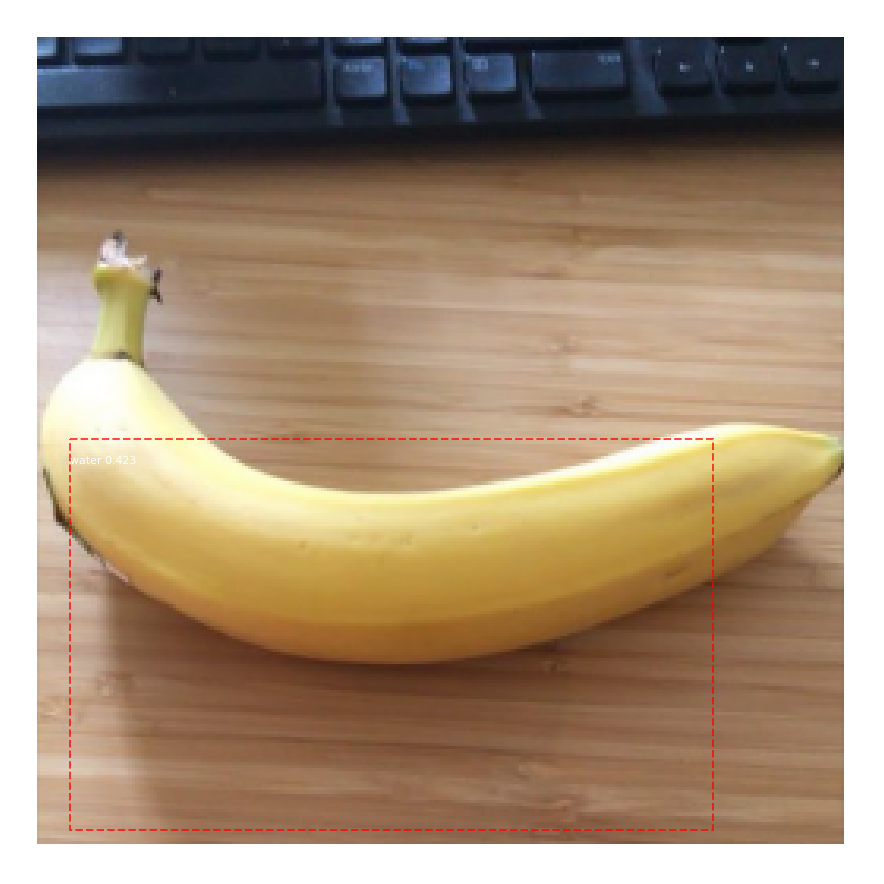

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


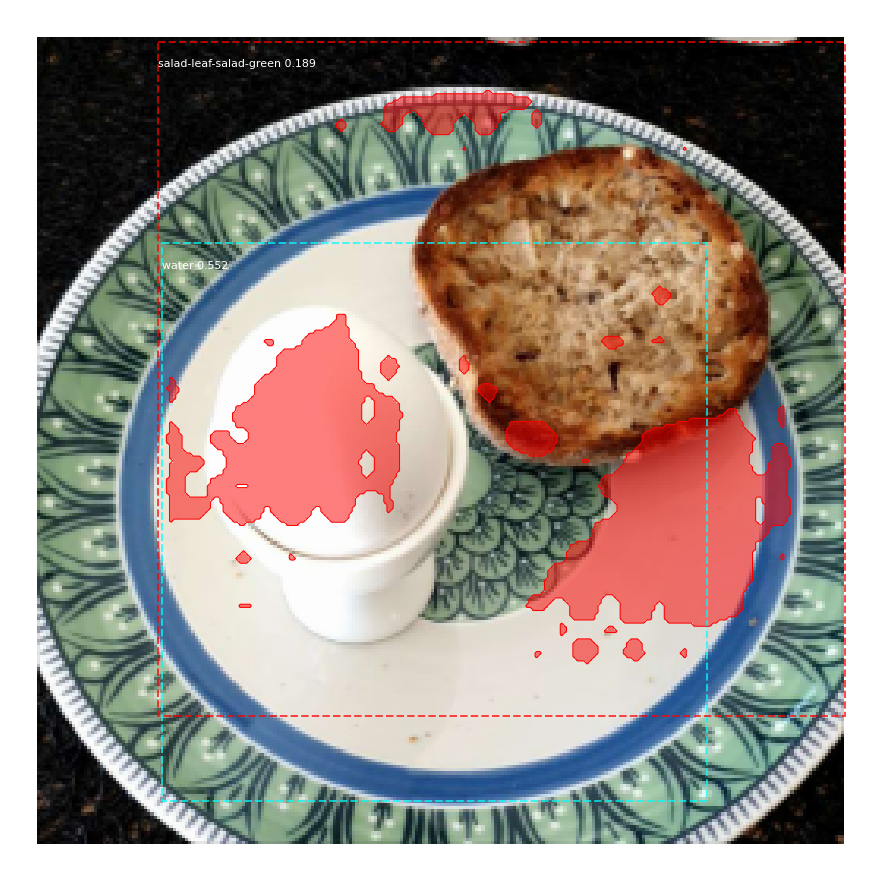

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 4/20
149/150 [============================>.] - ETA: 0s - loss: 1.5254 - rpn_class_loss: 0.0144 - rpn_bbox_loss: 0.3772 - mrcnn_class_loss: 0.2147 - mrcnn_bbox_loss: 0.4049 - mrcnn_mask_loss: 0.5142

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 139s 928ms/step - loss: 1.5211 - rpn_class_loss: 0.0143 - rpn_bbox_loss: 0.3755 - mrcnn_class_loss: 0.2141 - mrcnn_bbox_loss: 0.4034 - mrcnn_mask_loss: 0.5137 - val_loss: 1.5230 - val_rpn_class_loss: 0.0150 - val_rpn_bbox_loss: 0.3348 - val_mrcnn_class_loss: 0.2258 - val_mrcnn_bbox_loss: 0.4025 - val_mrcnn_mask_loss: 0.5448
Uploading images to wandb...


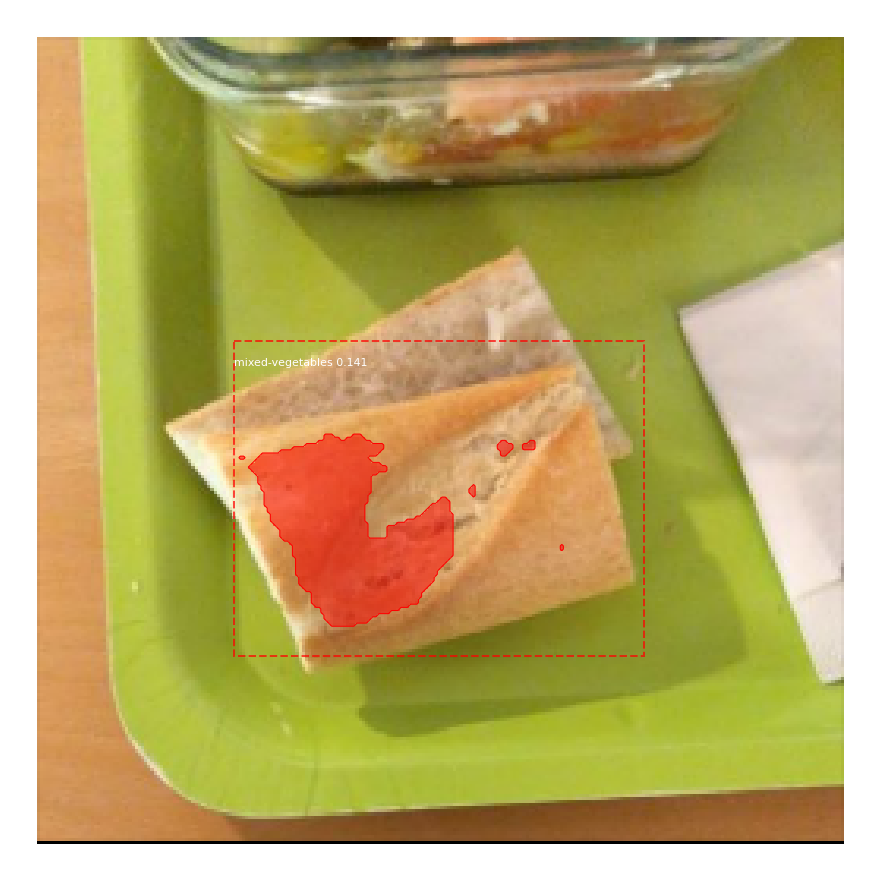

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead



*** No instances to display *** 



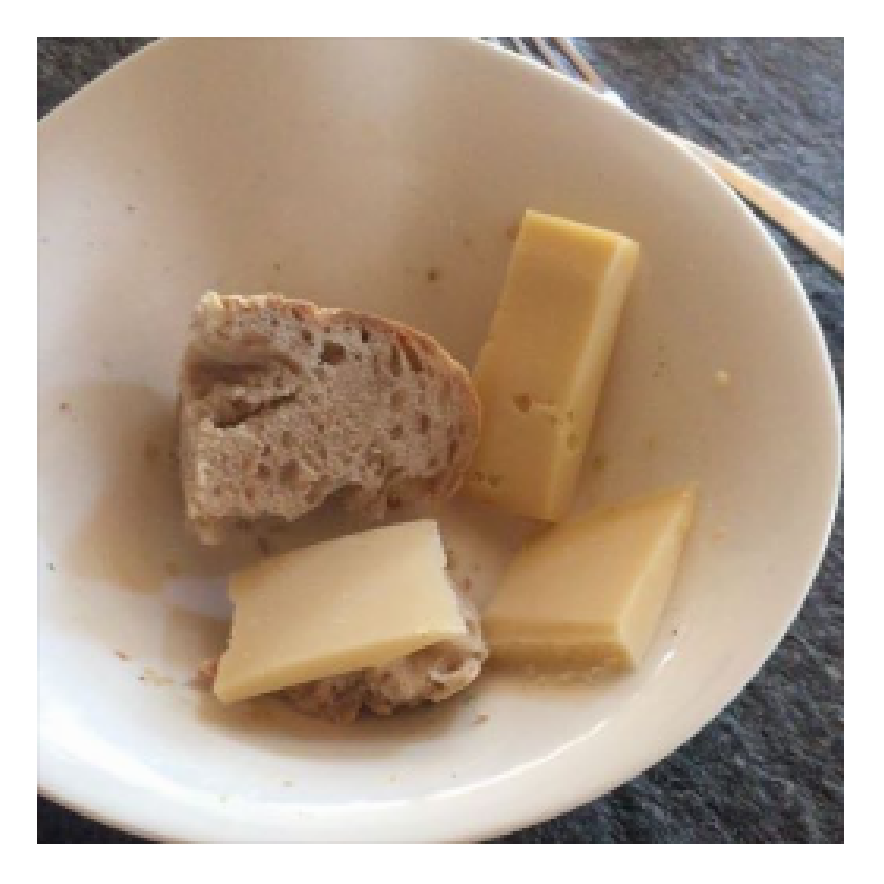

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


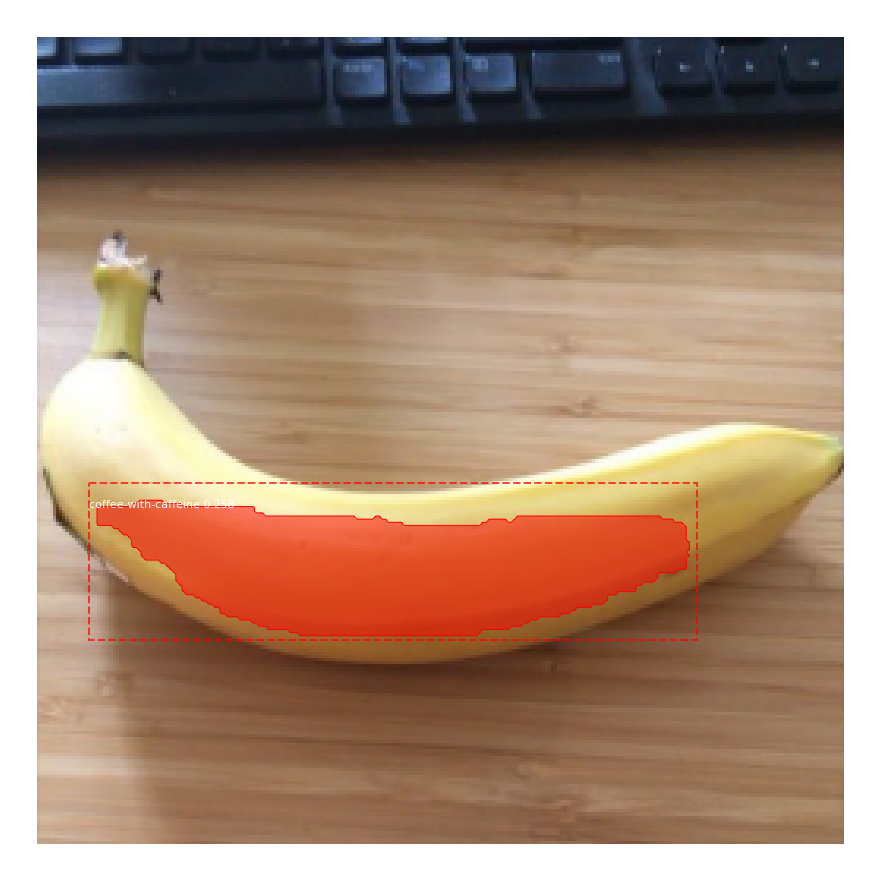

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


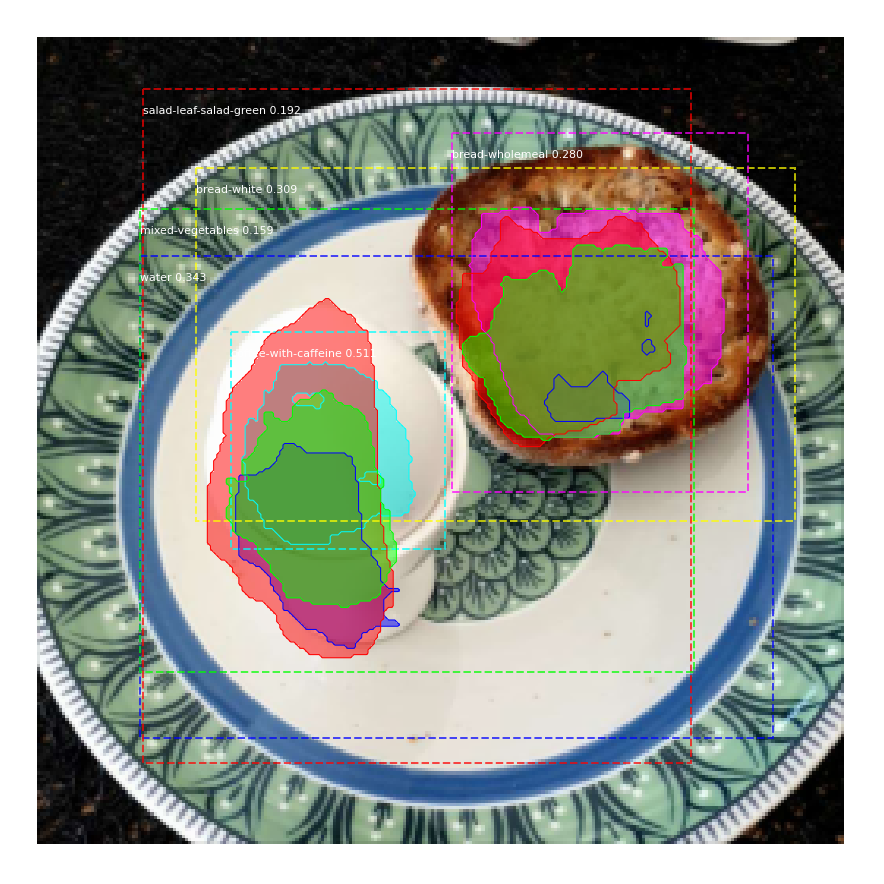

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 5/20
149/150 [============================>.] - ETA: 0s - loss: 1.5083 - rpn_class_loss: 0.0163 - rpn_bbox_loss: 0.3759 - mrcnn_class_loss: 0.2238 - mrcnn_bbox_loss: 0.3846 - mrcnn_mask_loss: 0.5078

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 139s 930ms/step - loss: 1.5064 - rpn_class_loss: 0.0162 - rpn_bbox_loss: 0.3742 - mrcnn_class_loss: 0.2238 - mrcnn_bbox_loss: 0.3839 - mrcnn_mask_loss: 0.5083 - val_loss: 1.4636 - val_rpn_class_loss: 0.0149 - val_rpn_bbox_loss: 0.3086 - val_mrcnn_class_loss: 0.2571 - val_mrcnn_bbox_loss: 0.3682 - val_mrcnn_mask_loss: 0.5149
Uploading images to wandb...


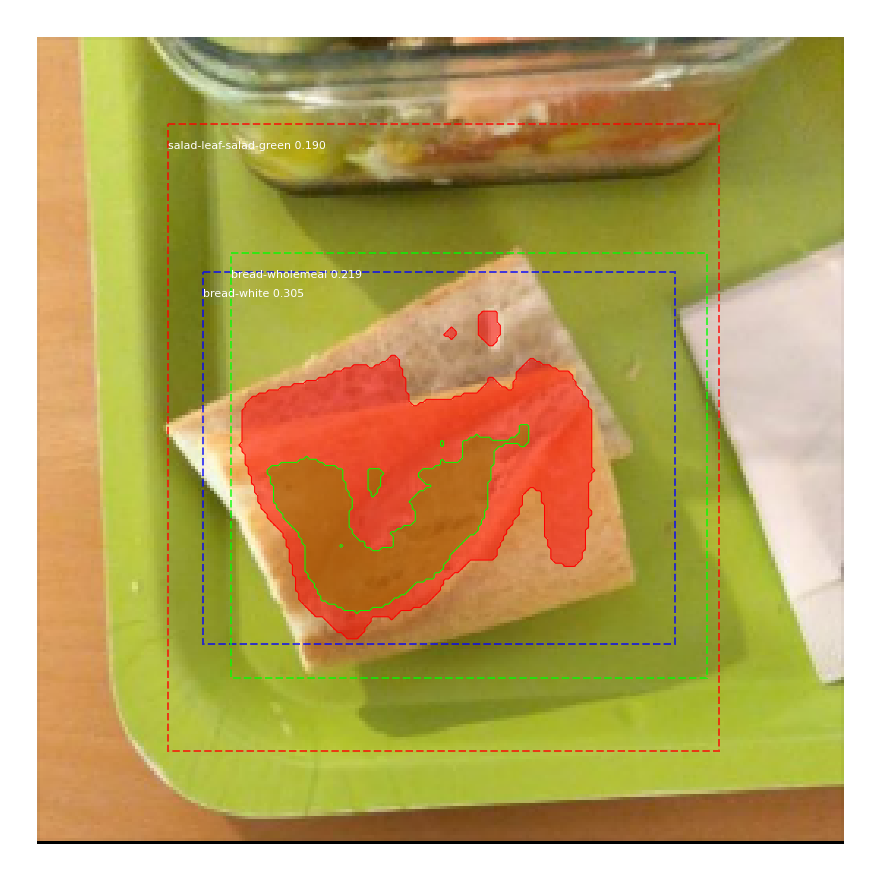

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


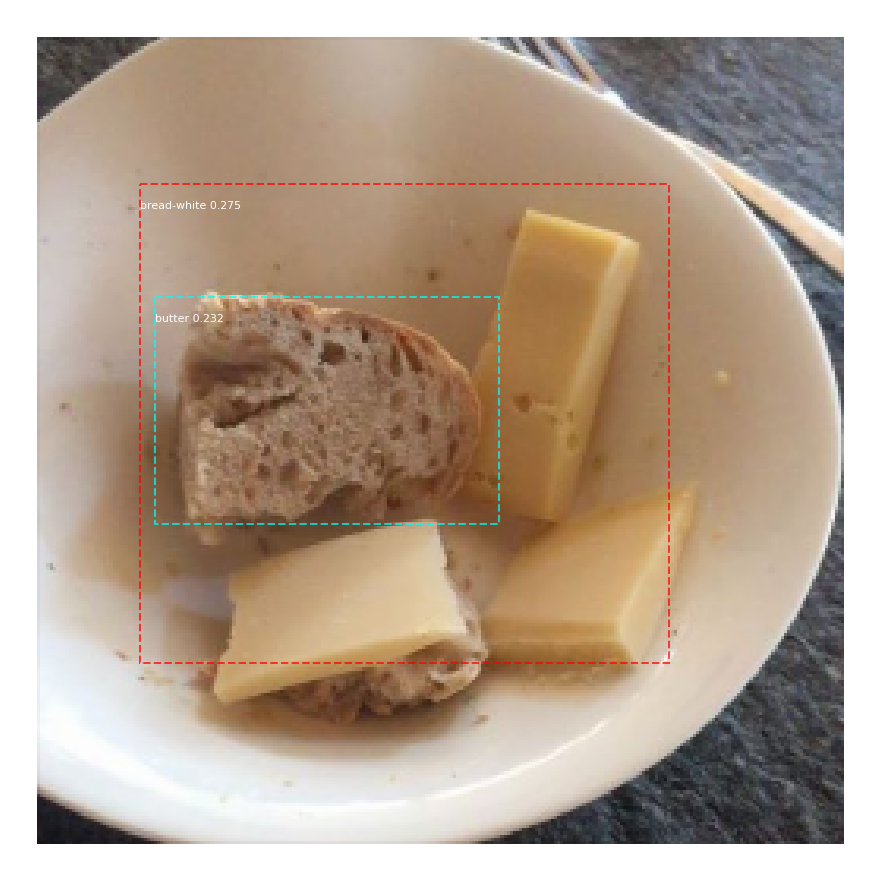

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


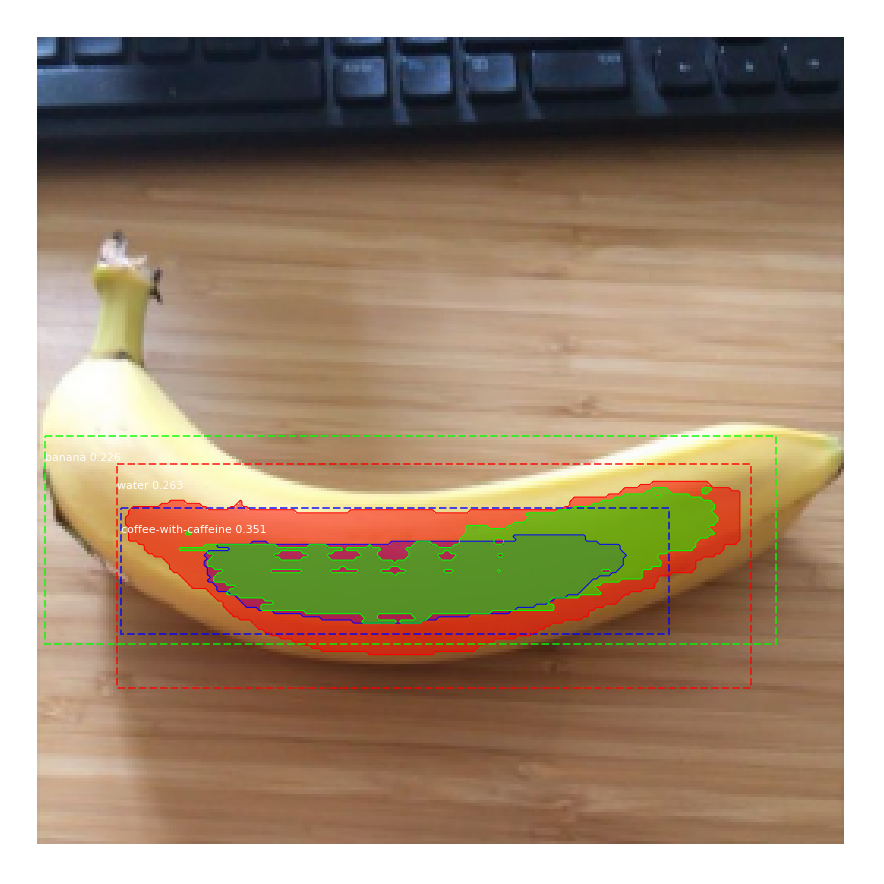

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


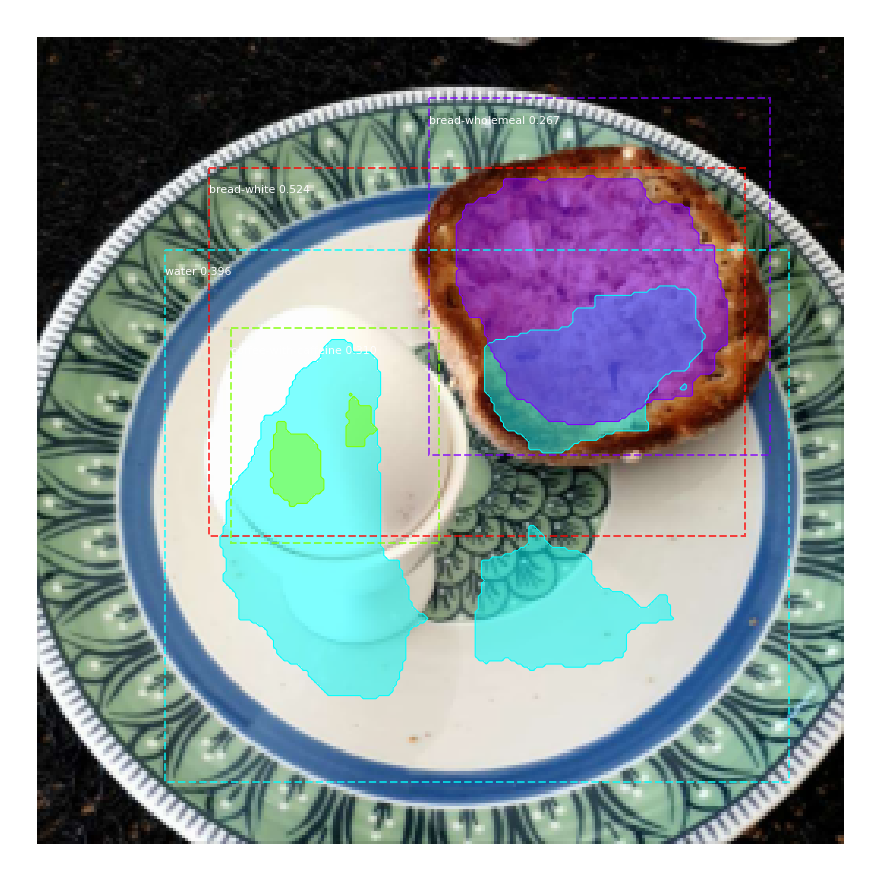

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 6/20
149/150 [============================>.] - ETA: 0s - loss: 1.4389 - rpn_class_loss: 0.0136 - rpn_bbox_loss: 0.3174 - mrcnn_class_loss: 0.2256 - mrcnn_bbox_loss: 0.3747 - mrcnn_mask_loss: 0.5076

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 140s 931ms/step - loss: 1.4352 - rpn_class_loss: 0.0136 - rpn_bbox_loss: 0.3167 - mrcnn_class_loss: 0.2247 - mrcnn_bbox_loss: 0.3736 - mrcnn_mask_loss: 0.5066 - val_loss: 1.3812 - val_rpn_class_loss: 0.0124 - val_rpn_bbox_loss: 0.3018 - val_mrcnn_class_loss: 0.1891 - val_mrcnn_bbox_loss: 0.3817 - val_mrcnn_mask_loss: 0.4962
Uploading images to wandb...


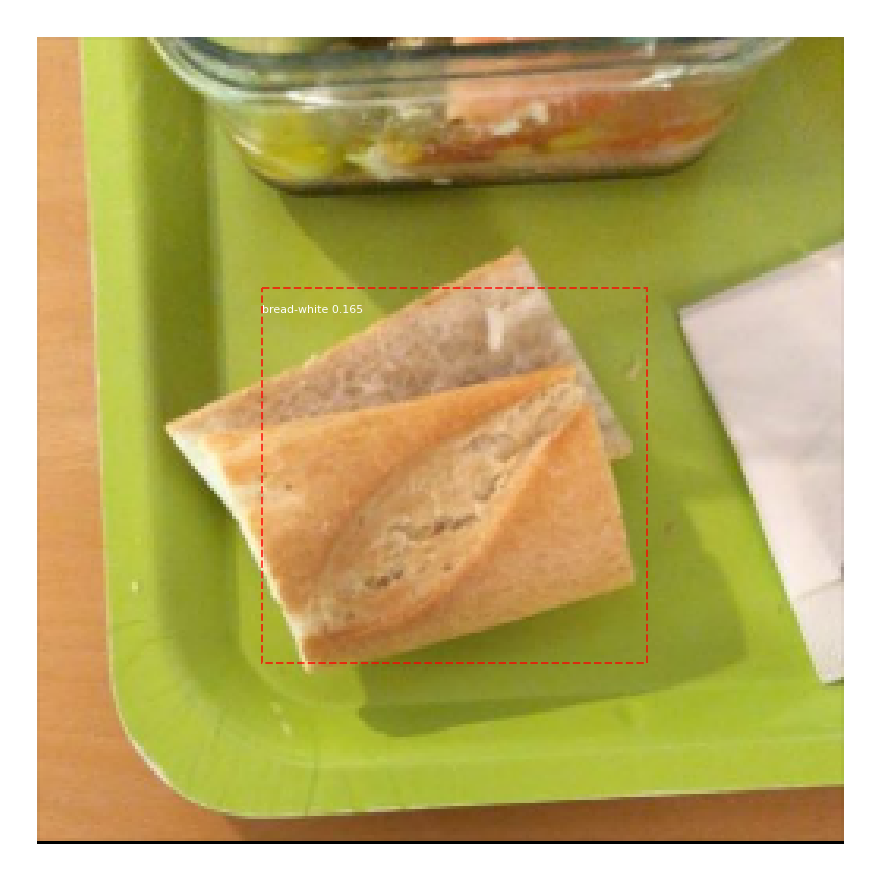

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


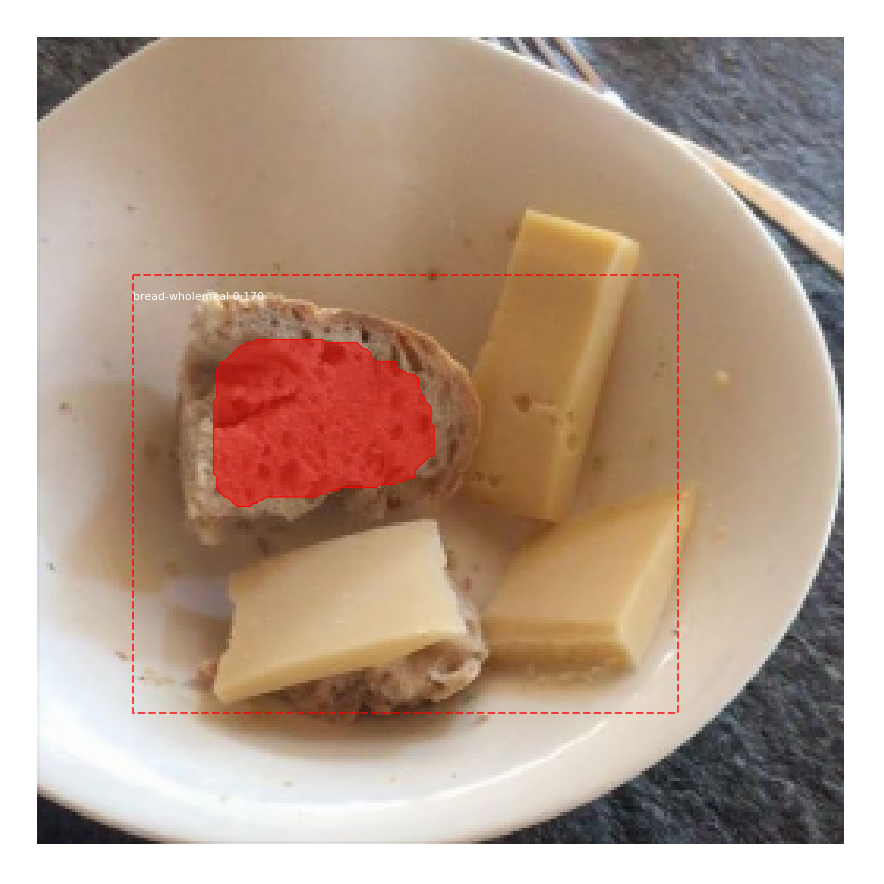

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead



*** No instances to display *** 



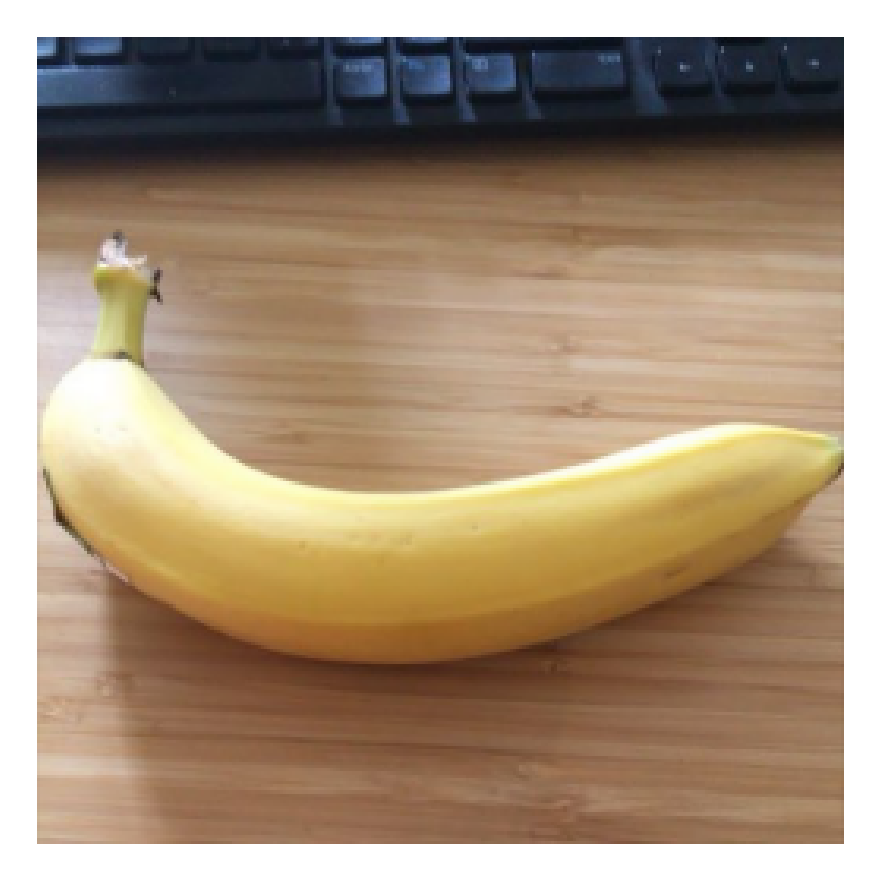

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


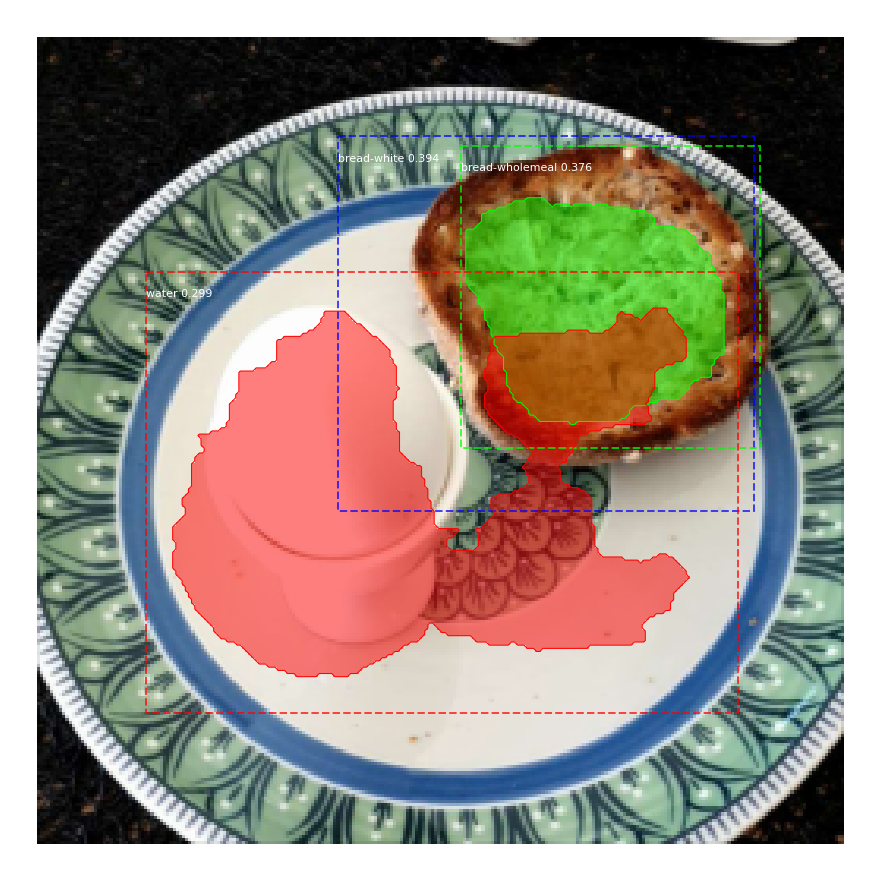

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 7/20
149/150 [============================>.] - ETA: 0s - loss: 1.3649 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.2971 - mrcnn_class_loss: 0.1970 - mrcnn_bbox_loss: 0.3531 - mrcnn_mask_loss: 0.5060

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 139s 928ms/step - loss: 1.3648 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.2968 - mrcnn_class_loss: 0.1964 - mrcnn_bbox_loss: 0.3536 - mrcnn_mask_loss: 0.5062 - val_loss: 1.3969 - val_rpn_class_loss: 0.0156 - val_rpn_bbox_loss: 0.2874 - val_mrcnn_class_loss: 0.2266 - val_mrcnn_bbox_loss: 0.3541 - val_mrcnn_mask_loss: 0.5132
Uploading images to wandb...


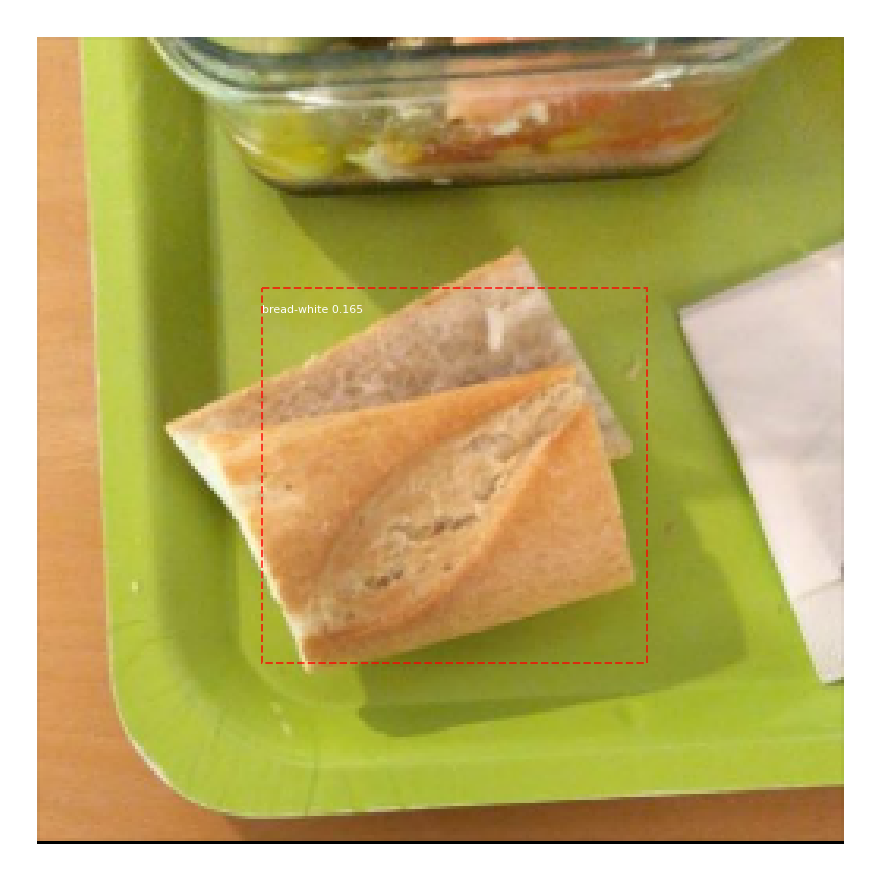

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


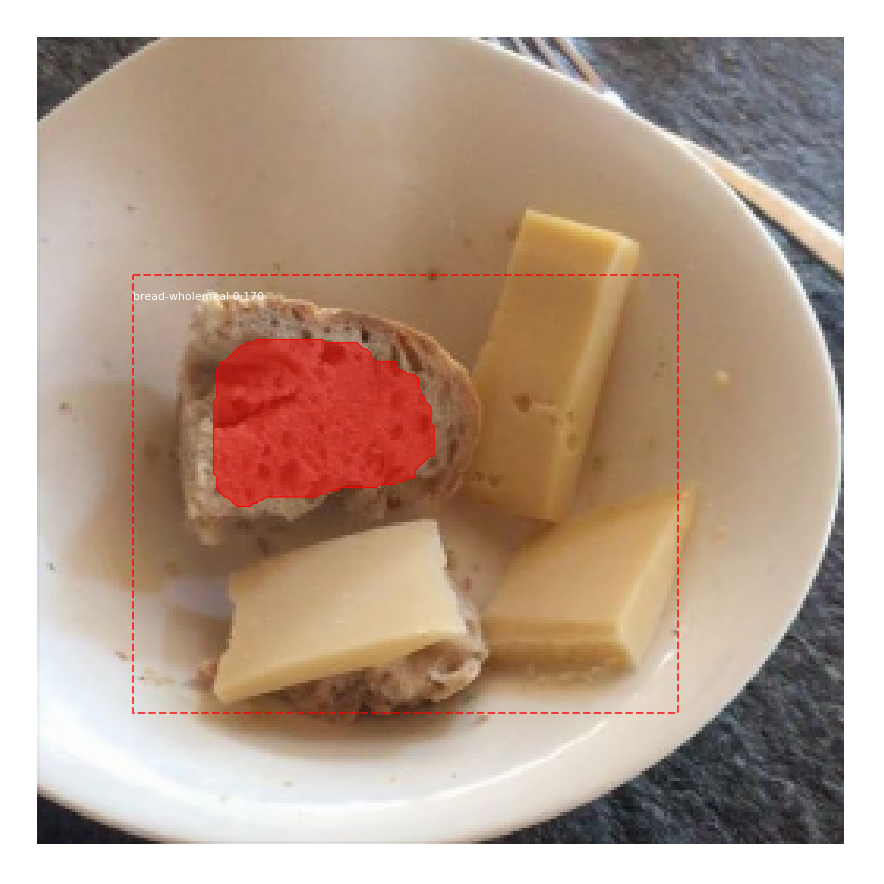

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead



*** No instances to display *** 



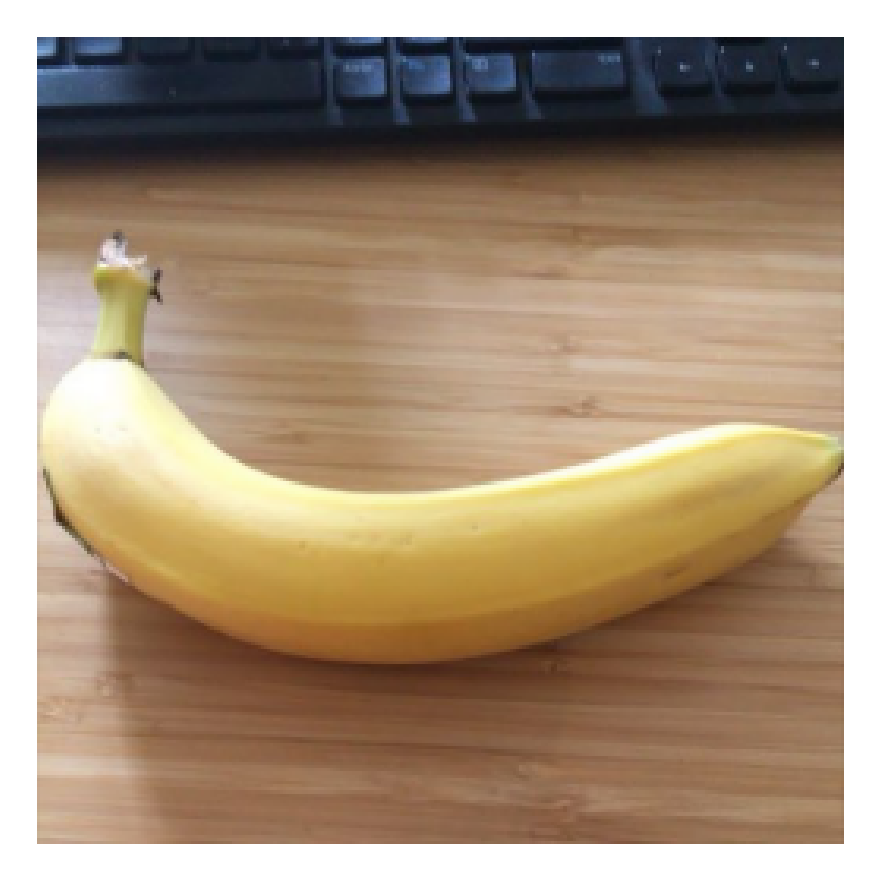

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


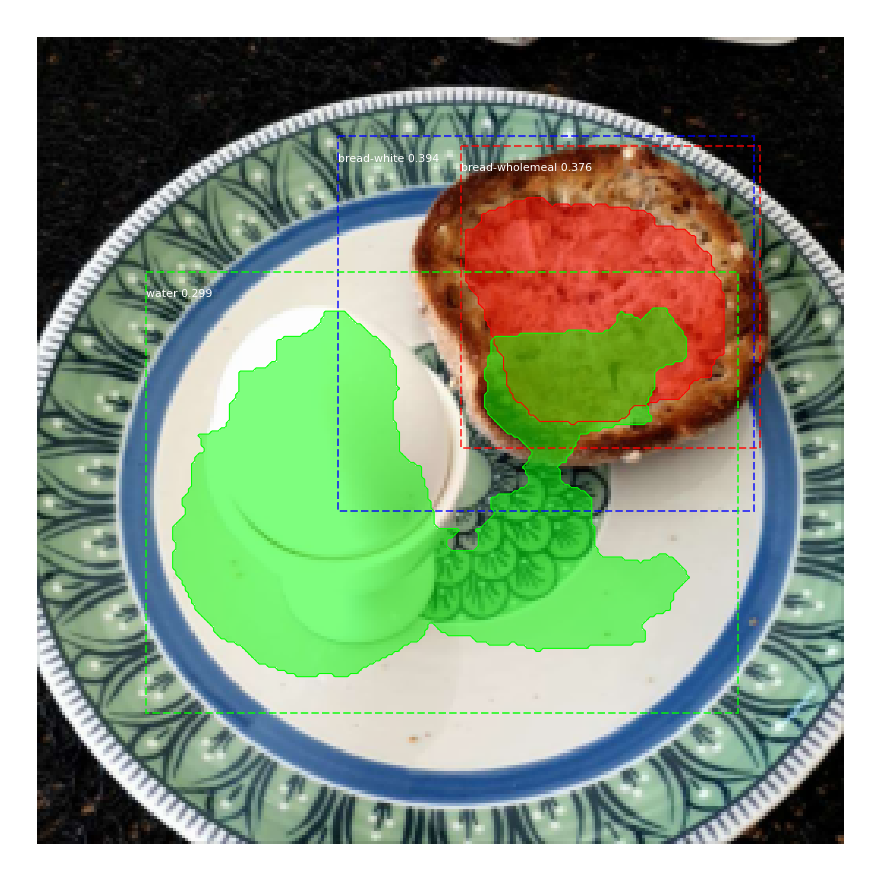

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 8/20
149/150 [============================>.] - ETA: 0s - loss: 1.3996 - rpn_class_loss: 0.0128 - rpn_bbox_loss: 0.3455 - mrcnn_class_loss: 0.1914 - mrcnn_bbox_loss: 0.3585 - mrcnn_mask_loss: 0.4914

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 140s 933ms/step - loss: 1.4060 - rpn_class_loss: 0.0129 - rpn_bbox_loss: 0.3499 - mrcnn_class_loss: 0.1908 - mrcnn_bbox_loss: 0.3606 - mrcnn_mask_loss: 0.4918 - val_loss: 1.4008 - val_rpn_class_loss: 0.0111 - val_rpn_bbox_loss: 0.3295 - val_mrcnn_class_loss: 0.1946 - val_mrcnn_bbox_loss: 0.3727 - val_mrcnn_mask_loss: 0.4929
Uploading images to wandb...


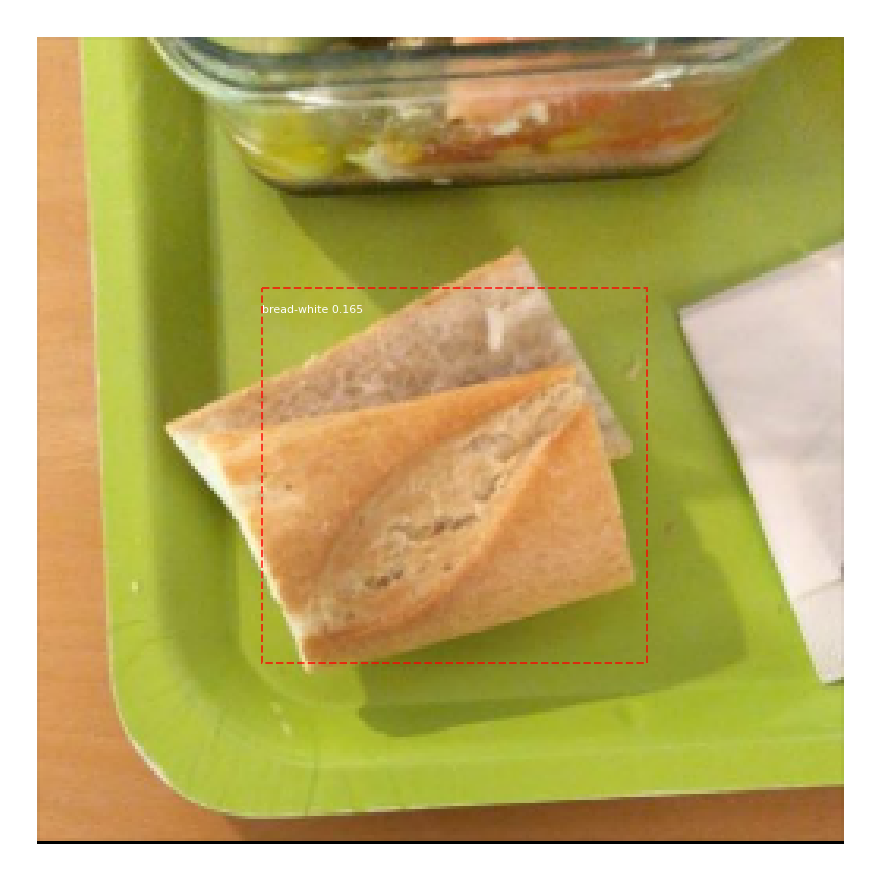

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


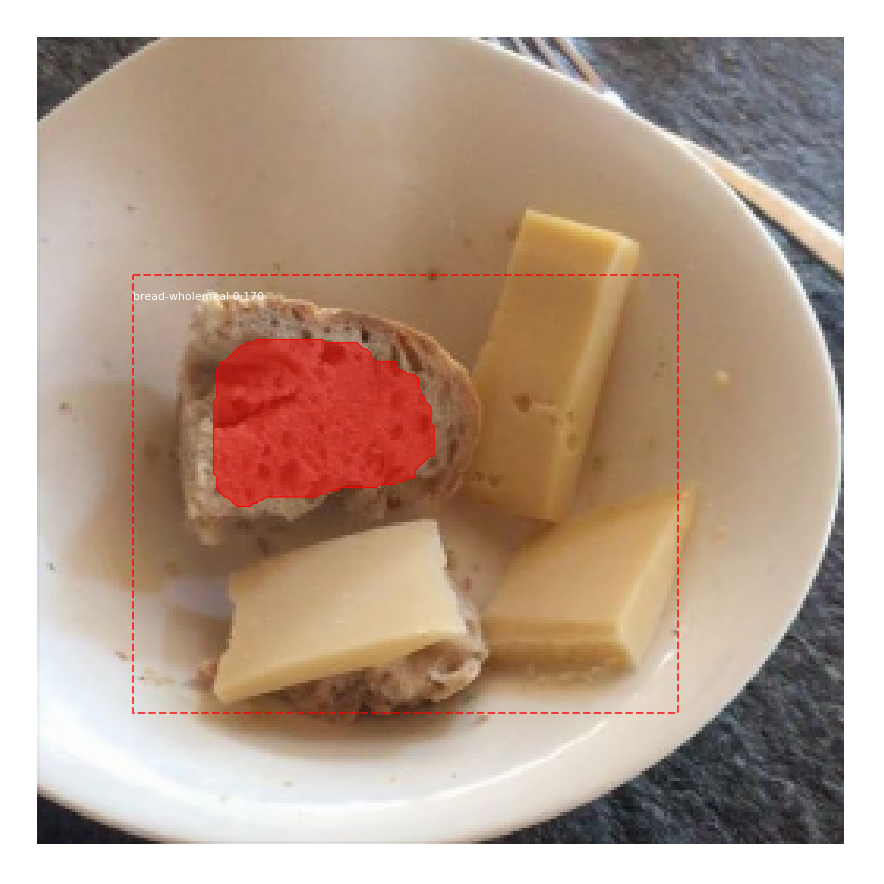

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead



*** No instances to display *** 



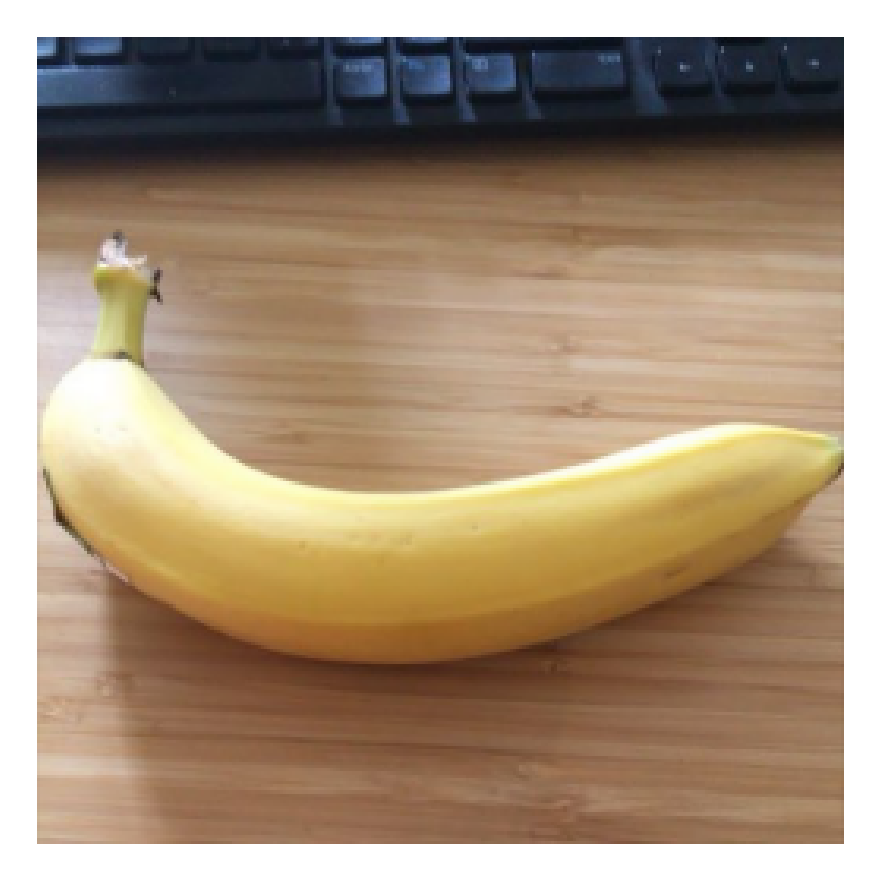

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


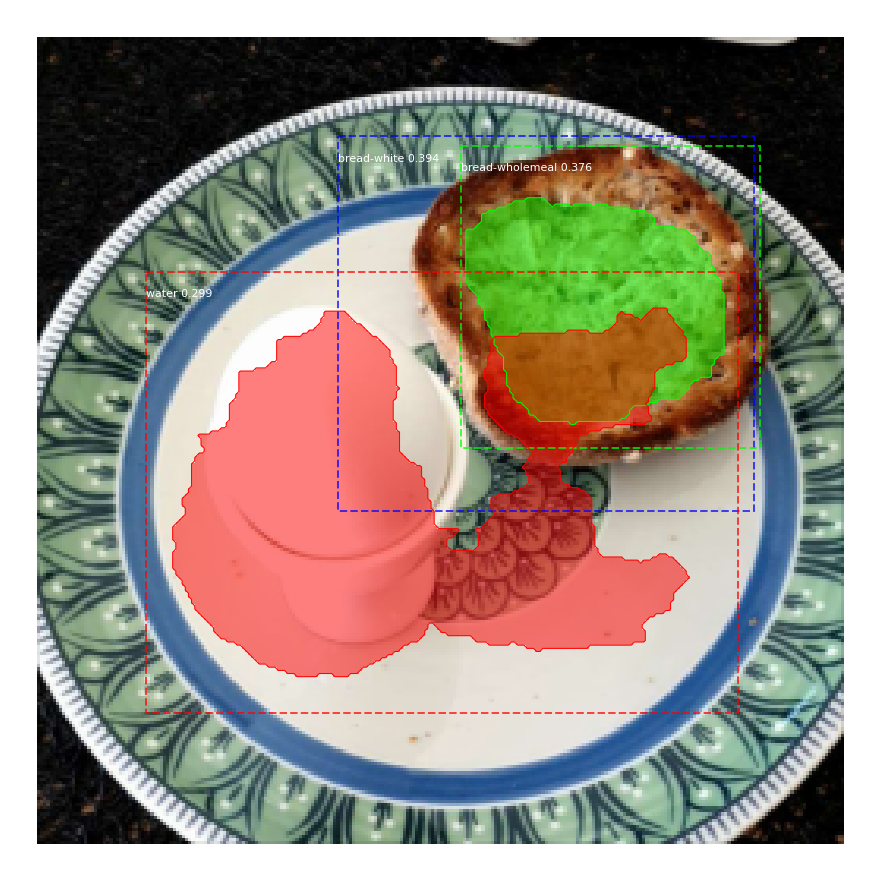

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 9/20
149/150 [============================>.] - ETA: 0s - loss: 1.3846 - rpn_class_loss: 0.0135 - rpn_bbox_loss: 0.3148 - mrcnn_class_loss: 0.2169 - mrcnn_bbox_loss: 0.3437 - mrcnn_mask_loss: 0.4957

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 142s 945ms/step - loss: 1.3818 - rpn_class_loss: 0.0135 - rpn_bbox_loss: 0.3142 - mrcnn_class_loss: 0.2157 - mrcnn_bbox_loss: 0.3431 - mrcnn_mask_loss: 0.4953 - val_loss: 1.5617 - val_rpn_class_loss: 0.0147 - val_rpn_bbox_loss: 0.3891 - val_mrcnn_class_loss: 0.2230 - val_mrcnn_bbox_loss: 0.4072 - val_mrcnn_mask_loss: 0.5276
Uploading images to wandb...


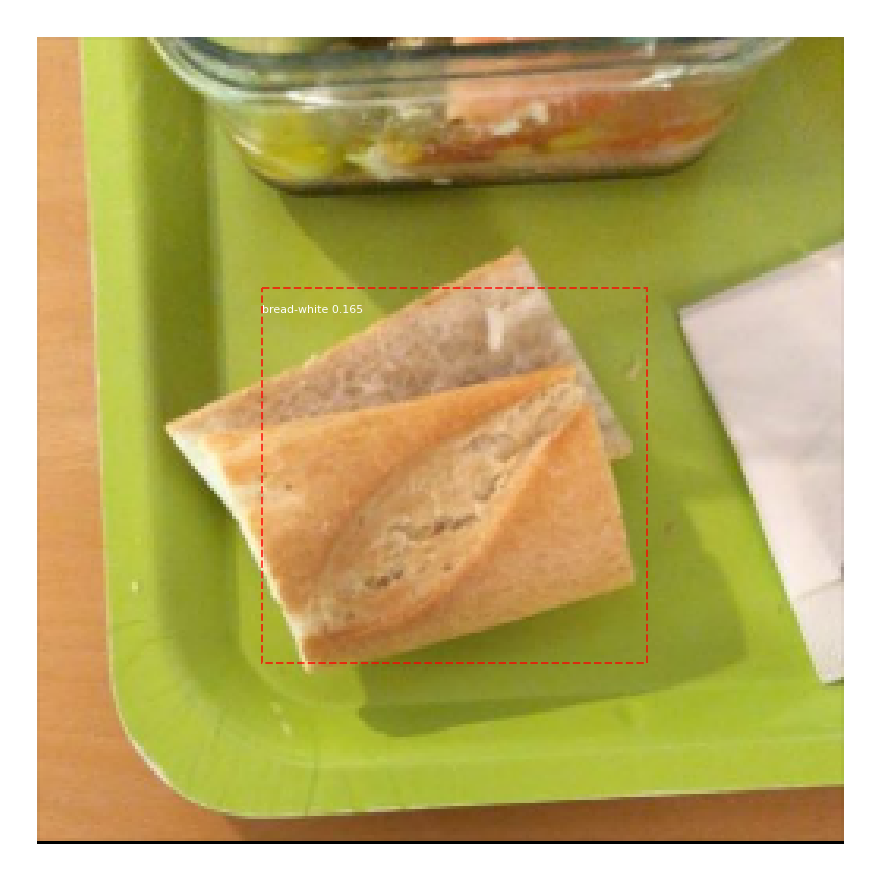

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


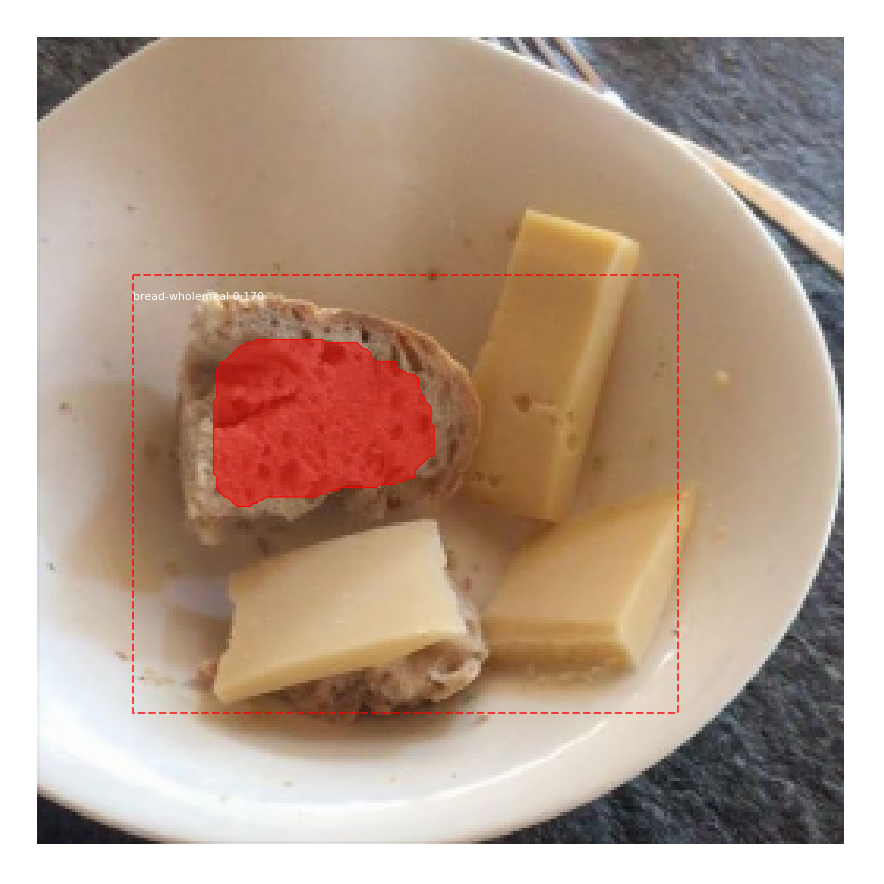

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead



*** No instances to display *** 



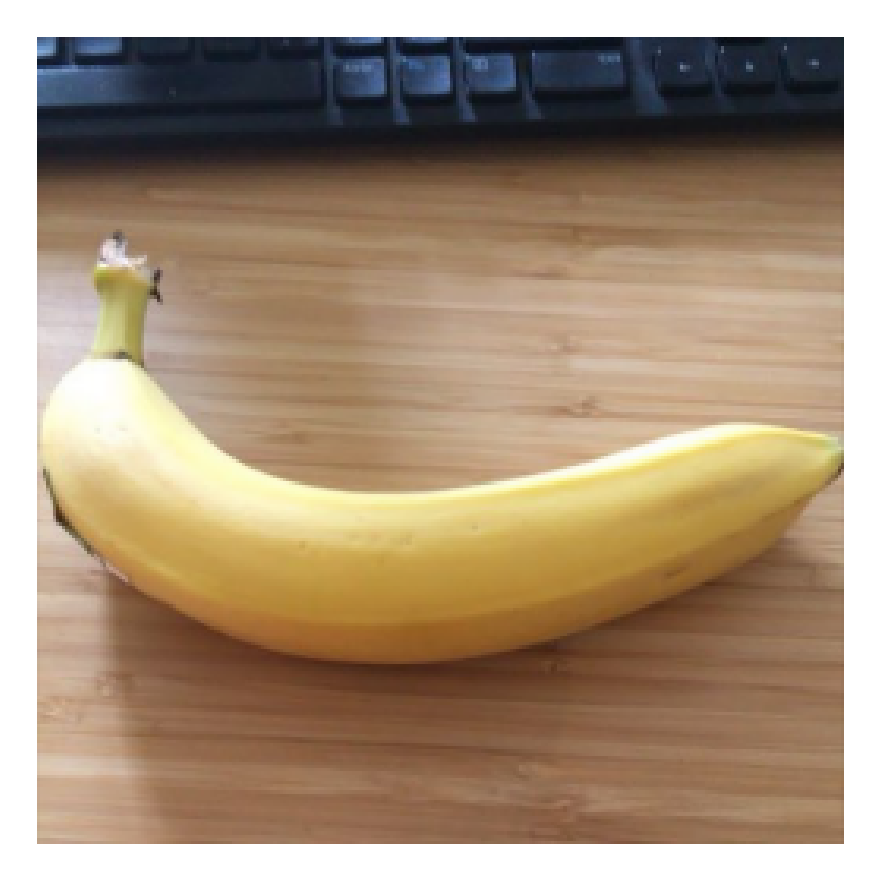

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


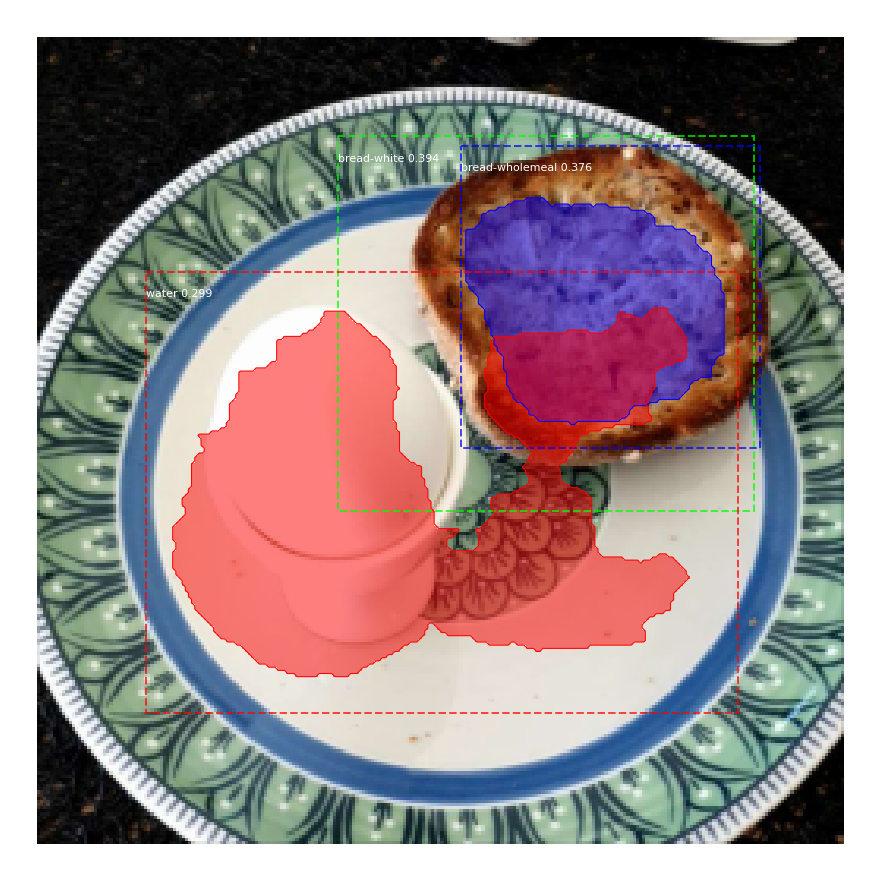

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 10/20
149/150 [============================>.] - ETA: 0s - loss: 1.3311 - rpn_class_loss: 0.0132 - rpn_bbox_loss: 0.2797 - mrcnn_class_loss: 0.2049 - mrcnn_bbox_loss: 0.3315 - mrcnn_mask_loss: 0.5018

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 142s 949ms/step - loss: 1.3317 - rpn_class_loss: 0.0131 - rpn_bbox_loss: 0.2798 - mrcnn_class_loss: 0.2047 - mrcnn_bbox_loss: 0.3313 - mrcnn_mask_loss: 0.5028 - val_loss: 1.3584 - val_rpn_class_loss: 0.0113 - val_rpn_bbox_loss: 0.2645 - val_mrcnn_class_loss: 0.2168 - val_mrcnn_bbox_loss: 0.3627 - val_mrcnn_mask_loss: 0.5031
Uploading images to wandb...


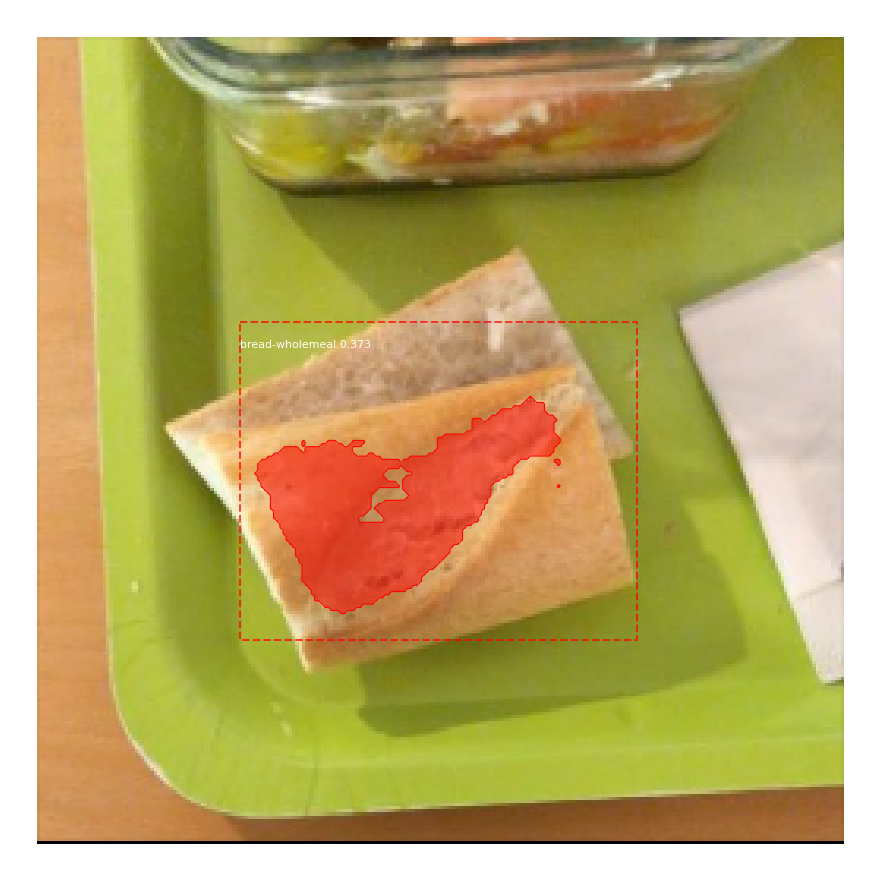

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


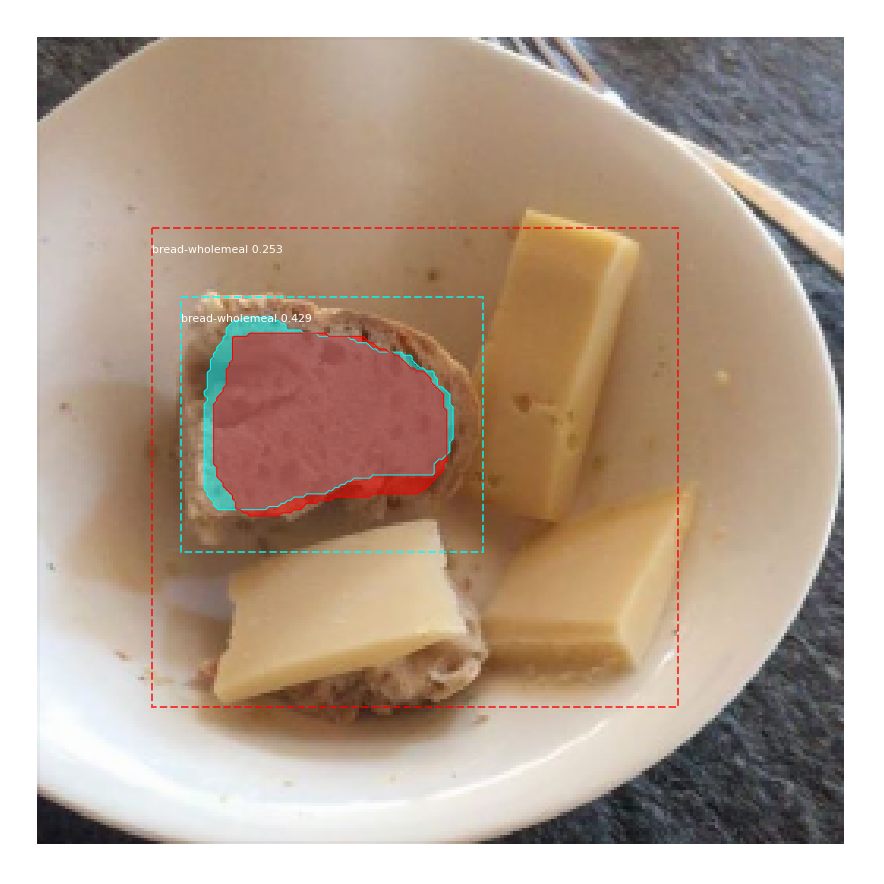

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


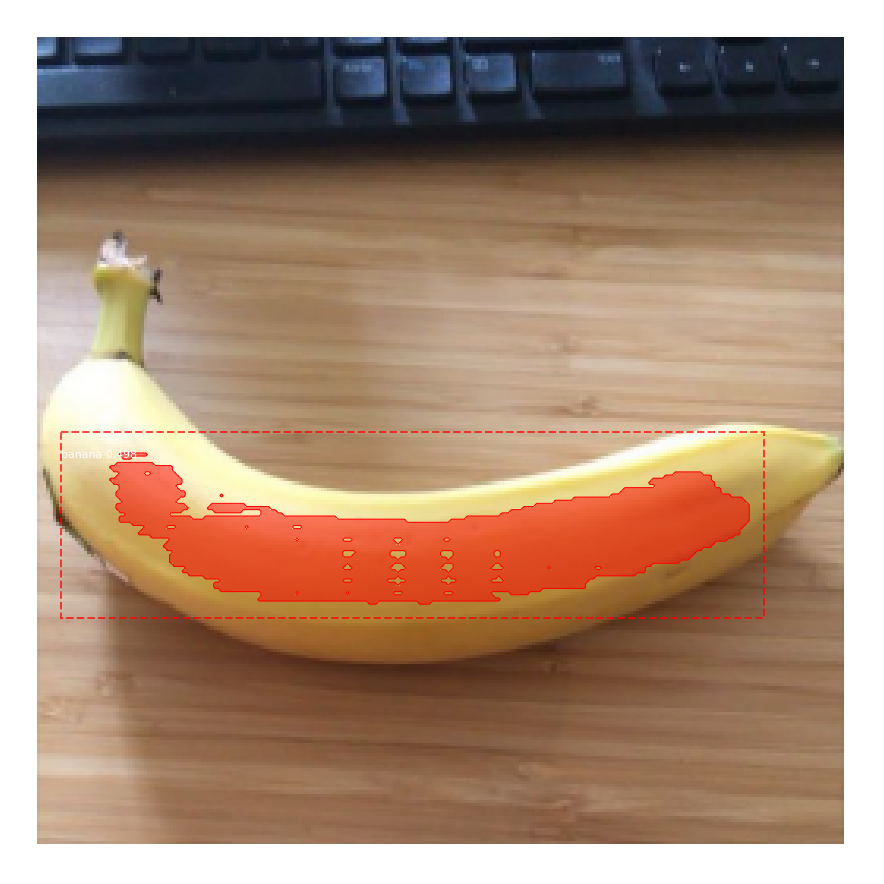

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


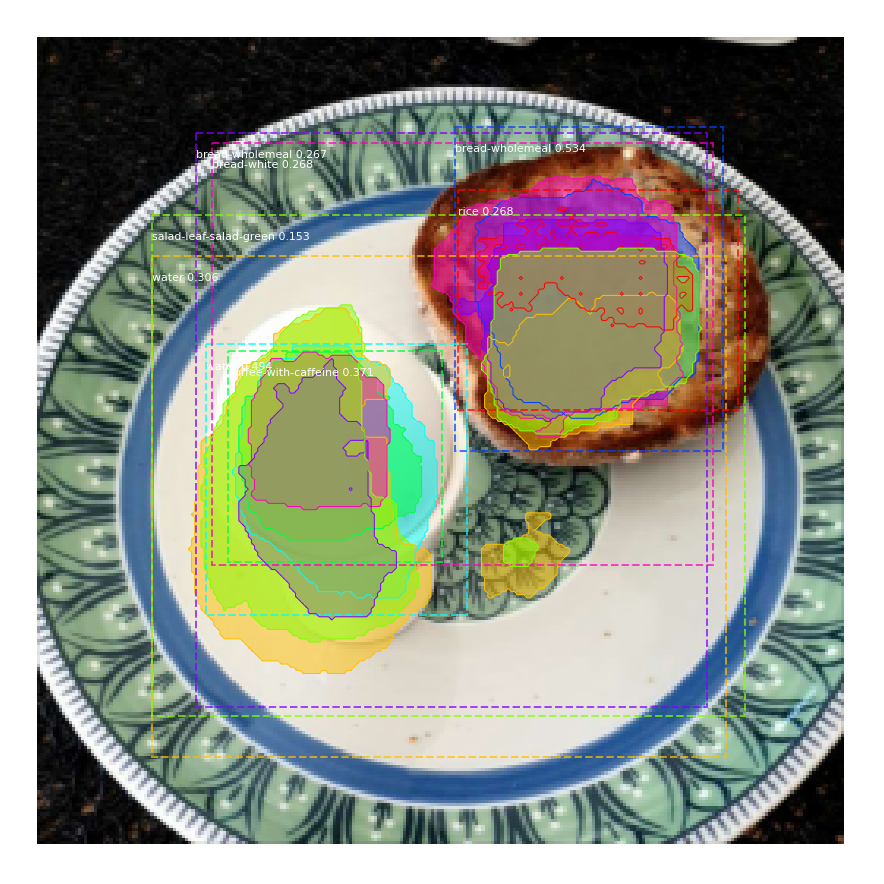

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 11/20
149/150 [============================>.] - ETA: 0s - loss: 1.3103 - rpn_class_loss: 0.0127 - rpn_bbox_loss: 0.3142 - mrcnn_class_loss: 0.2003 - mrcnn_bbox_loss: 0.3119 - mrcnn_mask_loss: 0.4713

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 142s 948ms/step - loss: 1.3107 - rpn_class_loss: 0.0127 - rpn_bbox_loss: 0.3131 - mrcnn_class_loss: 0.2018 - mrcnn_bbox_loss: 0.3121 - mrcnn_mask_loss: 0.4710 - val_loss: 1.3146 - val_rpn_class_loss: 0.0123 - val_rpn_bbox_loss: 0.2520 - val_mrcnn_class_loss: 0.2211 - val_mrcnn_bbox_loss: 0.3209 - val_mrcnn_mask_loss: 0.5084
Uploading images to wandb...


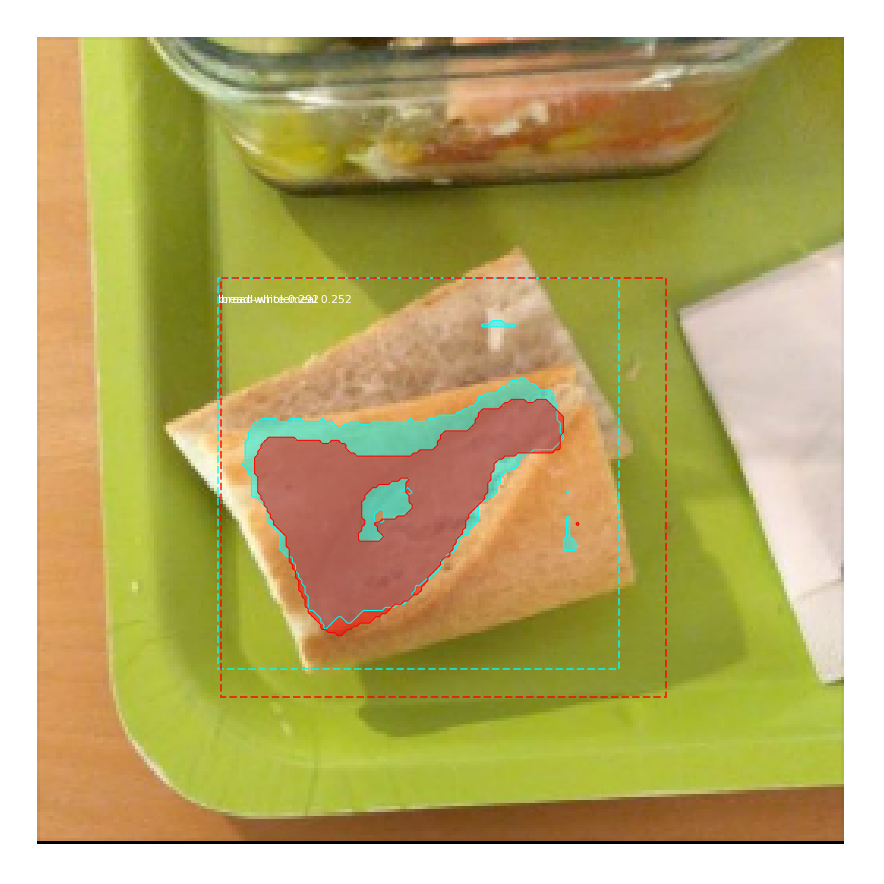

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


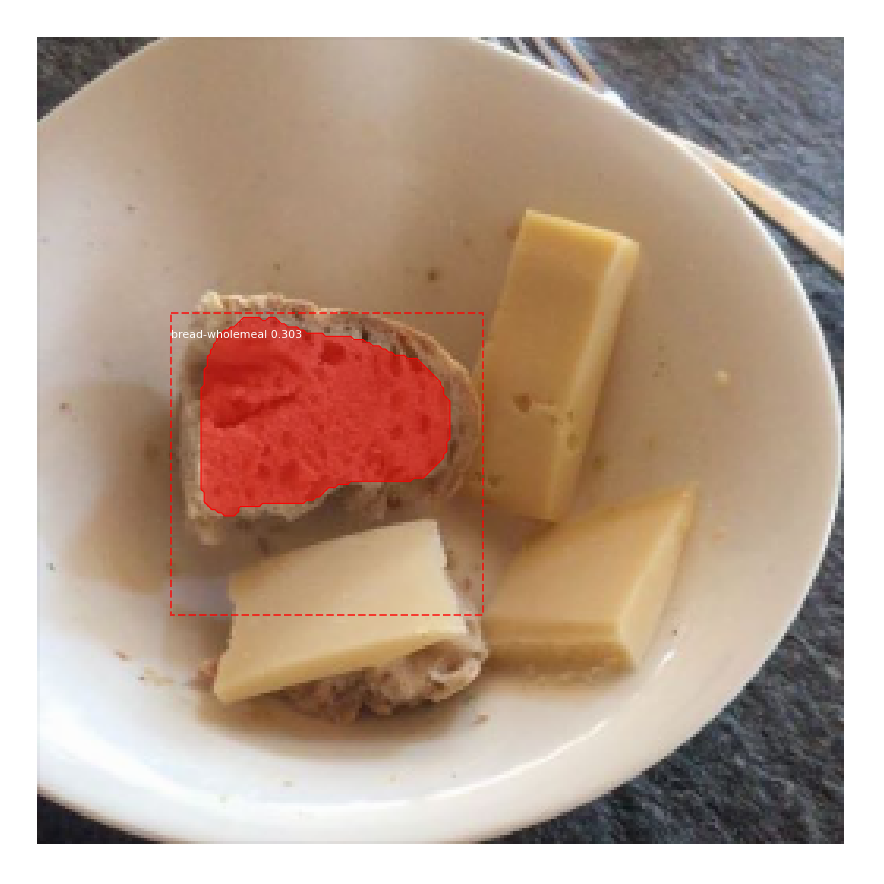

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


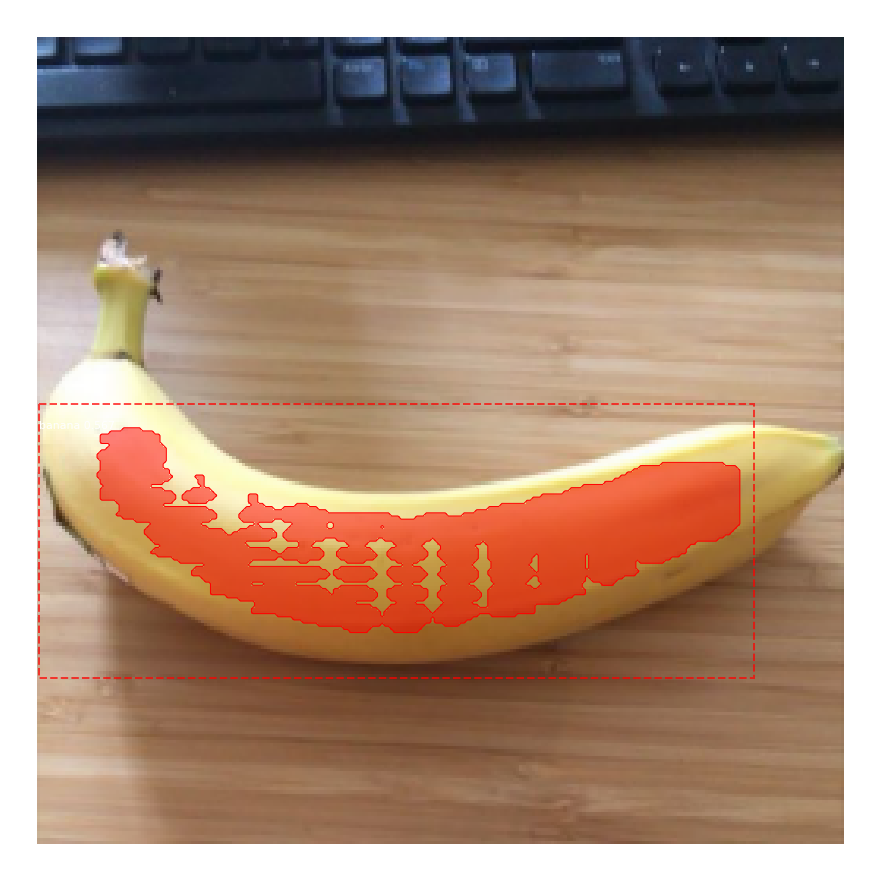

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


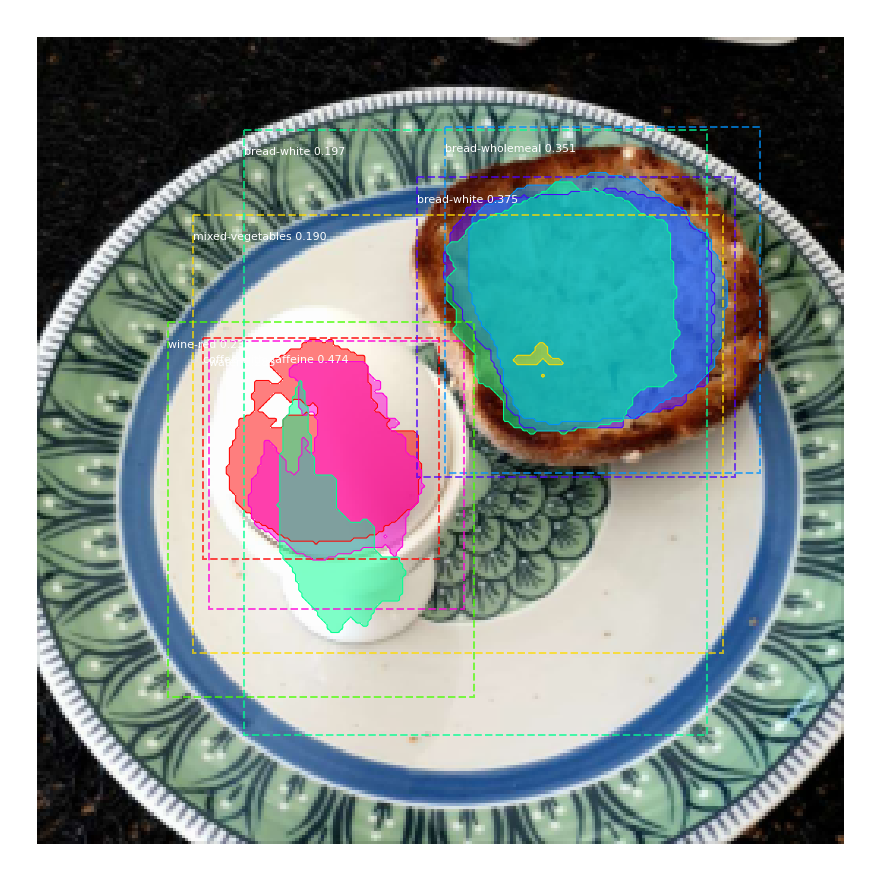

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 12/20
149/150 [============================>.] - ETA: 0s - loss: 1.2814 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.2748 - mrcnn_class_loss: 0.1976 - mrcnn_bbox_loss: 0.3096 - mrcnn_mask_loss: 0.4885

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 143s 956ms/step - loss: 1.2861 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.2784 - mrcnn_class_loss: 0.1982 - mrcnn_bbox_loss: 0.3099 - mrcnn_mask_loss: 0.4886 - val_loss: 1.2783 - val_rpn_class_loss: 0.0107 - val_rpn_bbox_loss: 0.3063 - val_mrcnn_class_loss: 0.1707 - val_mrcnn_bbox_loss: 0.3205 - val_mrcnn_mask_loss: 0.4701
Uploading images to wandb...


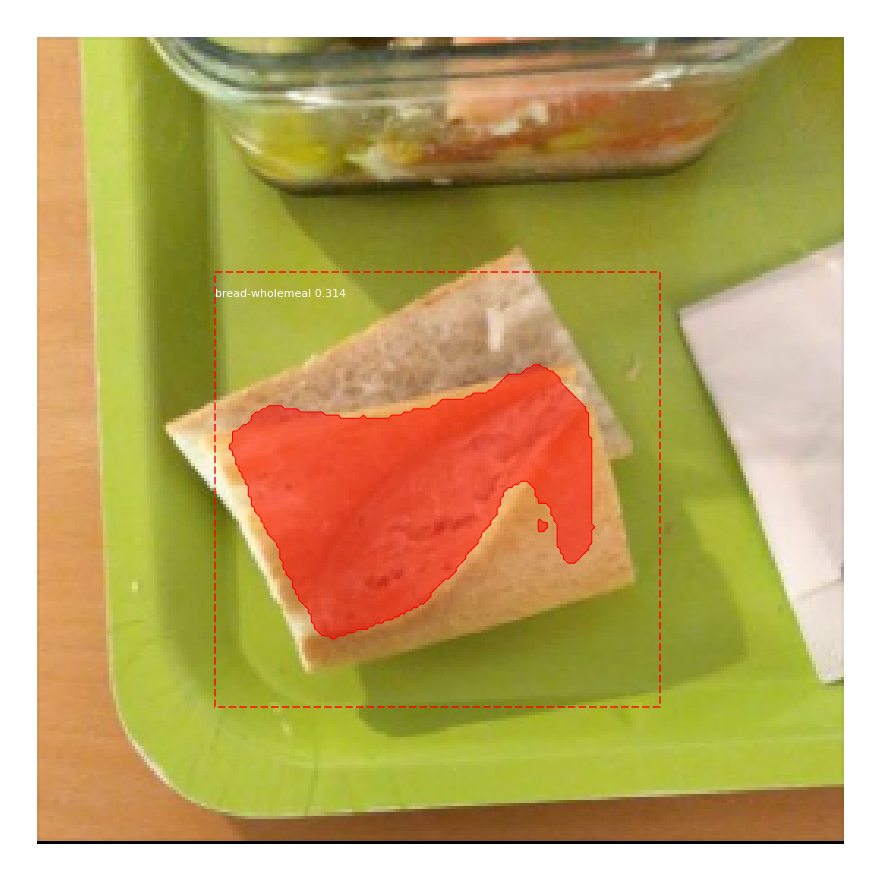

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


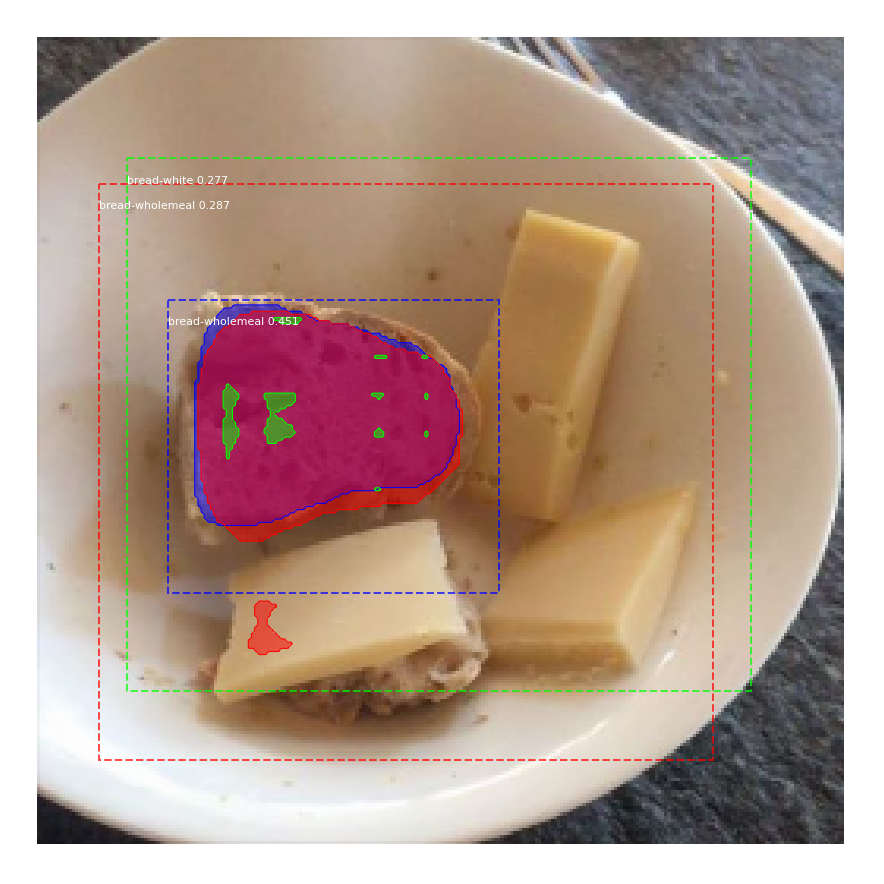

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


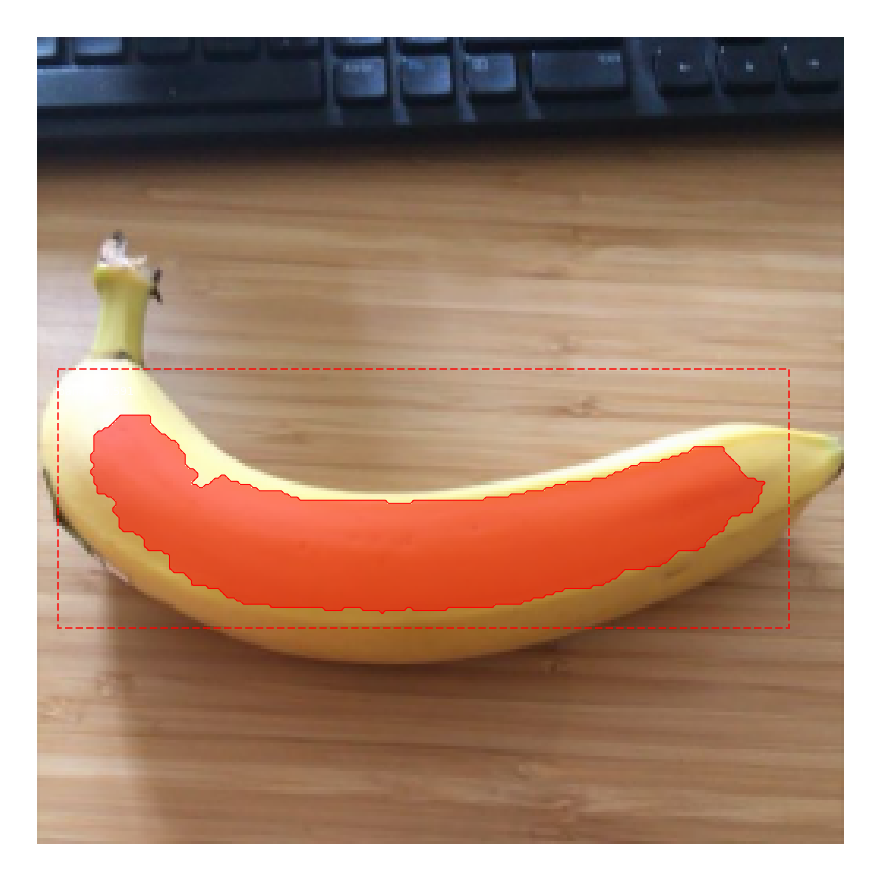

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


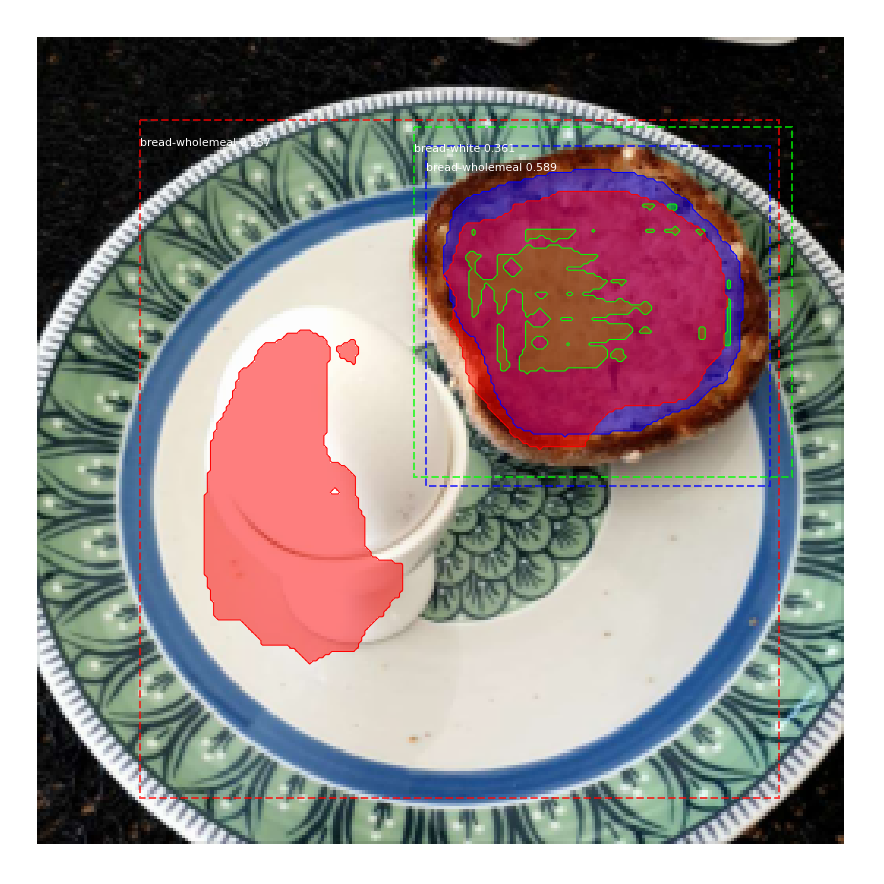

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 13/20
149/150 [============================>.] - ETA: 0s - loss: 1.4360 - rpn_class_loss: 0.0135 - rpn_bbox_loss: 0.4191 - mrcnn_class_loss: 0.1949 - mrcnn_bbox_loss: 0.3205 - mrcnn_mask_loss: 0.4881

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 143s 956ms/step - loss: 1.4348 - rpn_class_loss: 0.0134 - rpn_bbox_loss: 0.4177 - mrcnn_class_loss: 0.1943 - mrcnn_bbox_loss: 0.3211 - mrcnn_mask_loss: 0.4883 - val_loss: 1.3870 - val_rpn_class_loss: 0.0127 - val_rpn_bbox_loss: 0.3643 - val_mrcnn_class_loss: 0.2065 - val_mrcnn_bbox_loss: 0.3251 - val_mrcnn_mask_loss: 0.4784
Uploading images to wandb...


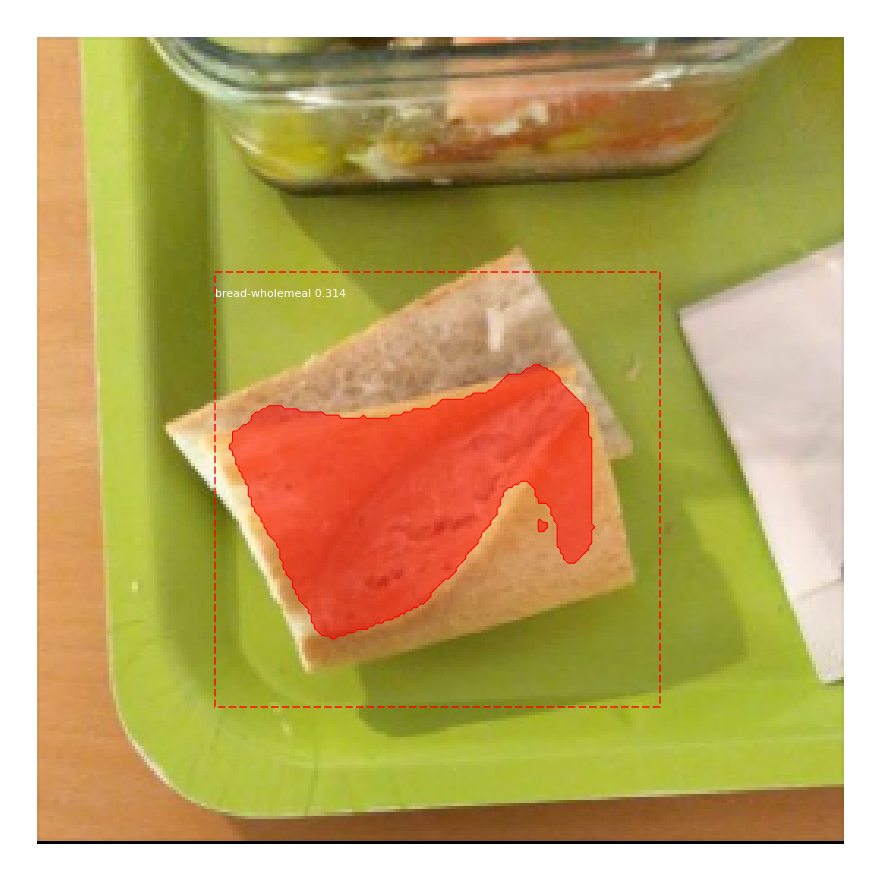

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


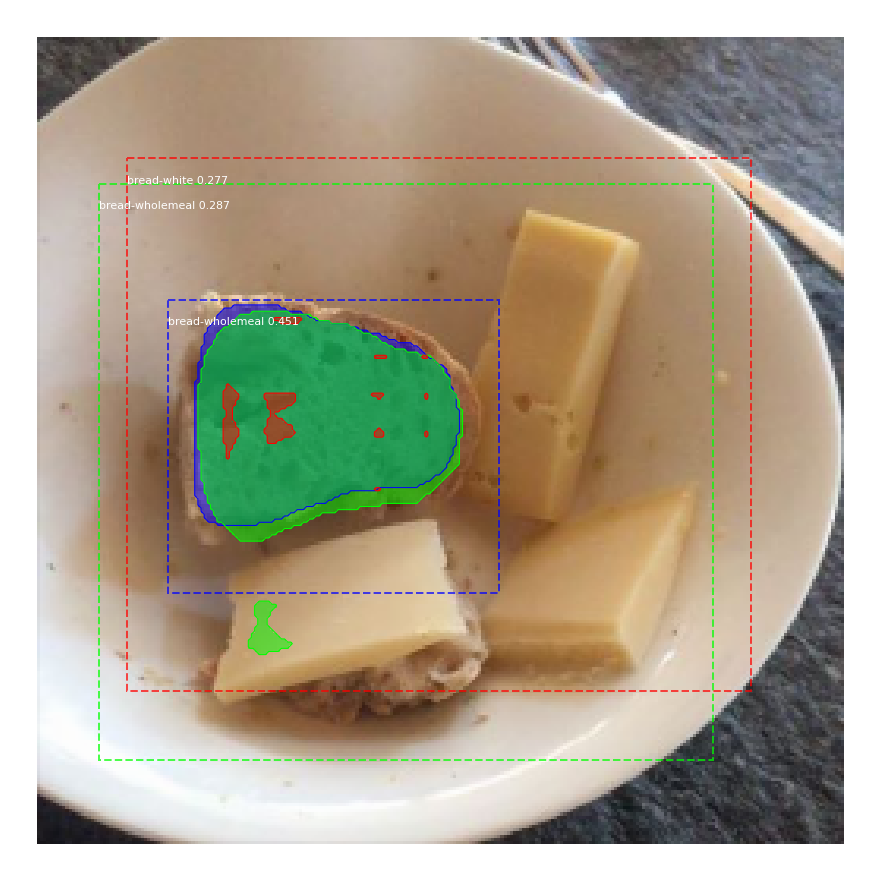

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


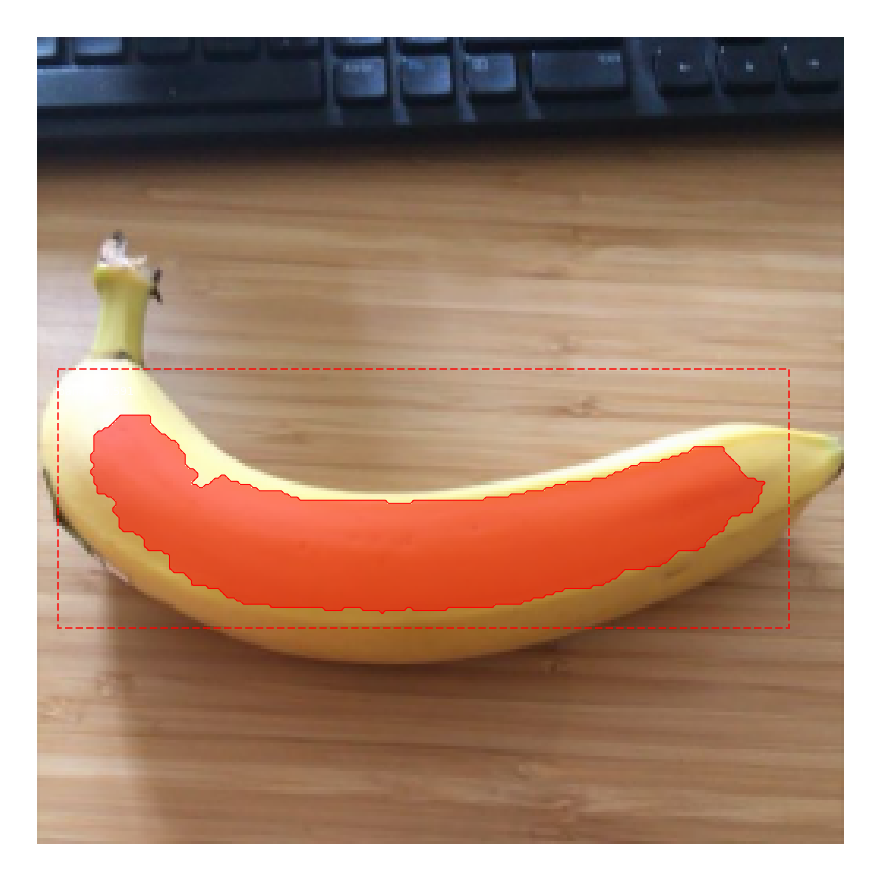

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


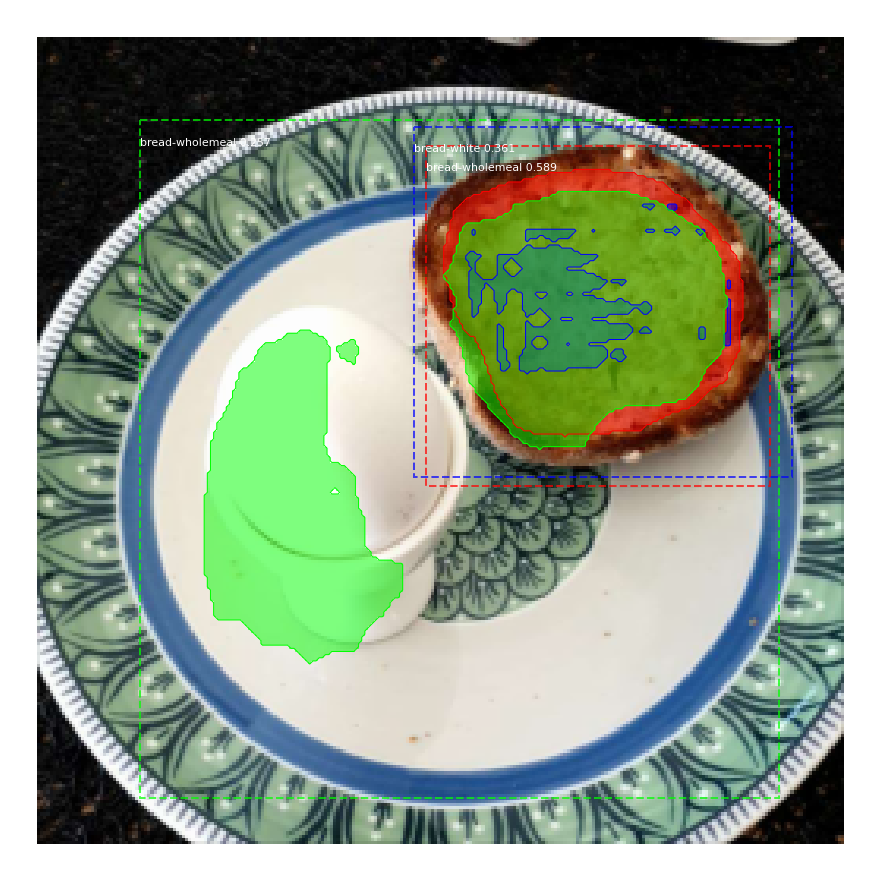

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 14/20
149/150 [============================>.] - ETA: 0s - loss: 1.3827 - rpn_class_loss: 0.0151 - rpn_bbox_loss: 0.3537 - mrcnn_class_loss: 0.1948 - mrcnn_bbox_loss: 0.3258 - mrcnn_mask_loss: 0.4933

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 144s 961ms/step - loss: 1.3873 - rpn_class_loss: 0.0153 - rpn_bbox_loss: 0.3575 - mrcnn_class_loss: 0.1951 - mrcnn_bbox_loss: 0.3255 - mrcnn_mask_loss: 0.4940 - val_loss: 1.3799 - val_rpn_class_loss: 0.0119 - val_rpn_bbox_loss: 0.3790 - val_mrcnn_class_loss: 0.1866 - val_mrcnn_bbox_loss: 0.3152 - val_mrcnn_mask_loss: 0.4871
Uploading images to wandb...


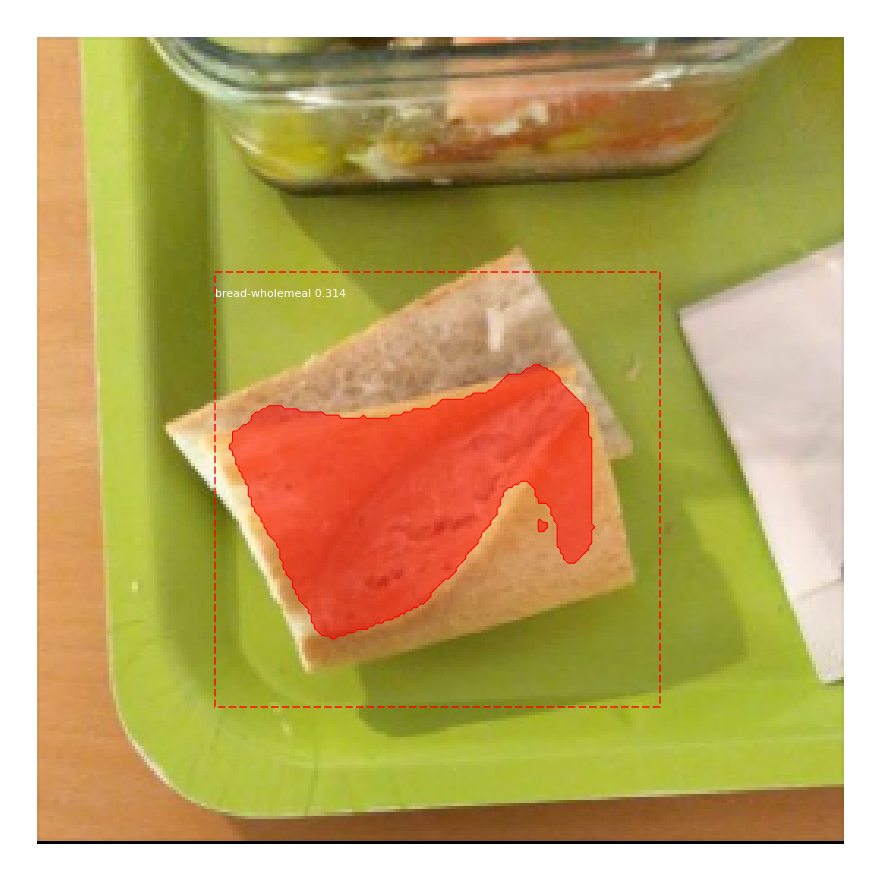

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


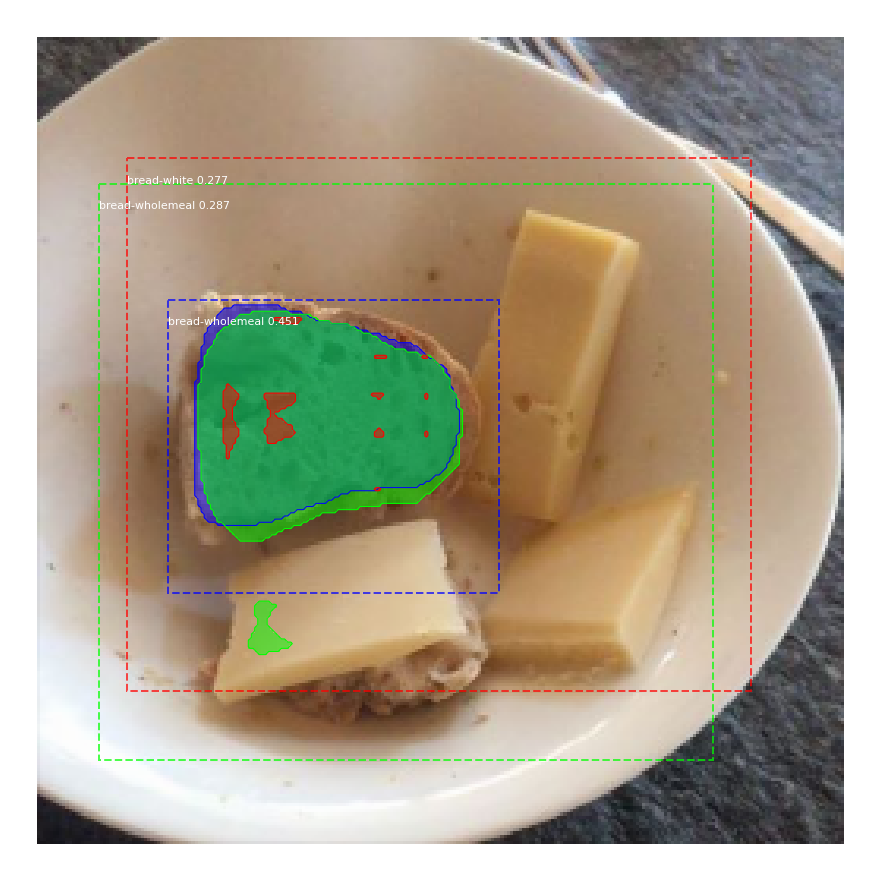

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


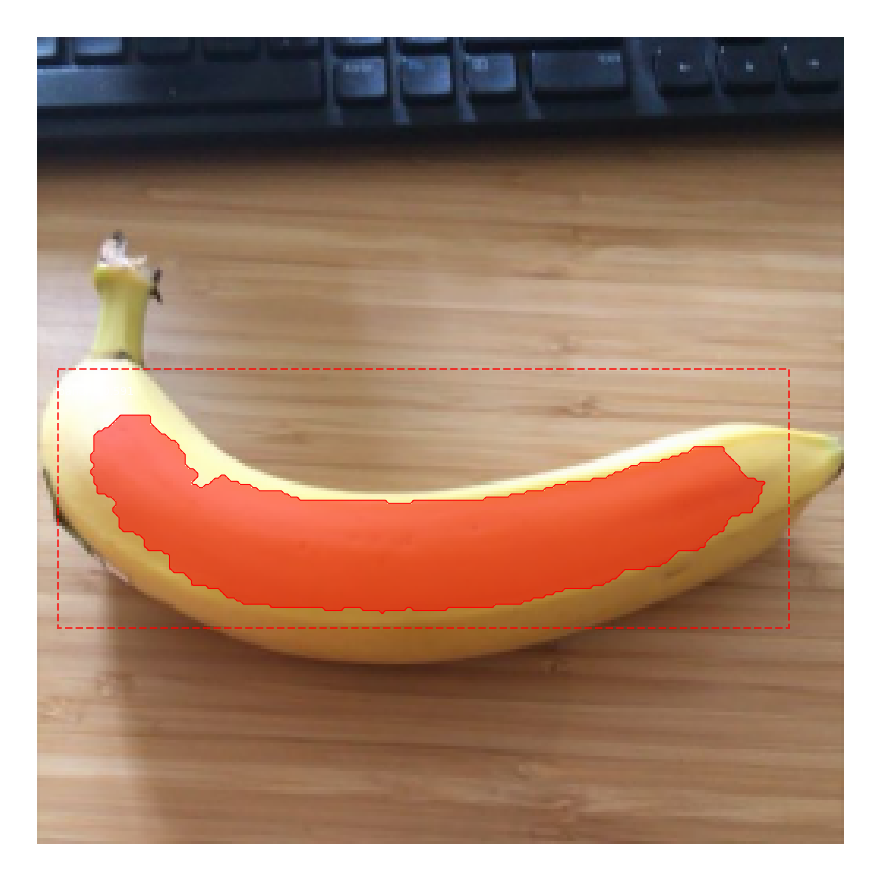

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


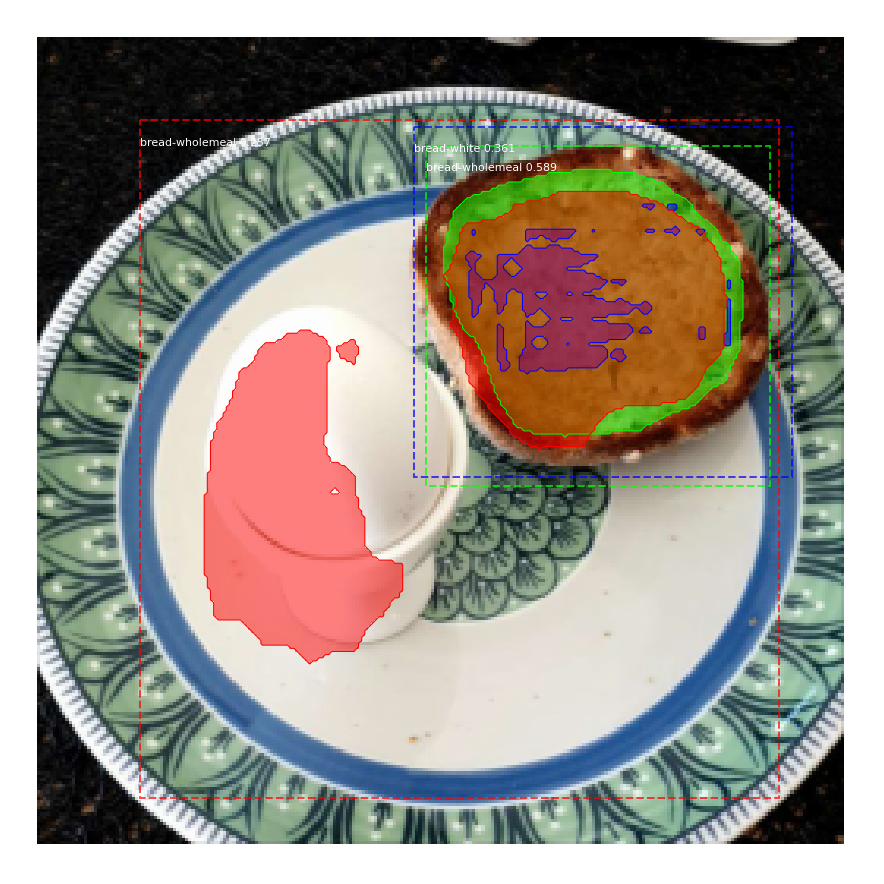

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 15/20
149/150 [============================>.] - ETA: 0s - loss: 1.3361 - rpn_class_loss: 0.0150 - rpn_bbox_loss: 0.3215 - mrcnn_class_loss: 0.2086 - mrcnn_bbox_loss: 0.3114 - mrcnn_mask_loss: 0.4797

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 146s 971ms/step - loss: 1.3346 - rpn_class_loss: 0.0150 - rpn_bbox_loss: 0.3214 - mrcnn_class_loss: 0.2080 - mrcnn_bbox_loss: 0.3108 - mrcnn_mask_loss: 0.4794 - val_loss: 1.2472 - val_rpn_class_loss: 0.0120 - val_rpn_bbox_loss: 0.1964 - val_mrcnn_class_loss: 0.1888 - val_mrcnn_bbox_loss: 0.3078 - val_mrcnn_mask_loss: 0.5423
Uploading images to wandb...


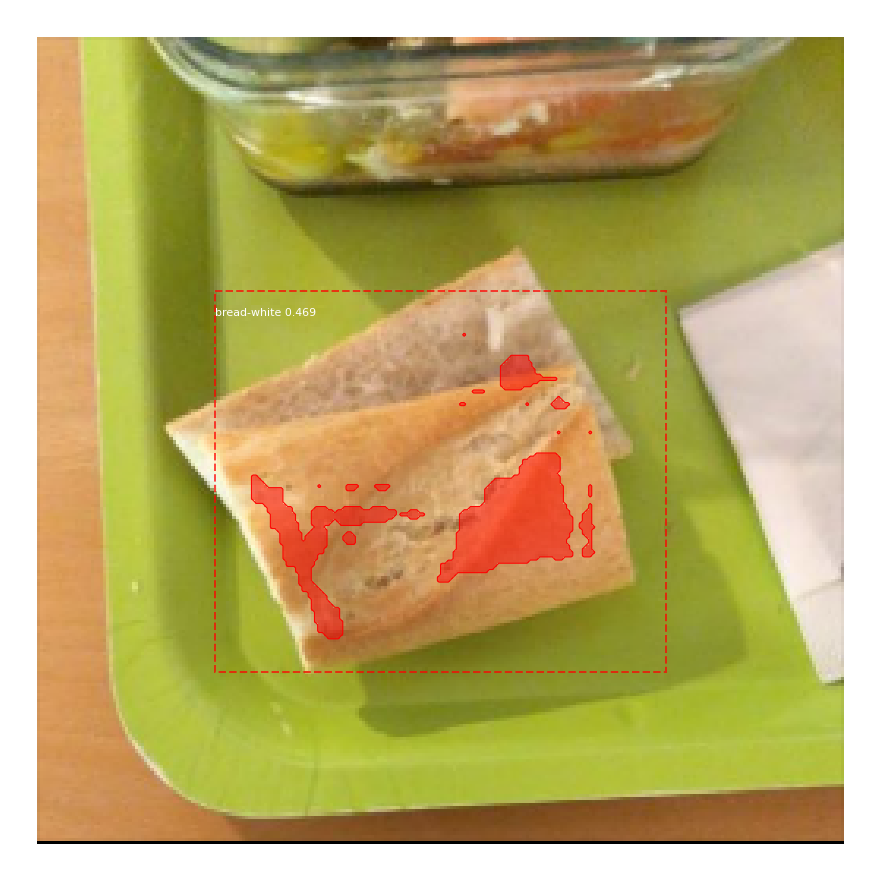

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


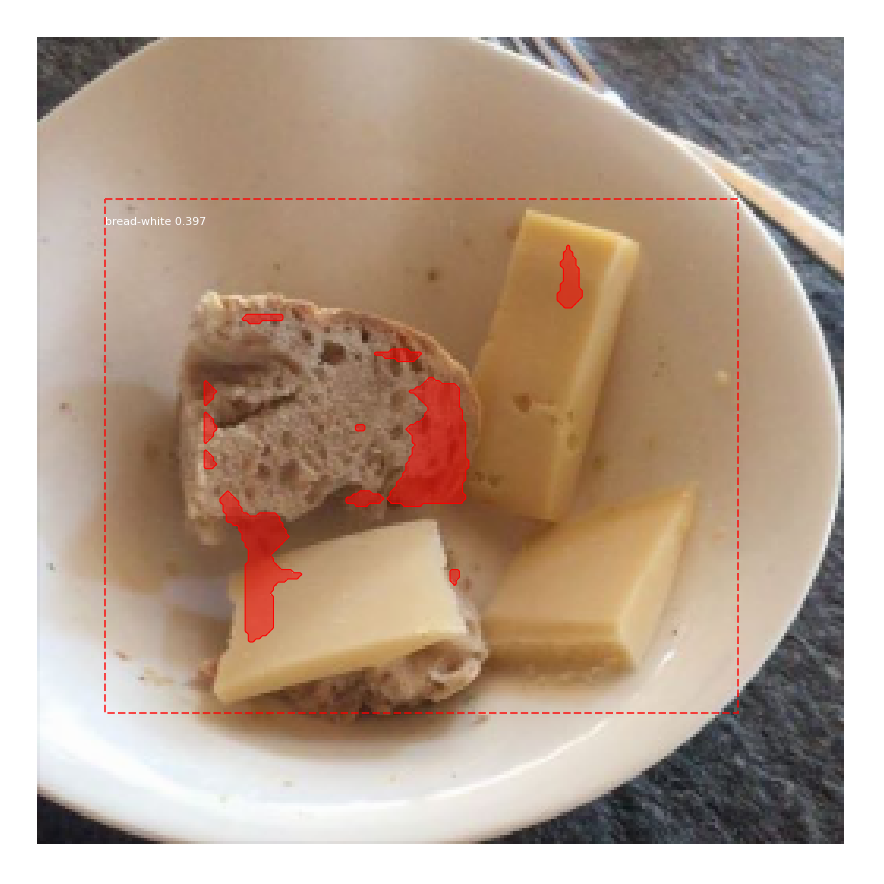

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


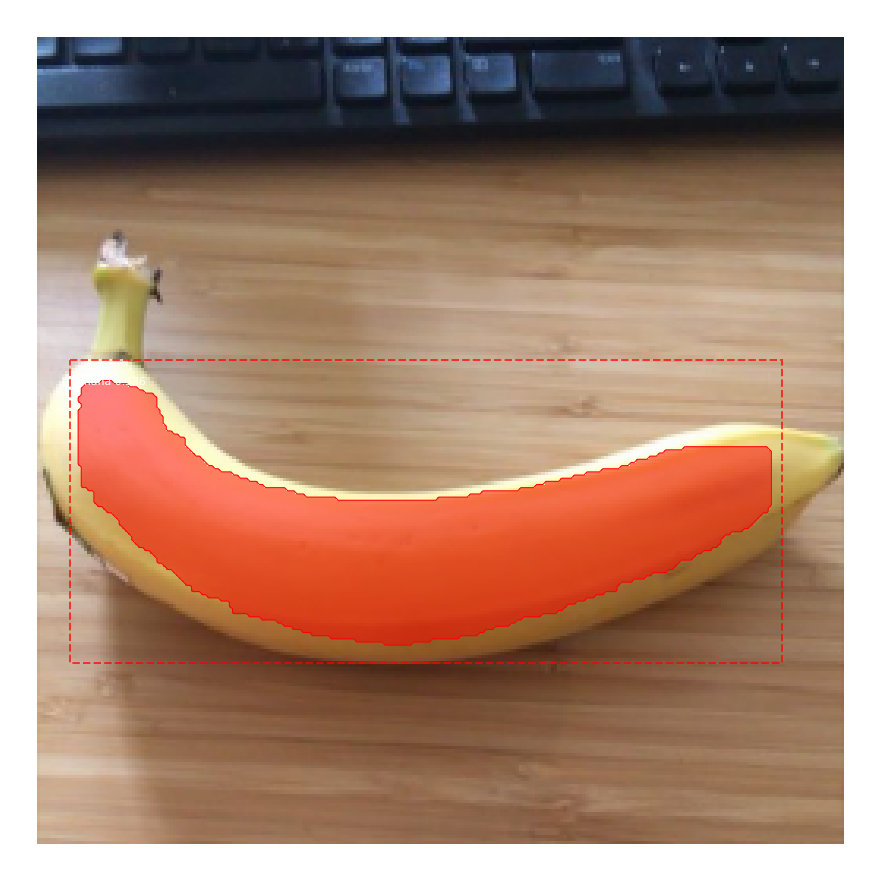

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


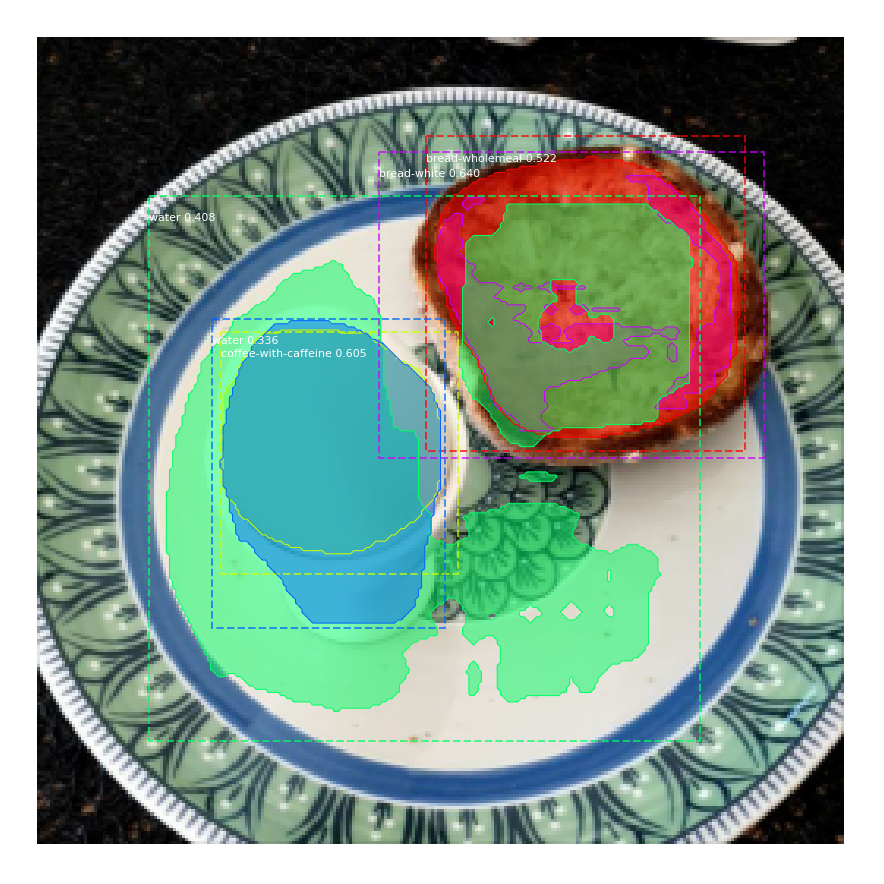

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 16/20
149/150 [============================>.] - ETA: 0s - loss: 1.2568 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.2674 - mrcnn_class_loss: 0.1928 - mrcnn_bbox_loss: 0.3013 - mrcnn_mask_loss: 0.4846

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 144s 957ms/step - loss: 1.2542 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.2666 - mrcnn_class_loss: 0.1920 - mrcnn_bbox_loss: 0.3005 - mrcnn_mask_loss: 0.4845 - val_loss: 1.3160 - val_rpn_class_loss: 0.0112 - val_rpn_bbox_loss: 0.2892 - val_mrcnn_class_loss: 0.2071 - val_mrcnn_bbox_loss: 0.3229 - val_mrcnn_mask_loss: 0.4856
Uploading images to wandb...


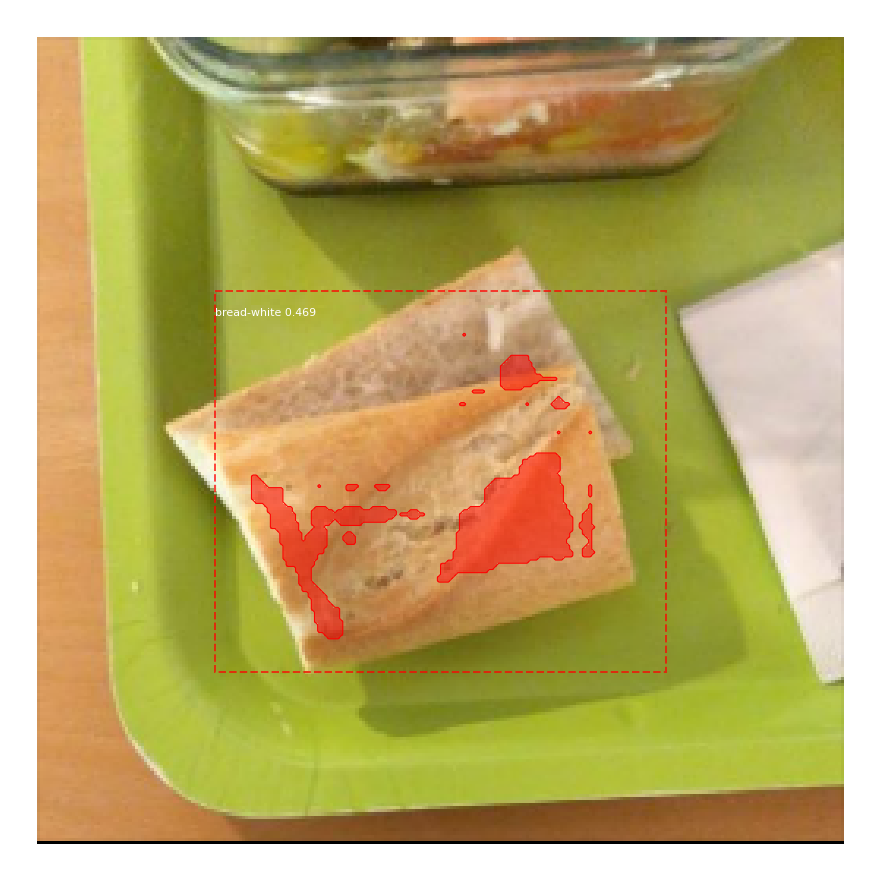

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


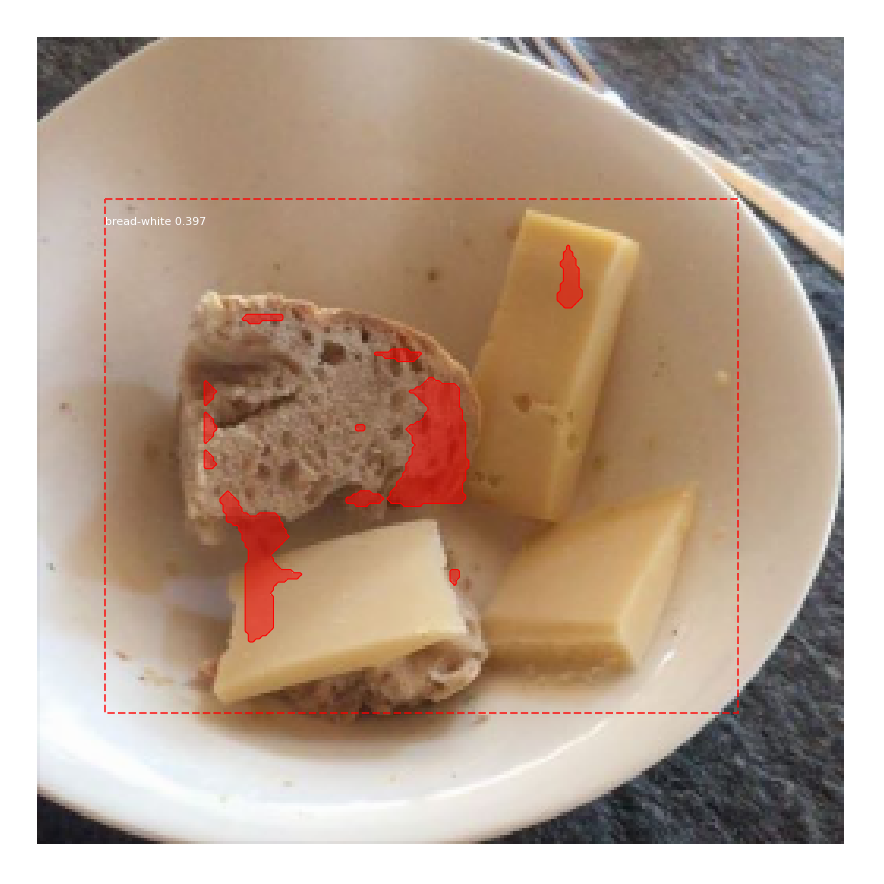

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


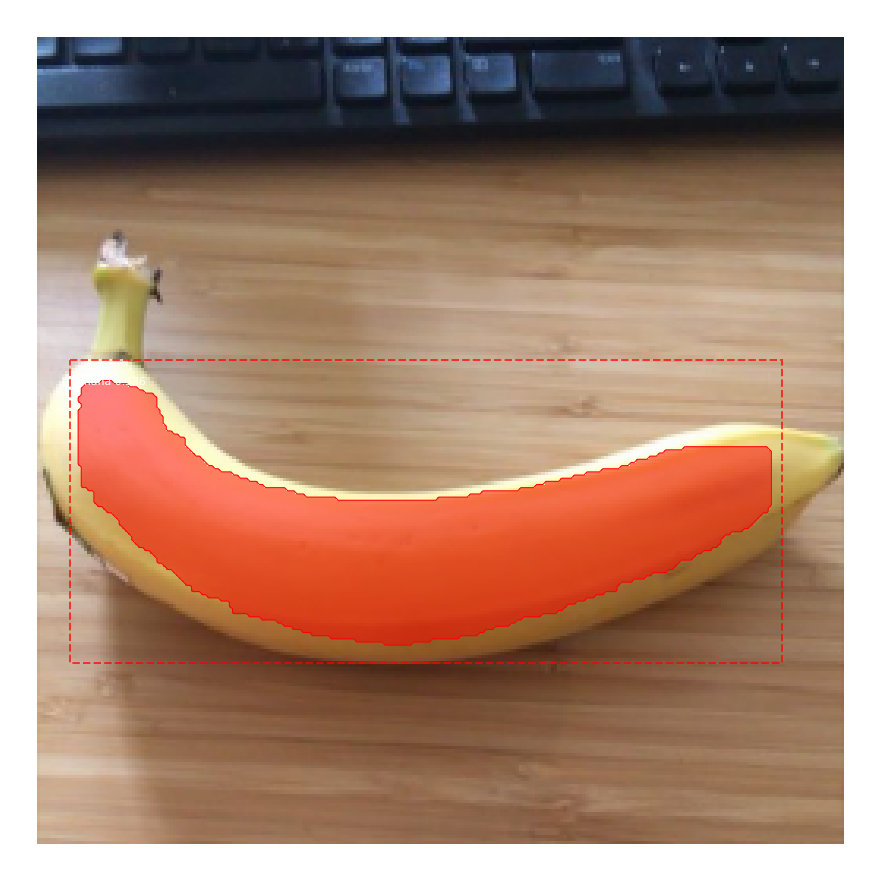

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


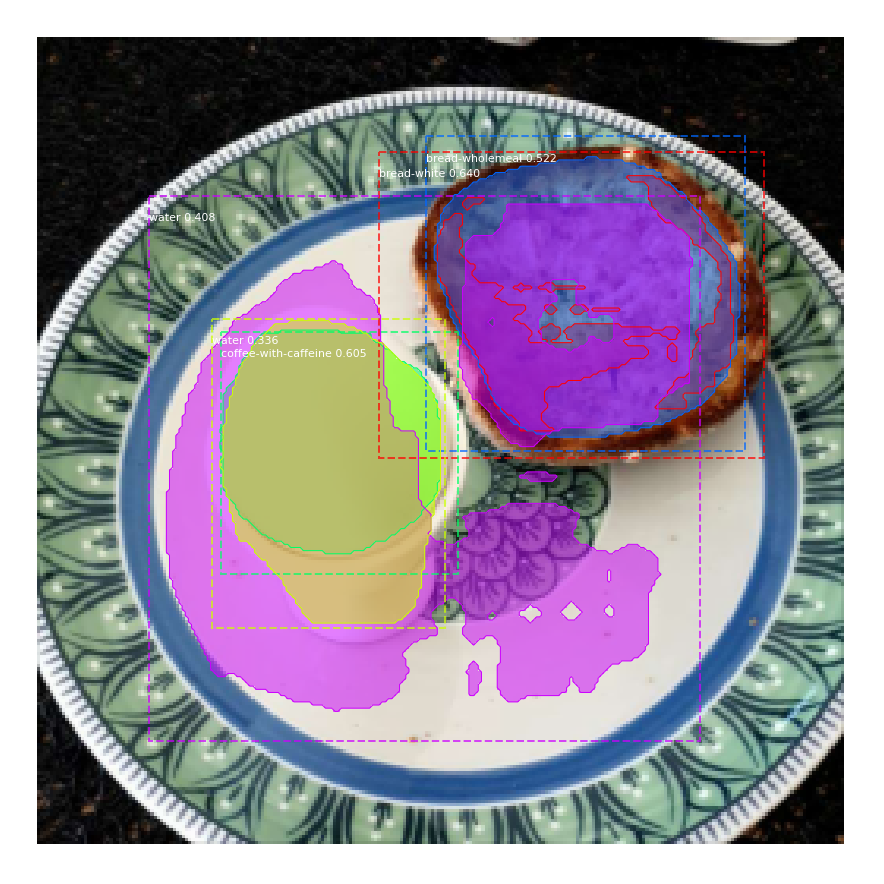

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 17/20
149/150 [============================>.] - ETA: 0s - loss: 1.2192 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.2607 - mrcnn_class_loss: 0.1811 - mrcnn_bbox_loss: 0.3018 - mrcnn_mask_loss: 0.4655

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 143s 956ms/step - loss: 1.2147 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.2594 - mrcnn_class_loss: 0.1805 - mrcnn_bbox_loss: 0.3004 - mrcnn_mask_loss: 0.4643 - val_loss: 1.3673 - val_rpn_class_loss: 0.0156 - val_rpn_bbox_loss: 0.3686 - val_mrcnn_class_loss: 0.2073 - val_mrcnn_bbox_loss: 0.3038 - val_mrcnn_mask_loss: 0.4719
Uploading images to wandb...


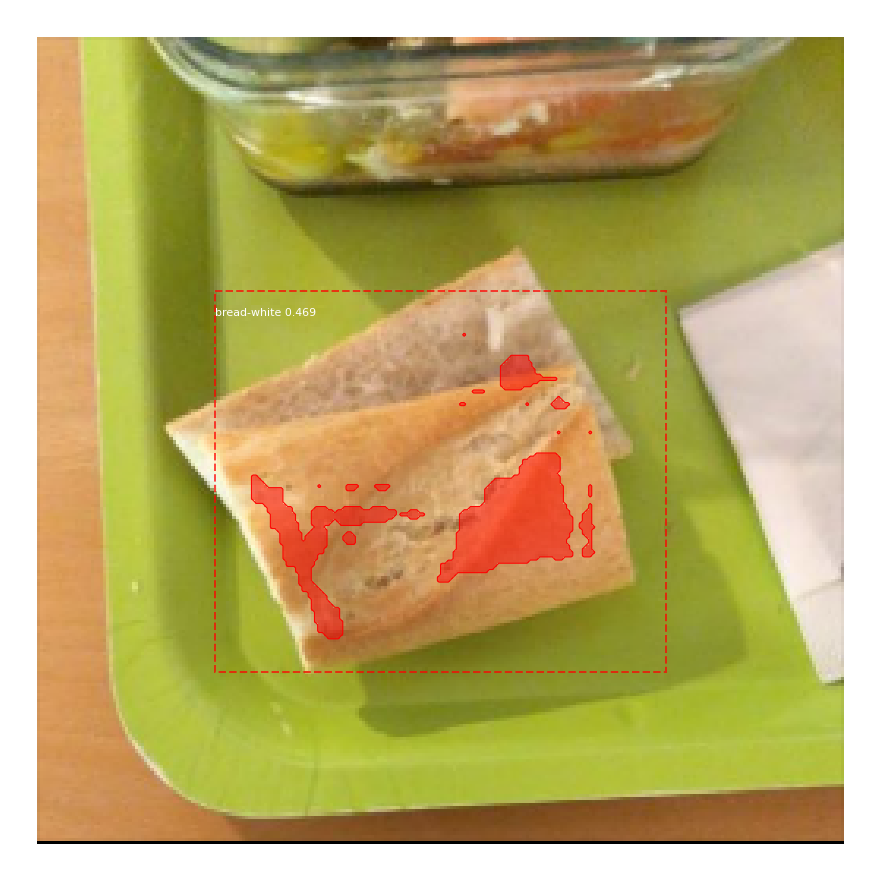

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


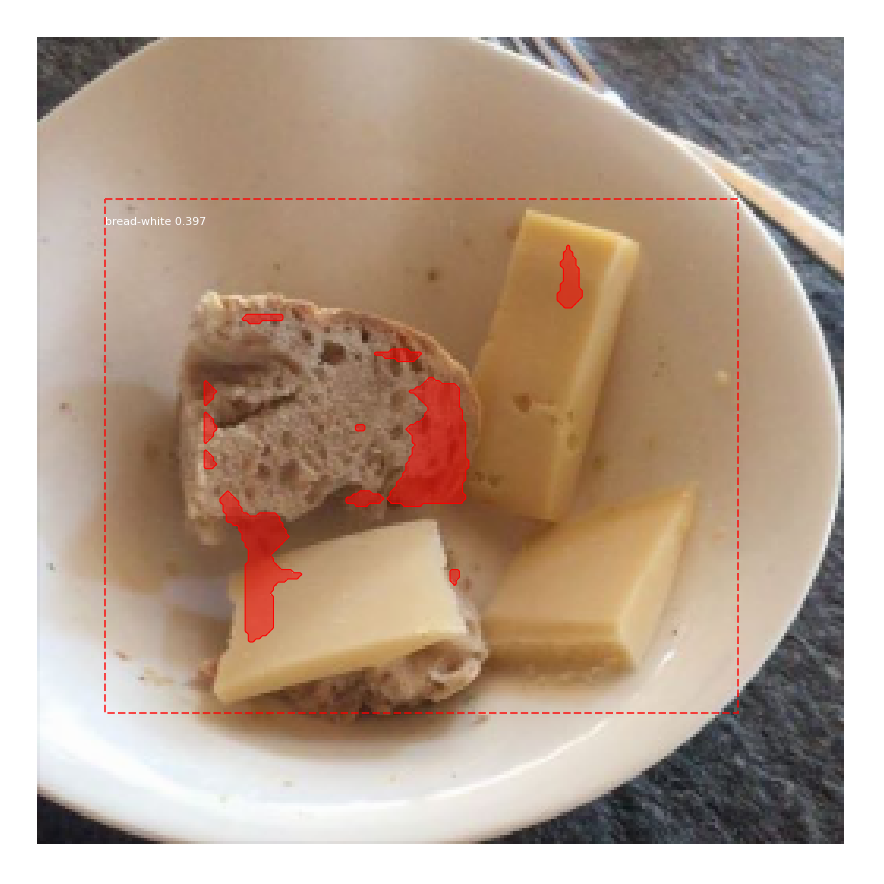

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


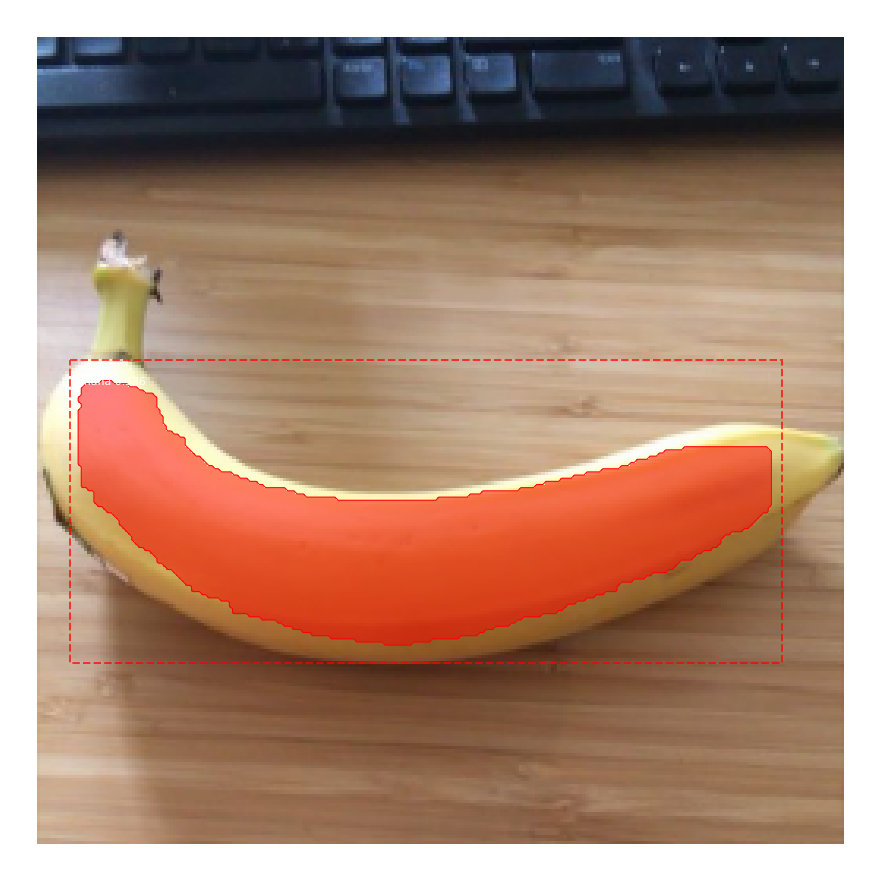

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


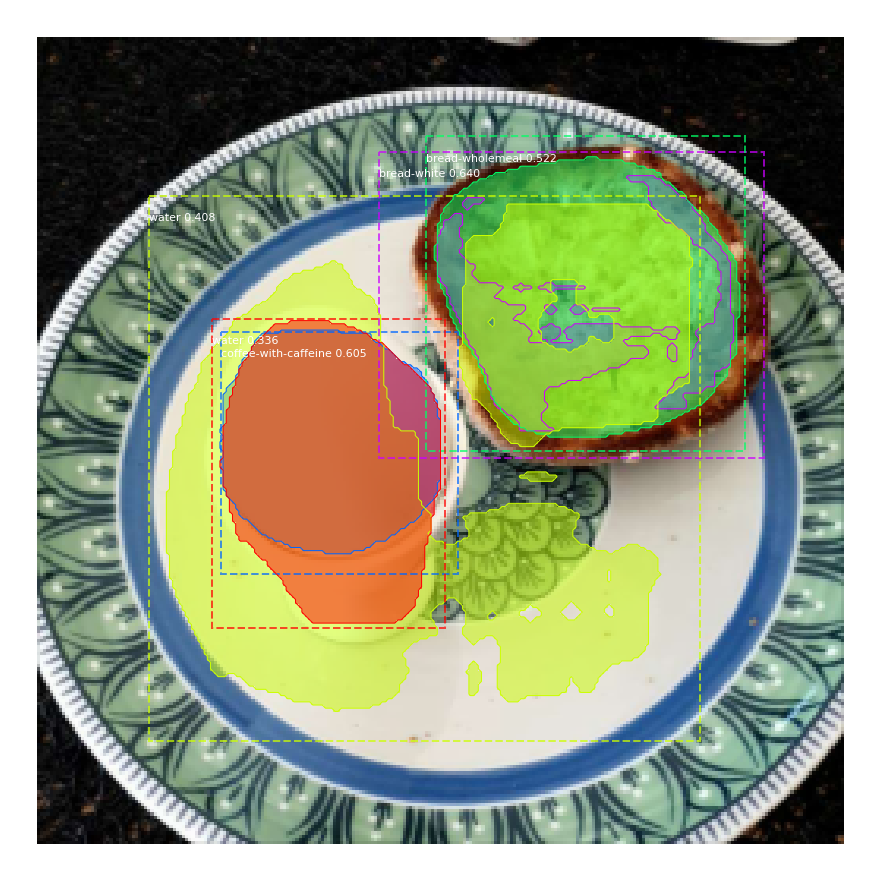

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 18/20
149/150 [============================>.] - ETA: 0s - loss: 1.2495 - rpn_class_loss: 0.0127 - rpn_bbox_loss: 0.2762 - mrcnn_class_loss: 0.1937 - mrcnn_bbox_loss: 0.2889 - mrcnn_mask_loss: 0.4780

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 143s 953ms/step - loss: 1.2480 - rpn_class_loss: 0.0128 - rpn_bbox_loss: 0.2753 - mrcnn_class_loss: 0.1940 - mrcnn_bbox_loss: 0.2886 - mrcnn_mask_loss: 0.4772 - val_loss: 1.2136 - val_rpn_class_loss: 0.0094 - val_rpn_bbox_loss: 0.2202 - val_mrcnn_class_loss: 0.1939 - val_mrcnn_bbox_loss: 0.2964 - val_mrcnn_mask_loss: 0.4937
Uploading images to wandb...


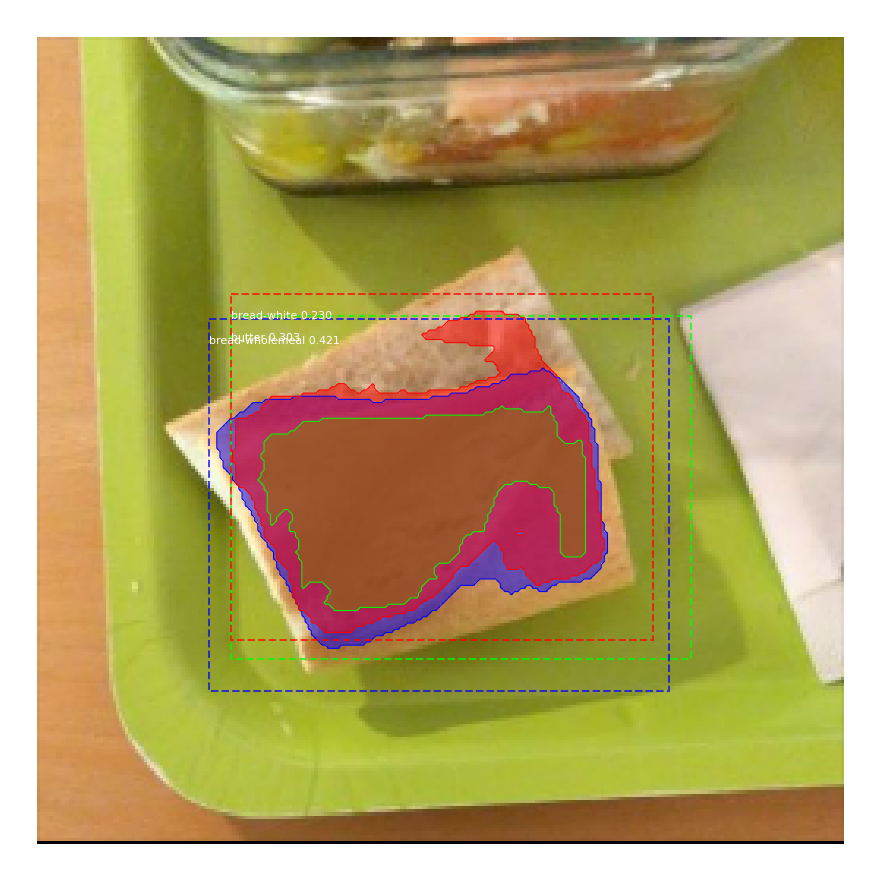

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


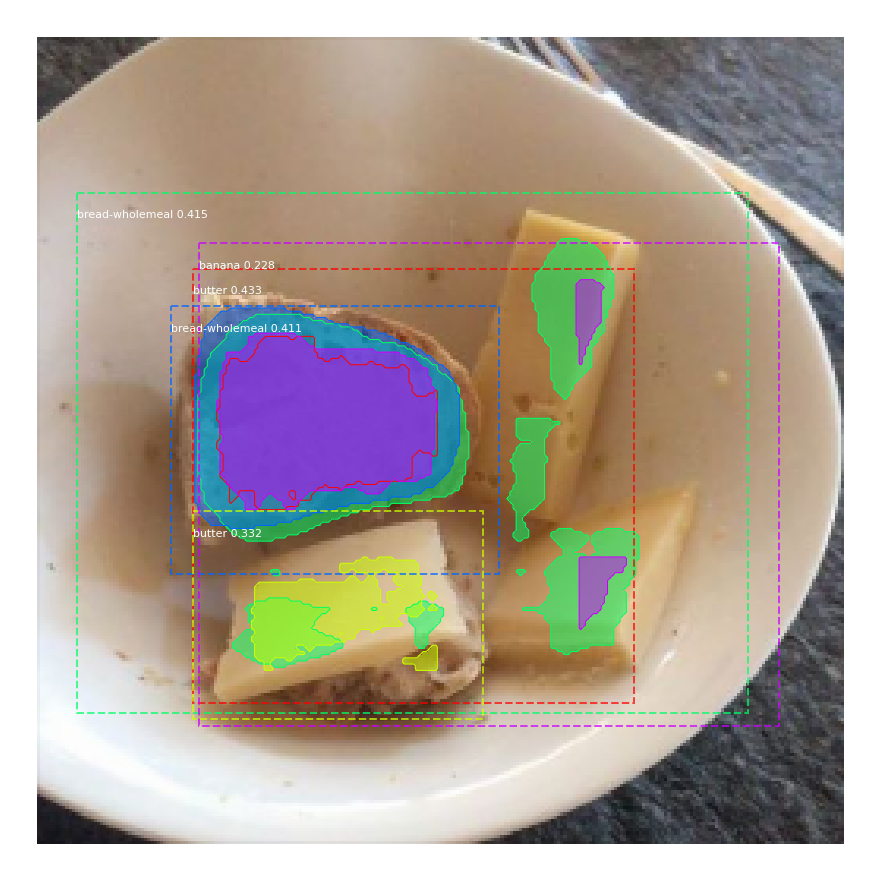

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


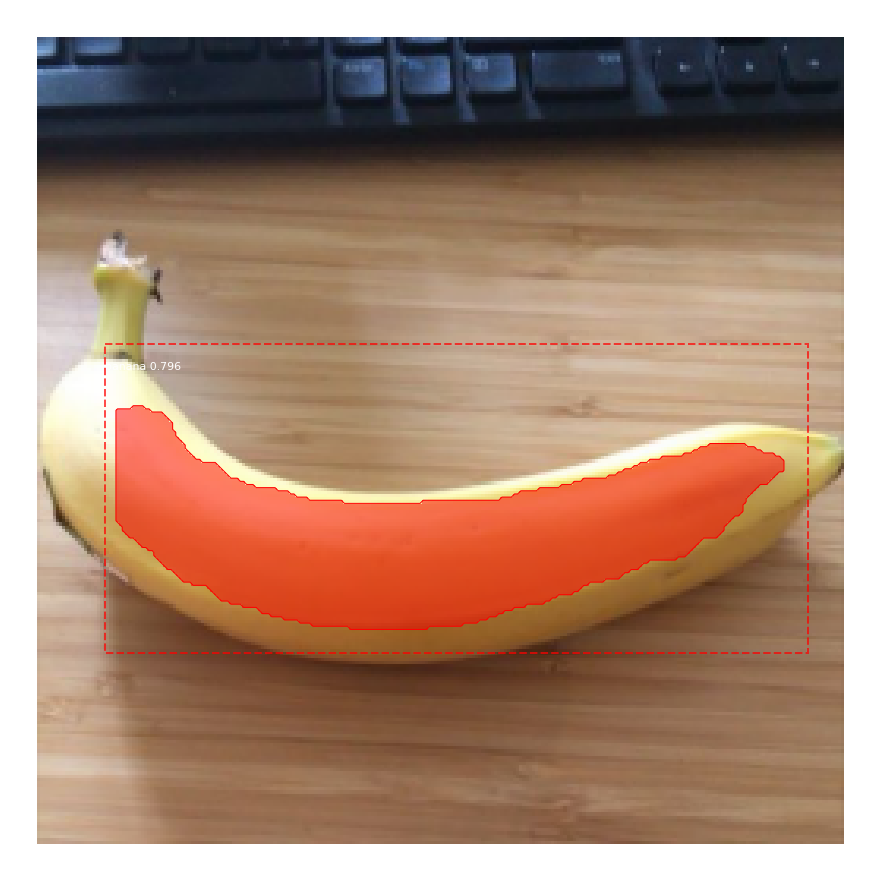

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


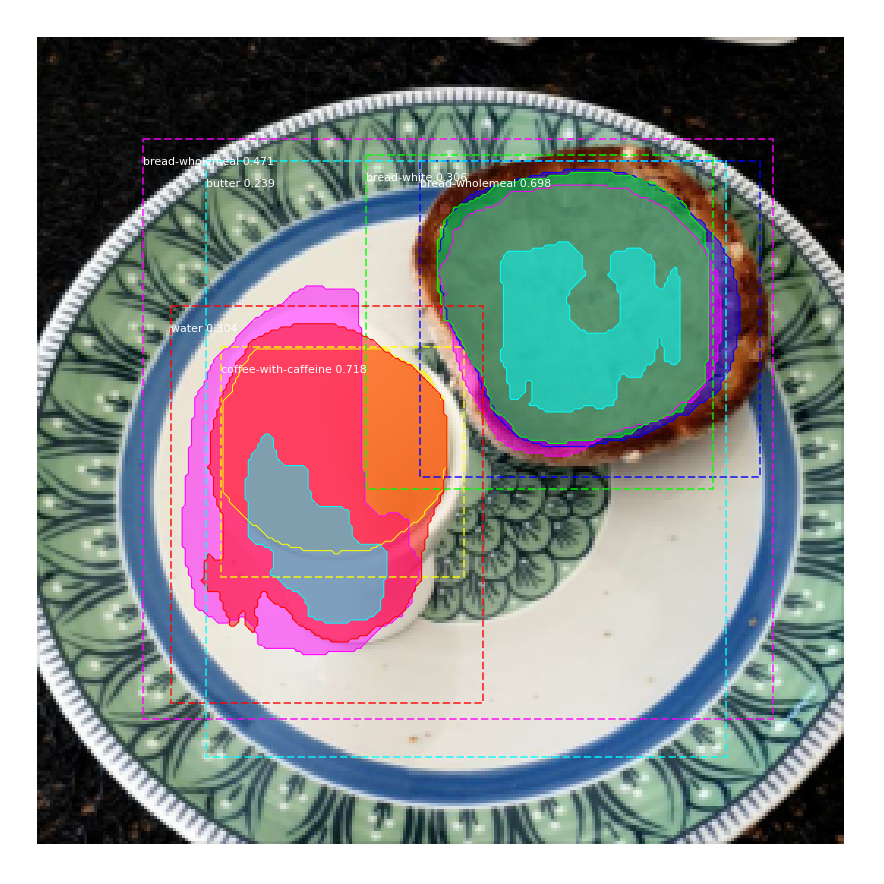

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 19/20
149/150 [============================>.] - ETA: 0s - loss: 1.2520 - rpn_class_loss: 0.0126 - rpn_bbox_loss: 0.2625 - mrcnn_class_loss: 0.1986 - mrcnn_bbox_loss: 0.2963 - mrcnn_mask_loss: 0.4821

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 142s 949ms/step - loss: 1.2529 - rpn_class_loss: 0.0126 - rpn_bbox_loss: 0.2616 - mrcnn_class_loss: 0.1990 - mrcnn_bbox_loss: 0.2964 - mrcnn_mask_loss: 0.4832 - val_loss: 1.3150 - val_rpn_class_loss: 0.0107 - val_rpn_bbox_loss: 0.3176 - val_mrcnn_class_loss: 0.2062 - val_mrcnn_bbox_loss: 0.3135 - val_mrcnn_mask_loss: 0.4669
Uploading images to wandb...


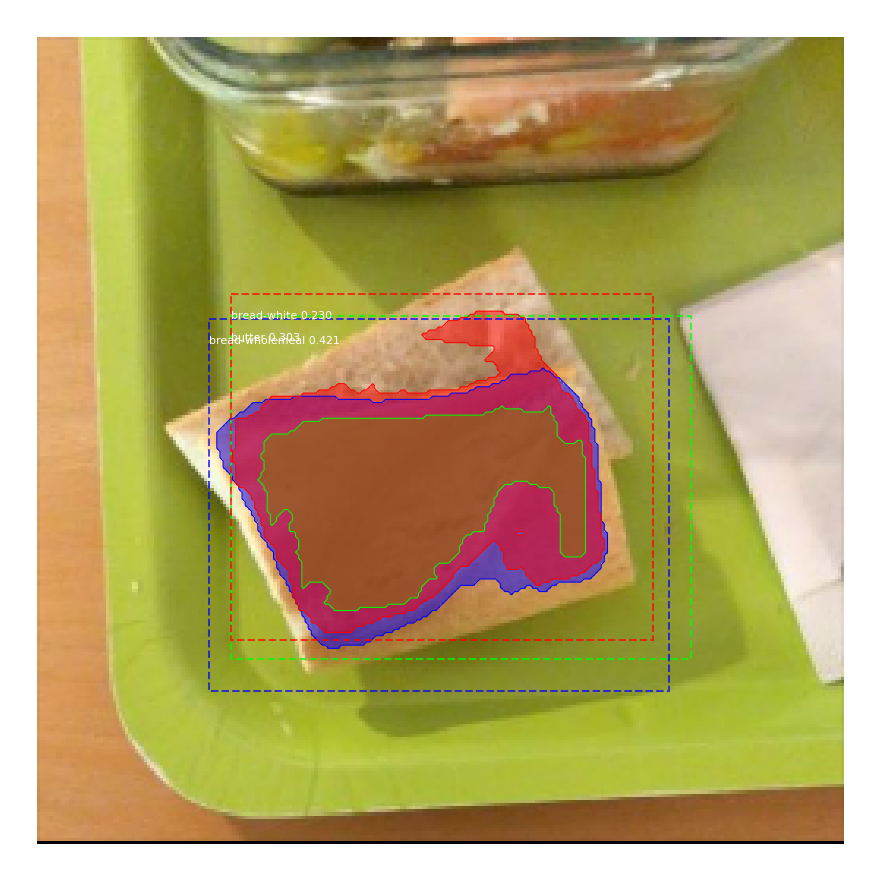

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


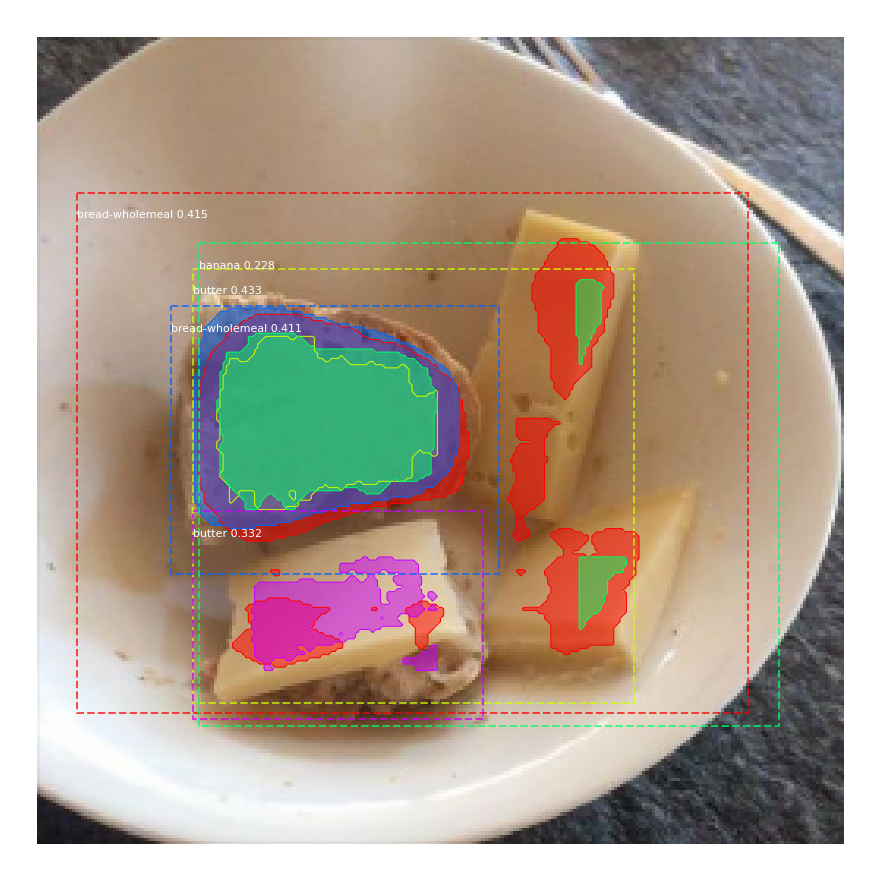

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


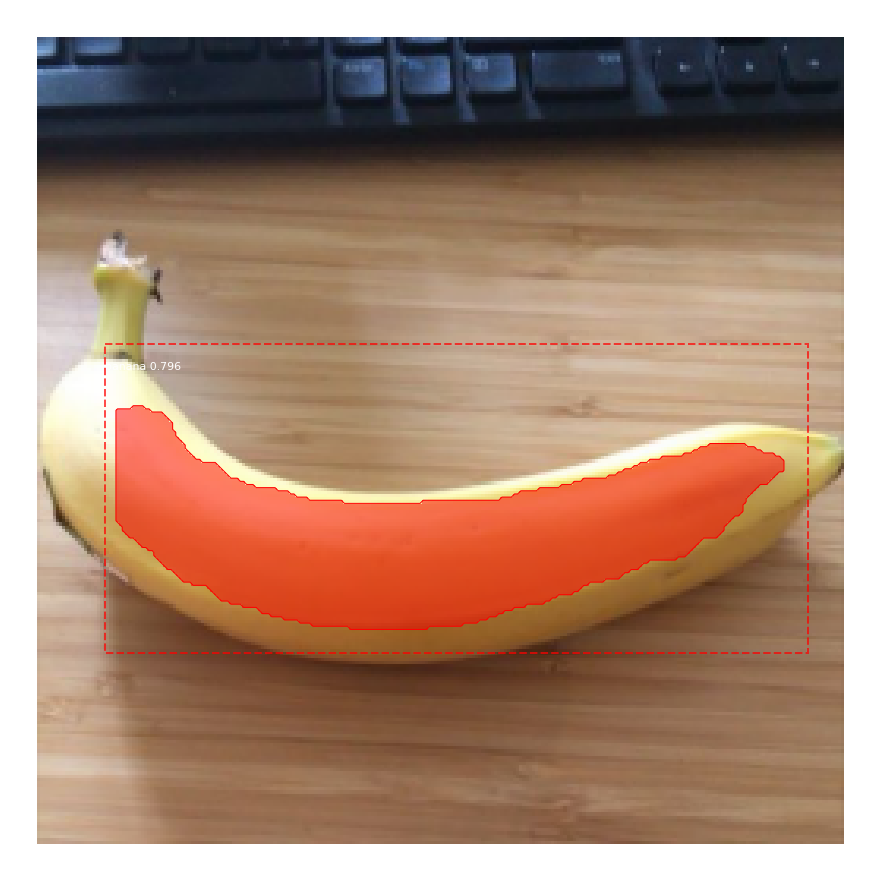

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


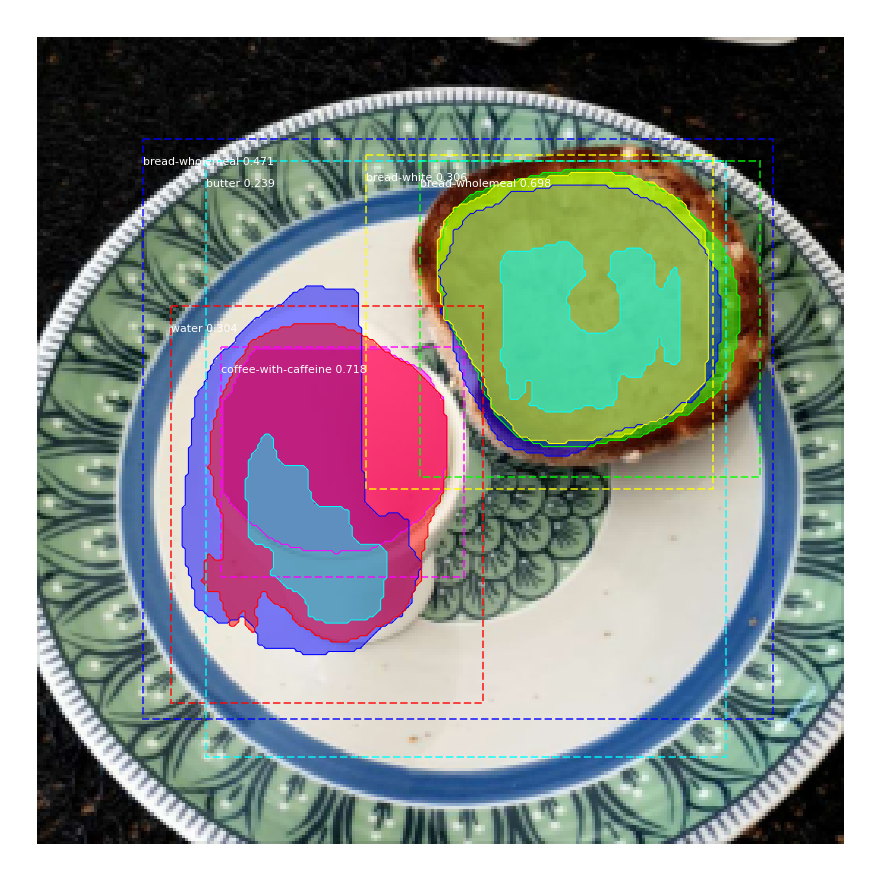

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 20/20
149/150 [============================>.] - ETA: 0s - loss: 1.2690 - rpn_class_loss: 0.0121 - rpn_bbox_loss: 0.2855 - mrcnn_class_loss: 0.1971 - mrcnn_bbox_loss: 0.2928 - mrcnn_mask_loss: 0.4815

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


150/150 [==============================] - 141s 943ms/step - loss: 1.2662 - rpn_class_loss: 0.0120 - rpn_bbox_loss: 0.2843 - mrcnn_class_loss: 0.1970 - mrcnn_bbox_loss: 0.2920 - mrcnn_mask_loss: 0.4809 - val_loss: 1.2774 - val_rpn_class_loss: 0.0128 - val_rpn_bbox_loss: 0.2911 - val_mrcnn_class_loss: 0.1995 - val_mrcnn_bbox_loss: 0.2860 - val_mrcnn_mask_loss: 0.4882
Uploading images to wandb...


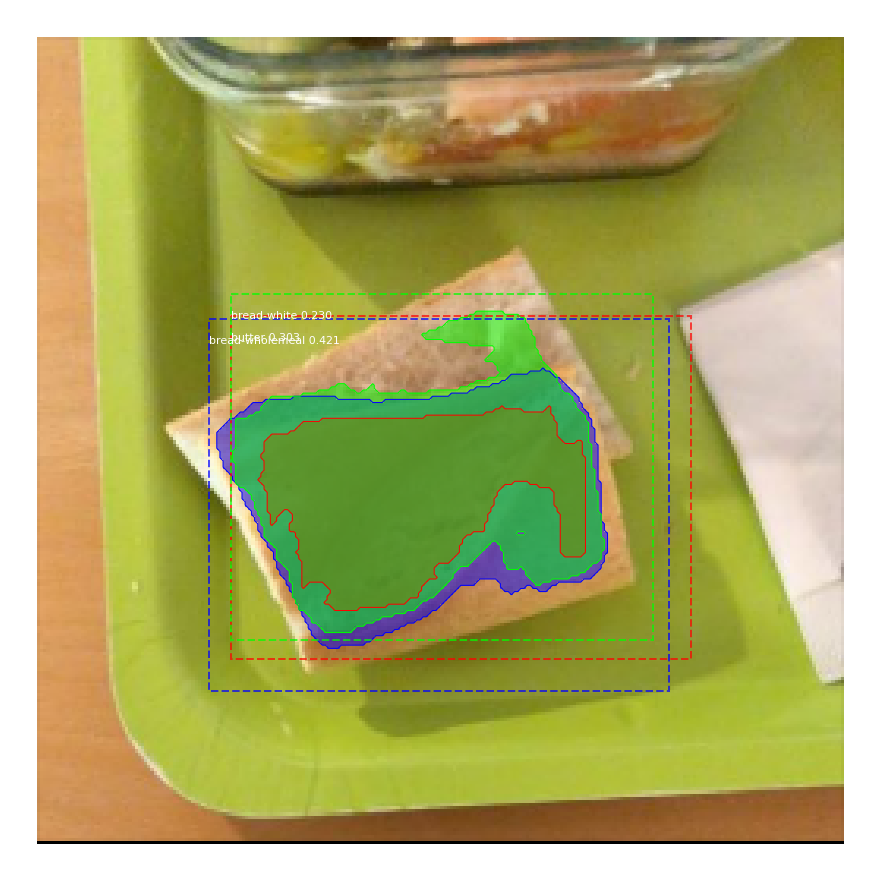

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


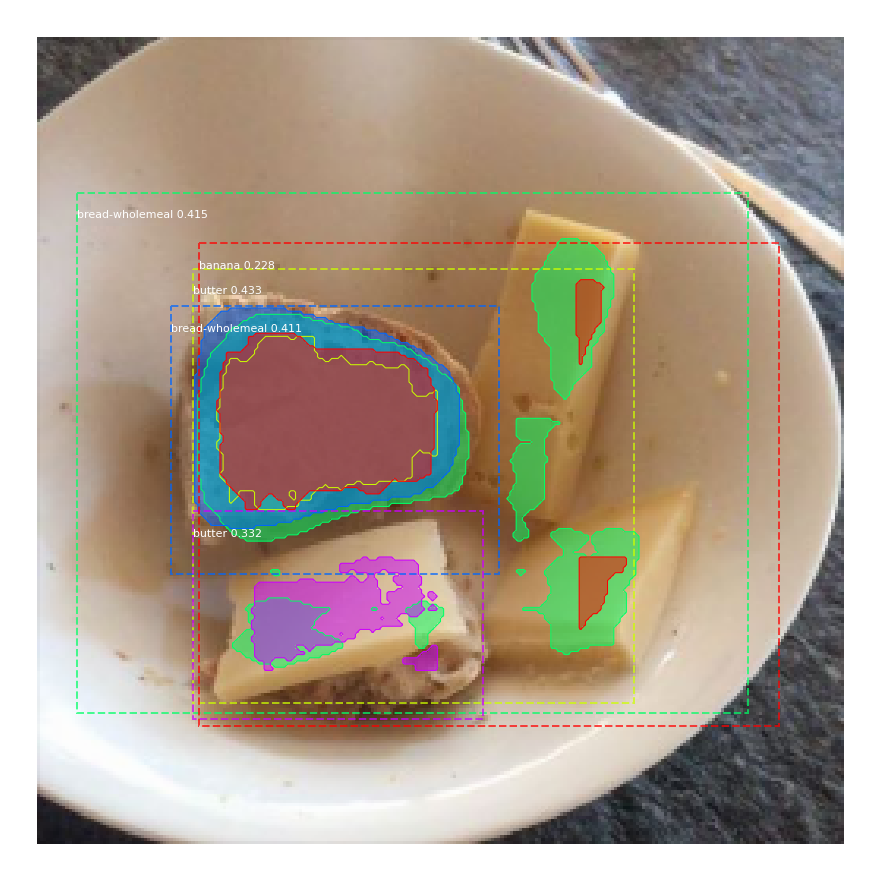

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


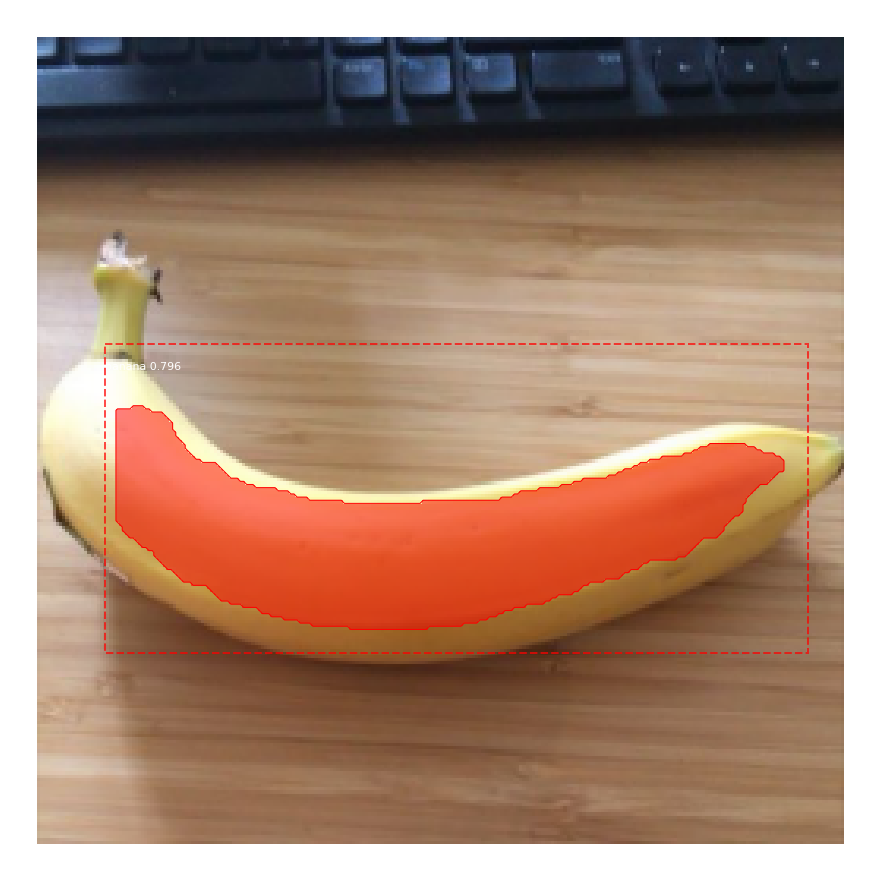

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


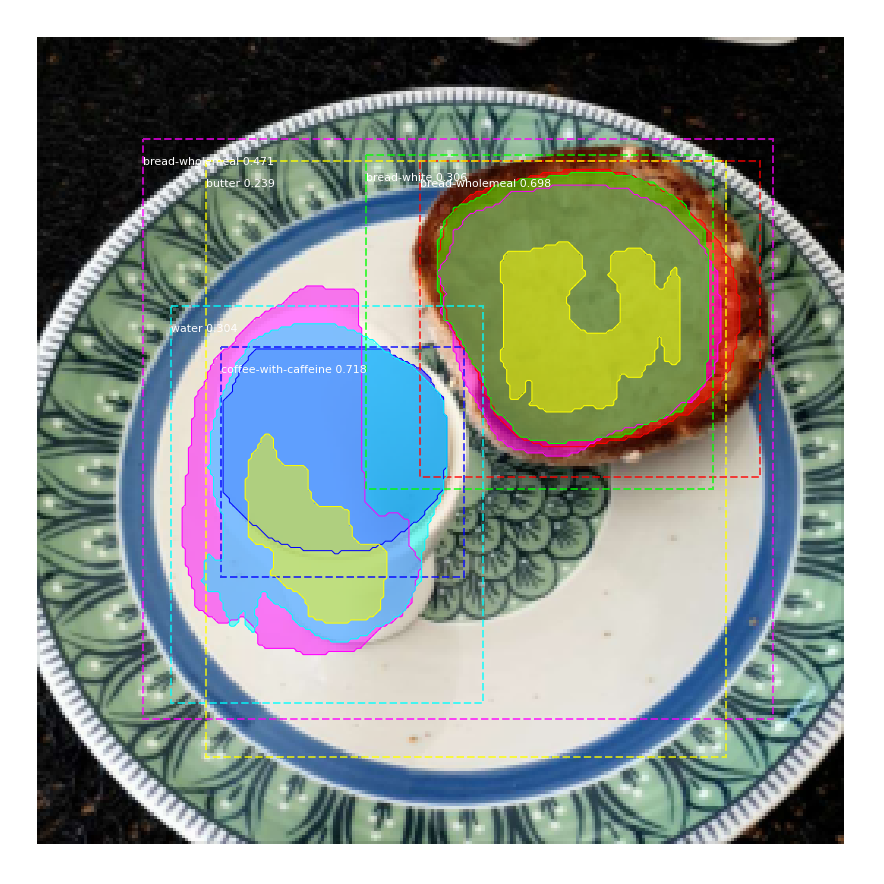

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...


In [ ]:

# *** This training schedule is an example. Update to your needs ***

# Training - Stage 1
print("Training network heads")
model.train(dataset_train, dataset_val,
            learning_rate=config.LEARNING_RATE,
            epochs=20,
            layers='heads')

In [ ]:

# Training - Stage 2
# Finetune layers from ResNet stage 4 and up
print("Fine tune Resnet stage 4 and up")

#_, checkpoint = model.find_last()
#model.load_weights(checkpoint, by_name=True)
#print("Loading weights from previous (first) stage")

model.train(dataset_train, dataset_val,
            learning_rate=config.LEARNING_RATE,
            epochs=45,
            layers='4+')


Fine tune all layers

Starting at epoch 45. LR=0.0001

Checkpoint Path: /content/drive/MyDrive/datasets/logs1/food-challenge20210921T0935/mask_rcnn_food-challenge_{epoch:04d}.h5
Selecting layers to train
conv1                  (Conv2D)
bn_conv1               (BatchNorm)
res2a_branch2a         (Conv2D)
bn2a_branch2a          (BatchNorm)
res2a_branch2b         (Conv2D)
bn2a_branch2b          (BatchNorm)
res2a_branch2c         (Conv2D)
res2a_branch1          (Conv2D)
bn2a_branch2c          (BatchNorm)
bn2a_branch1           (BatchNorm)
res2b_branch2a         (Conv2D)
bn2b_branch2a          (BatchNorm)
res2b_branch2b         (Conv2D)
bn2b_branch2b          (BatchNorm)
res2b_branch2c         (Conv2D)
bn2b_branch2c          (BatchNorm)
res2c_branch2a         (Conv2D)
bn2c_branch2a          (BatchNorm)
res2c_branch2b         (Conv2D)
bn2c_branch2b          (BatchNorm)
res2c_branch2c         (Conv2D)
bn2c_branch2c          (BatchNorm)
res3a_branch2a         (Conv2D)
bn3a_branch2a          (Bat

/usr/local/lib/python3.7/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.7/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.7/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2087: UserWarning: Using a generator with `use_multiprocessi

Epoch 46/65
69/70 [============================>.] - ETA: 1s - loss: 1.0336 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.2049 - mrcnn_class_loss: 0.1340 - mrcnn_bbox_loss: 0.2263 - mrcnn_mask_loss: 0.4616

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 120s 2s/step - loss: 1.0349 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.2034 - mrcnn_class_loss: 0.1368 - mrcnn_bbox_loss: 0.2254 - mrcnn_mask_loss: 0.4626 - val_loss: 1.0413 - val_rpn_class_loss: 0.0075 - val_rpn_bbox_loss: 0.1893 - val_mrcnn_class_loss: 0.1482 - val_mrcnn_bbox_loss: 0.2341 - val_mrcnn_mask_loss: 0.4621
Uploading images to wandb...


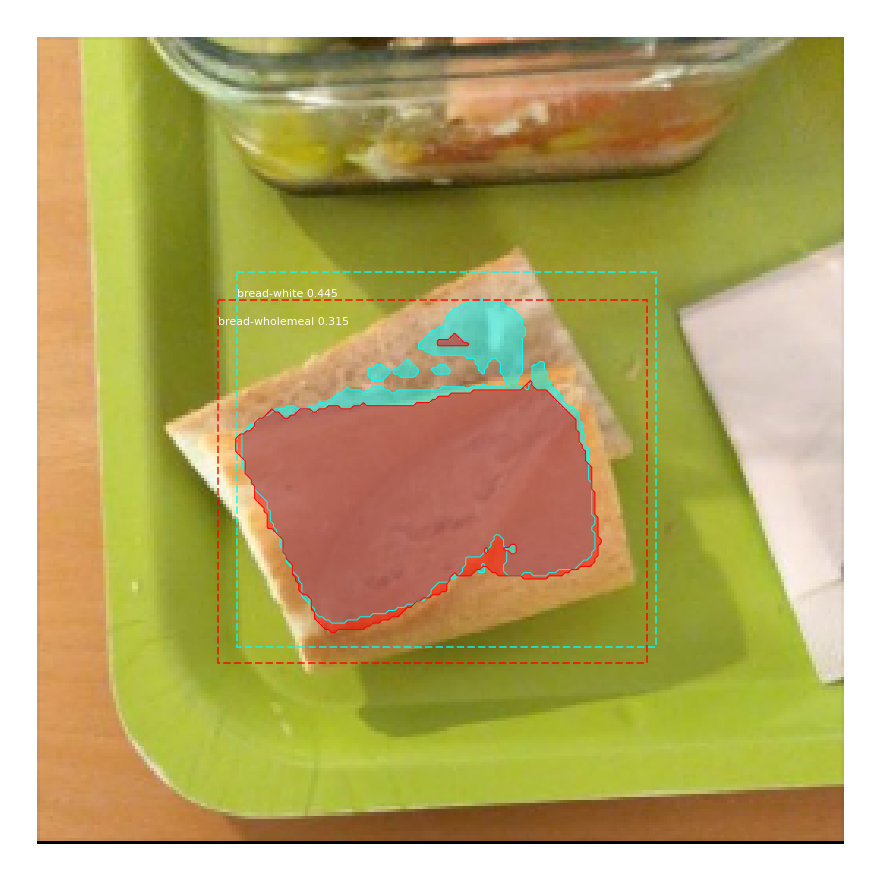

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


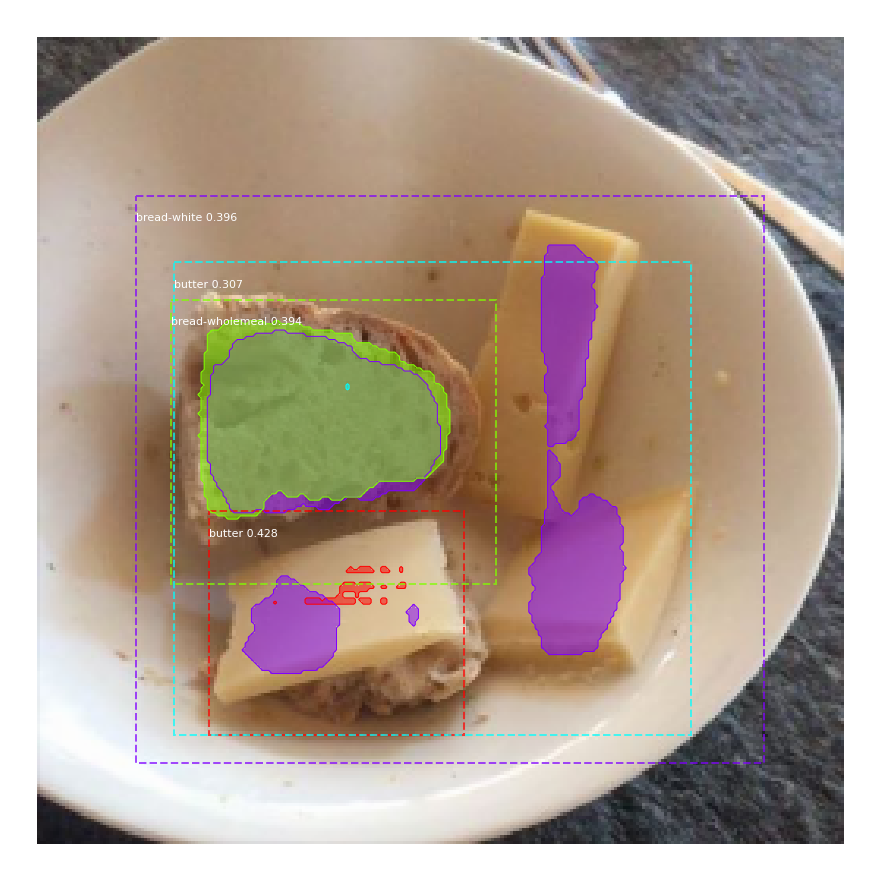

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


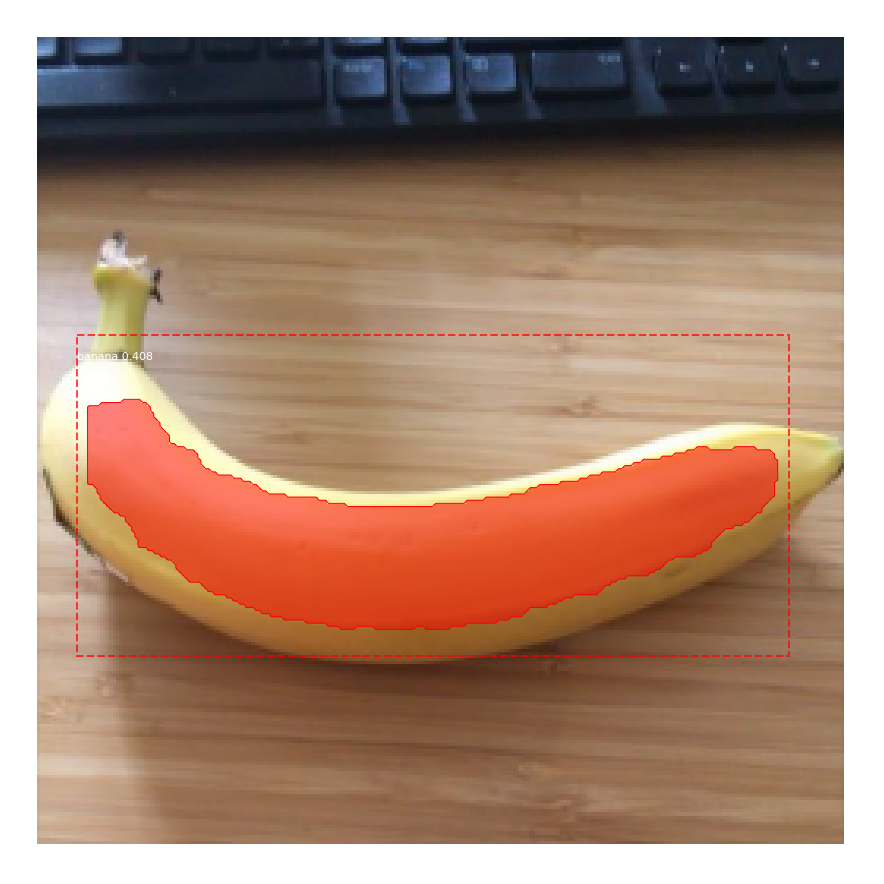

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


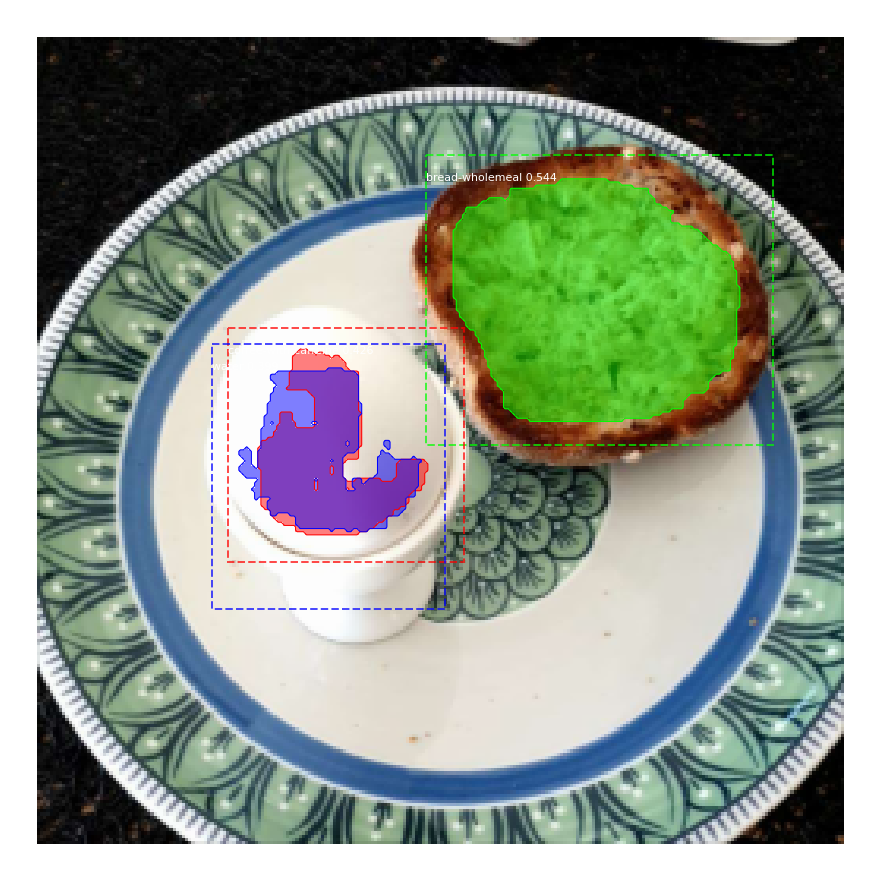

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 47/65
69/70 [============================>.] - ETA: 0s - loss: 1.0230 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.1917 - mrcnn_class_loss: 0.1331 - mrcnn_bbox_loss: 0.2076 - mrcnn_mask_loss: 0.4817

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 86s 1s/step - loss: 1.0244 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.1947 - mrcnn_class_loss: 0.1317 - mrcnn_bbox_loss: 0.2068 - mrcnn_mask_loss: 0.4823 - val_loss: 1.1988 - val_rpn_class_loss: 0.0103 - val_rpn_bbox_loss: 0.3325 - val_mrcnn_class_loss: 0.1379 - val_mrcnn_bbox_loss: 0.2669 - val_mrcnn_mask_loss: 0.4513
Uploading images to wandb...


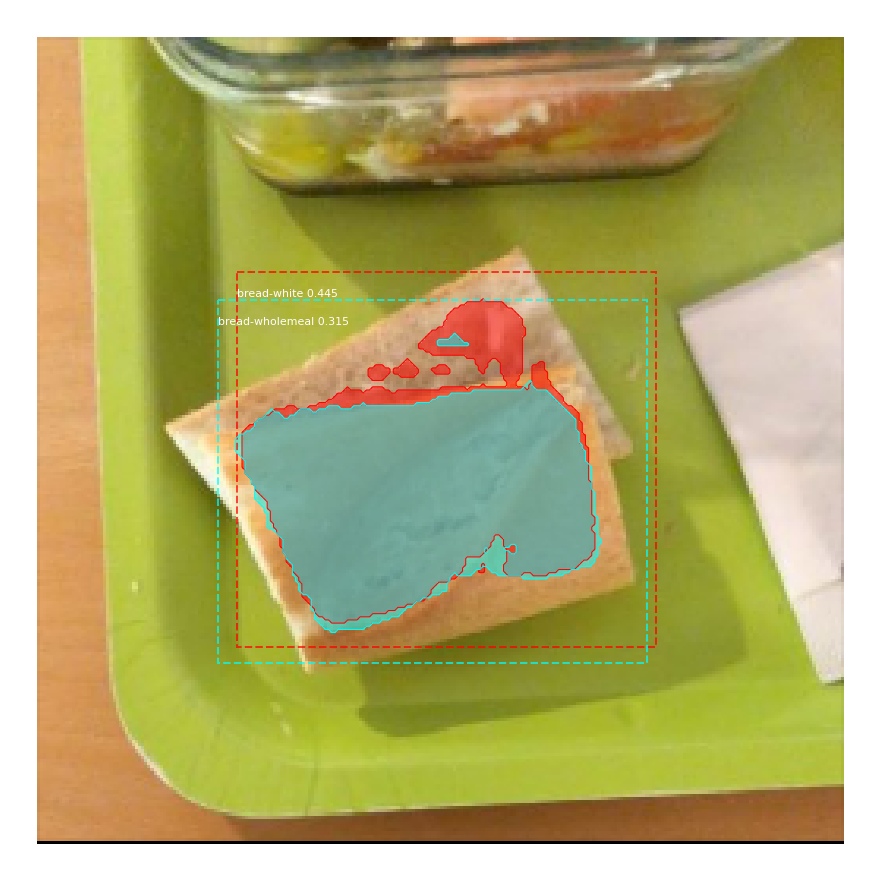

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


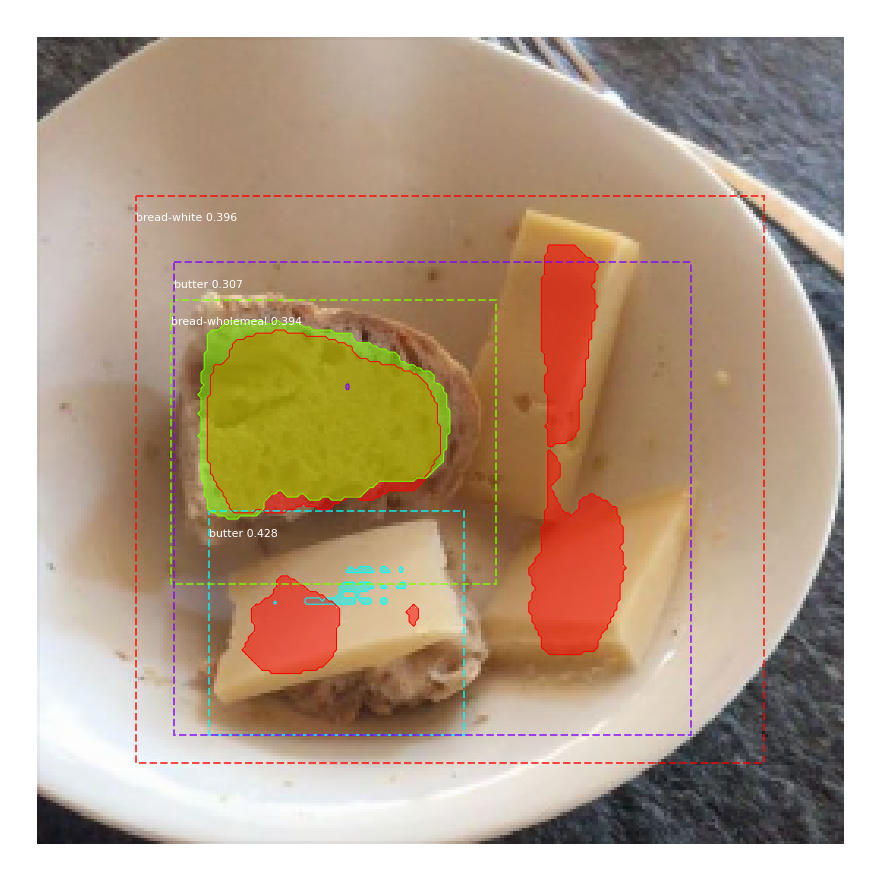

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


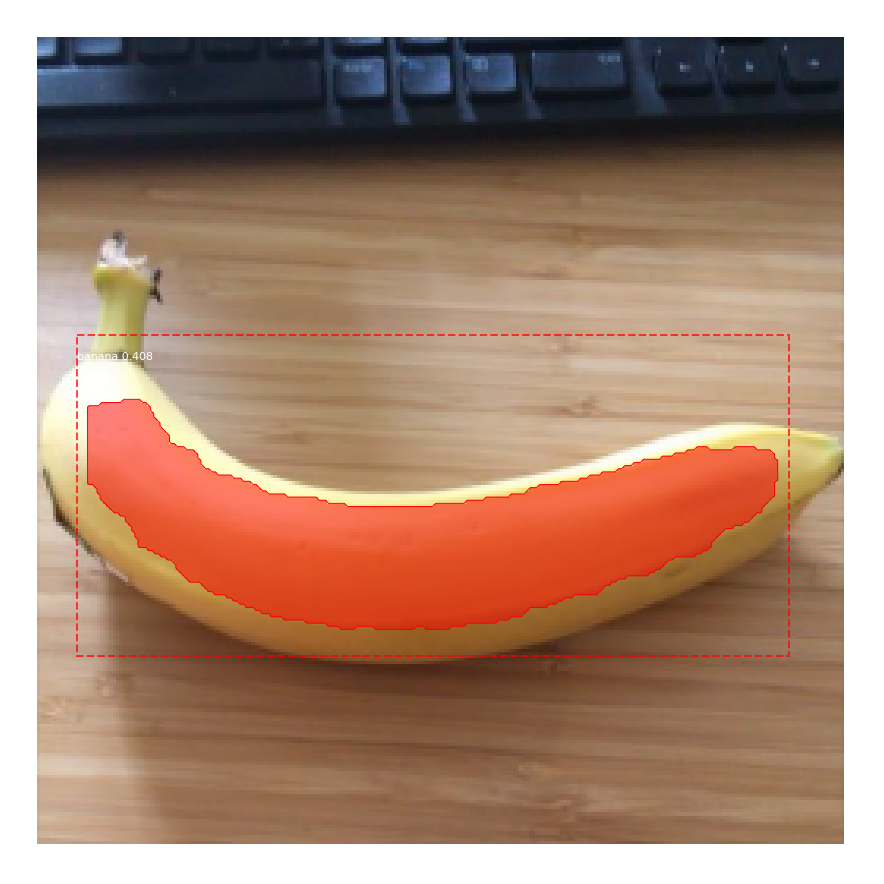

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


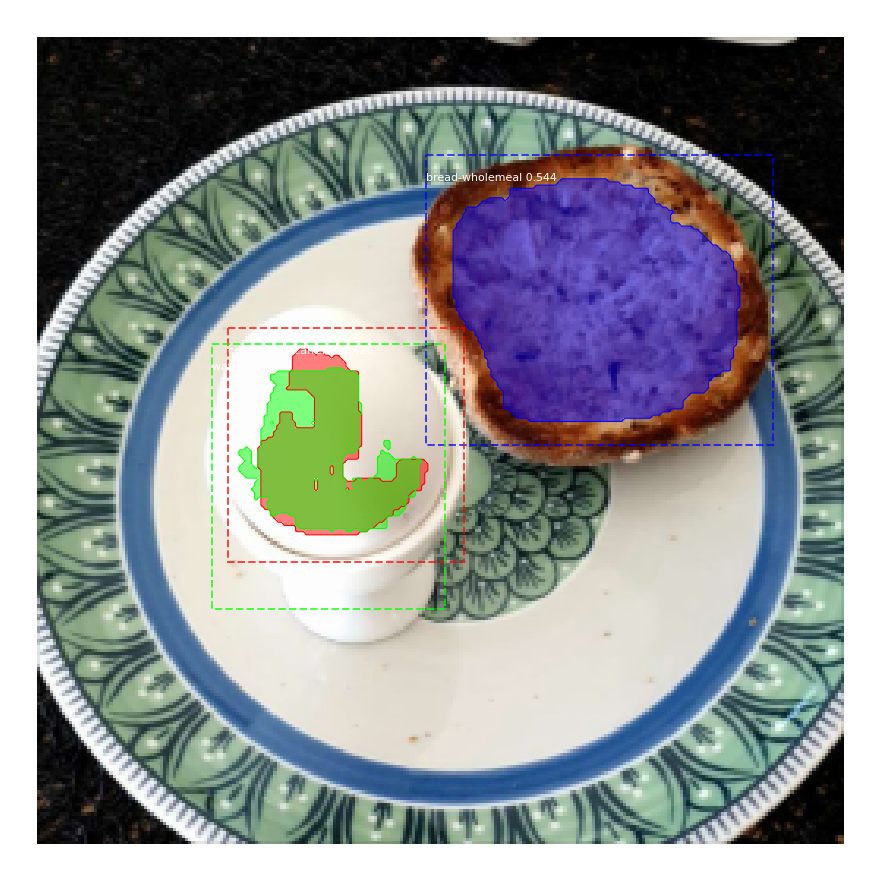

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 48/65
69/70 [============================>.] - ETA: 0s - loss: 1.0677 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.2490 - mrcnn_class_loss: 0.1347 - mrcnn_bbox_loss: 0.2174 - mrcnn_mask_loss: 0.4567

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 81s 1s/step - loss: 1.0682 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.2495 - mrcnn_class_loss: 0.1341 - mrcnn_bbox_loss: 0.2180 - mrcnn_mask_loss: 0.4565 - val_loss: 1.0877 - val_rpn_class_loss: 0.0132 - val_rpn_bbox_loss: 0.2733 - val_mrcnn_class_loss: 0.1287 - val_mrcnn_bbox_loss: 0.2193 - val_mrcnn_mask_loss: 0.4533
Uploading images to wandb...


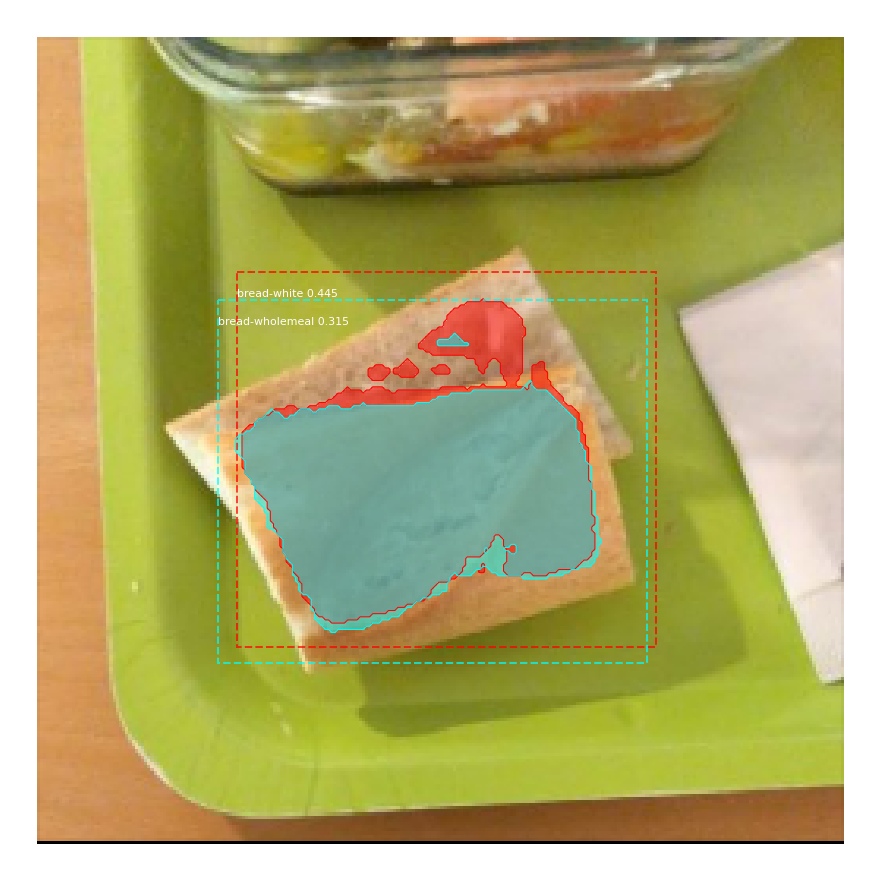

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


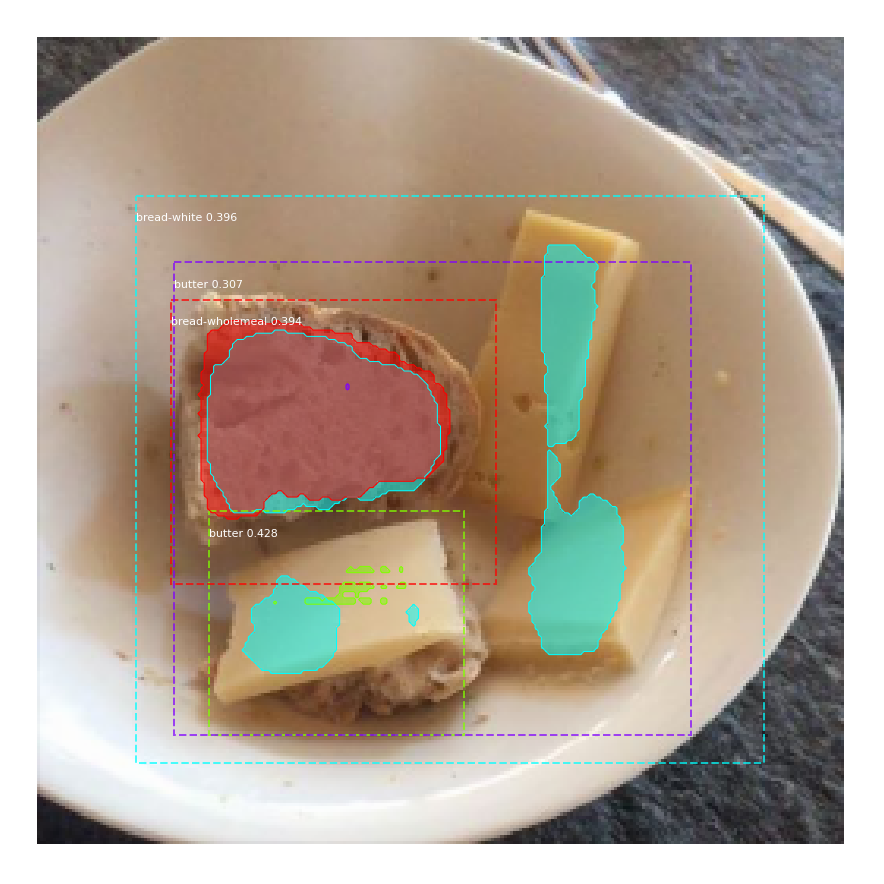

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


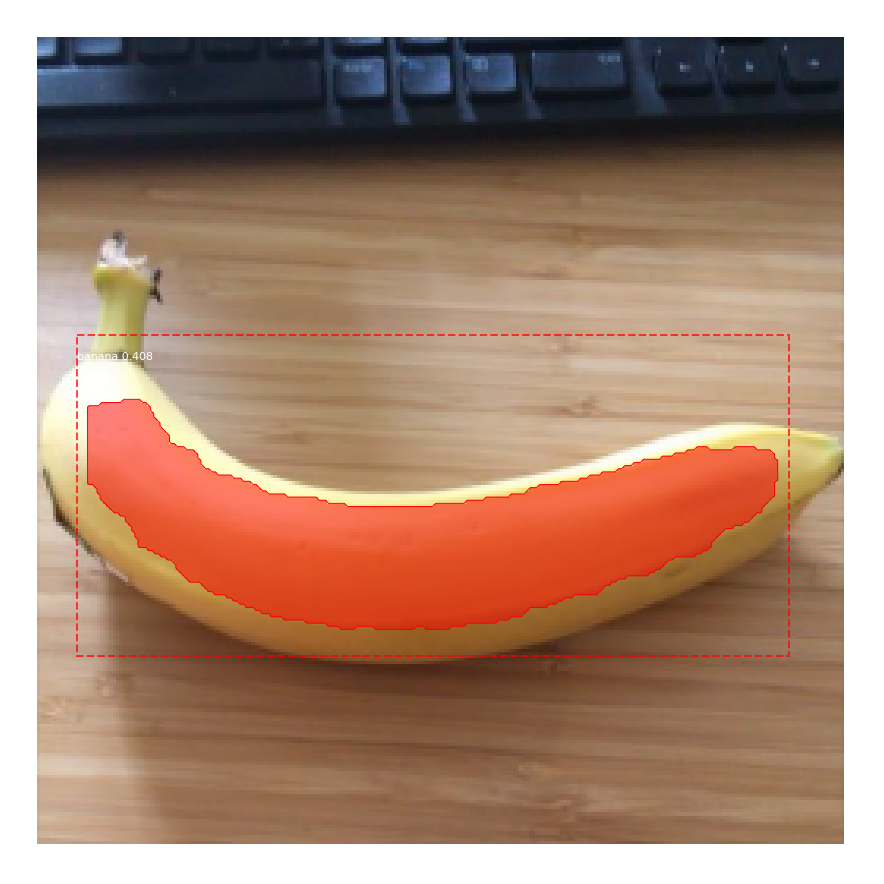

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


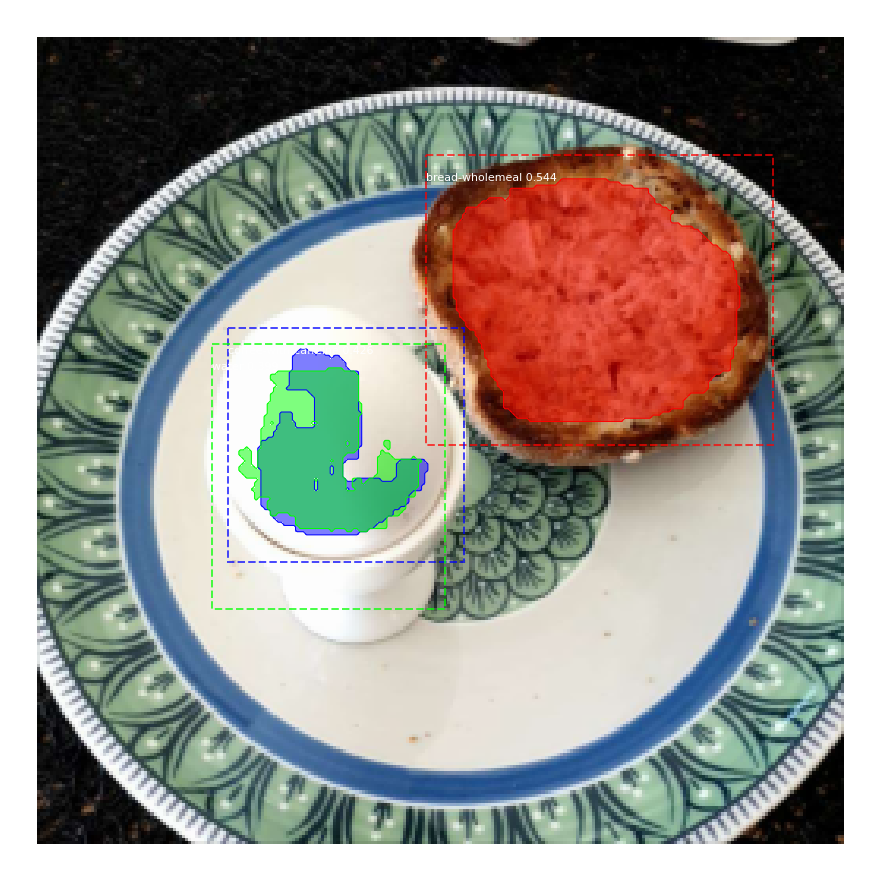

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 49/65
69/70 [============================>.] - ETA: 0s - loss: 1.0348 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2338 - mrcnn_class_loss: 0.1354 - mrcnn_bbox_loss: 0.2160 - mrcnn_mask_loss: 0.4418

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 81s 1s/step - loss: 1.0347 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2334 - mrcnn_class_loss: 0.1348 - mrcnn_bbox_loss: 0.2145 - mrcnn_mask_loss: 0.4442 - val_loss: 1.0533 - val_rpn_class_loss: 0.0110 - val_rpn_bbox_loss: 0.2534 - val_mrcnn_class_loss: 0.1340 - val_mrcnn_bbox_loss: 0.2312 - val_mrcnn_mask_loss: 0.4237
Uploading images to wandb...


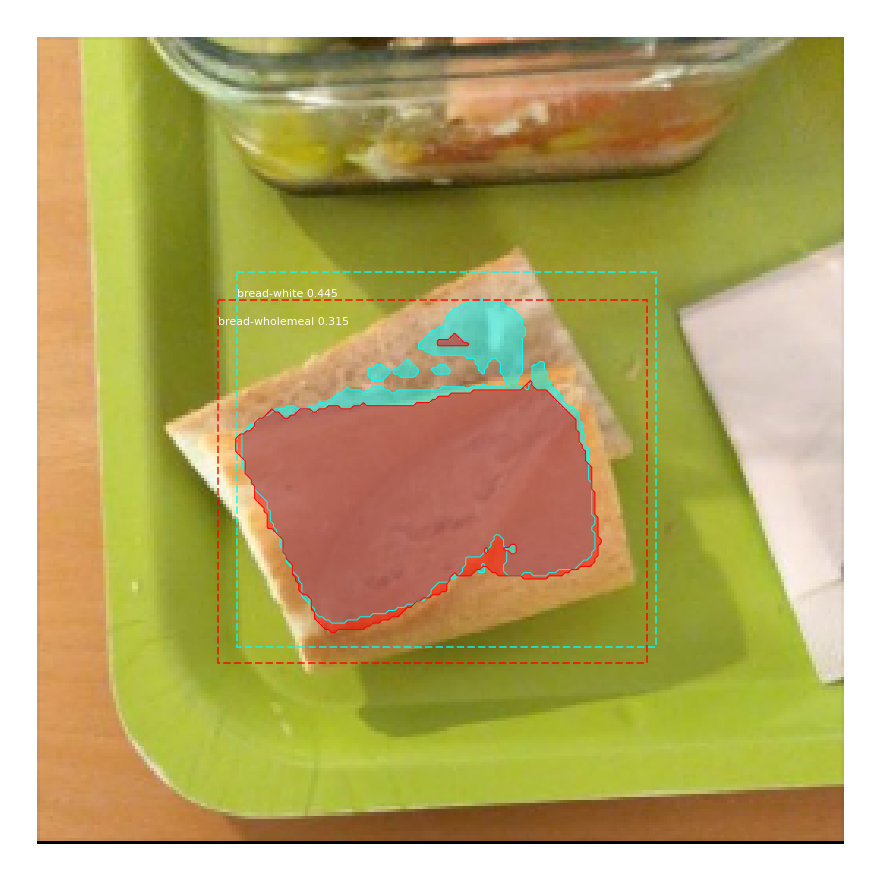

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


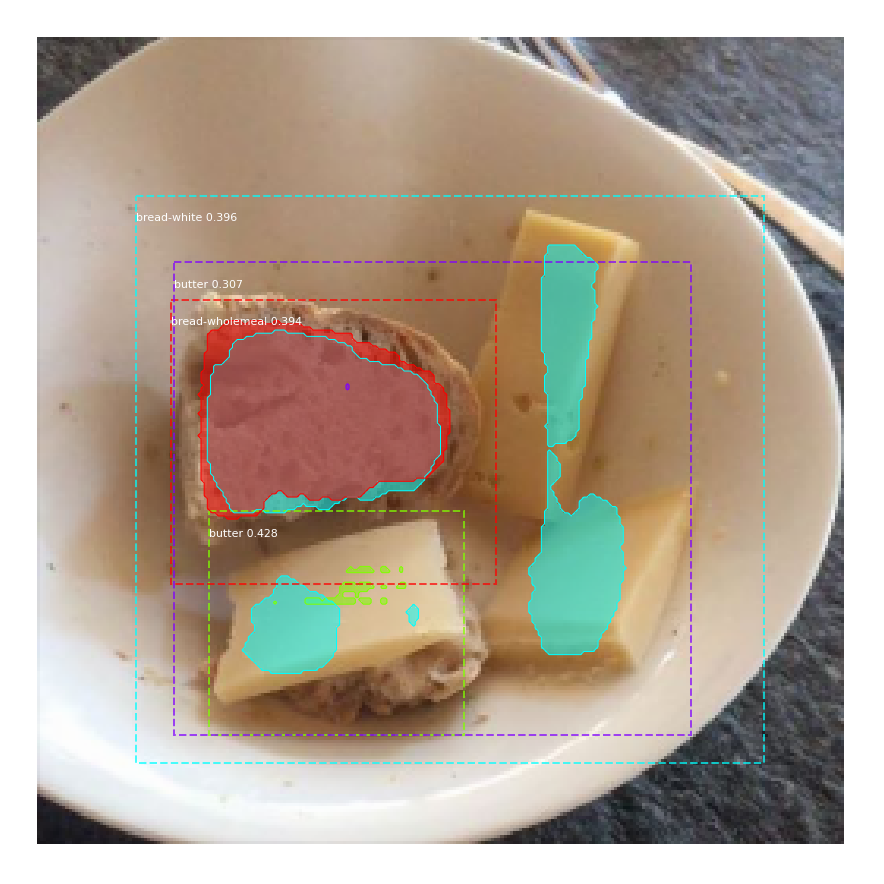

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


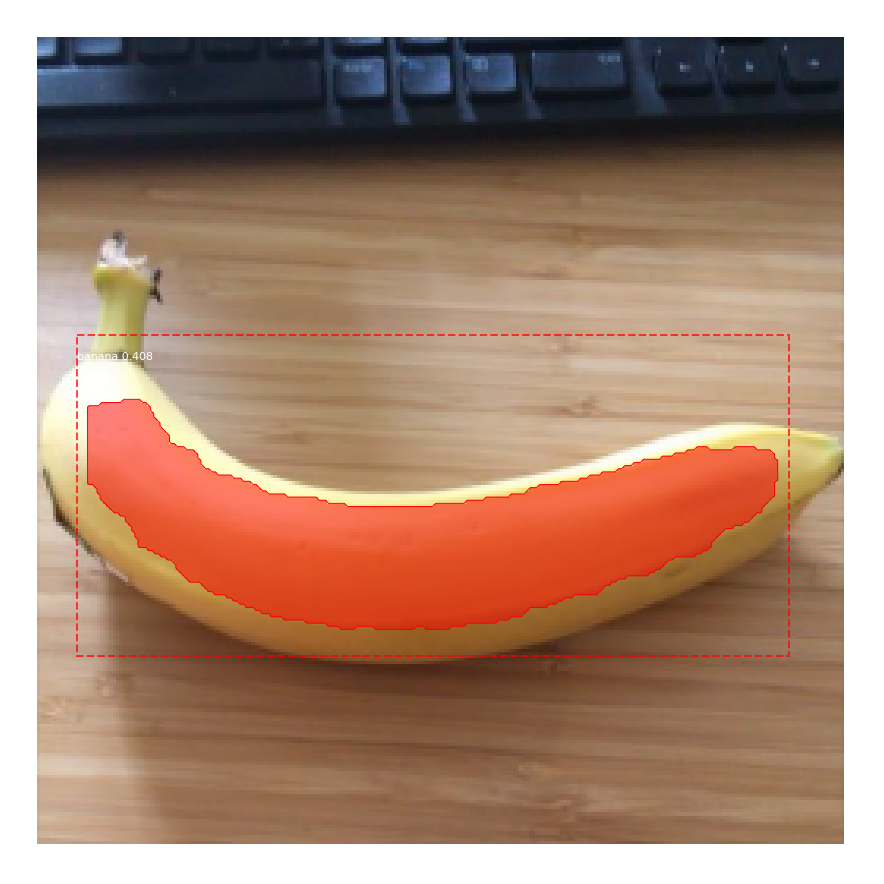

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


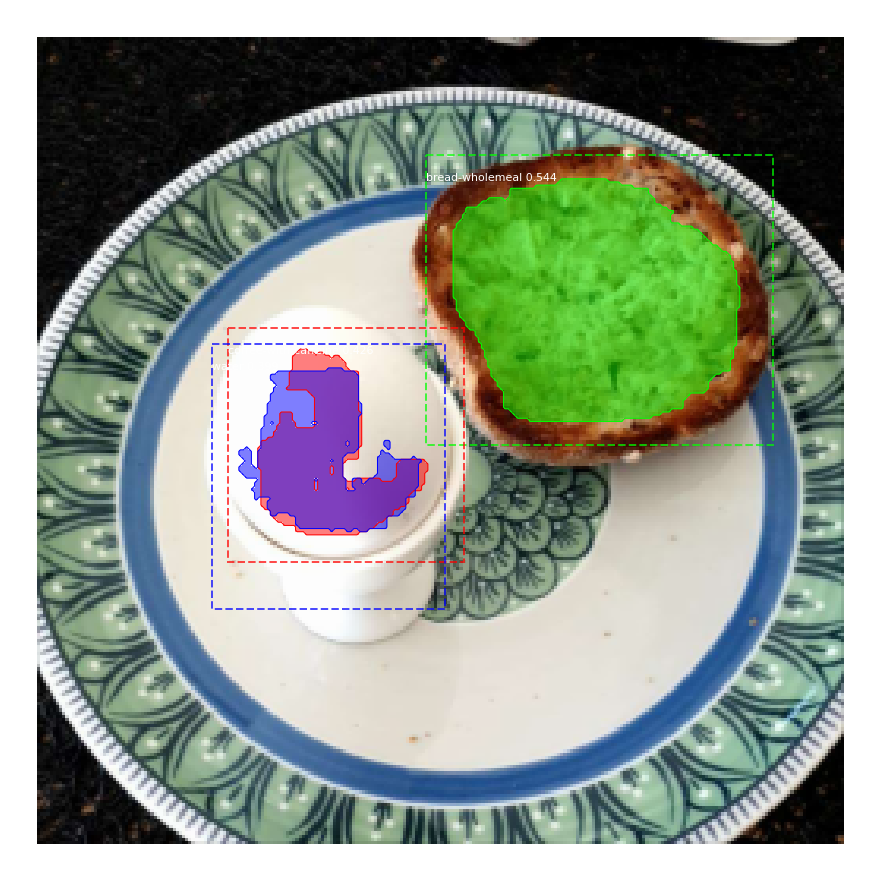

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 50/65
69/70 [============================>.] - ETA: 0s - loss: 1.0438 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.1989 - mrcnn_class_loss: 0.1630 - mrcnn_bbox_loss: 0.2217 - mrcnn_mask_loss: 0.4512

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 82s 1s/step - loss: 1.0391 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.1974 - mrcnn_class_loss: 0.1613 - mrcnn_bbox_loss: 0.2220 - mrcnn_mask_loss: 0.4496 - val_loss: 1.0998 - val_rpn_class_loss: 0.0121 - val_rpn_bbox_loss: 0.2812 - val_mrcnn_class_loss: 0.1400 - val_mrcnn_bbox_loss: 0.2226 - val_mrcnn_mask_loss: 0.4439
Uploading images to wandb...


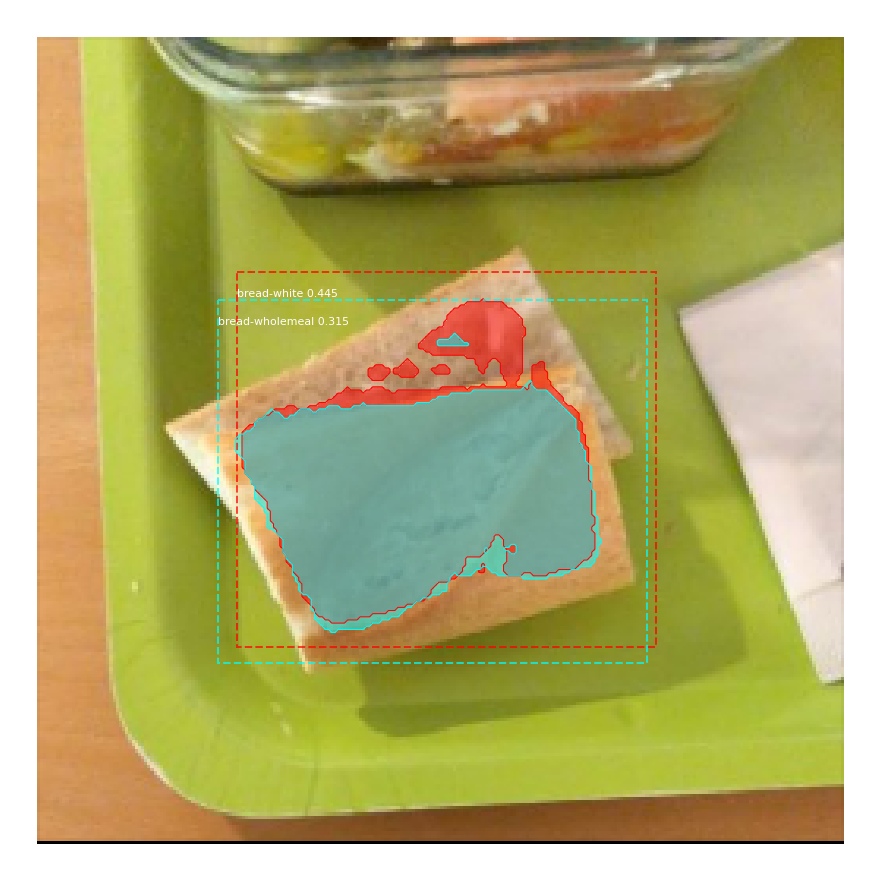

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


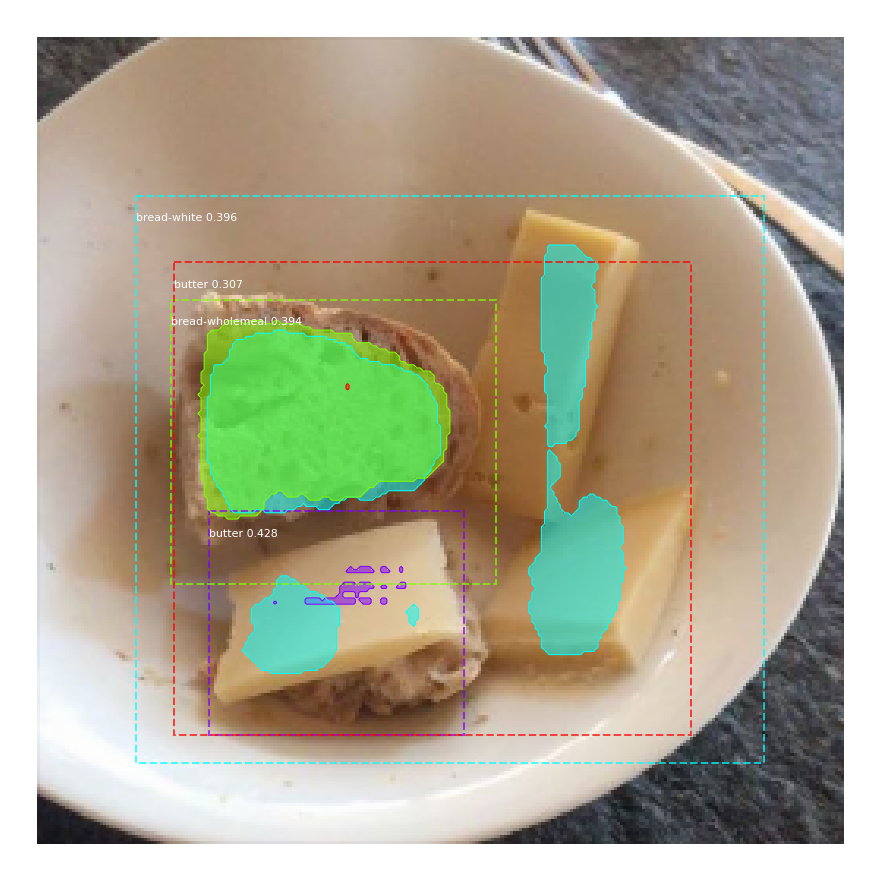

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


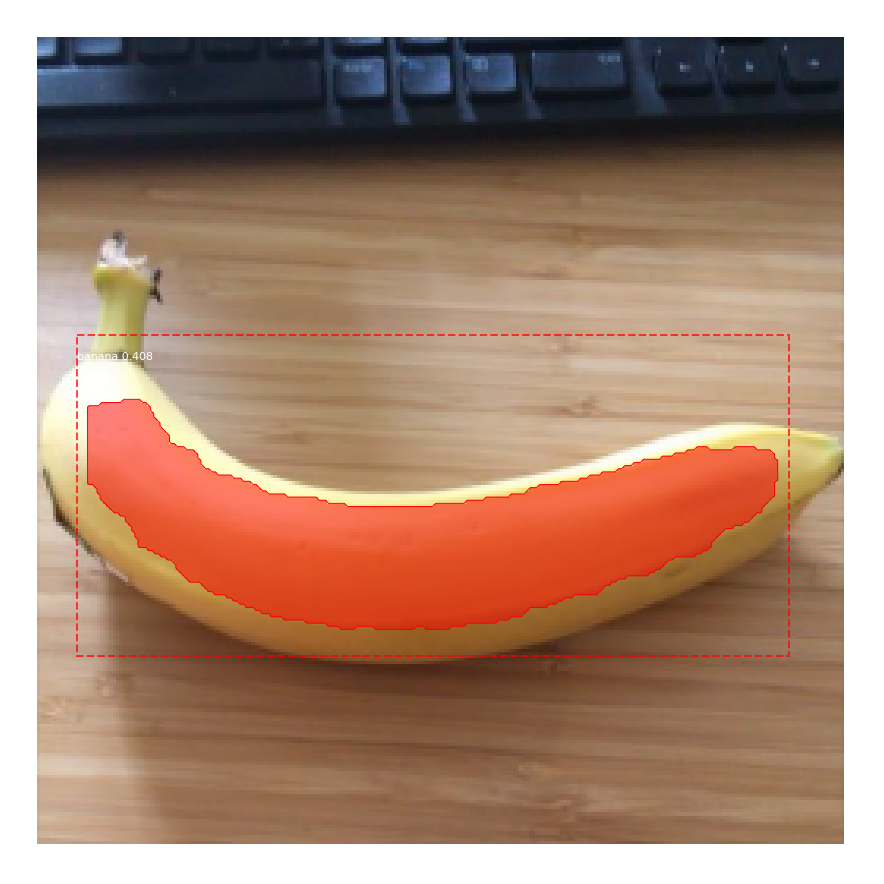

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


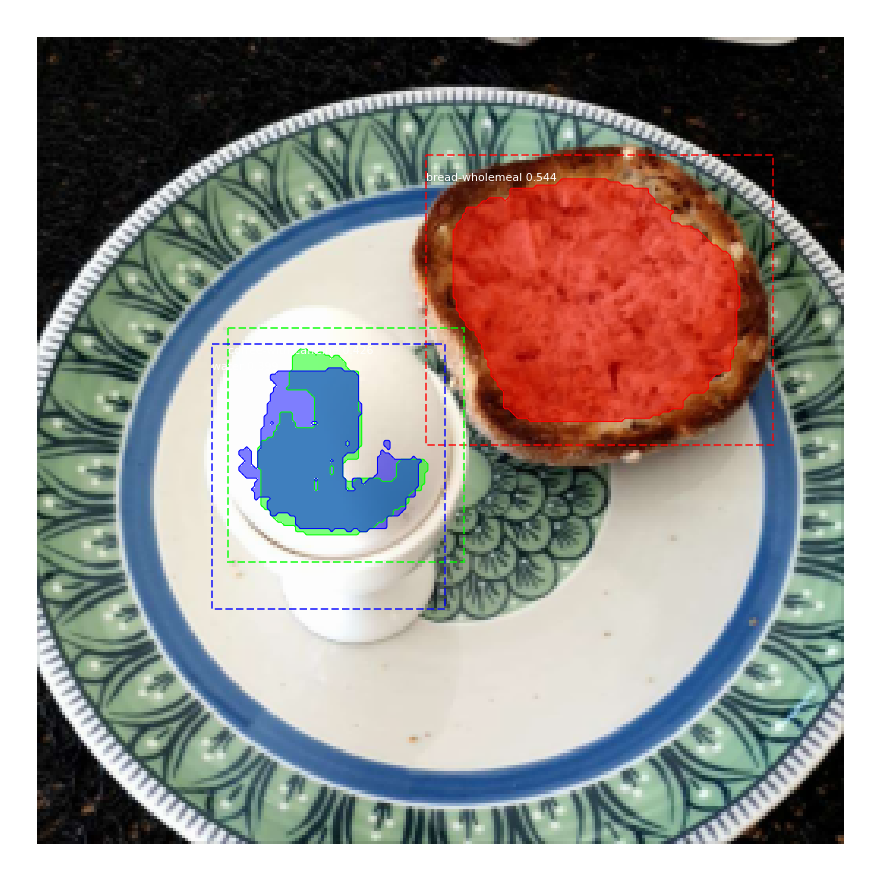

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 51/65
69/70 [============================>.] - ETA: 0s - loss: 0.9569 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1806 - mrcnn_class_loss: 0.1229 - mrcnn_bbox_loss: 0.2013 - mrcnn_mask_loss: 0.4449

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 87s 1s/step - loss: 0.9519 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1784 - mrcnn_class_loss: 0.1219 - mrcnn_bbox_loss: 0.2001 - mrcnn_mask_loss: 0.4443 - val_loss: 1.1158 - val_rpn_class_loss: 0.0074 - val_rpn_bbox_loss: 0.2882 - val_mrcnn_class_loss: 0.1342 - val_mrcnn_bbox_loss: 0.2325 - val_mrcnn_mask_loss: 0.4535
Uploading images to wandb...


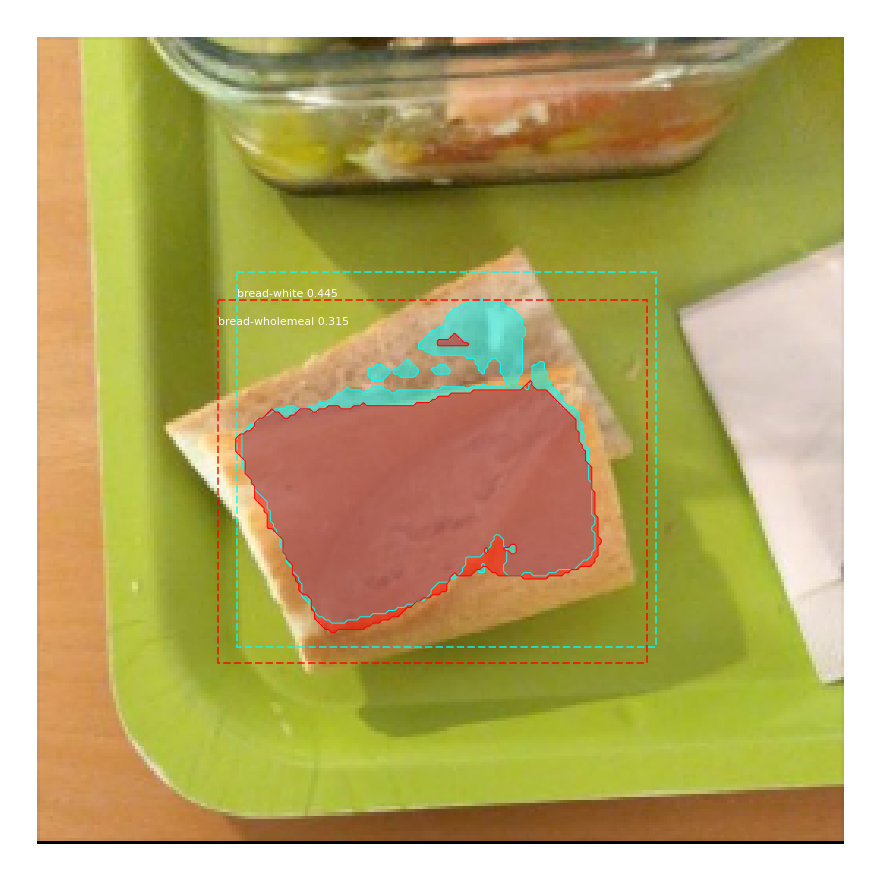

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


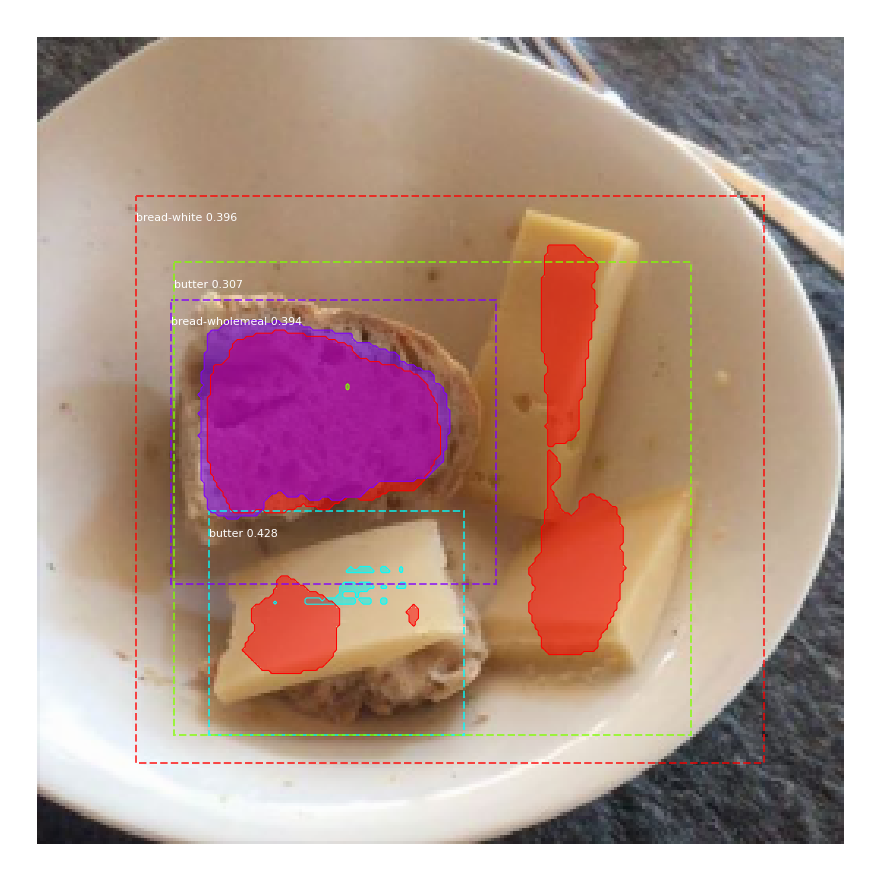

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


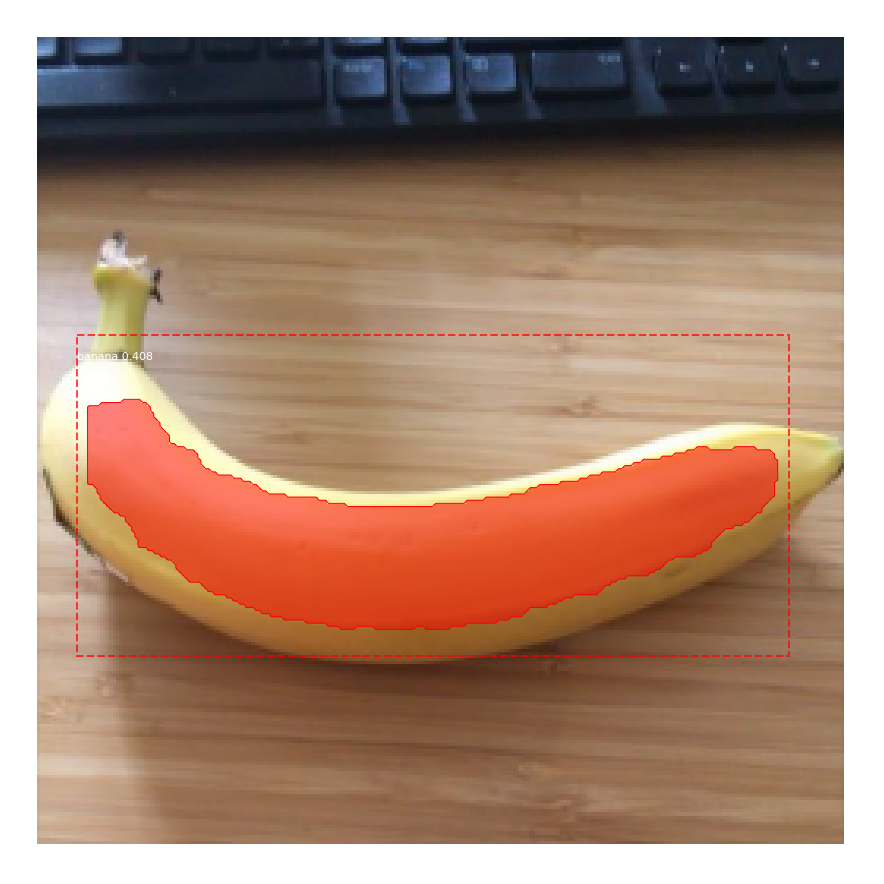

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


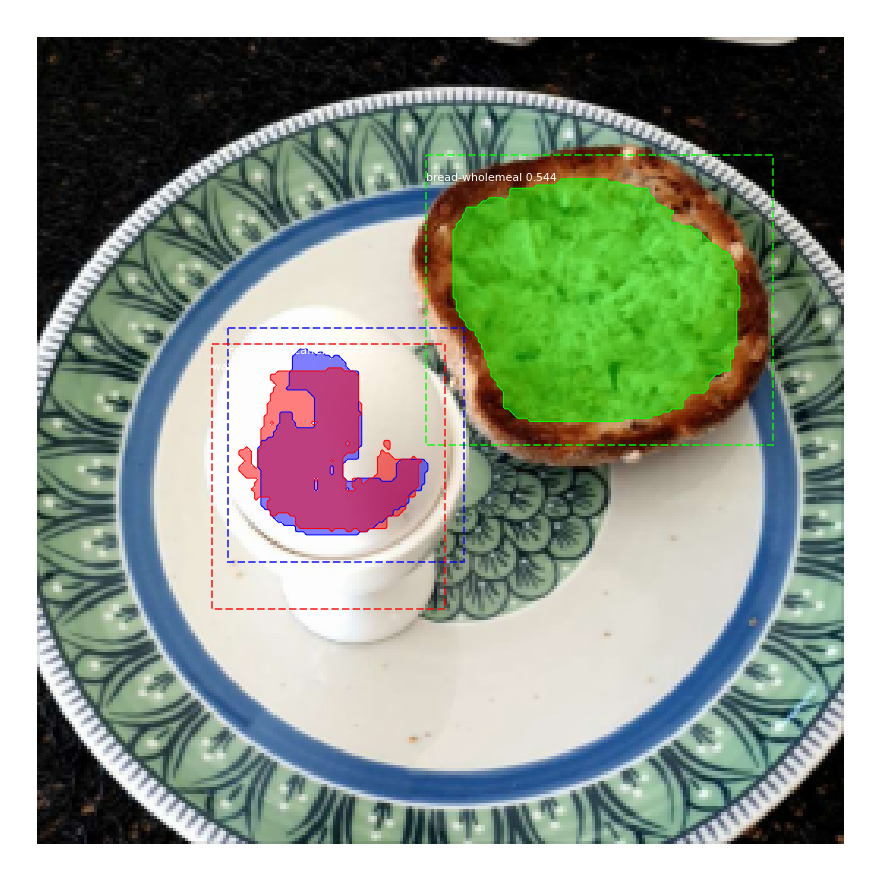

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 52/65
69/70 [============================>.] - ETA: 0s - loss: 0.9538 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.1738 - mrcnn_class_loss: 0.1206 - mrcnn_bbox_loss: 0.2174 - mrcnn_mask_loss: 0.4344

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 83s 1s/step - loss: 0.9534 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.1733 - mrcnn_class_loss: 0.1204 - mrcnn_bbox_loss: 0.2160 - mrcnn_mask_loss: 0.4363 - val_loss: 1.1971 - val_rpn_class_loss: 0.0120 - val_rpn_bbox_loss: 0.3121 - val_mrcnn_class_loss: 0.1653 - val_mrcnn_bbox_loss: 0.2469 - val_mrcnn_mask_loss: 0.4606
Uploading images to wandb...


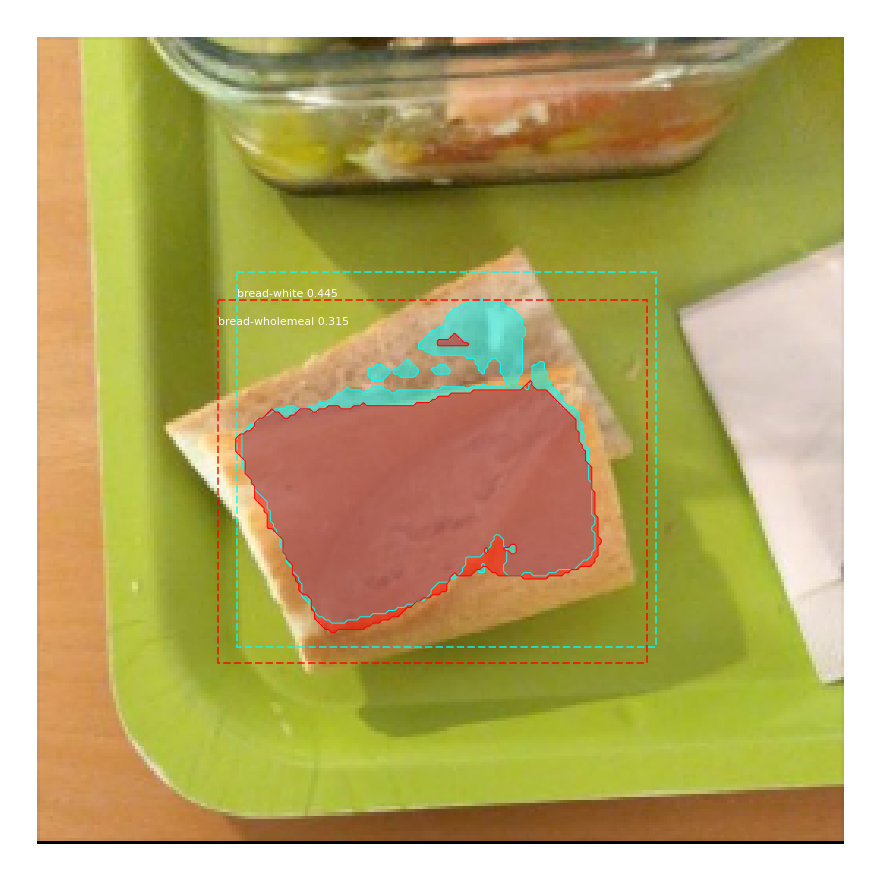

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


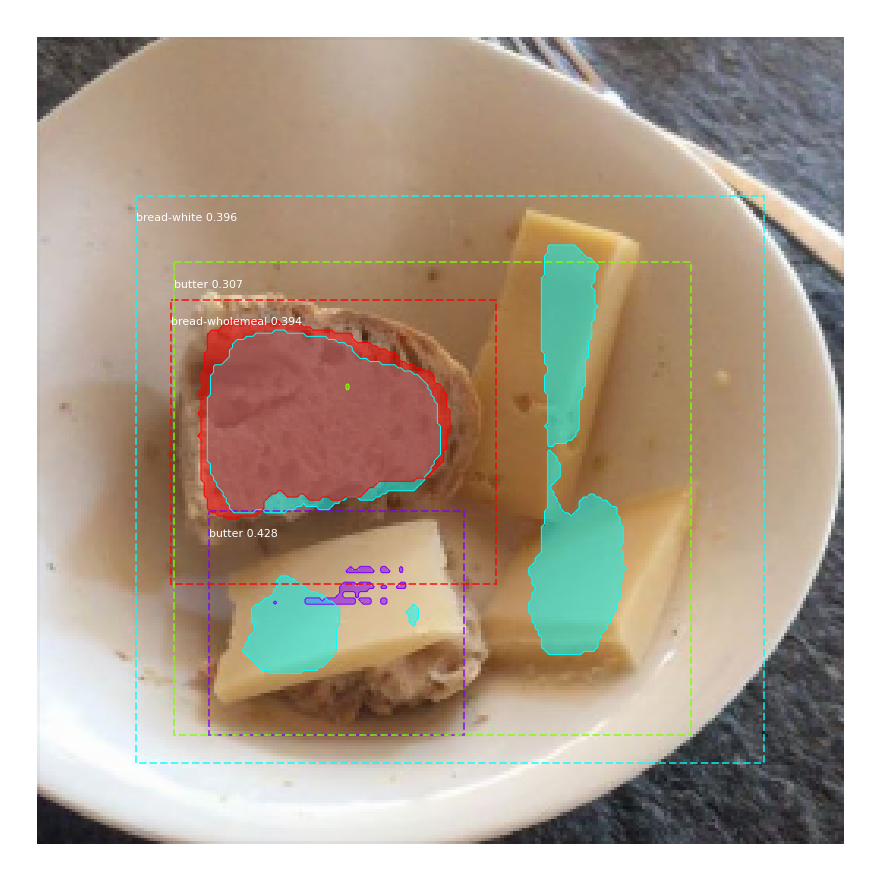

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


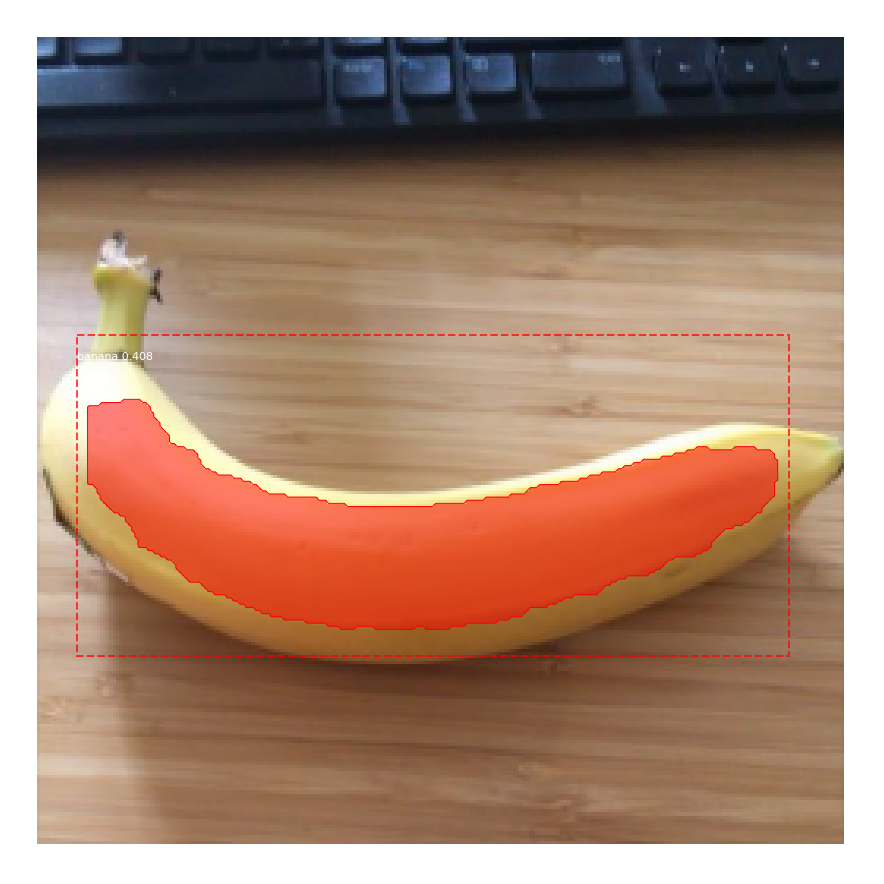

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


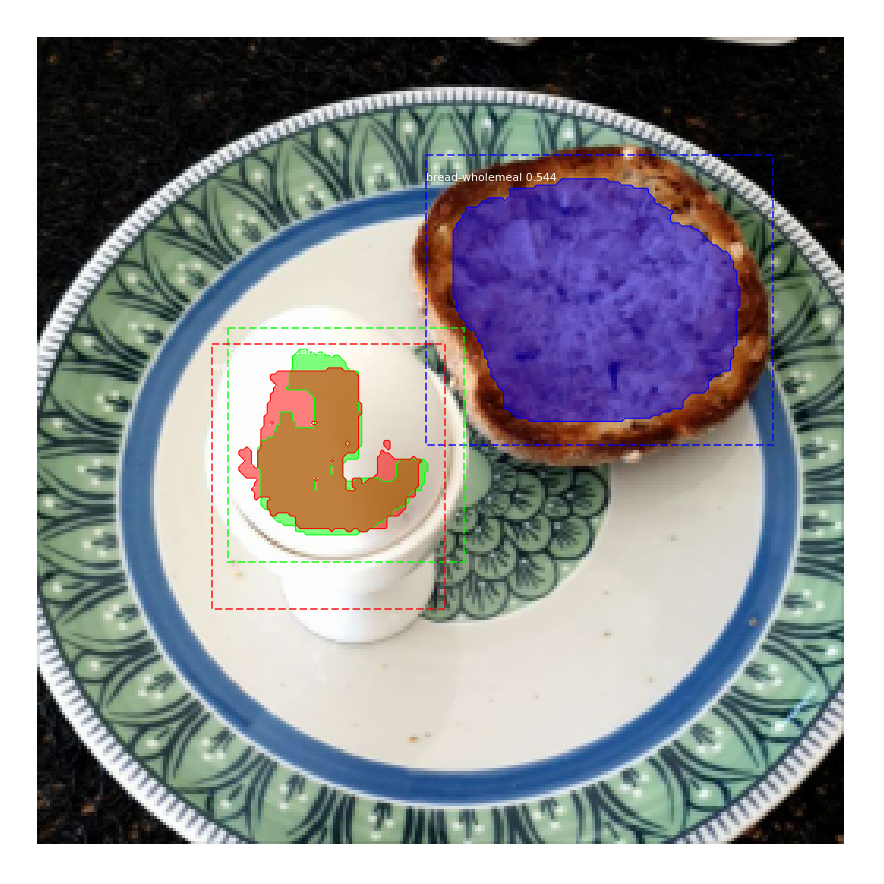

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 53/65
69/70 [============================>.] - ETA: 0s - loss: 1.0342 - rpn_class_loss: 0.0098 - rpn_bbox_loss: 0.2093 - mrcnn_class_loss: 0.1347 - mrcnn_bbox_loss: 0.2176 - mrcnn_mask_loss: 0.4628

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 82s 1s/step - loss: 1.0304 - rpn_class_loss: 0.0098 - rpn_bbox_loss: 0.2068 - mrcnn_class_loss: 0.1340 - mrcnn_bbox_loss: 0.2166 - mrcnn_mask_loss: 0.4631 - val_loss: 1.1680 - val_rpn_class_loss: 0.0079 - val_rpn_bbox_loss: 0.3712 - val_mrcnn_class_loss: 0.1108 - val_mrcnn_bbox_loss: 0.2069 - val_mrcnn_mask_loss: 0.4711
Uploading images to wandb...


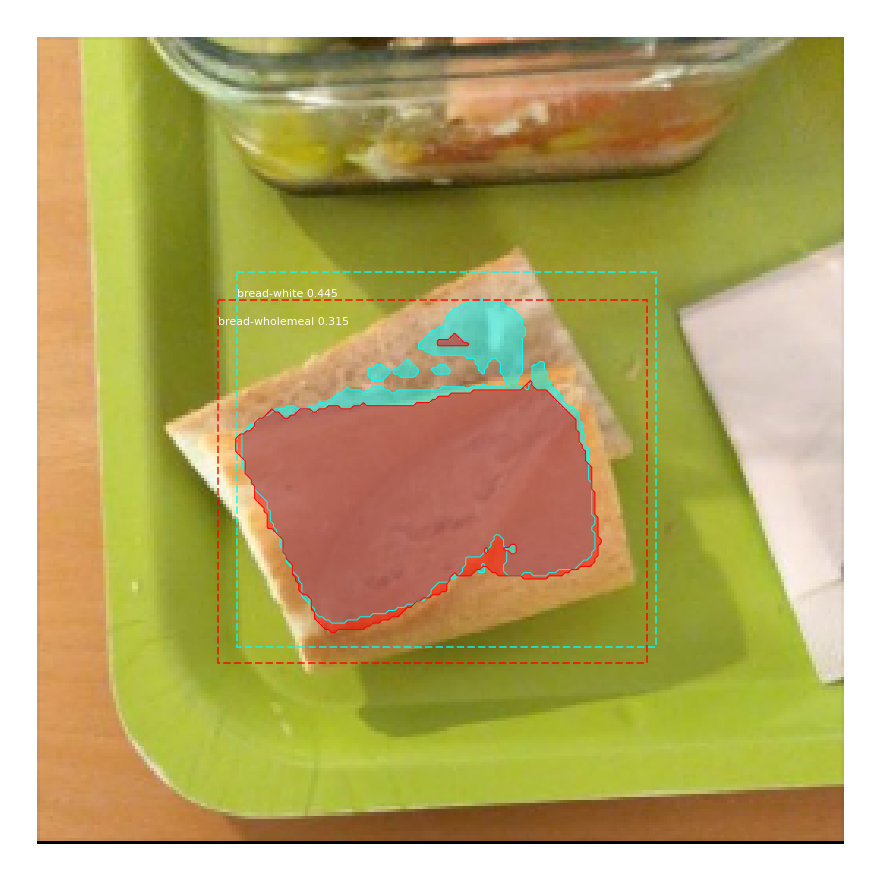

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


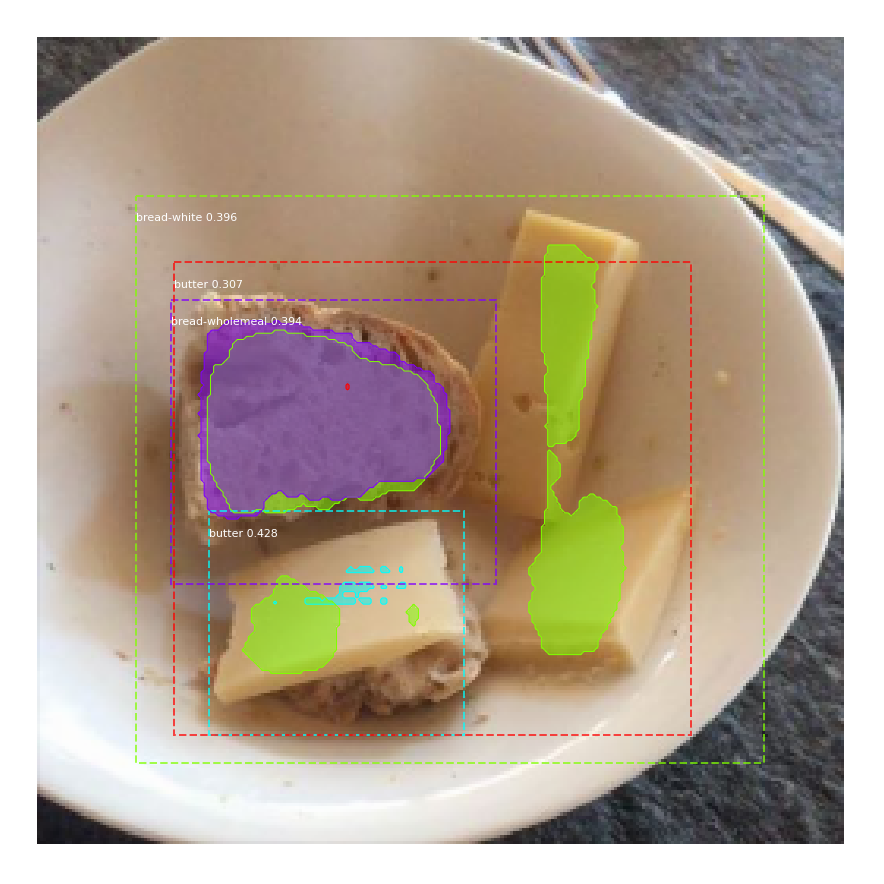

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


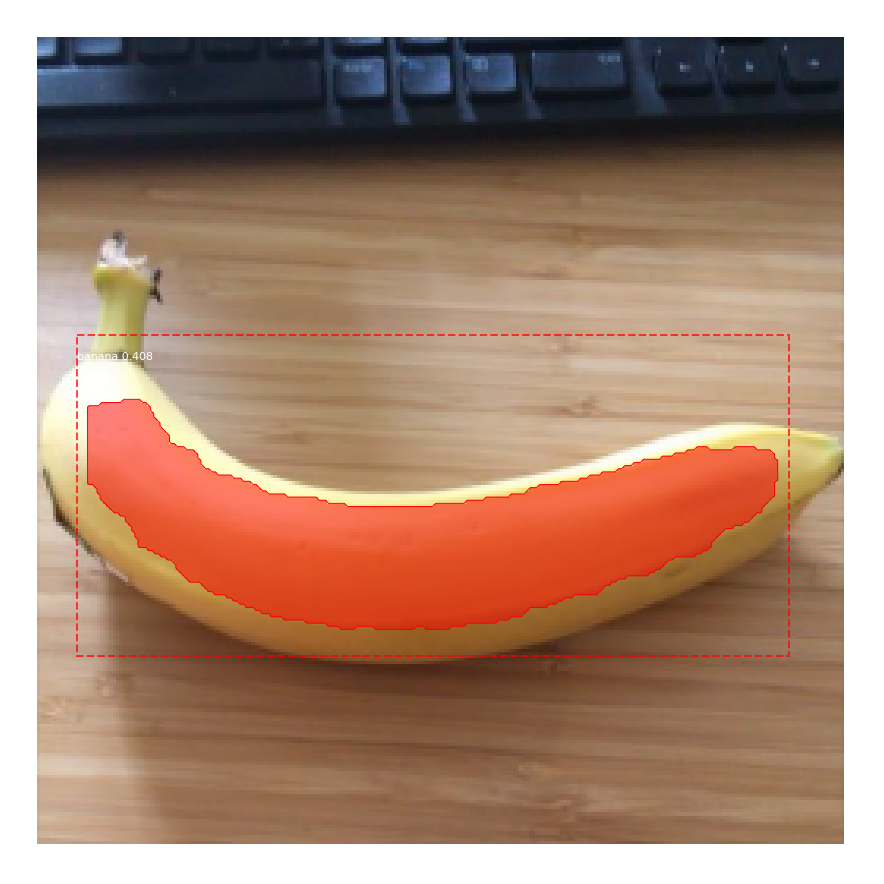

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


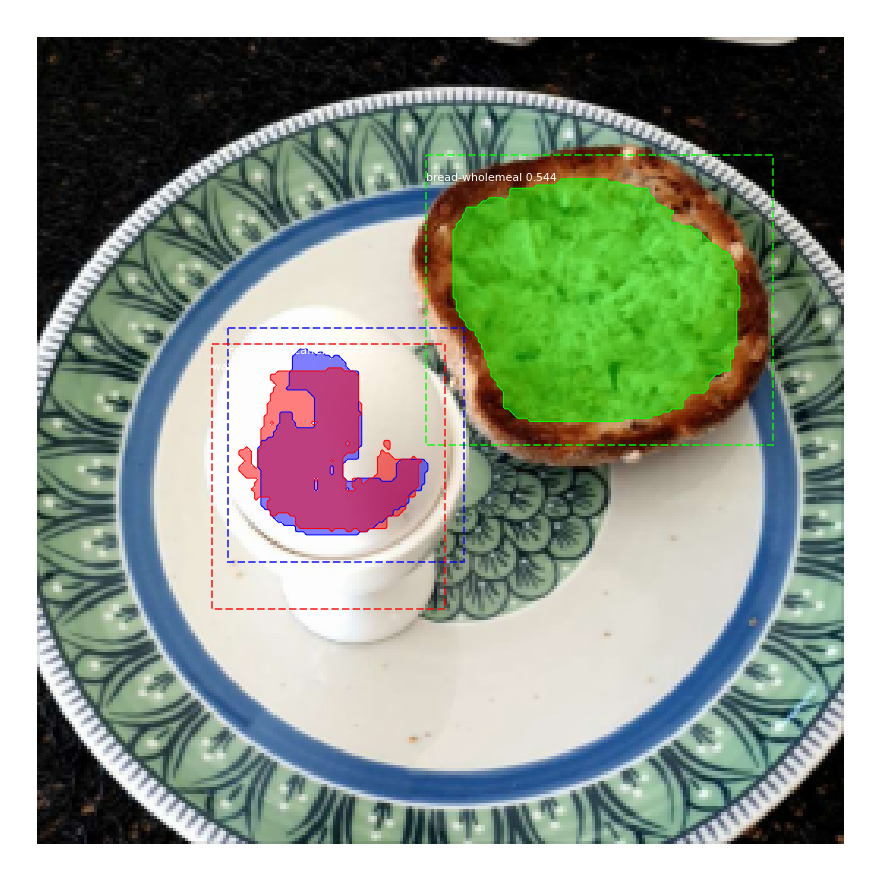

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 54/65
69/70 [============================>.] - ETA: 0s - loss: 1.0077 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1889 - mrcnn_class_loss: 0.1398 - mrcnn_bbox_loss: 0.2255 - mrcnn_mask_loss: 0.4463

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 82s 1s/step - loss: 1.0063 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1871 - mrcnn_class_loss: 0.1398 - mrcnn_bbox_loss: 0.2244 - mrcnn_mask_loss: 0.4479 - val_loss: 1.0120 - val_rpn_class_loss: 0.0090 - val_rpn_bbox_loss: 0.2093 - val_mrcnn_class_loss: 0.1308 - val_mrcnn_bbox_loss: 0.2082 - val_mrcnn_mask_loss: 0.4547
Uploading images to wandb...


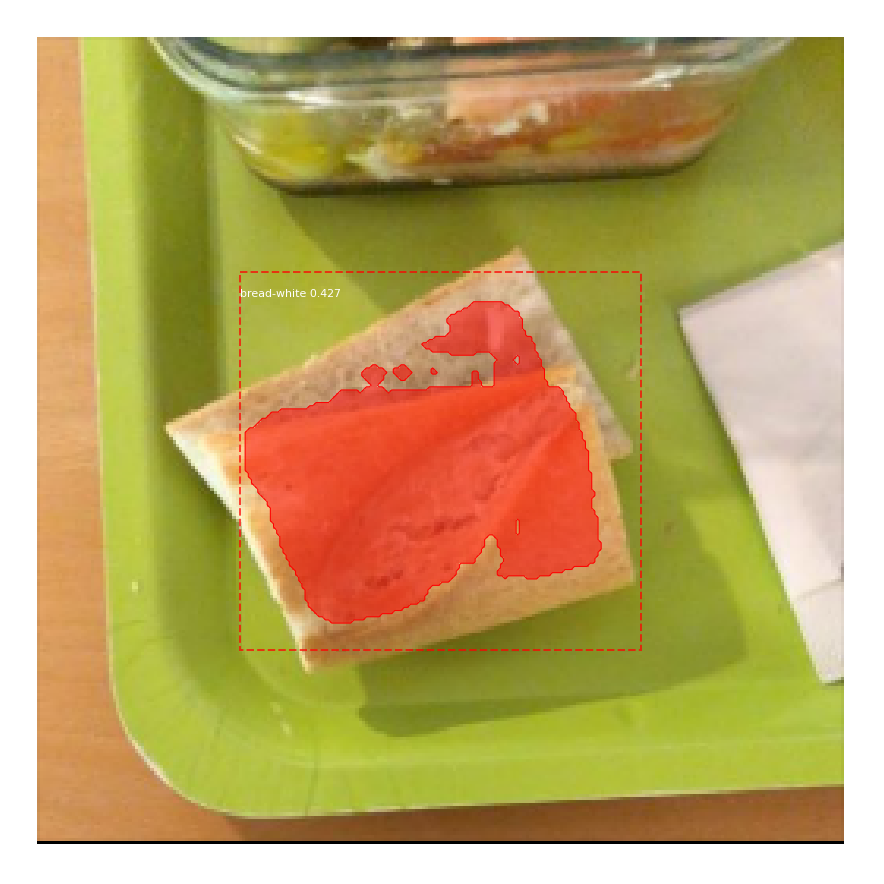

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


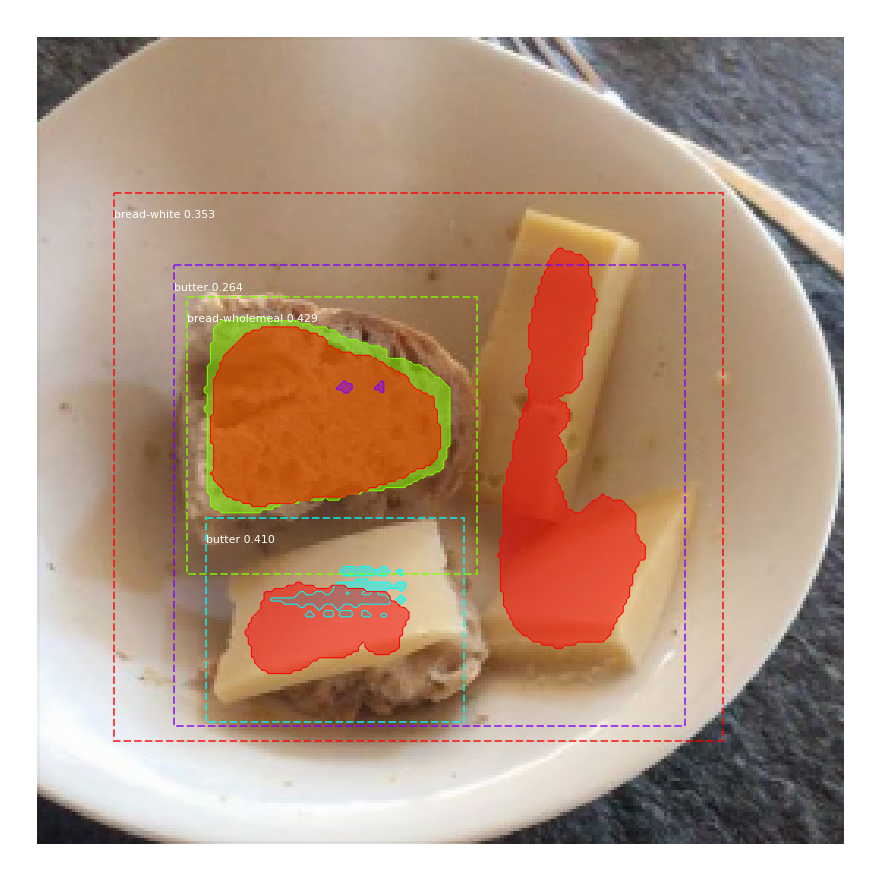

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


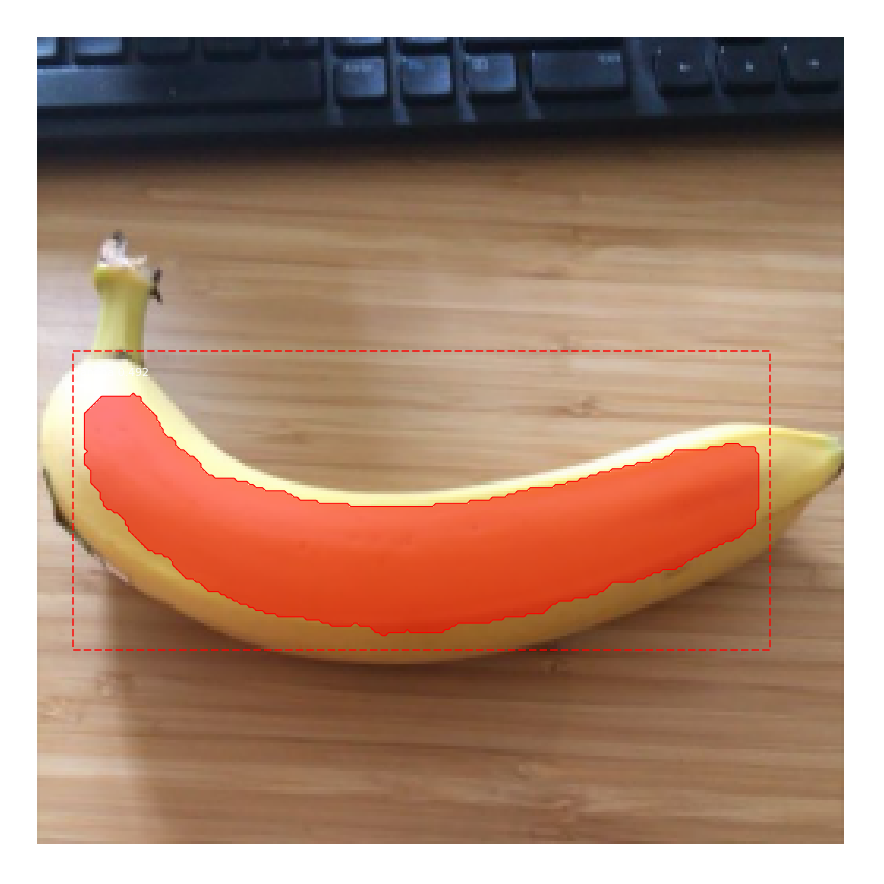

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


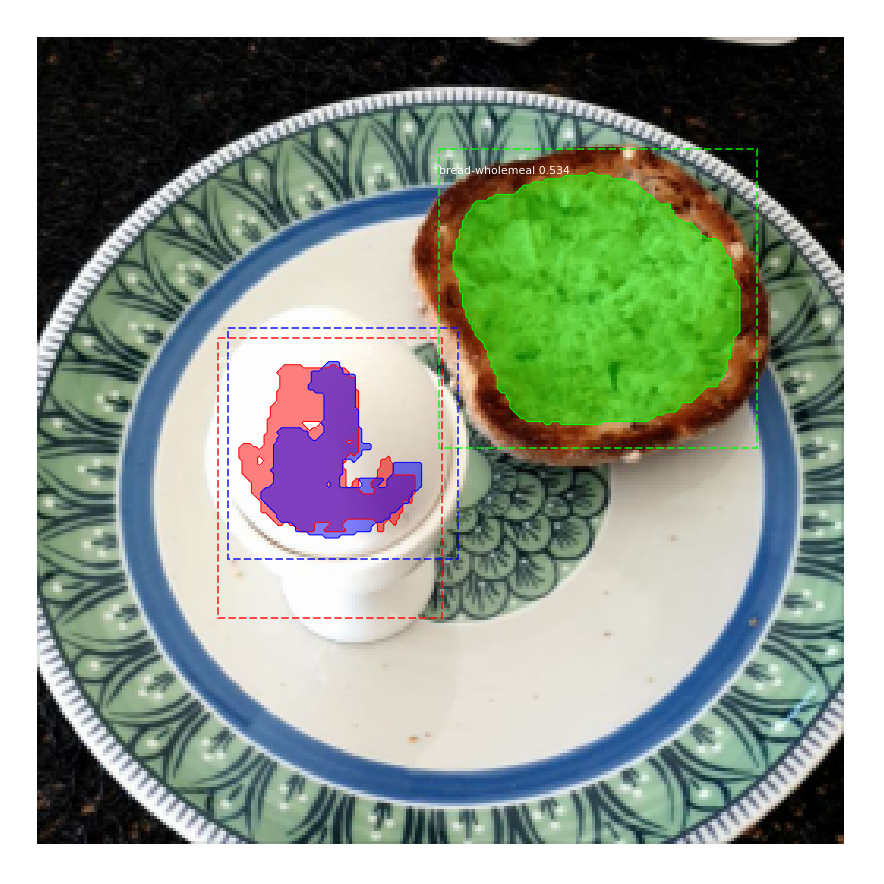

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 55/65
69/70 [============================>.] - ETA: 0s - loss: 0.9206 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.1372 - mrcnn_class_loss: 0.1297 - mrcnn_bbox_loss: 0.1971 - mrcnn_mask_loss: 0.4501

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 82s 1s/step - loss: 0.9158 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1358 - mrcnn_class_loss: 0.1282 - mrcnn_bbox_loss: 0.1949 - mrcnn_mask_loss: 0.4505 - val_loss: 0.9917 - val_rpn_class_loss: 0.0084 - val_rpn_bbox_loss: 0.2088 - val_mrcnn_class_loss: 0.1092 - val_mrcnn_bbox_loss: 0.2066 - val_mrcnn_mask_loss: 0.4587
Uploading images to wandb...


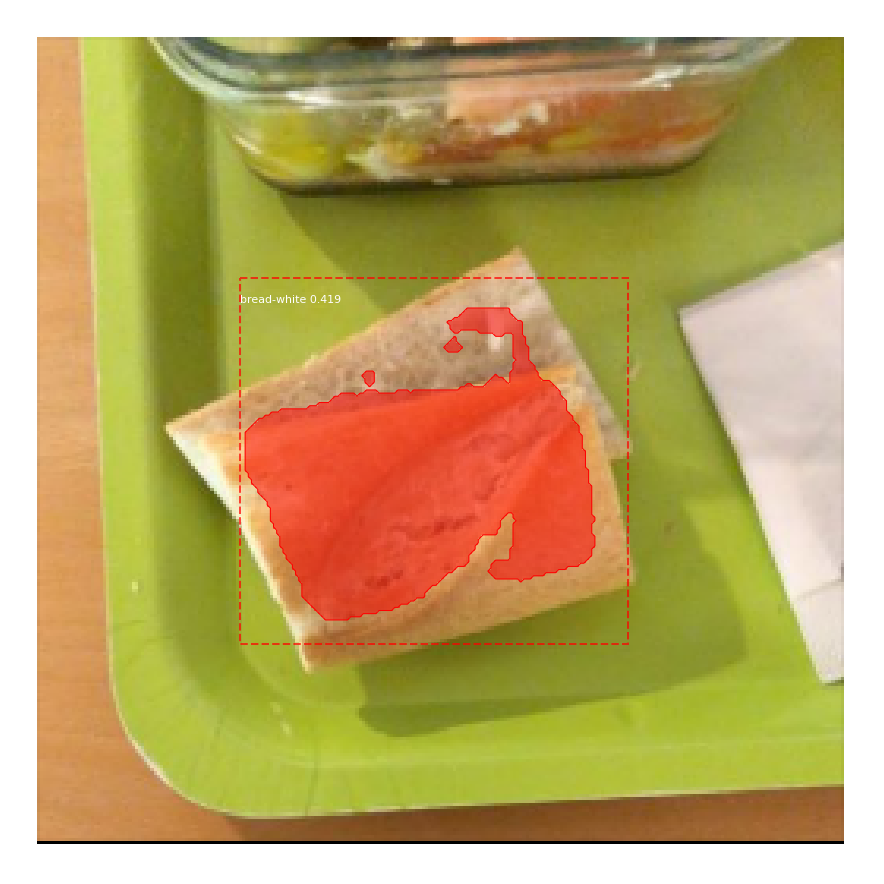

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


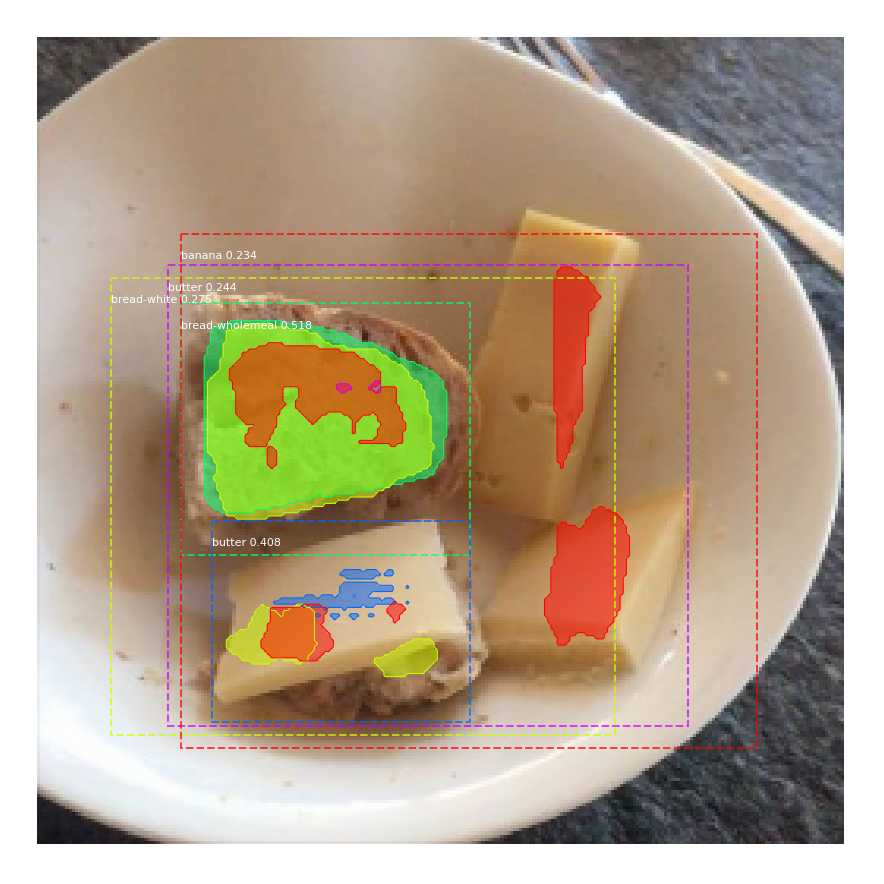

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


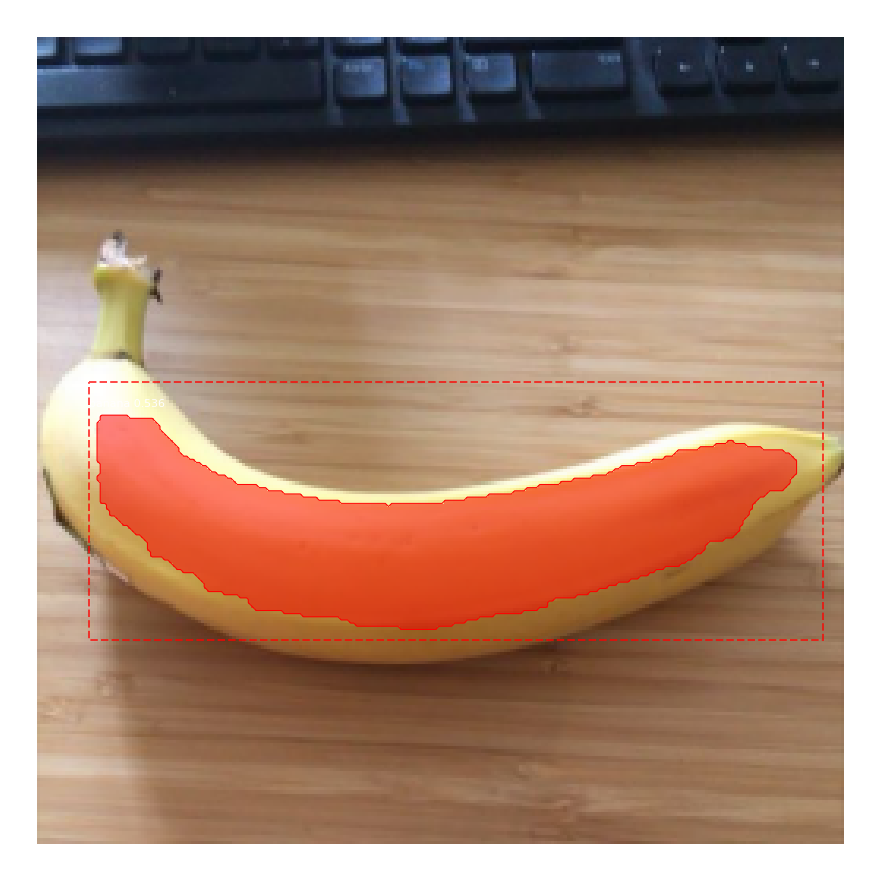

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


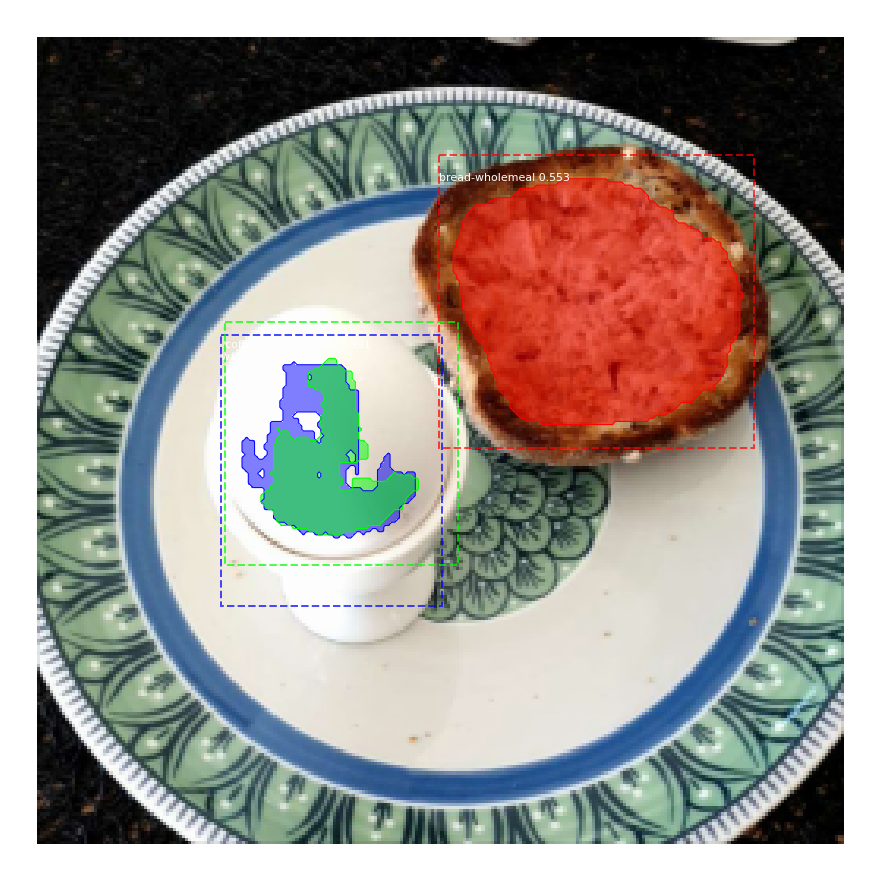

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 56/65
69/70 [============================>.] - ETA: 0s - loss: 1.0299 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2399 - mrcnn_class_loss: 0.1166 - mrcnn_bbox_loss: 0.1996 - mrcnn_mask_loss: 0.4652

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 83s 1s/step - loss: 1.0237 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2371 - mrcnn_class_loss: 0.1159 - mrcnn_bbox_loss: 0.1976 - mrcnn_mask_loss: 0.4647 - val_loss: 1.0739 - val_rpn_class_loss: 0.0083 - val_rpn_bbox_loss: 0.2657 - val_mrcnn_class_loss: 0.1155 - val_mrcnn_bbox_loss: 0.2282 - val_mrcnn_mask_loss: 0.4563
Uploading images to wandb...


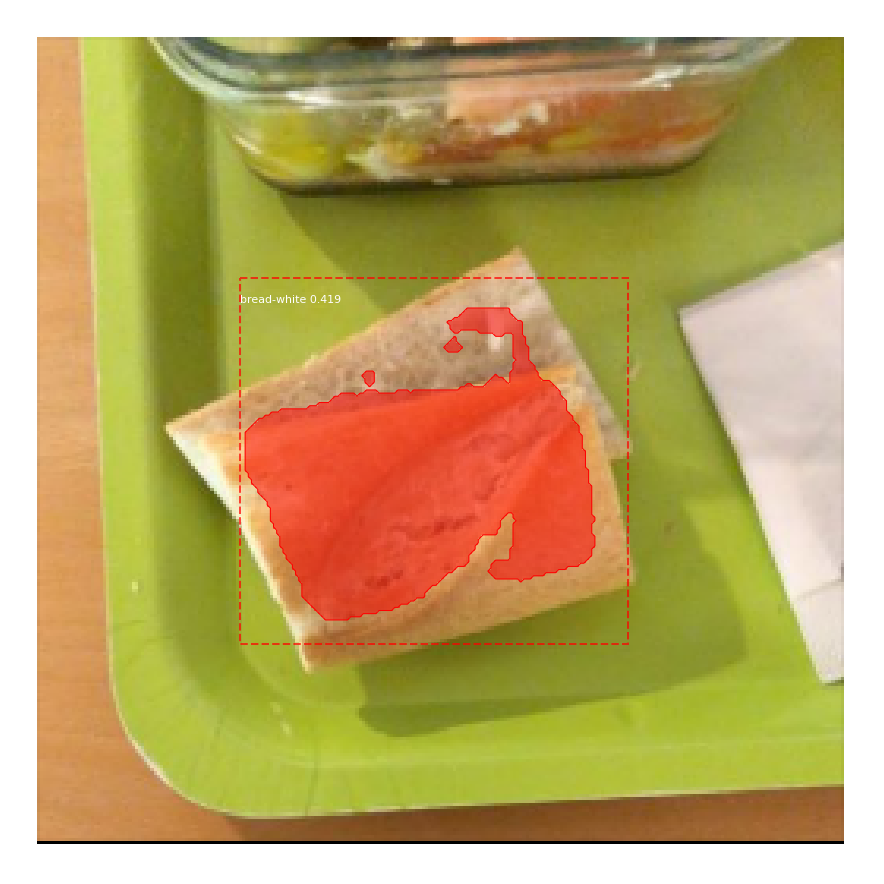

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


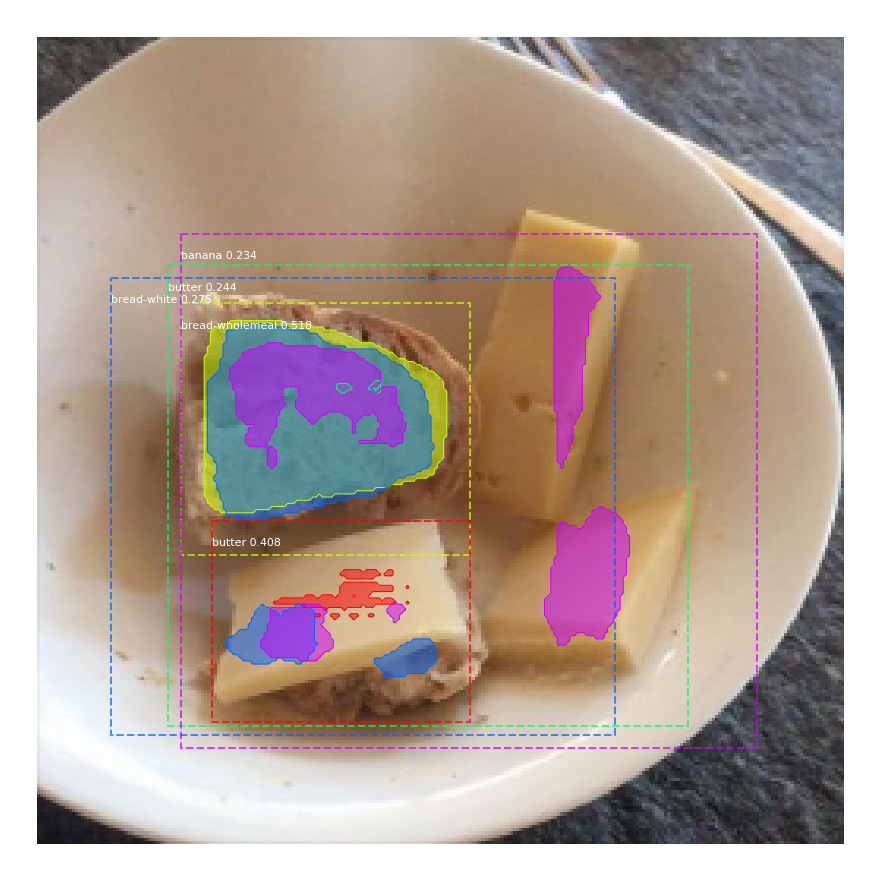

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


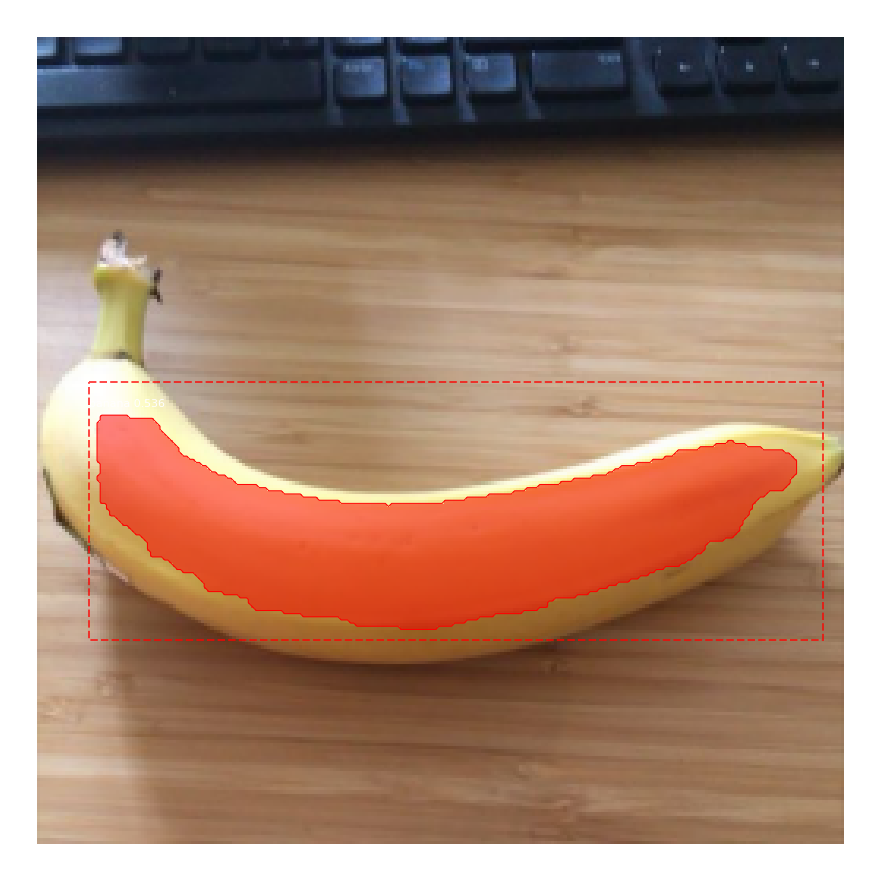

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


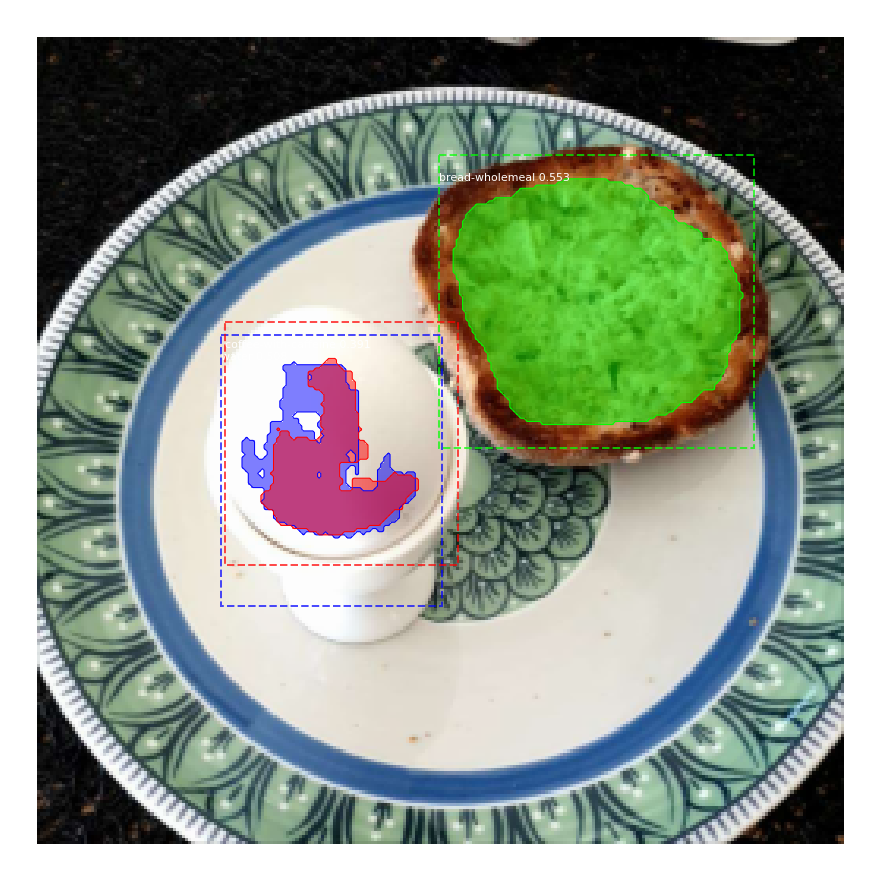

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 57/65
69/70 [============================>.] - ETA: 0s - loss: 1.0178 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1734 - mrcnn_class_loss: 0.1363 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.4727

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 83s 1s/step - loss: 1.0179 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1744 - mrcnn_class_loss: 0.1360 - mrcnn_bbox_loss: 0.2276 - mrcnn_mask_loss: 0.4728 - val_loss: 1.1357 - val_rpn_class_loss: 0.0106 - val_rpn_bbox_loss: 0.3092 - val_mrcnn_class_loss: 0.1292 - val_mrcnn_bbox_loss: 0.2486 - val_mrcnn_mask_loss: 0.4381
Uploading images to wandb...


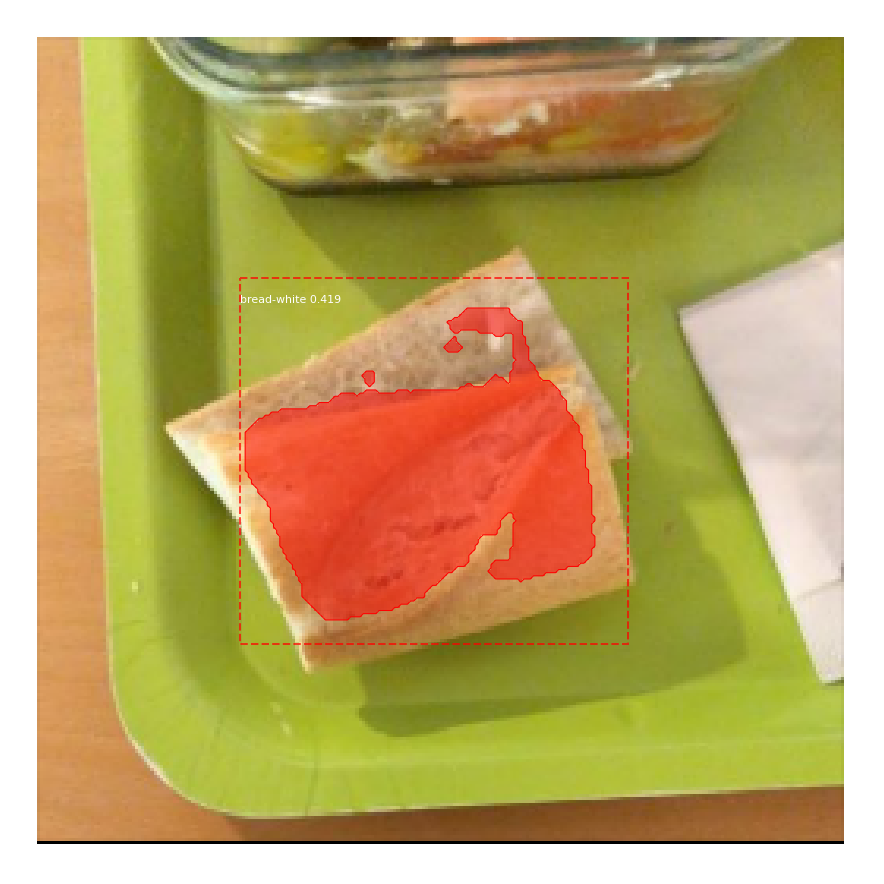

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


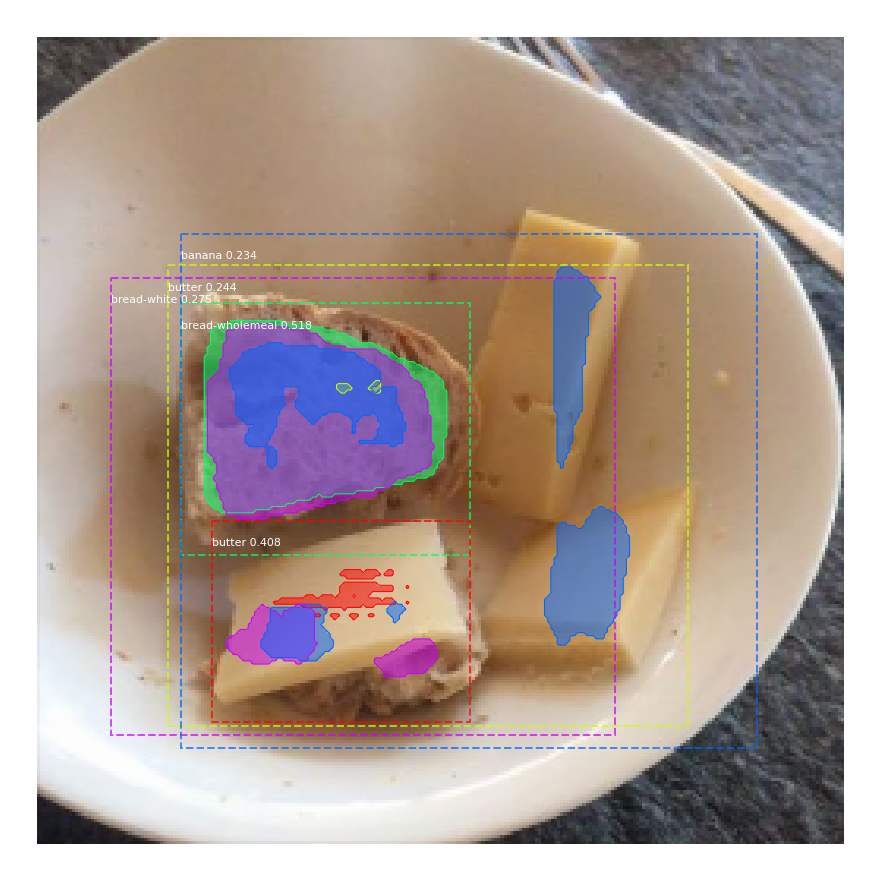

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


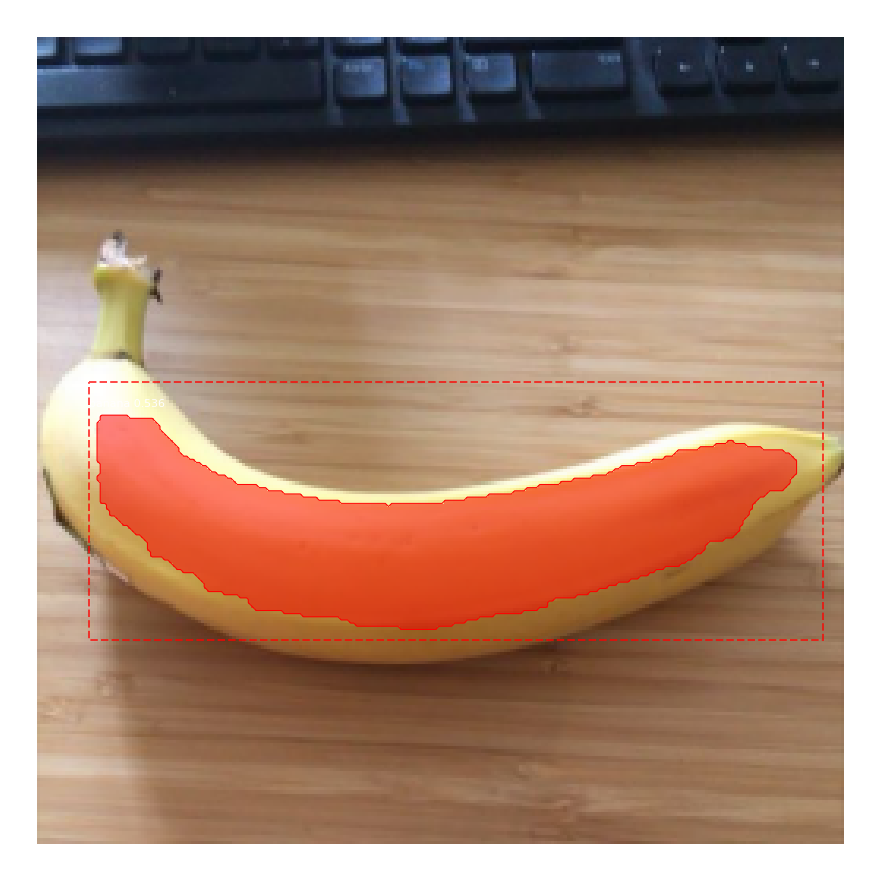

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


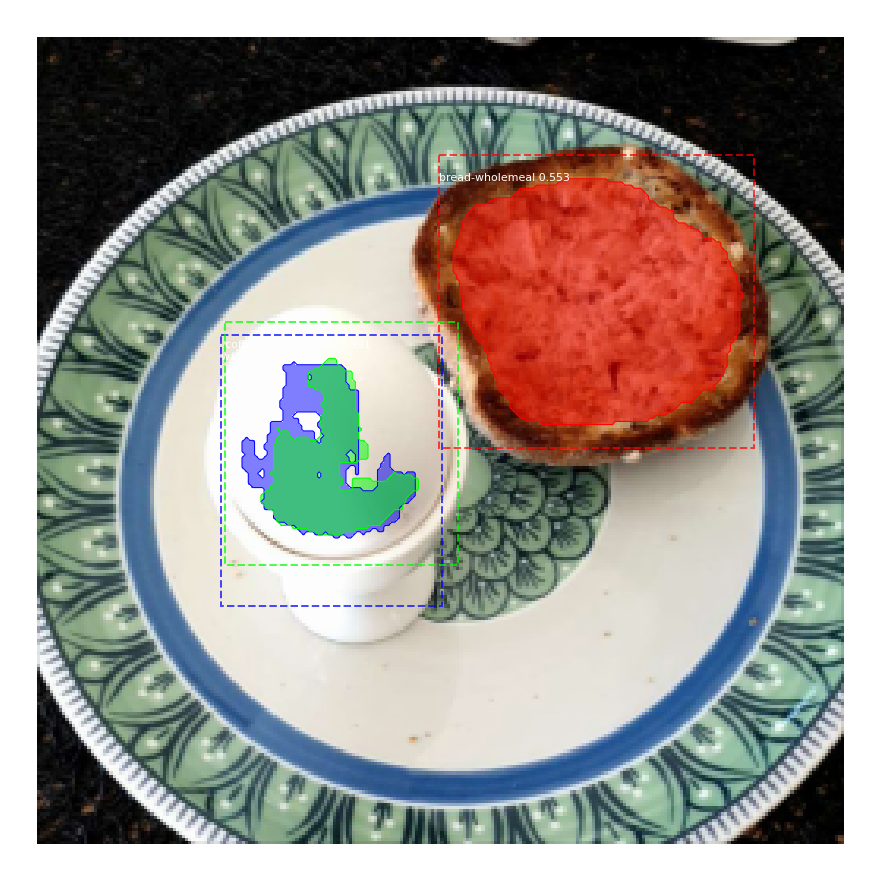

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 58/65
69/70 [============================>.] - ETA: 0s - loss: 1.0159 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.1834 - mrcnn_class_loss: 0.1487 - mrcnn_bbox_loss: 0.2248 - mrcnn_mask_loss: 0.4507

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 82s 1s/step - loss: 1.0204 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.1851 - mrcnn_class_loss: 0.1488 - mrcnn_bbox_loss: 0.2298 - mrcnn_mask_loss: 0.4483 - val_loss: 1.0524 - val_rpn_class_loss: 0.0096 - val_rpn_bbox_loss: 0.2583 - val_mrcnn_class_loss: 0.1224 - val_mrcnn_bbox_loss: 0.2170 - val_mrcnn_mask_loss: 0.4451
Uploading images to wandb...


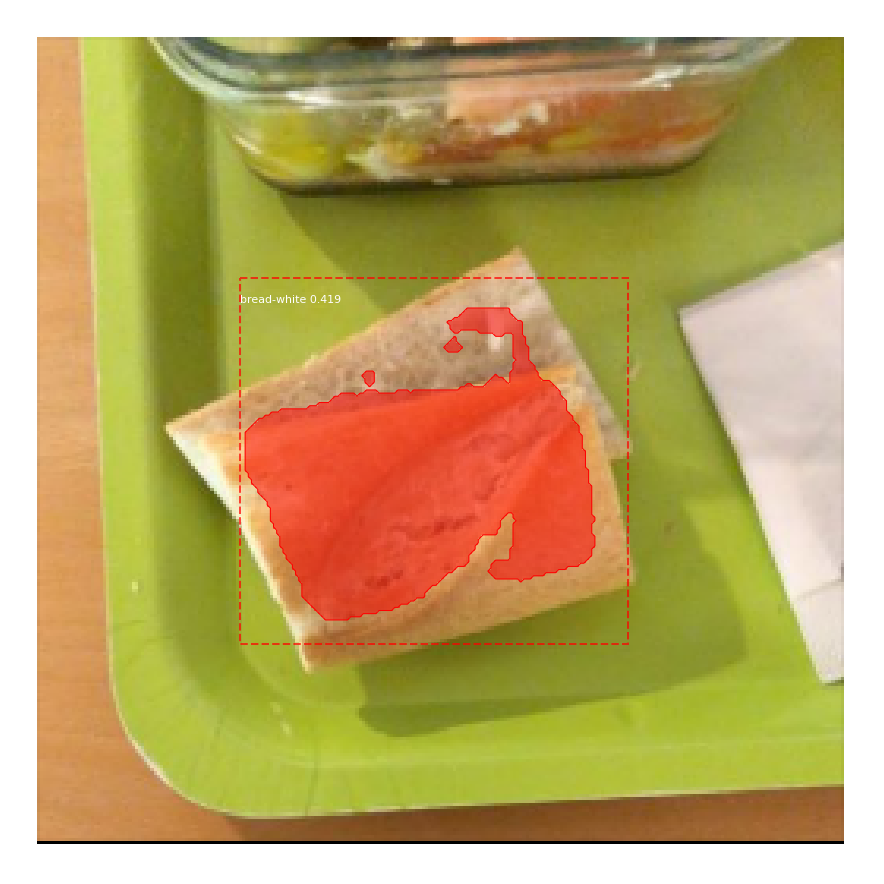

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


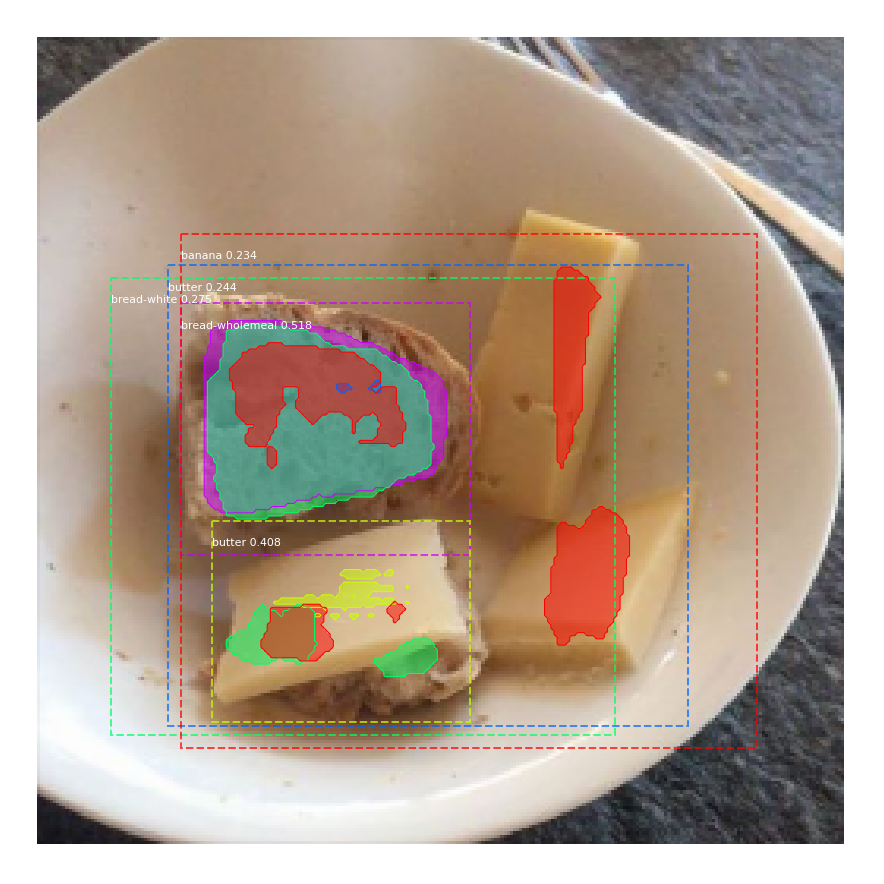

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


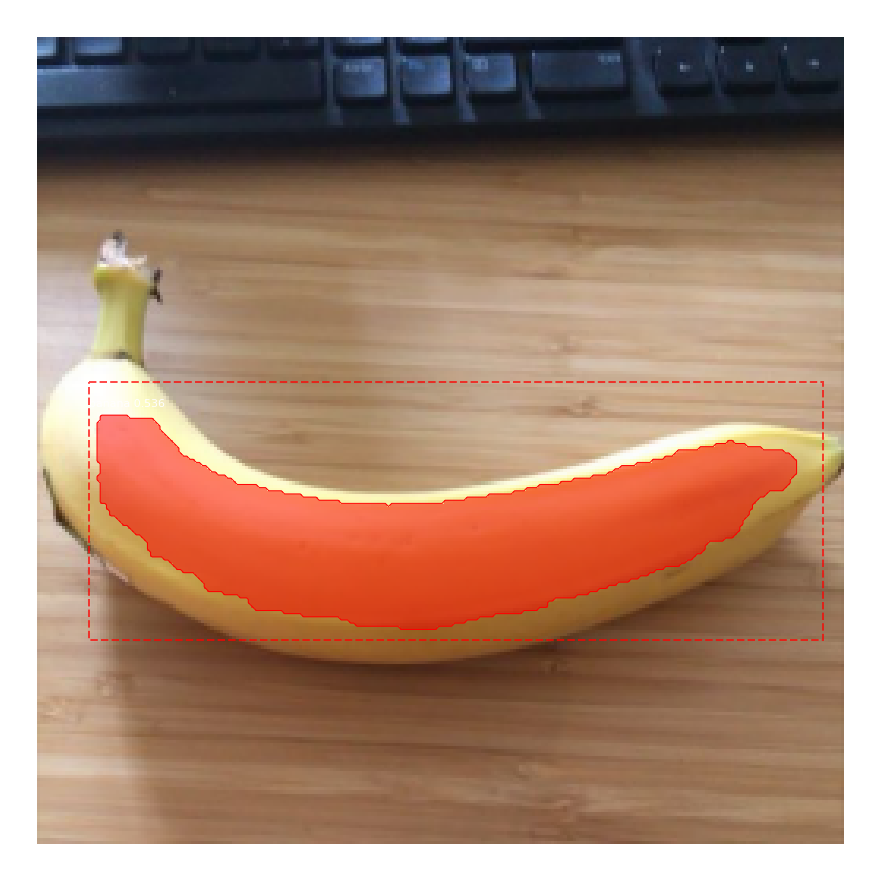

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


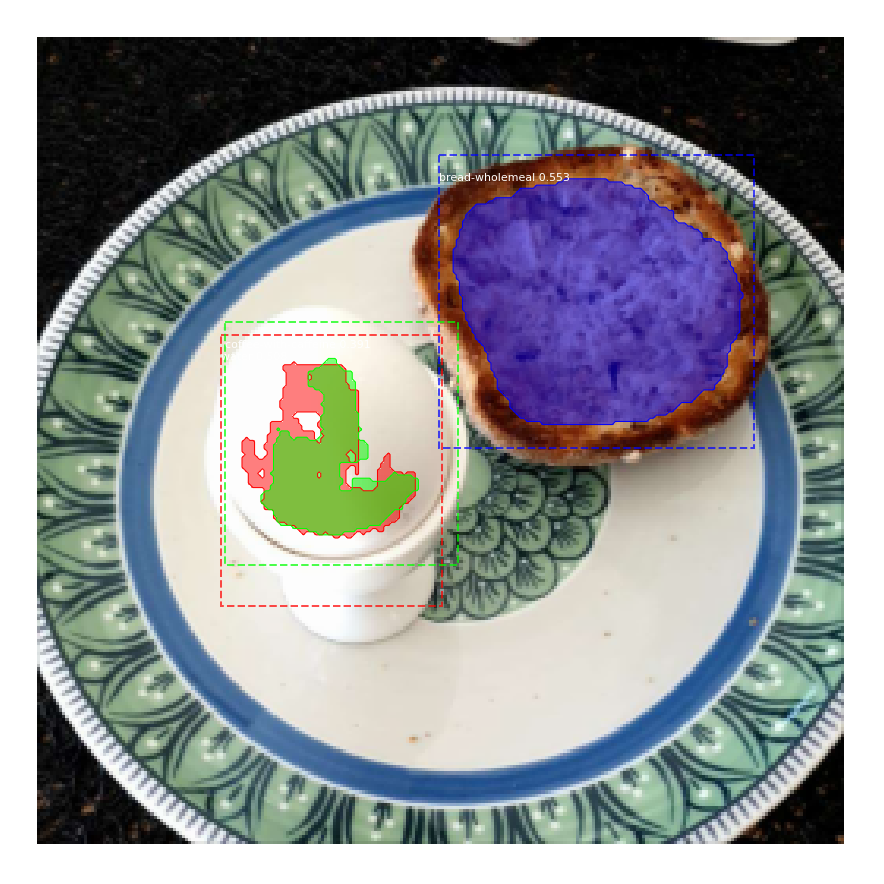

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 59/65
69/70 [============================>.] - ETA: 0s - loss: 0.9919 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.1881 - mrcnn_class_loss: 0.1369 - mrcnn_bbox_loss: 0.2137 - mrcnn_mask_loss: 0.4452

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 82s 1s/step - loss: 0.9904 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.1867 - mrcnn_class_loss: 0.1367 - mrcnn_bbox_loss: 0.2136 - mrcnn_mask_loss: 0.4453 - val_loss: 1.1203 - val_rpn_class_loss: 0.0103 - val_rpn_bbox_loss: 0.2676 - val_mrcnn_class_loss: 0.1429 - val_mrcnn_bbox_loss: 0.2594 - val_mrcnn_mask_loss: 0.4401
Uploading images to wandb...


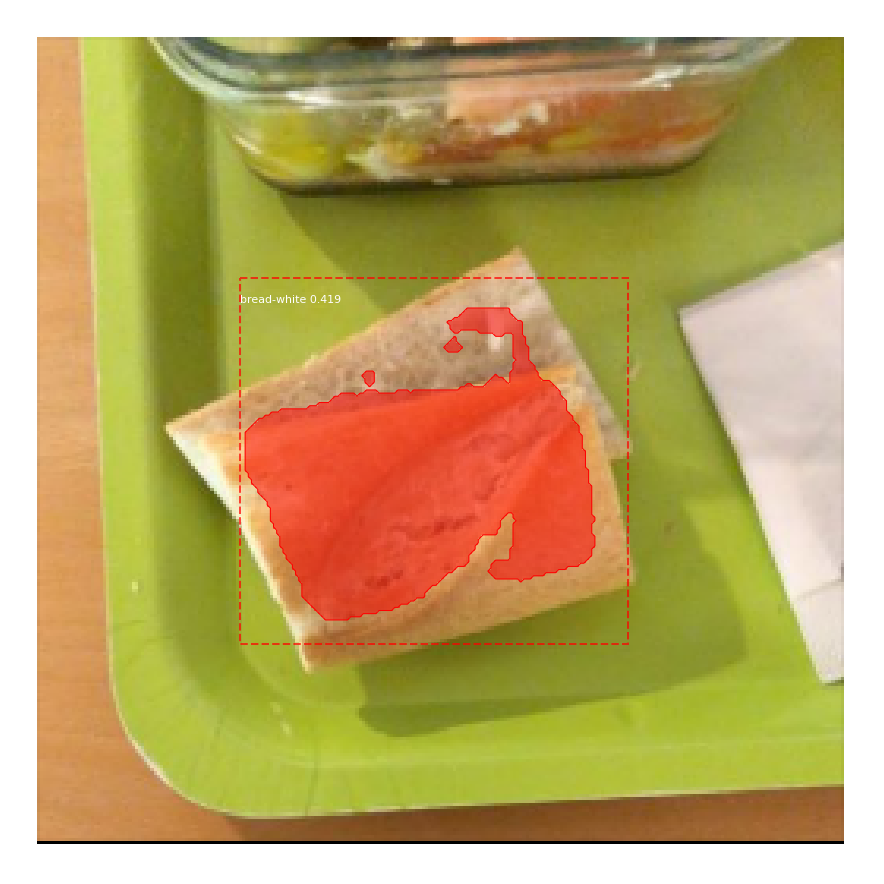

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


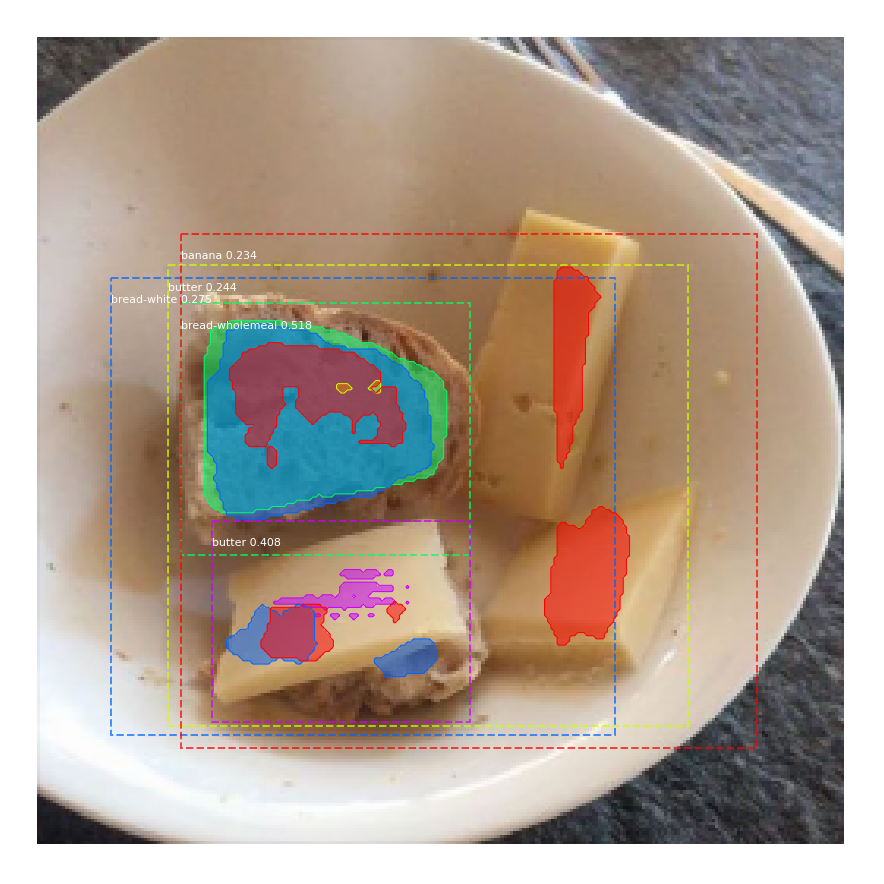

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


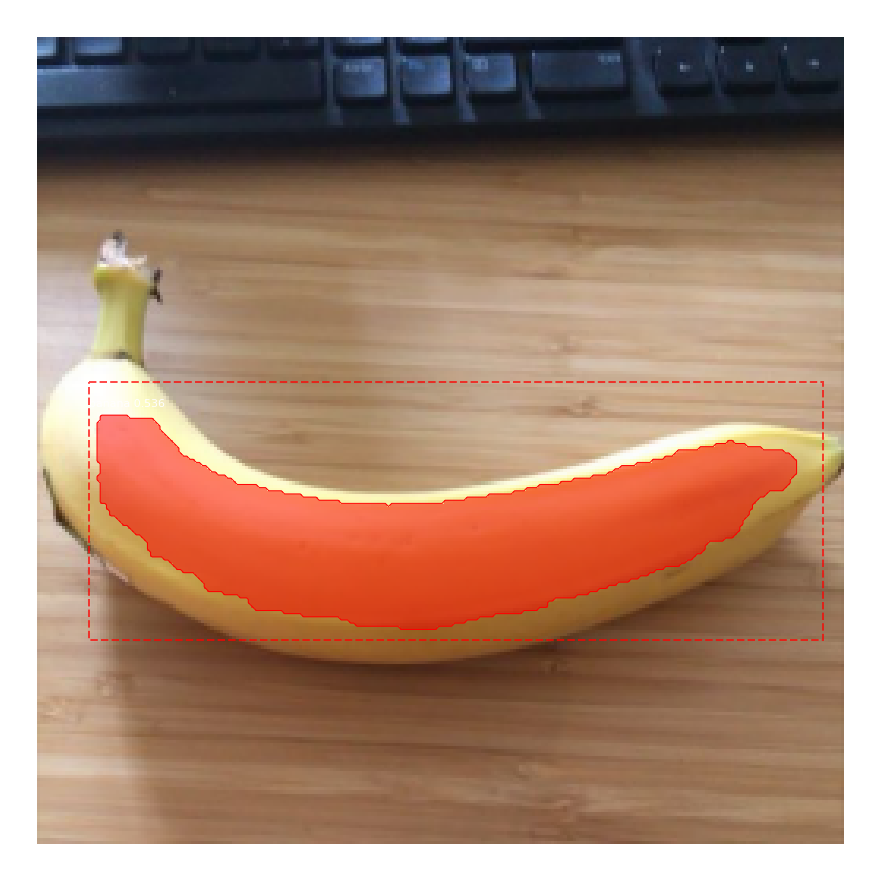

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


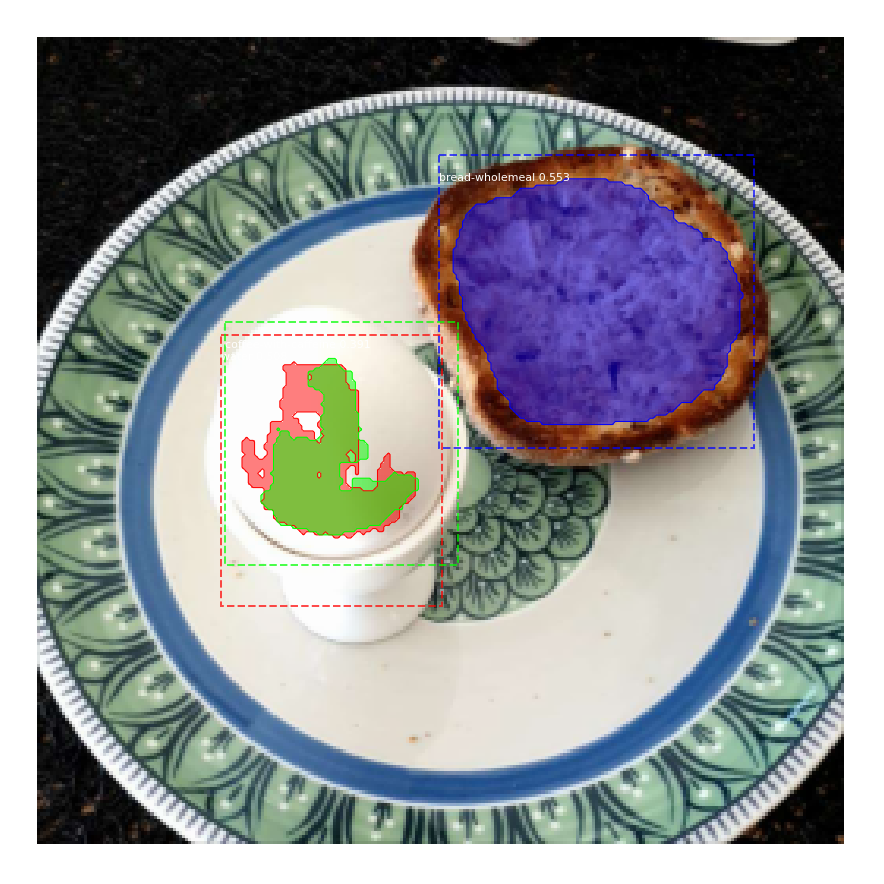

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 60/65
69/70 [============================>.] - ETA: 0s - loss: 1.0981 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2844 - mrcnn_class_loss: 0.1382 - mrcnn_bbox_loss: 0.2275 - mrcnn_mask_loss: 0.4396

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 83s 1s/step - loss: 1.0948 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2829 - mrcnn_class_loss: 0.1375 - mrcnn_bbox_loss: 0.2273 - mrcnn_mask_loss: 0.4389 - val_loss: 0.9916 - val_rpn_class_loss: 0.0063 - val_rpn_bbox_loss: 0.1872 - val_mrcnn_class_loss: 0.1238 - val_mrcnn_bbox_loss: 0.2162 - val_mrcnn_mask_loss: 0.4581
Uploading images to wandb...


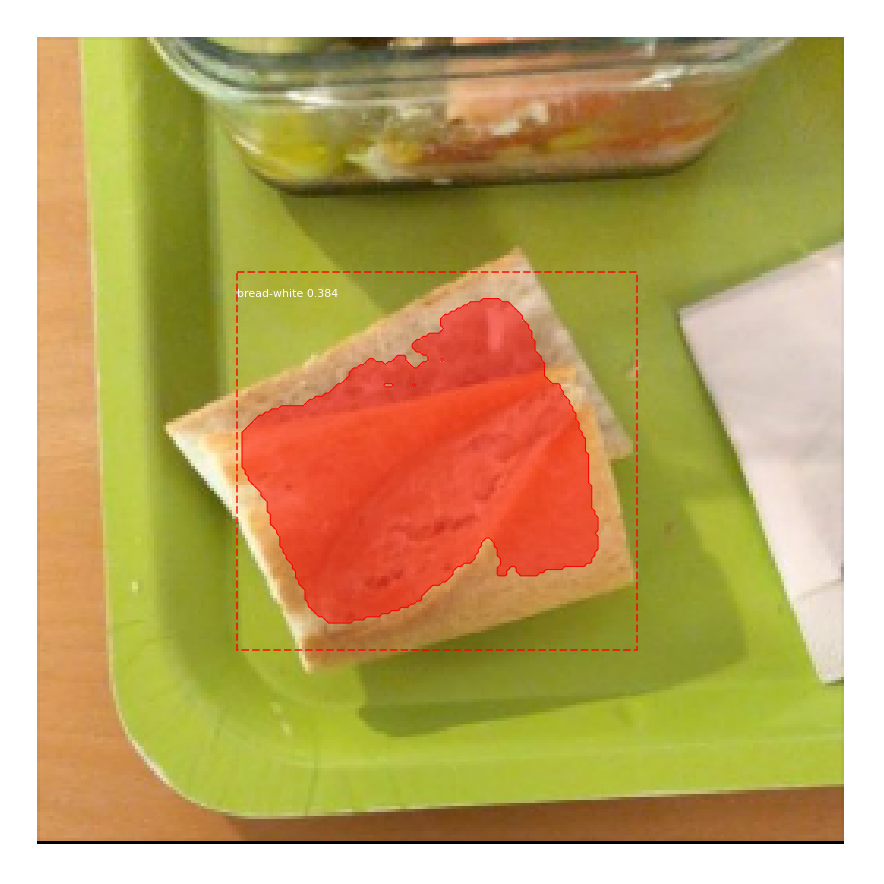

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


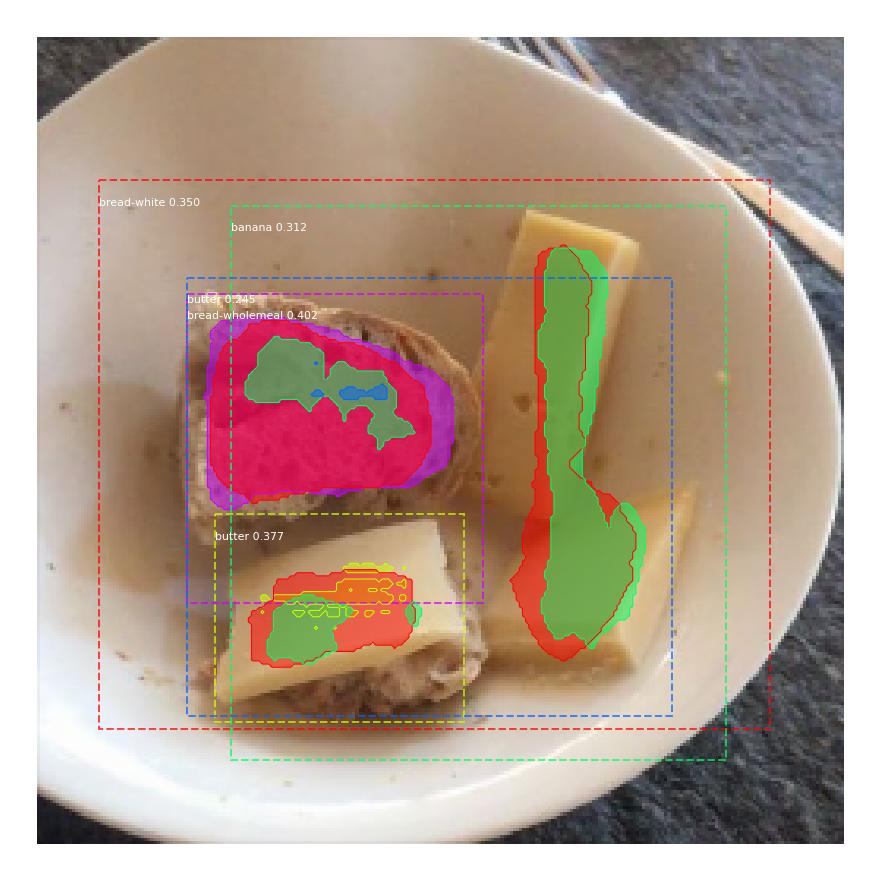

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


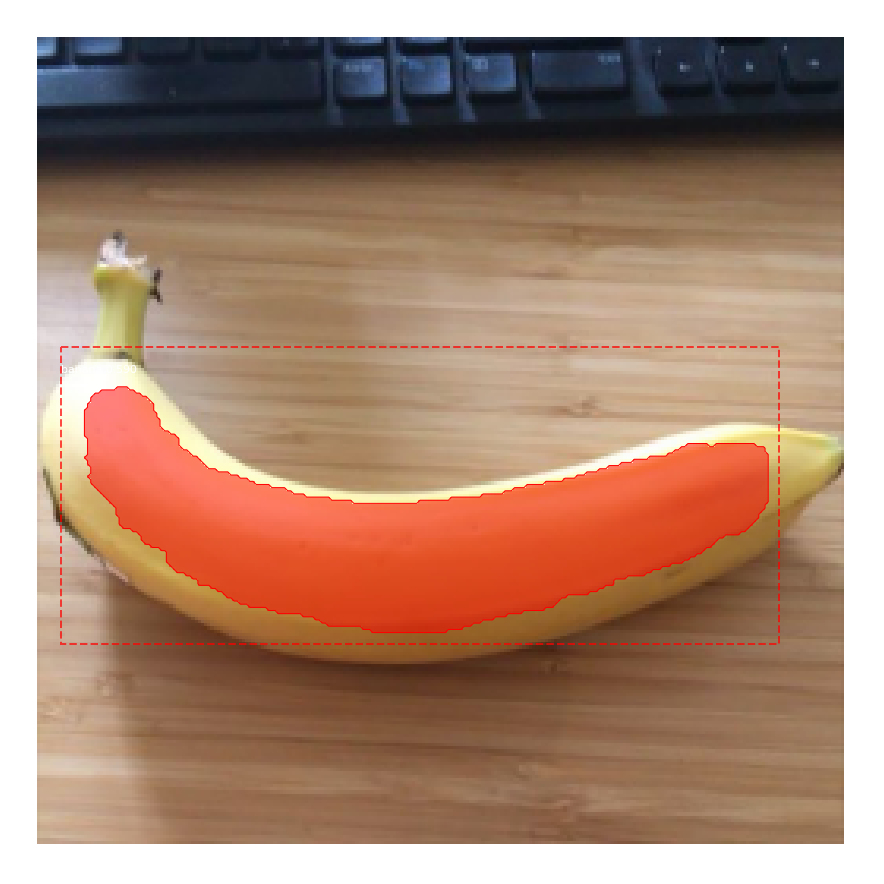

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


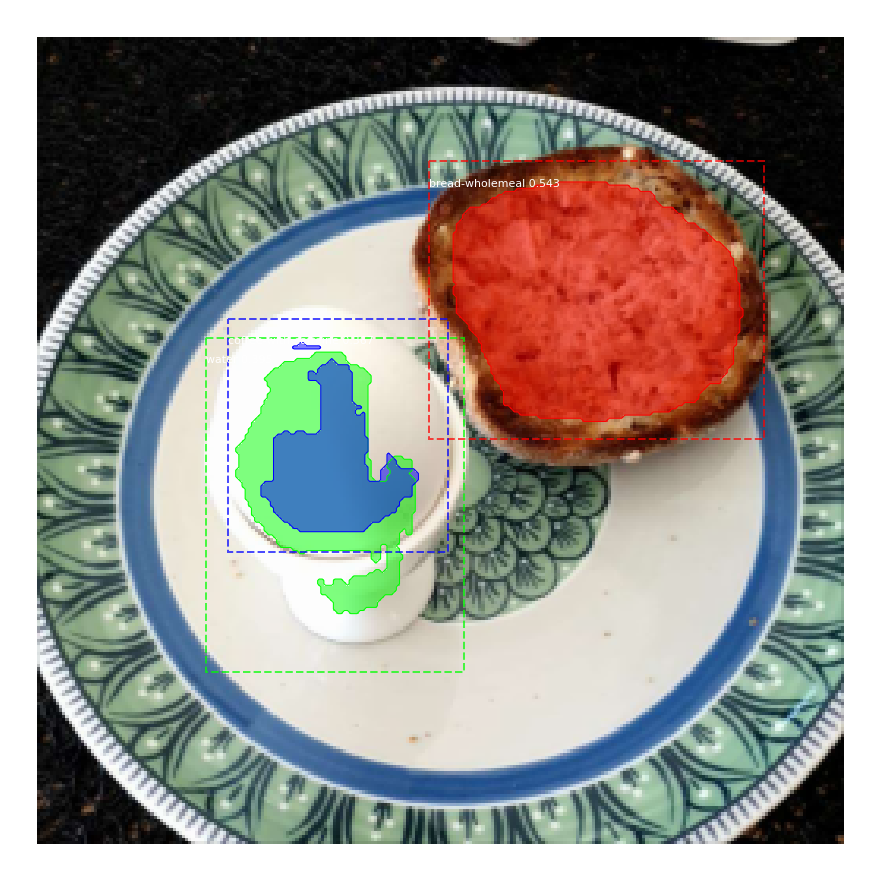

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 61/65
69/70 [============================>.] - ETA: 0s - loss: 1.0087 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.1983 - mrcnn_class_loss: 0.1304 - mrcnn_bbox_loss: 0.2159 - mrcnn_mask_loss: 0.4546

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 83s 1s/step - loss: 1.0121 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.1989 - mrcnn_class_loss: 0.1308 - mrcnn_bbox_loss: 0.2189 - mrcnn_mask_loss: 0.4543 - val_loss: 1.0657 - val_rpn_class_loss: 0.0101 - val_rpn_bbox_loss: 0.2678 - val_mrcnn_class_loss: 0.1350 - val_mrcnn_bbox_loss: 0.2076 - val_mrcnn_mask_loss: 0.4452
Uploading images to wandb...


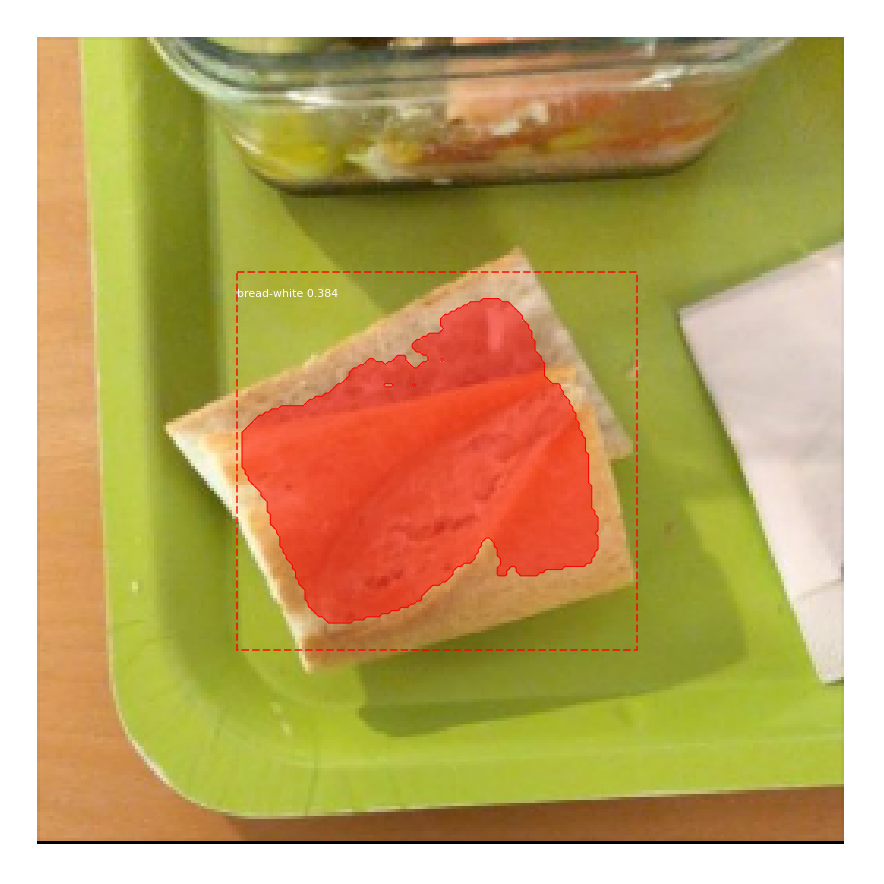

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


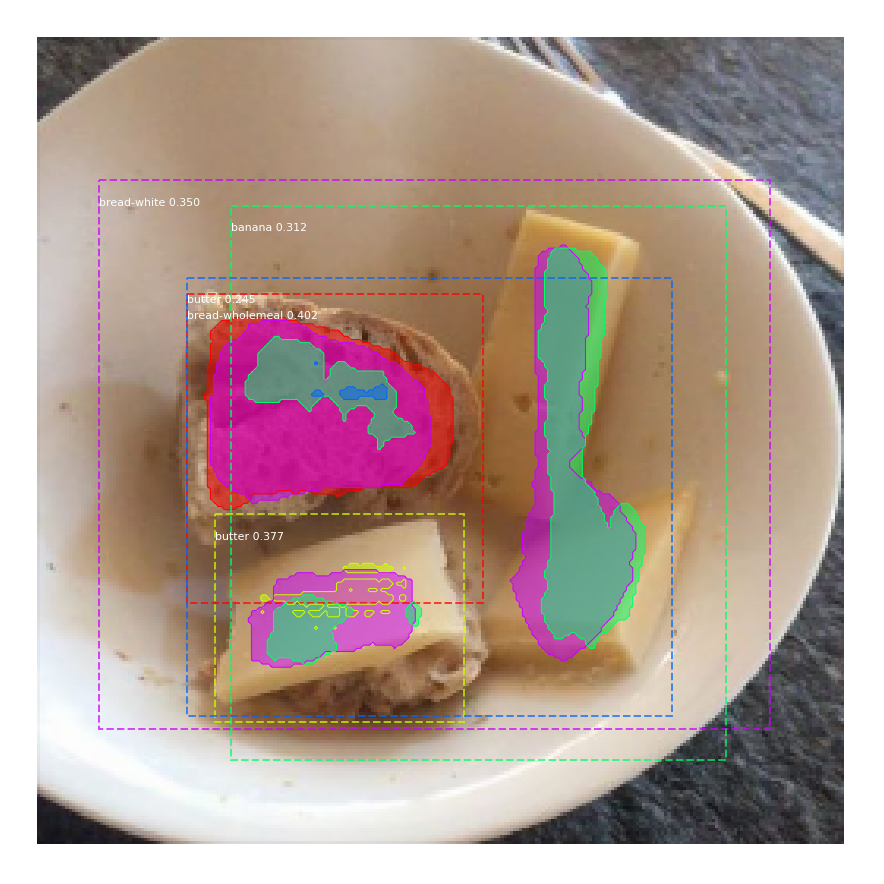

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


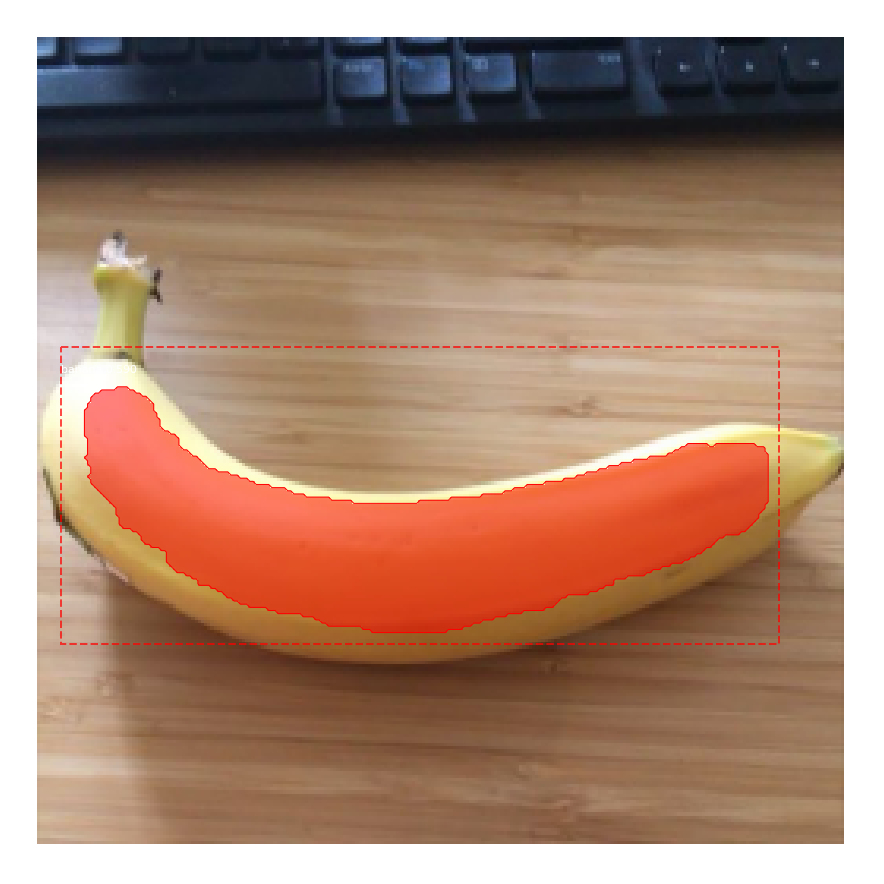

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


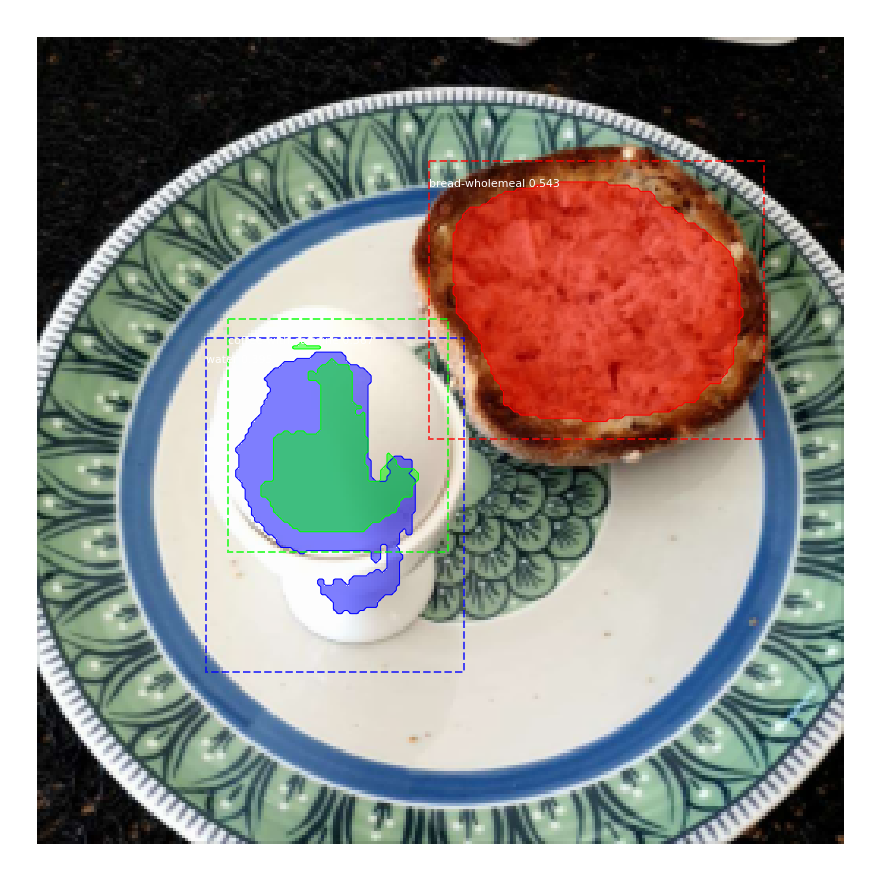

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 62/65
69/70 [============================>.] - ETA: 0s - loss: 0.9965 - rpn_class_loss: 0.0098 - rpn_bbox_loss: 0.1923 - mrcnn_class_loss: 0.1251 - mrcnn_bbox_loss: 0.2134 - mrcnn_mask_loss: 0.4559

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 82s 1s/step - loss: 0.9947 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.1917 - mrcnn_class_loss: 0.1249 - mrcnn_bbox_loss: 0.2128 - mrcnn_mask_loss: 0.4555 - val_loss: 1.0742 - val_rpn_class_loss: 0.0091 - val_rpn_bbox_loss: 0.2832 - val_mrcnn_class_loss: 0.1322 - val_mrcnn_bbox_loss: 0.1970 - val_mrcnn_mask_loss: 0.4527
Uploading images to wandb...


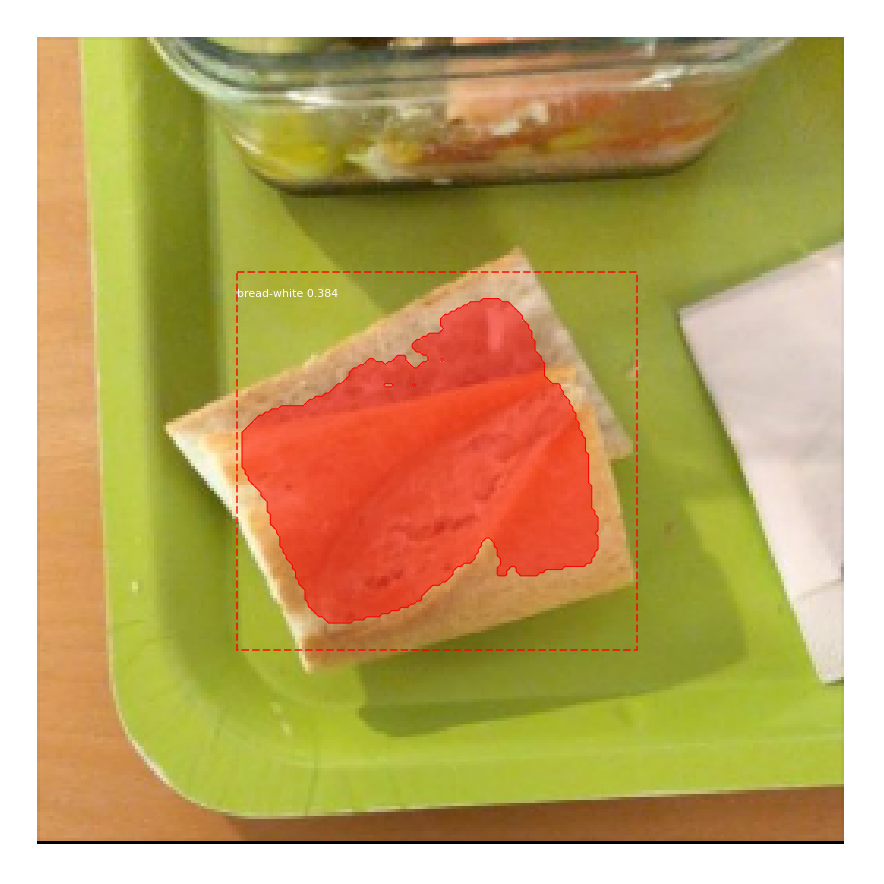

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


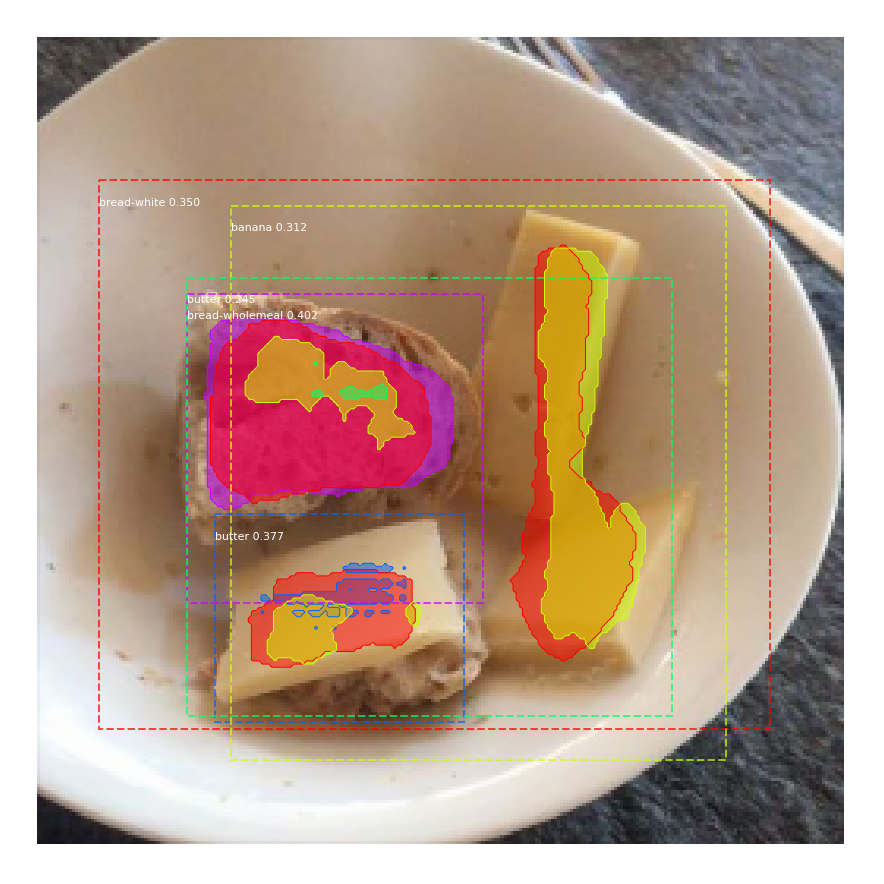

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


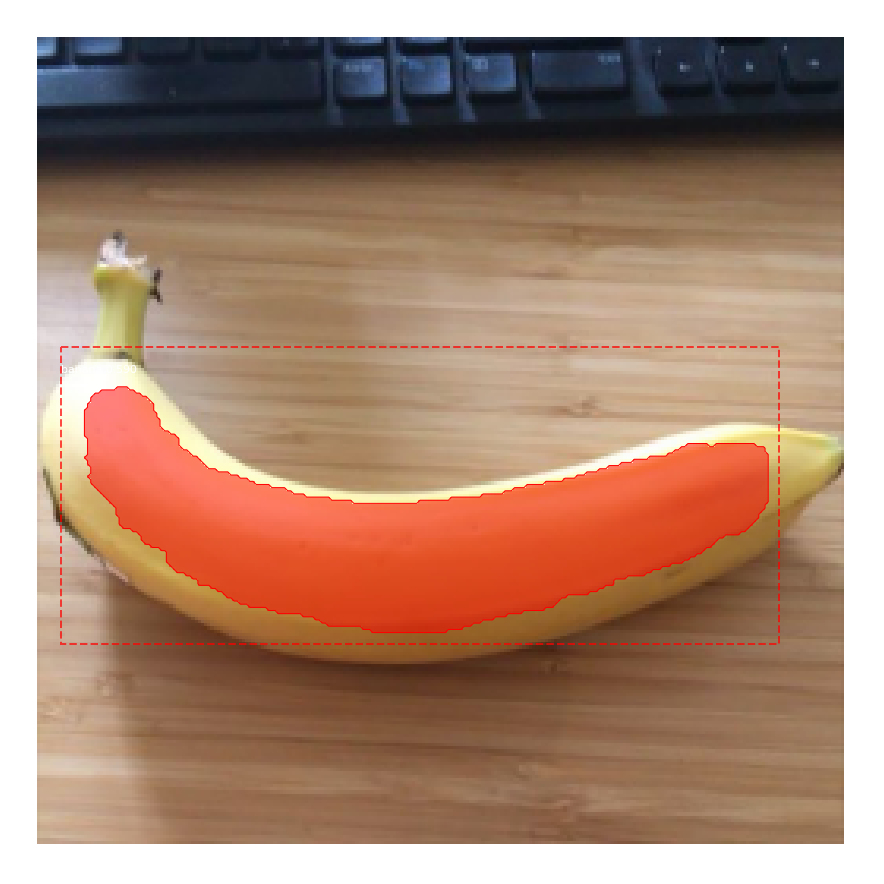

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


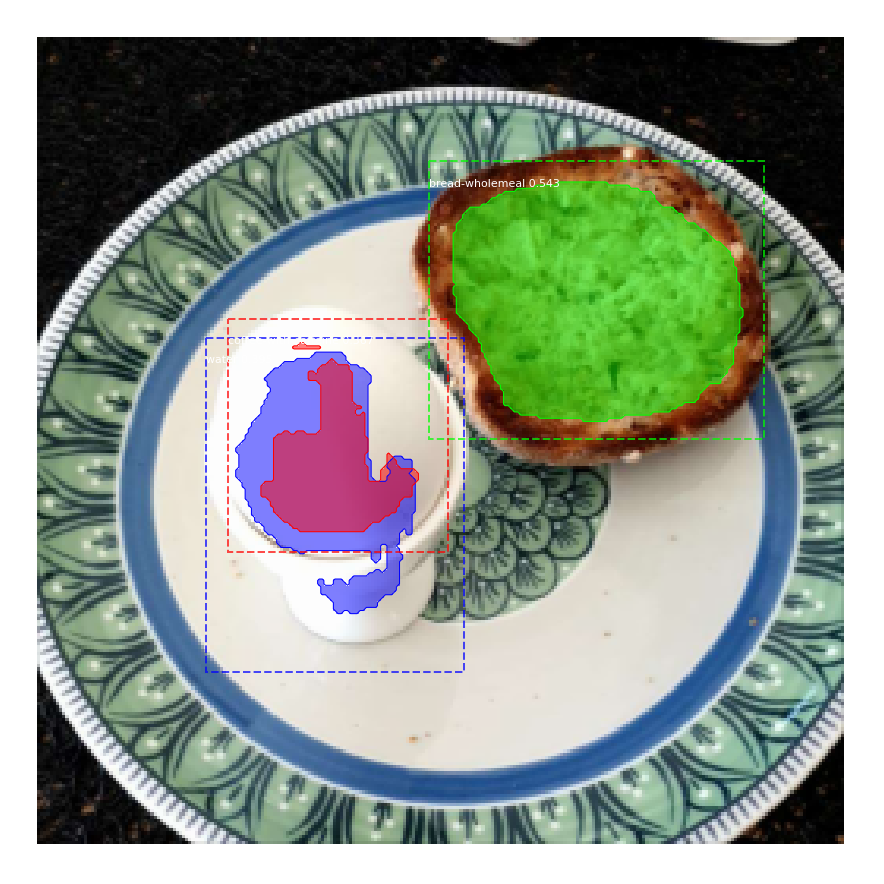

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 63/65
69/70 [============================>.] - ETA: 0s - loss: 1.0505 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2093 - mrcnn_class_loss: 0.1515 - mrcnn_bbox_loss: 0.2267 - mrcnn_mask_loss: 0.4539

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 84s 1s/step - loss: 1.0455 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2069 - mrcnn_class_loss: 0.1501 - mrcnn_bbox_loss: 0.2241 - mrcnn_mask_loss: 0.4553 - val_loss: 1.0770 - val_rpn_class_loss: 0.0088 - val_rpn_bbox_loss: 0.2457 - val_mrcnn_class_loss: 0.1372 - val_mrcnn_bbox_loss: 0.2326 - val_mrcnn_mask_loss: 0.4527
Uploading images to wandb...


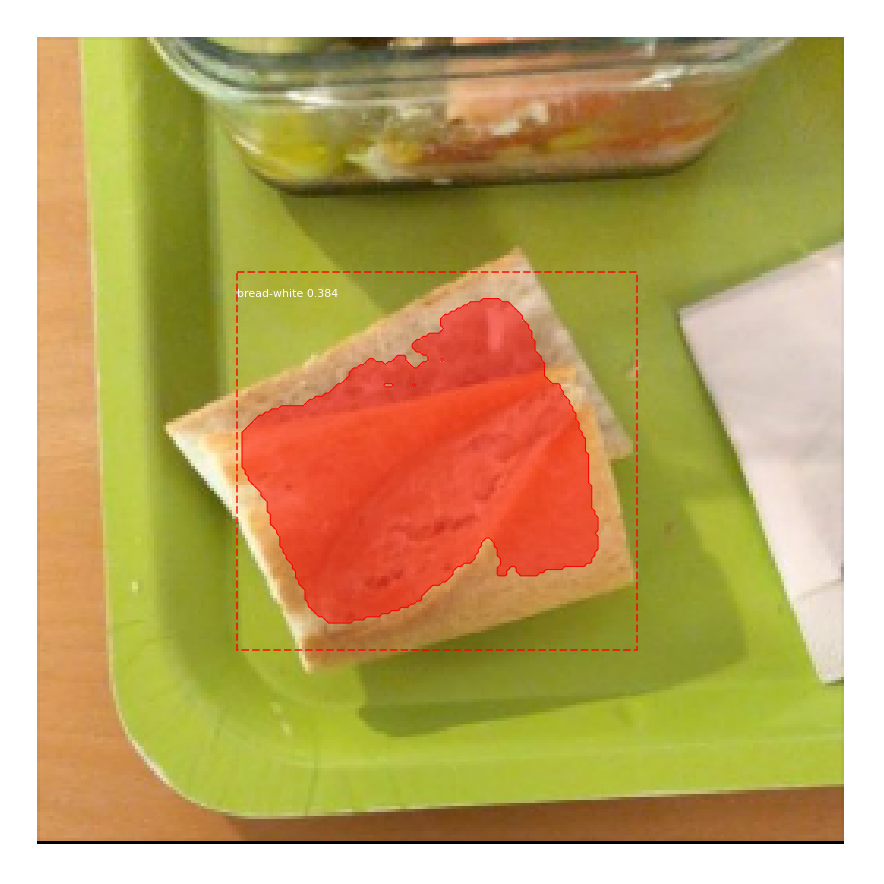

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


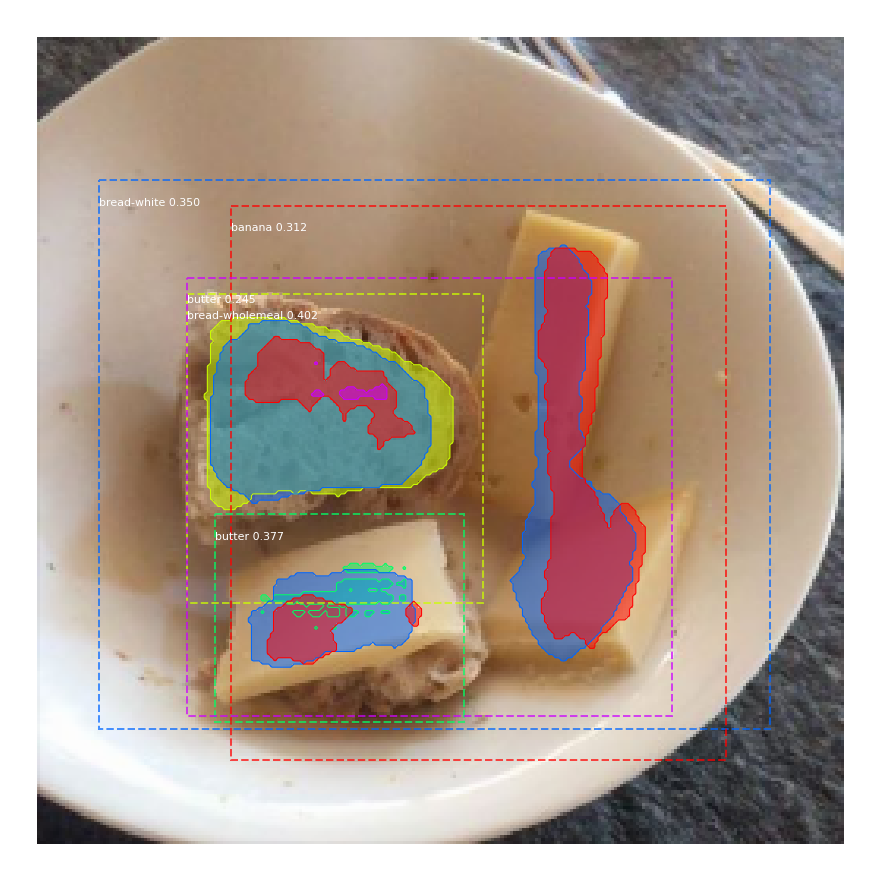

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


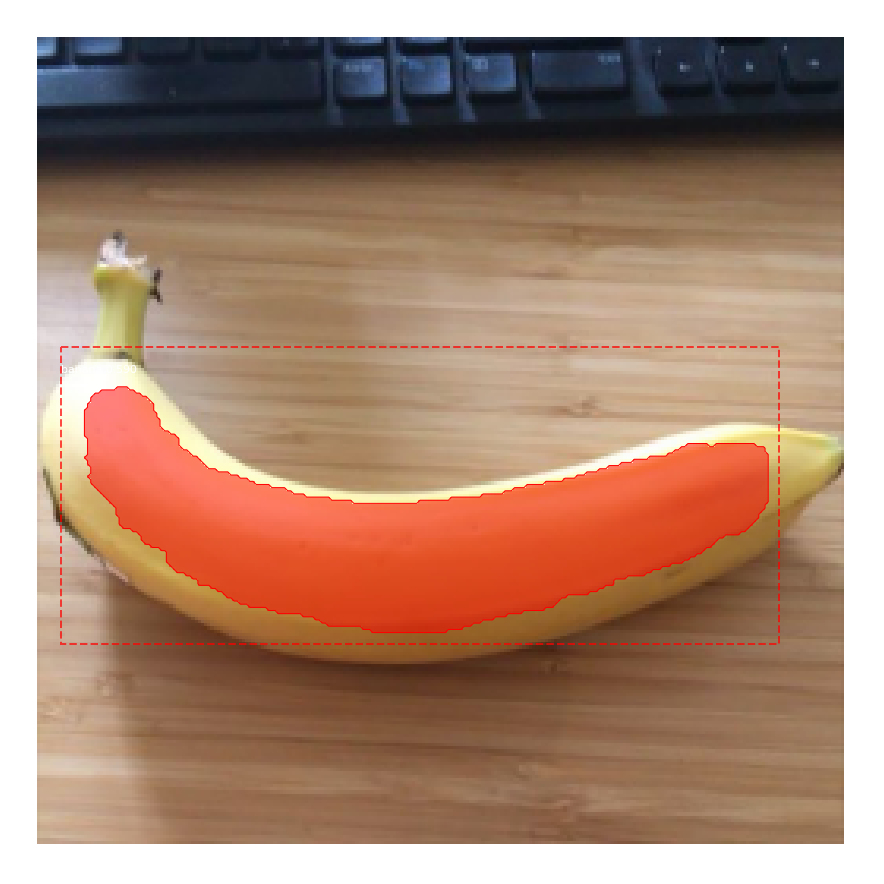

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


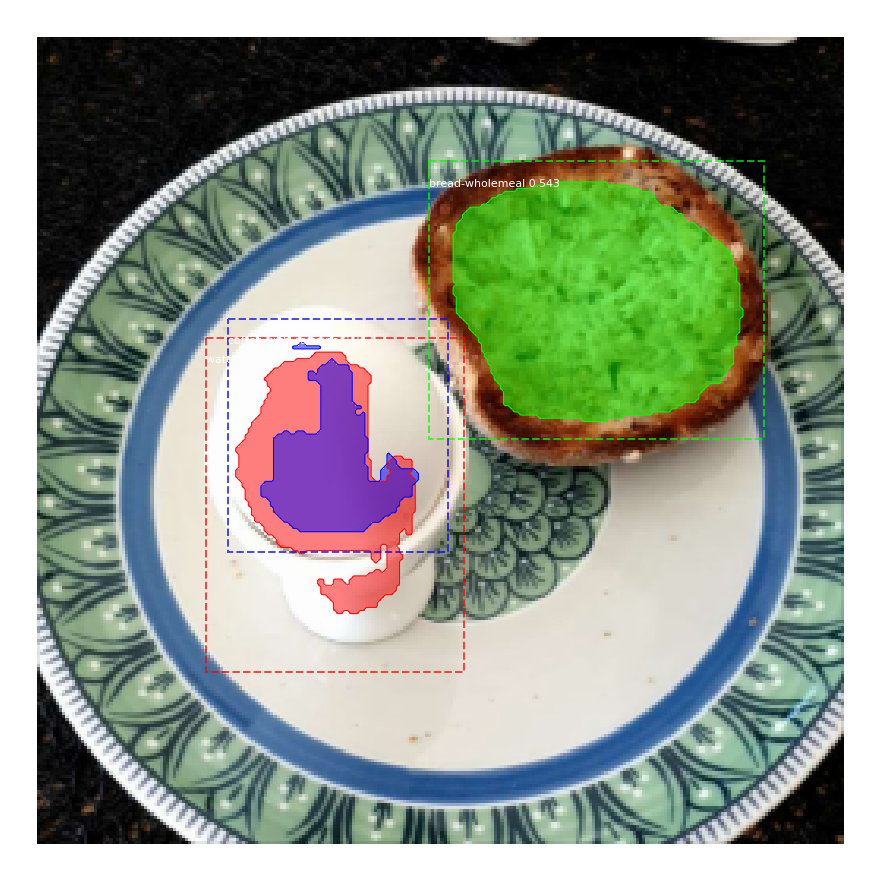

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 64/65
69/70 [============================>.] - ETA: 0s - loss: 1.0384 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2555 - mrcnn_class_loss: 0.1342 - mrcnn_bbox_loss: 0.2048 - mrcnn_mask_loss: 0.4355

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 82s 1s/step - loss: 1.0427 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2558 - mrcnn_class_loss: 0.1370 - mrcnn_bbox_loss: 0.2060 - mrcnn_mask_loss: 0.4356 - val_loss: 0.9881 - val_rpn_class_loss: 0.0083 - val_rpn_bbox_loss: 0.1768 - val_mrcnn_class_loss: 0.1327 - val_mrcnn_bbox_loss: 0.2202 - val_mrcnn_mask_loss: 0.4501
Uploading images to wandb...


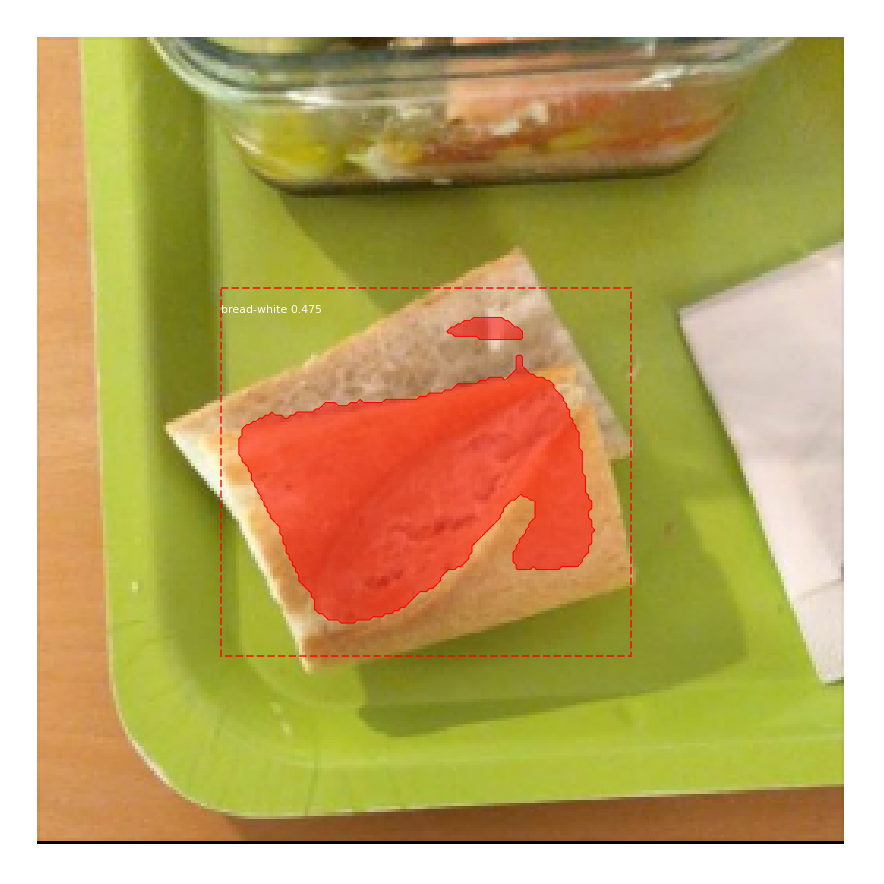

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


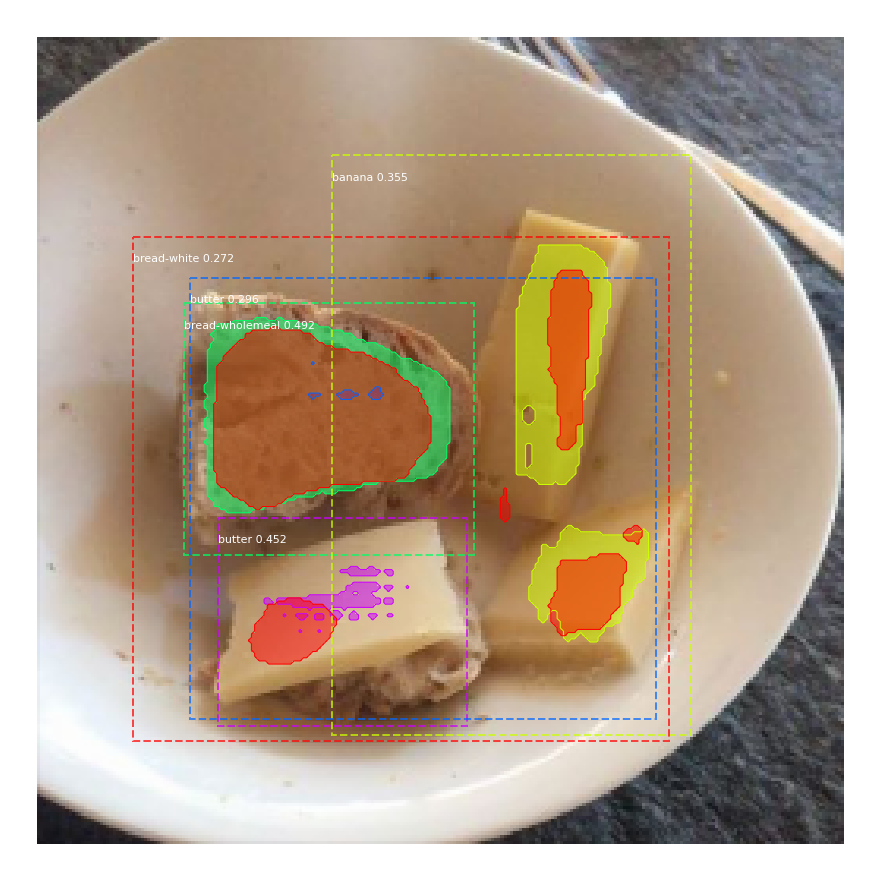

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


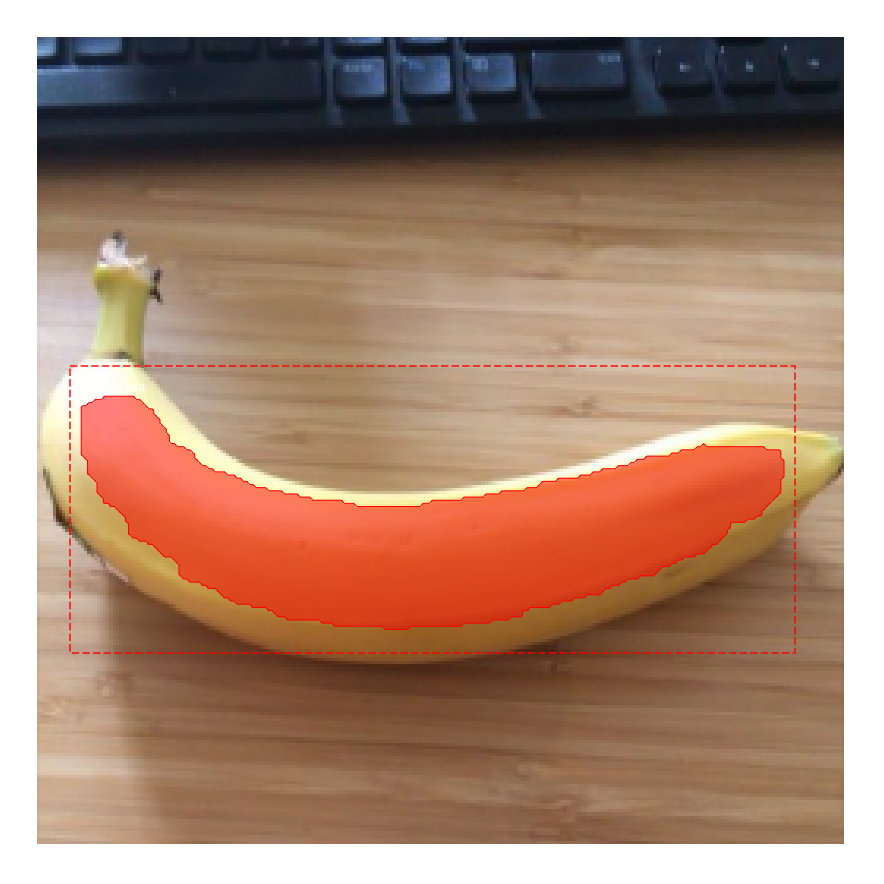

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


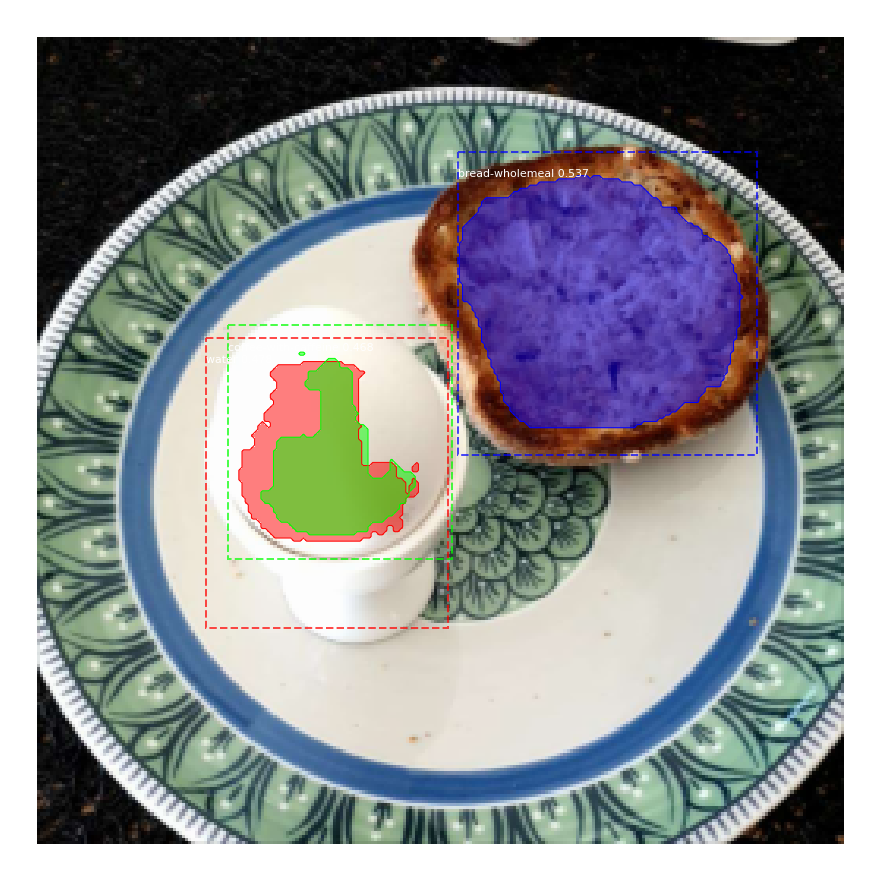

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...
Epoch 65/65
69/70 [============================>.] - ETA: 0s - loss: 1.0214 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.1788 - mrcnn_class_loss: 0.1446 - mrcnn_bbox_loss: 0.2281 - mrcnn_mask_loss: 0.4633

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


70/70 [==============================] - 83s 1s/step - loss: 1.0180 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.1776 - mrcnn_class_loss: 0.1435 - mrcnn_bbox_loss: 0.2275 - mrcnn_mask_loss: 0.4628 - val_loss: 1.1133 - val_rpn_class_loss: 0.0085 - val_rpn_bbox_loss: 0.3447 - val_mrcnn_class_loss: 0.1177 - val_mrcnn_bbox_loss: 0.1853 - val_mrcnn_mask_loss: 0.4571
Uploading images to wandb...


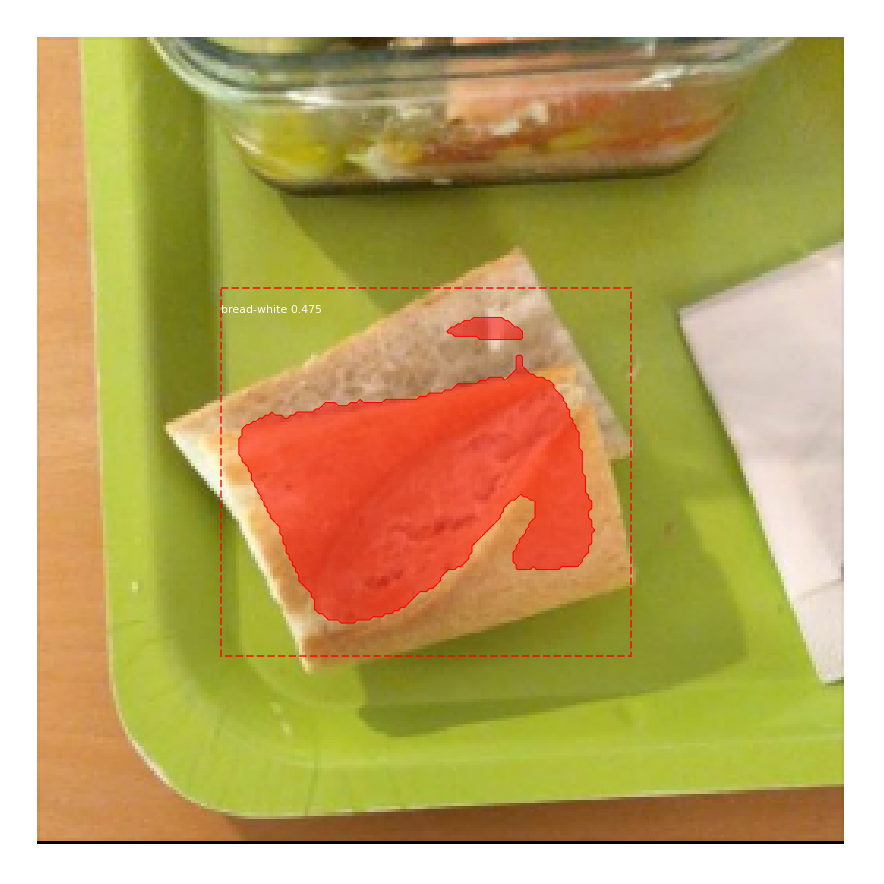

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


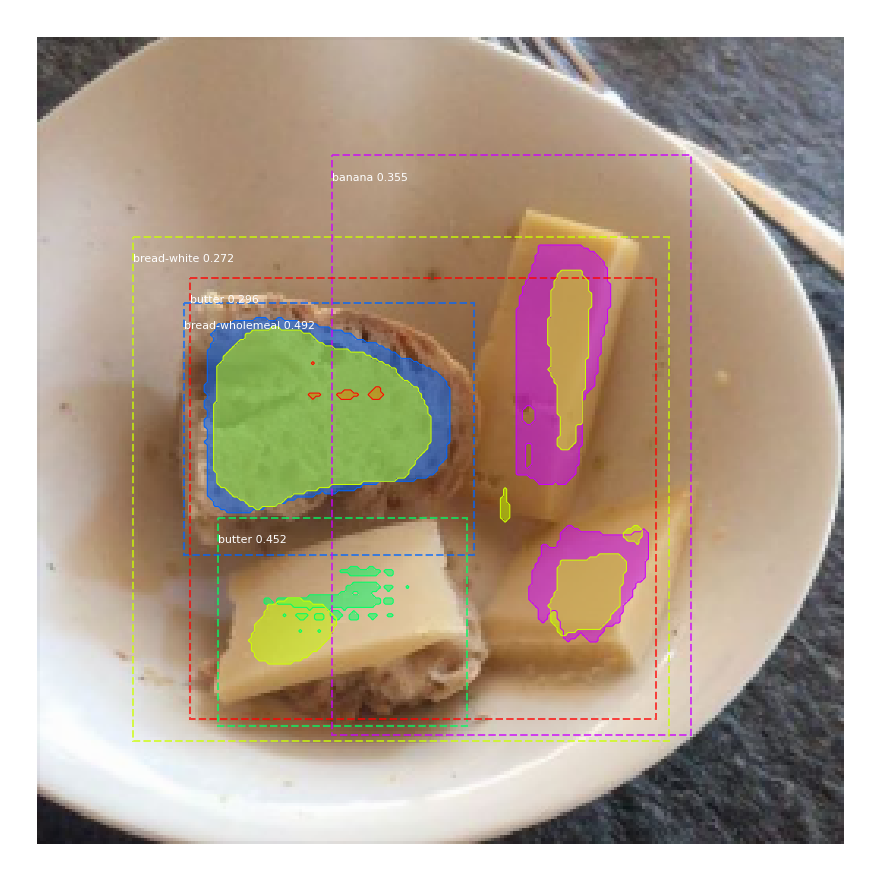

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


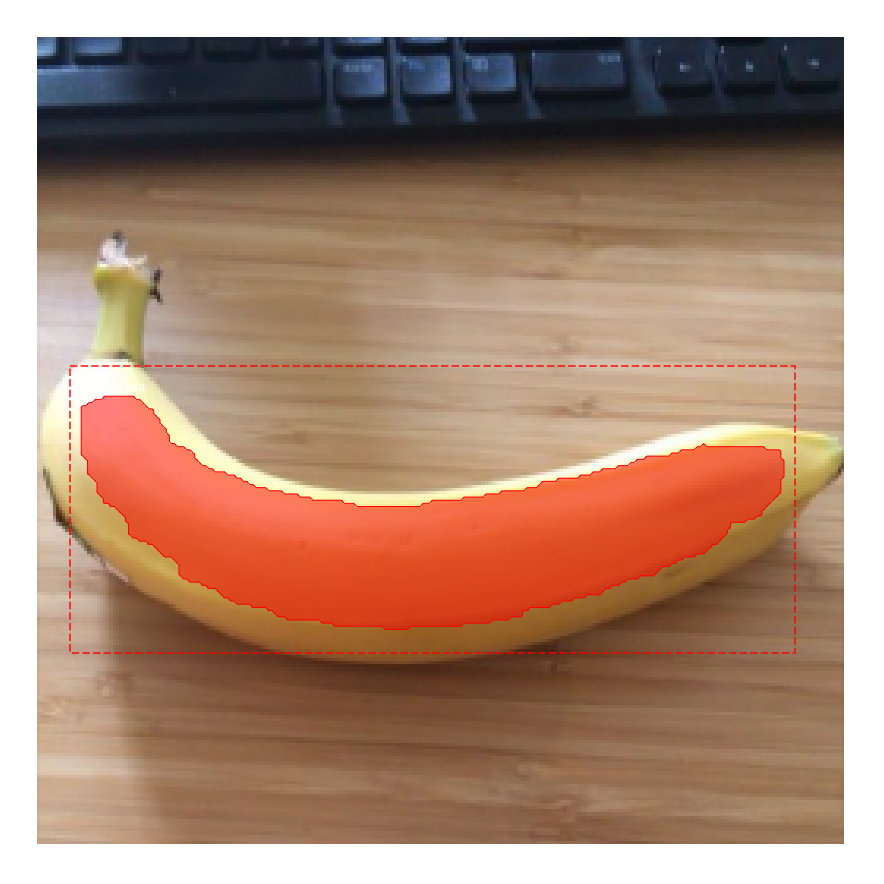

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


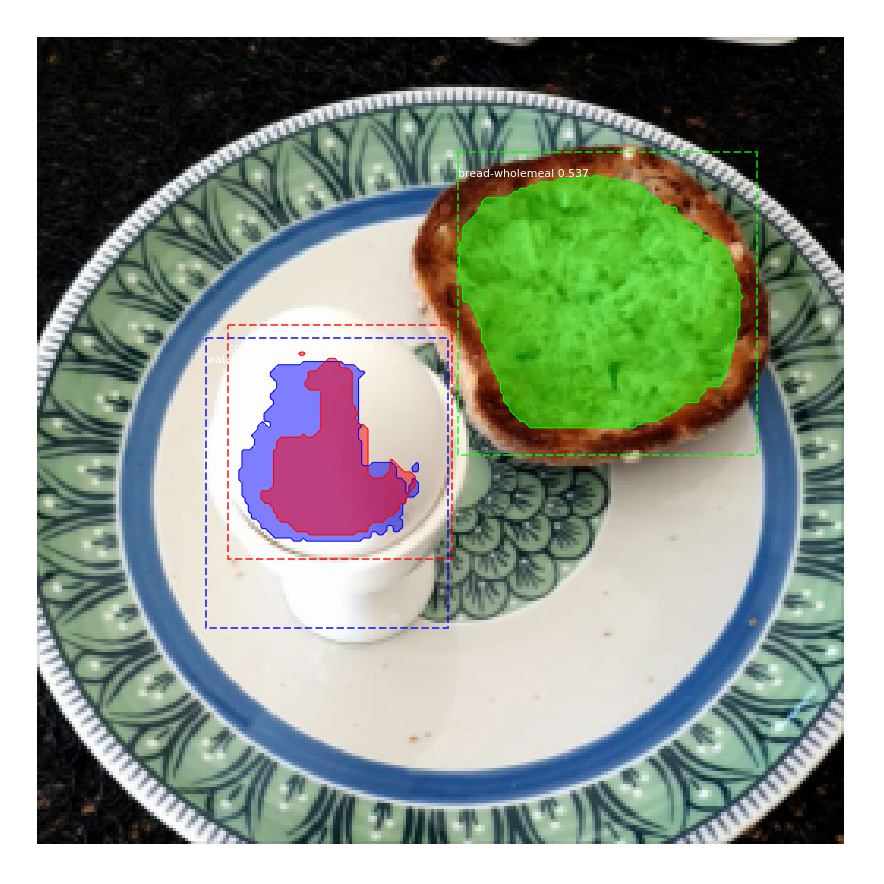

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:62: DeprecationWarning:     `imresize` is deprecated!
    `imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
    Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.


Uploading metrics to wandb...


In [ ]:

# Training - Stage 3
# Fine tune all layers
print("Fine tune all layers")

#_, checkpoint = model.find_last()
#model.load_weights(checkpoint, by_name=True)
#print("Loading weights from previous (first) stage")
model.train(dataset_train, dataset_val,
            learning_rate=config.LEARNING_RATE / 10,
            epochs=65,
            layers='all')

In [ ]:
run.finish()

BACKBONE,resnet50
GRADIENT_CLIP_NORM,5.0
LEARNING_MOMENTUM,0.9
LEARNING_RATE,0.001
STEPS_PER_EPOCH,70
WEIGHT_DECAY,0.0001


GRADIENT_CLIP_NORM,▁
LEARNING_MOMENTUM,▁
LEARNING_RATE,▁
STEPS_PER_EPOCH,▁
WEIGHT_DECAY,▁


##Step 7: Run Validation
The code saves only the best model it has seen so far. We use this to run evaluation on the val set (both small and original).

In [ ]:
class InferenceConfig(FoodConfig):
            # Set batch size to 1 since we'll be running inference on
            # one image at a time. Batch size = GPU_COUNT * IMAGES_PER_GPU
            GPU_COUNT = 1
            IMAGES_PER_GPU = 1
            DETECTION_MIN_CONFIDENCE = 0
            DETECTION_MAX_INSTANCES=20
config = InferenceConfig()
model = modellib.MaskRCNN(mode="inference", config=config,
                                  model_dir=DEFAULT_LOGS_DIR, callbacks=[])
model_path = model.find_last()[1]
# Load weights
print("Loading weights ", model_path)
model.load_weights(model_path, by_name=True)


Loading weights  /content/drive/MyDrive/datasets/logs1/food-challenge20210921T0935/mask_rcnn_food-challenge_0064.h5


In [ ]:
!pip install numpy==1.17.4

     |████████████████████████████████| 20.0 MB 1.4 MB/s 
  Attempting uninstall: numpy
    Found existing installation: numpy 1.17.0
    Uninstalling numpy-1.17.0:
      Successfully uninstalled numpy-1.17.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-probability 0.13.0 requires gast>=0.3.2, but you have gast 0.2.2 which is incompatible.
kapre 0.3.5 requires numpy>=1.18.5, but you have numpy 1.17.4 which is incompatible.
kapre 0.3.5 requires tensorflow>=2.0.0, but you have tensorflow 1.15.0 which is incompatible.
jaxlib 0.1.70+cuda111 requires numpy>=1.18, but you have numpy 1.17.4 which is incompatible.
jax 0.2.19 requires numpy>=1.18, but you have numpy 1.17.4 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgau

In [ ]:
import numpy as np
import time
print("Running COCO evaluation on val images.")
coco = dataset_val.load_dataset("/content/drive/MyDrive/datasets/validation",load_small=True, return_coco=True)
evaluate_coco(model, dataset_val, coco, "segm")

Running COCO evaluation on val images.
Annotation Path  /content/drive/MyDrive/datasets/validation/annotations-small.json
Image Dir  /content/drive/MyDrive/datasets/validation/images
loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.68s).
Accumulating evaluation results...
DONE (t=0.14s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.075
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.238
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.008
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.055
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.077
 Average Recall     (AR) @[ IoU=0.50:0.95 

If you have any issues please feel free to reach out to us via discourse or our linkedin handles provided above!